In [ ]:
#### Red Wall Replication

In [ ]:
## What data do you need?

# constituency results + demographics
# sure, would be nice to have fine grained ward level stuff
# (didn't we extract a whole bunch of stuff ages ago at all sorts of different granularities?)
# but, if you're ultimately looking for *constituency level* output isn't that level data okay?

# you're building a demographic model

In [1]:
dataset_name = "W14_comb"
df_list = 'BES_Panel'
#            'BES_reduced_with_na'
#           ]#,"BESnumeric"]

%matplotlib inline 
%run BES_header.py {dataset_name} {df_list}

Toggle code

In [2]:
BES_census_data = pd.read_stata( BES_small_data_files + "BES-2017-General-Election-results-file-v1.0.dta" )
print("BES_census_data", BES_census_data.shape )

BES_census_data (632, 308)


In [927]:
#### BUG! -> check if in latest release, if yes, then tell them! ###########
BES_census_data.loc[BES_census_data["Country"].isin(["Scotland"]),"c11Households"] =\
    BES_census_data.loc[BES_census_data["Country"].isin(["Scotland"]),"c11Households"]*100

In [1448]:
# BES_census_data.loc[BES_census_data["Country"].isin(["Scotland"]),:].max()[]

In [1447]:
BES_census_data.loc[BES_census_data["Country"].isin(["Scotland"]),:].select_dtypes('number').max().sort_values().tail(50)

LDVote17                       21023.0
SNPVote17                      21804.0
LDVote10                       22230.0
LabVote17                      26269.0
ConVote17                      28213.0
LabVote10                      29559.0
SNPVote15                      34831.0
TotalVote10                    52173.0
TotalVote17                    56552.0
TotalVote15                    61597.0
Electorate10                   81869.0
Electorate17                   86186.0
Electorate15                   86955.0
c11Population                 112273.0
PC17                               NaN
PCVote17                           NaN
PC1517                             NaN
PC15                               NaN
PCVote15                           NaN
BNPVote15                          NaN
PC1015                             NaN
PC10                               NaN
PCVote10                           NaN
c11EthnicityMixedCaribbean         NaN
c11EthnicityMixedAfrican           NaN
c11EthnicityMixedAsian   

In [4]:
import geopandas as gpd
# set the filepath and load in a shapefile
fp = BES_small_data_files+"wpc.json"
map_df = gpd.read_file(fp)
# check data type so we can see that this is not a normal dataframe, but a GEOdataframe
# map_df.head()
# now let's preview what our map looks like with no data in it
# map_df.plot();
# join the geodataframe with the cleaned up csv dataframe
merged = map_df.set_index("PCON13CD").join(BES_census_data.set_index("ONSConstID"))
merged.head()

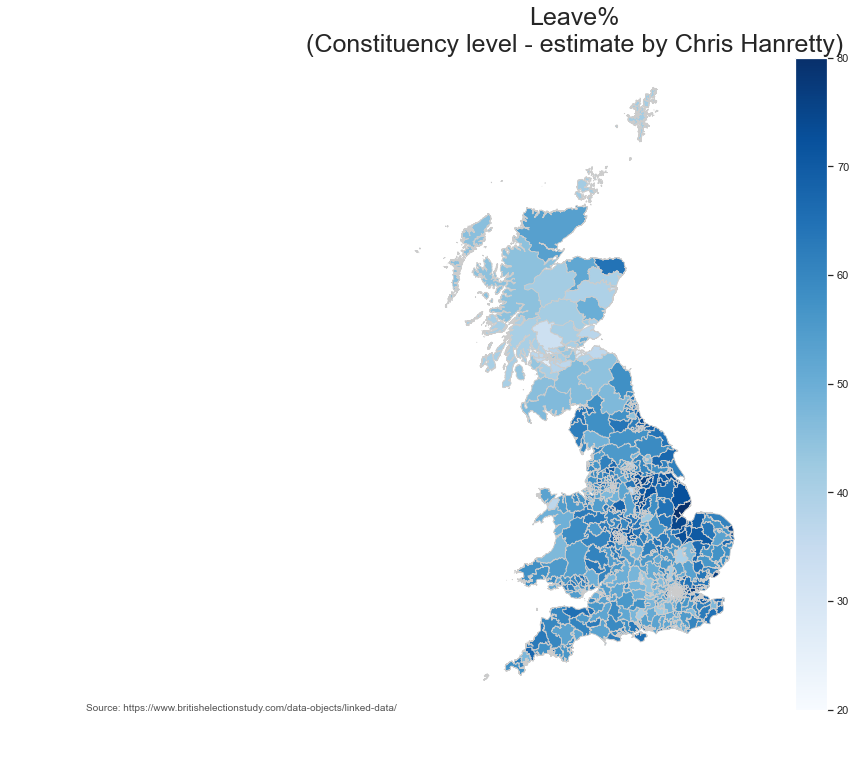

In [9]:
# set a variable that will call whatever column we want to visualise on the map
variable = 'leaveHanretty'

# set the range for the choropleth
vmin, vmax = np.floor(BES_census_data["leaveHanretty"].min()/10)*10, np.ceil(BES_census_data["leaveHanretty"].max()/10)*10

# create figure and axes for Matplotlib
fig, ax = plt.subplots(1, figsize=(16, 12))

# create map
merged.plot(column=variable, cmap='Blues', linewidth=0.8, ax=ax, edgecolor='0.8')

# Now we can customise and add annotations

# remove the axis
ax.axis('off')

# add a title
ax.set_title('Leave%\n(Constituency level - estimate by Chris Hanretty)', \
              fontdict={'fontsize': '25',
                        'fontweight' : '3'})

# create an annotation for the  data source
ax.annotate('Source: https://www.britishelectionstudy.com/data-objects/linked-data/',
           xy=(0.1, .08), xycoords='figure fraction',
           horizontalalignment='left', verticalalignment='top',
           fontsize=10, color='#555555')

# Create colorbar as a legend
sm = plt.cm.ScalarMappable(cmap='Blues', norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm._A = []
cbar = fig.colorbar(sm)

Treatment = "Chloropleth"
output_subfolder = create_subdir(BES_output_folder,Treatment)
fname = output_subfolder +Treatment + ".png"
# this will save the figure as a high-res png. you can also save as svg
plt.savefig( fname, bbox_inches='tight', dpi=300 )


# fig.savefig('testmap.png', dpi=300)

In [1609]:
# BES_census_data.columns[0:90]

In [11]:
## so what's the target of this regression? Con%? With/without Non-Voting?

# note - we're relying on UK census variables which - as far as I recall - only get updated ~decade

# 2015/2017/2019 has nice premade BES files

# https://www.jstor.org/stable/2344955
# - interesting, no (directly aggregated) constituency level data until 1966

# do it for 2017
# compare to James Kanagoosooriam

# https://journals.sagepub.com/doi/10.1177/20419058211045127
# https://twitter.com/jameskanag/status/1161639307536457730?lang=en
# https://en.wikipedia.org/wiki/Red_wall_(British_politics)

In [1611]:
BES_census_data.dtypes.value_counts()

float64     261
object       18
category     14
int32        10
category      7
int16         3
category      2
category      1
category      1
category      1
category      1
dtype: int64

In [13]:
drop_cols = ['Winner17', 'Winner15', 'Winner10','pano',#category
            'ConVote17', 'TotalVote17', 'Electorate17', 'ConVote15', 'TotalVote15',
       'Electorate15', 'ConVote10', 'TotalVote10', 'Electorate10', #int
              'Lab17', 'LD17', 'SNP17', 'PC17', 'UKIP17', 'Green17',
             # 'Con17',
       'Other17', 'Majority17', 'Turnout17', 'LabVote17', 'LDVote17',
       'SNPVote17', 'PCVote17', 'UKIPVote17', 'GreenVote17', 'Con1517',
       'Lab1517', 'LD1517', 'SNP1517', 'PC1517', 'UKIP1517', 'Green1517',
       'Con15', 'Lab15', 'LD15', 'SNP15', 'PC15', 'UKIP15', 'Green15',
       'Other15', 'Majority15', 'Turnout15', 'LabVote15', 'LDVote15',
       'SNPVote15', 'PCVote15', 'UKIPVote15', 'GreenVote15', 'BNPVote15',
       'Con1015', 'Lab1015', 'LD1015', 'SNP1015', 'PC1015', 'UKIP1015',
       'Green1015', 'Con10', 'Lab10', 'LD10', 'SNP10', 'PC10', 'UKIP10',
       'Green10', 'BNP10', 'Majority10', 'Turn10', 'LabVote10', 'LDVote10',
       'SNPVote10', 'PCVote10', 'UKIPVote10', 'GreenVote10', 'BNPVote10',## float
    'ONSConstID', 'ConstituencyName', 'SeatChange1517', 'SeatChange1015',
       'ConPPC17', 'LabPPC17', 'LDPPC17', 'SNPPPC17', 'PCPPC17', 'UKIPPPC17',
       'GreenPPC17', 'ConPPC15', 'LabPPC15', 'LDPPC15', 'SNPPPC15', 'PCPPC15',
       'UKIPPPC15', 'GreenPPC15'     # object
            ]

# 'c11Population'

MSE: 21.11, MAE: 3.71, EV: 0.91, R2: 0.91


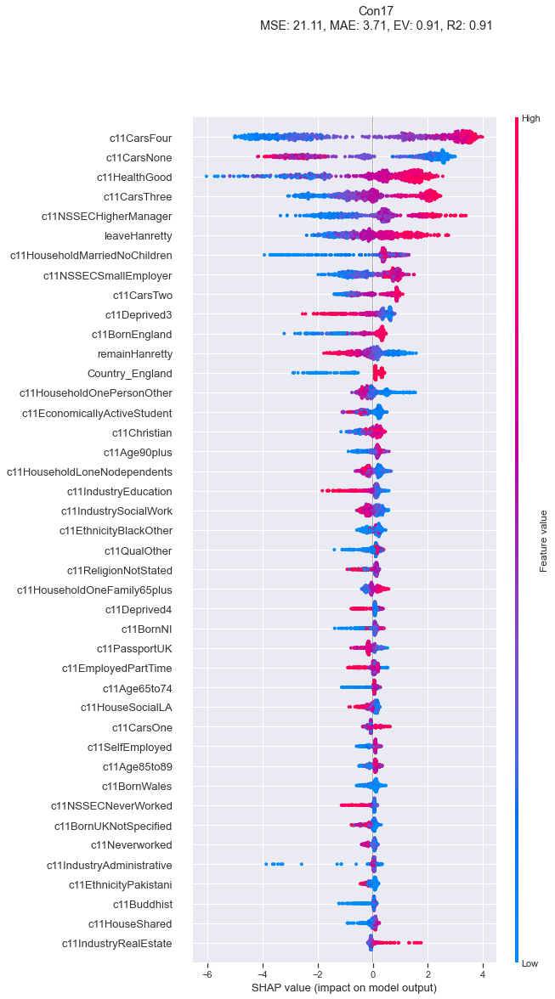

<Figure size 1152x720 with 0 Axes>

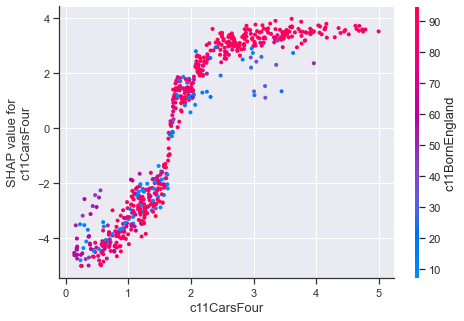

<Figure size 1152x720 with 0 Axes>

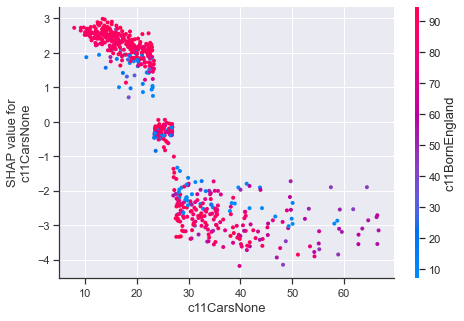

<Figure size 1152x720 with 0 Axes>

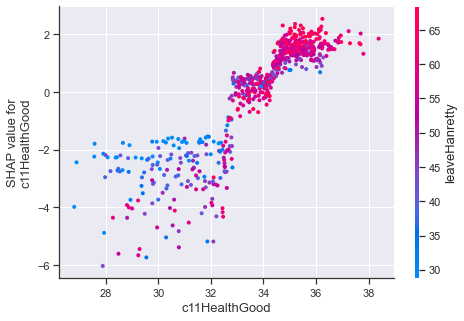

<Figure size 1152x720 with 0 Axes>

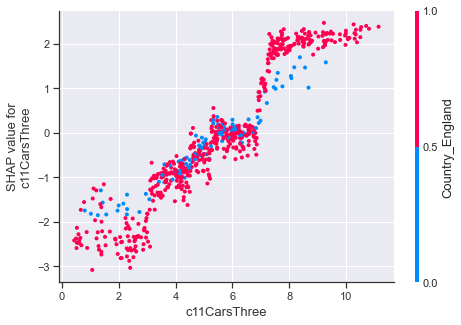

<Figure size 1152x720 with 0 Axes>

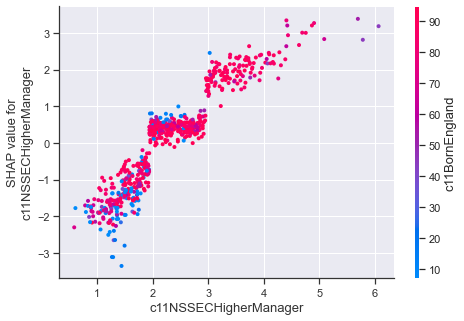

<Figure size 1152x720 with 0 Axes>

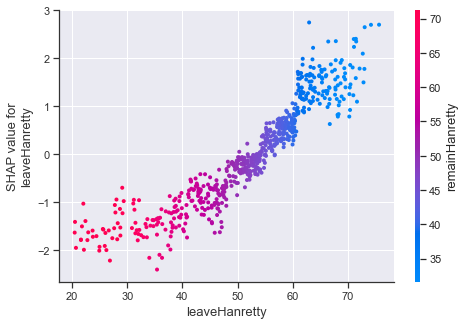

<Figure size 1152x720 with 0 Axes>

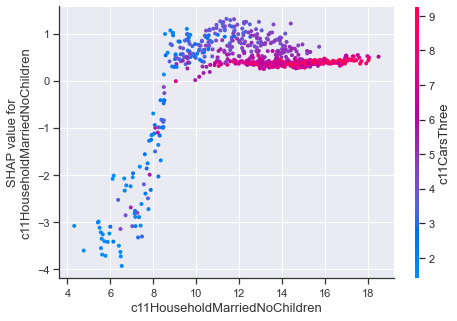

<Figure size 1152x720 with 0 Axes>

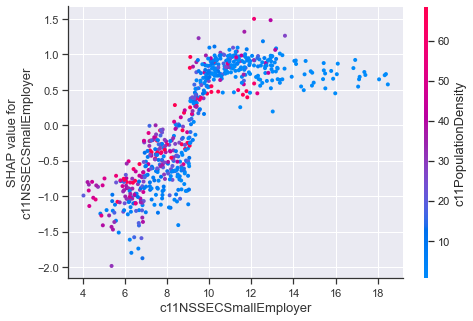

<Figure size 1152x720 with 0 Axes>

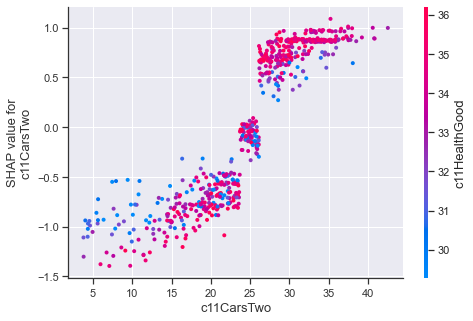

<Figure size 1152x720 with 0 Axes>

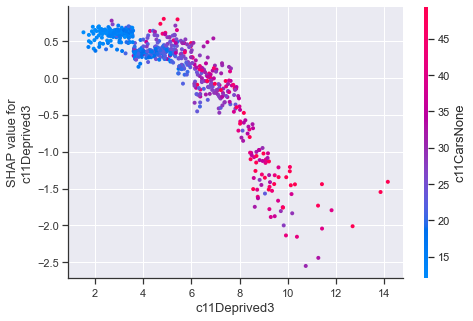

<Figure size 1152x720 with 0 Axes>

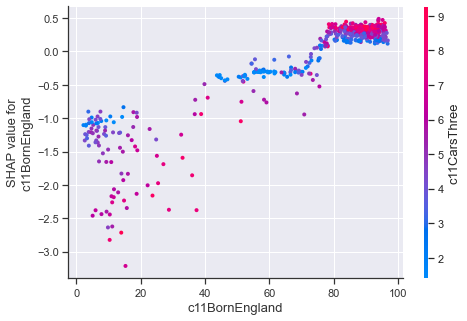

<Figure size 1152x720 with 0 Axes>

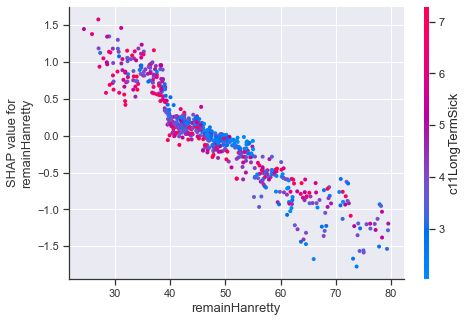

<Figure size 1152x720 with 0 Axes>

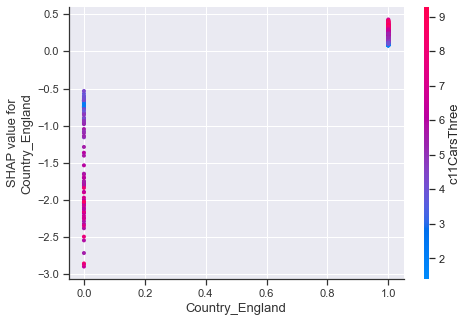

<Figure size 1152x720 with 0 Axes>

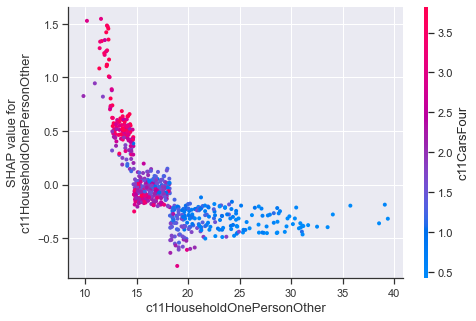

<Figure size 1152x720 with 0 Axes>

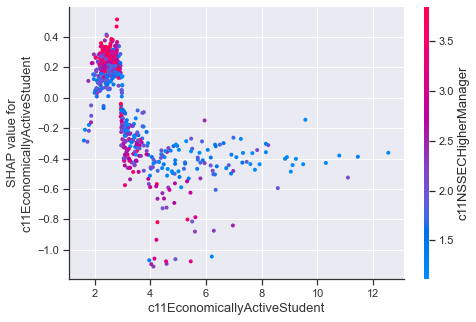

<Figure size 1152x720 with 0 Axes>

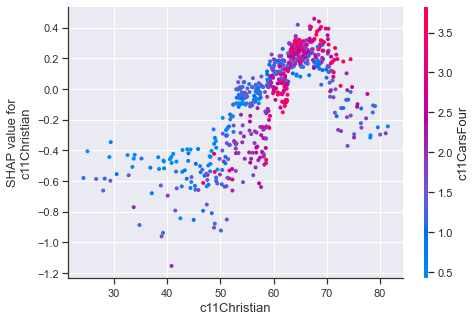

<Figure size 1152x720 with 0 Axes>

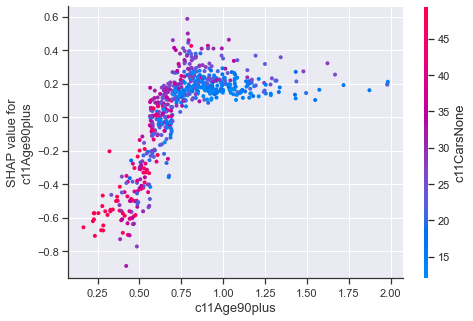

<Figure size 1152x720 with 0 Axes>

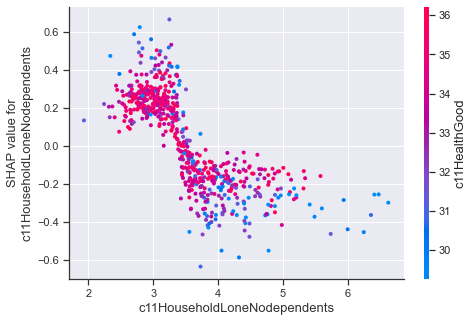

<Figure size 1152x720 with 0 Axes>

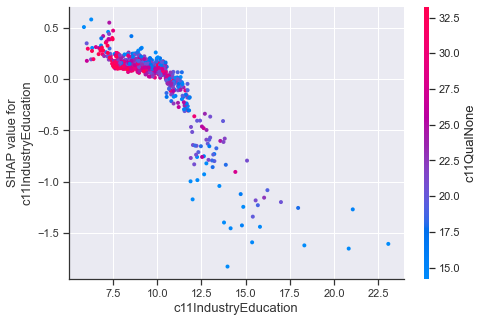

<Figure size 1152x720 with 0 Axes>

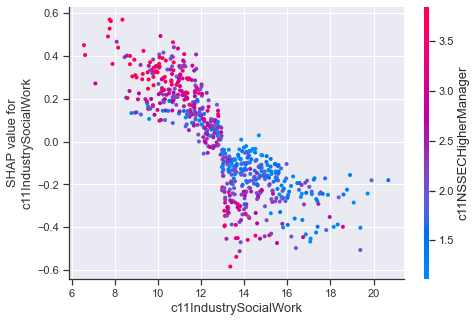

<Figure size 1152x720 with 0 Axes>

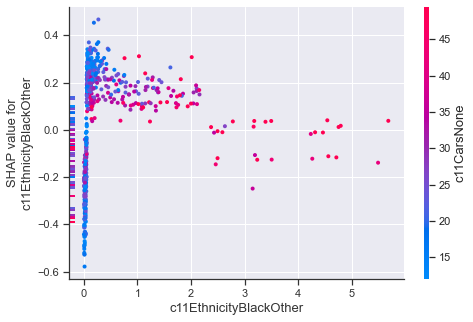

<Figure size 1152x720 with 0 Axes>

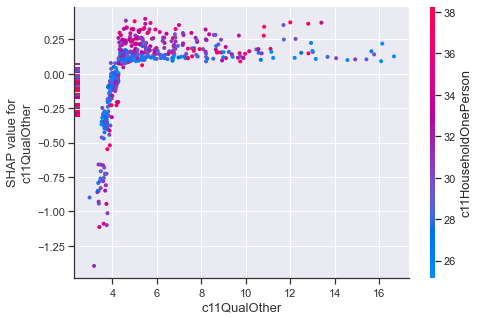

<Figure size 1152x720 with 0 Axes>

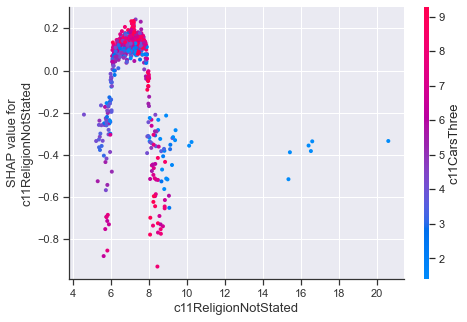

<Figure size 1152x720 with 0 Axes>

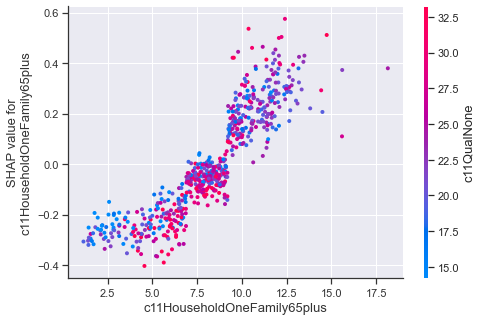

<Figure size 1152x720 with 0 Axes>

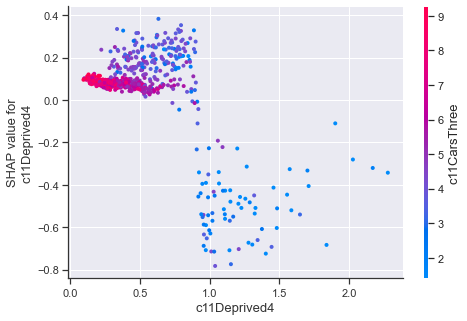

<Figure size 1152x720 with 0 Axes>

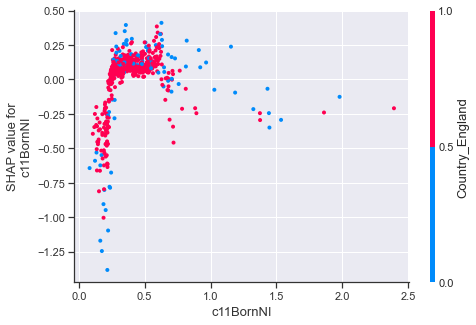

<Figure size 1152x720 with 0 Axes>

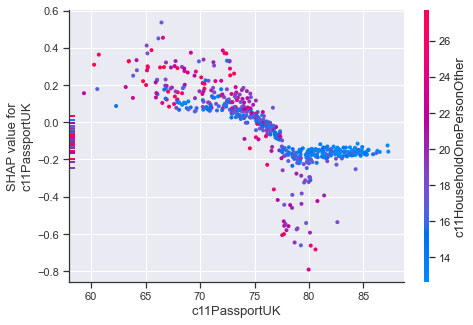

<Figure size 1152x720 with 0 Axes>

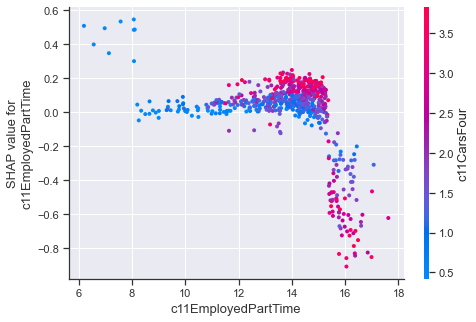

<Figure size 1152x720 with 0 Axes>

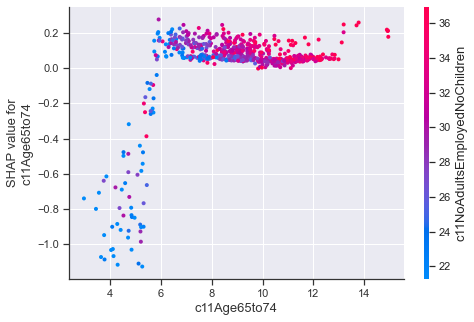

<Figure size 1152x720 with 0 Axes>

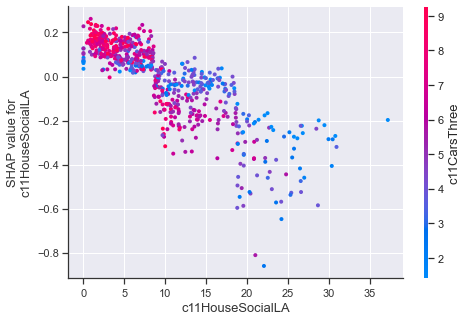

<Figure size 1152x720 with 0 Axes>

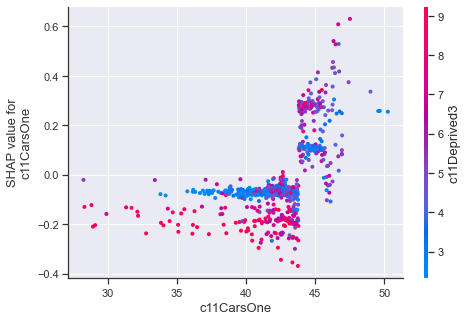

<Figure size 1152x720 with 0 Axes>

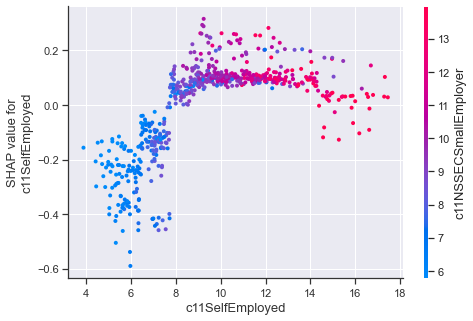

<Figure size 1152x720 with 0 Axes>

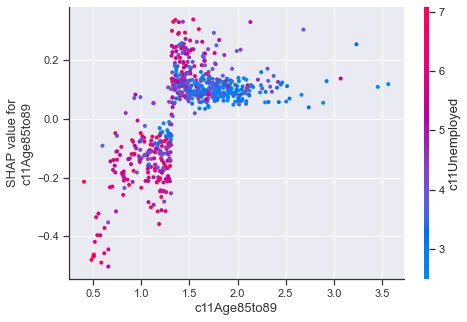

<Figure size 1152x720 with 0 Axes>

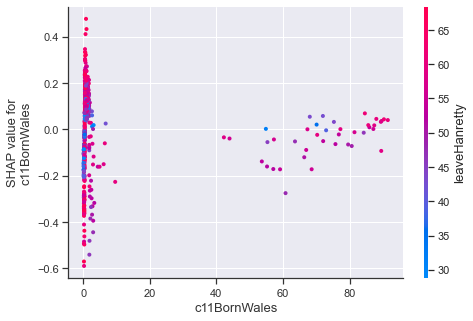

<Figure size 1152x720 with 0 Axes>

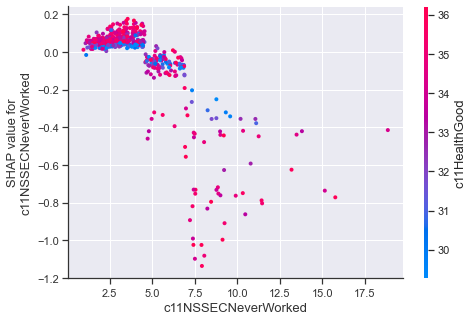

<Figure size 1152x720 with 0 Axes>

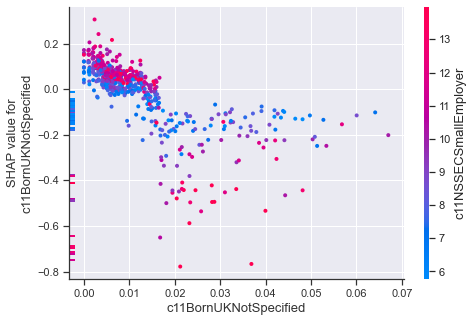

<Figure size 1152x720 with 0 Axes>

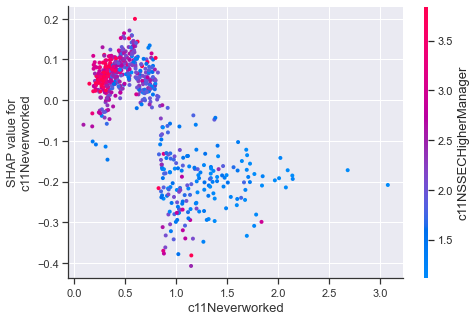

<Figure size 1152x720 with 0 Axes>

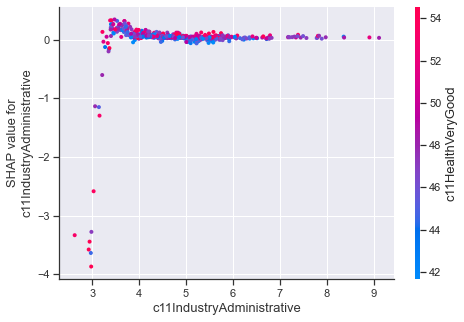

<Figure size 1152x720 with 0 Axes>

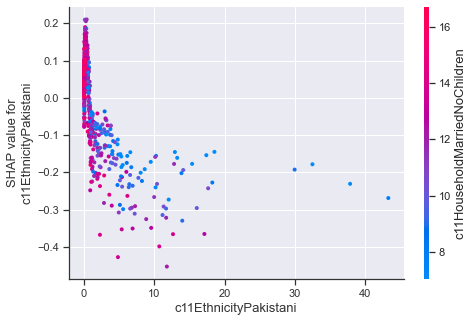

<Figure size 1152x720 with 0 Axes>

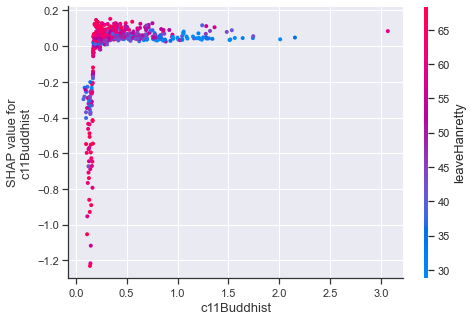

<Figure size 1152x720 with 0 Axes>

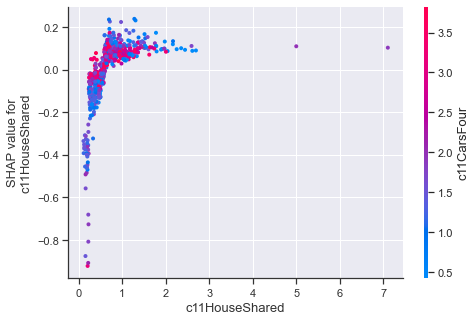

<Figure size 1152x720 with 0 Axes>

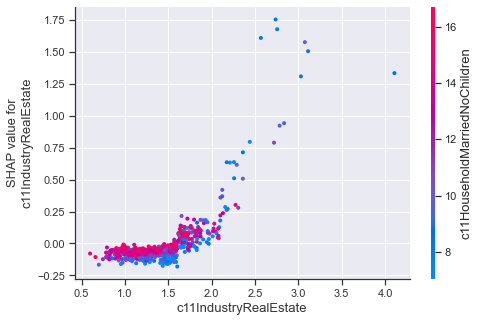

In [16]:
df_simp = pd.get_dummies(BES_census_data.drop(drop_cols,axis=1))

var_stub = "Con17"
Treatment = var_stub

var_list = [var_stub]
var_stub_list = [var_stub,]
mask = df_simp[var_stub].notnull()
wt_cols = []
min_features = 30
colname = "Con17"
dependence_plots = True

alg = get_xgboost_alg(classification_problem=False)
title = "Con17"

(explainer, shap_values, train_columns, train_index, alg,output_subfolder)=\
    xgboost_run(subdir=colname,dataset=df_simp[mask].drop(wt_cols,axis=1),
            var_list=var_list,var_stub_list=var_stub_list,
            use_specific_weights=None,
            min_features = min(df_simp.shape[1]-1,min_features),verbosity=0,
            skip_bar_plot=True,dependence_plots=dependence_plots,alg=alg,eval_metric=eval_metric,                    
            title = title)

MSE: 21.90, MAE: 3.73, EV: 0.90, R2: 0.90


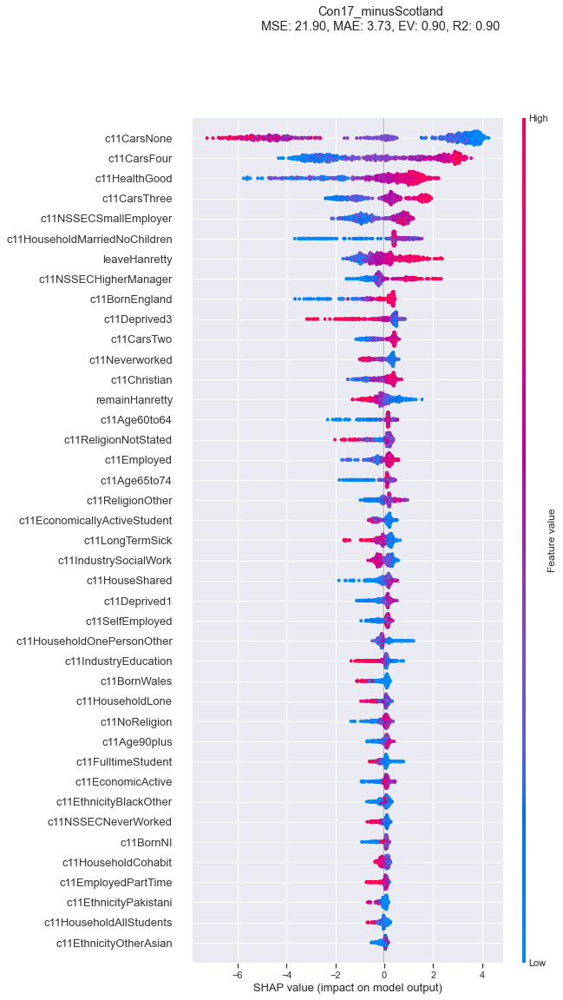

<Figure size 1152x720 with 0 Axes>

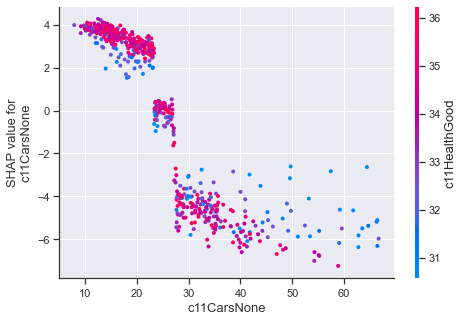

<Figure size 1152x720 with 0 Axes>

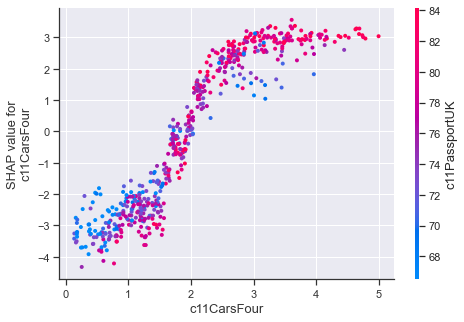

<Figure size 1152x720 with 0 Axes>

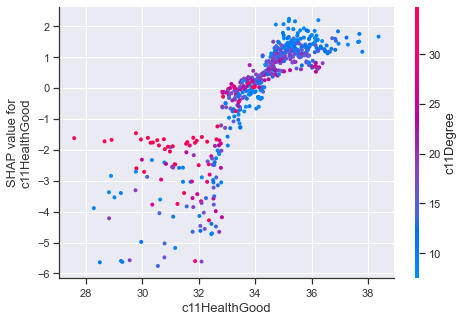

<Figure size 1152x720 with 0 Axes>

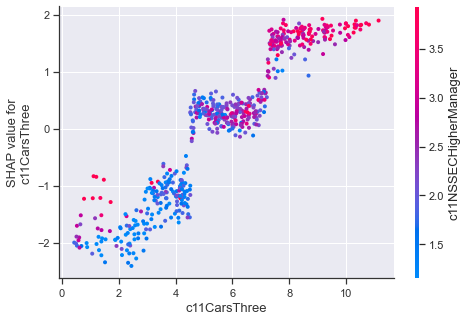

<Figure size 1152x720 with 0 Axes>

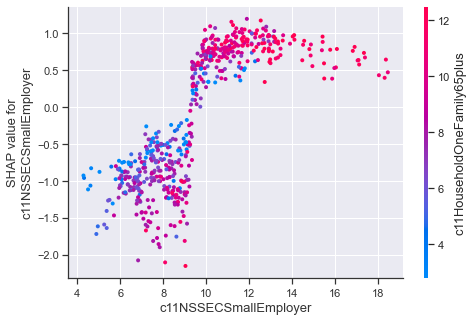

<Figure size 1152x720 with 0 Axes>

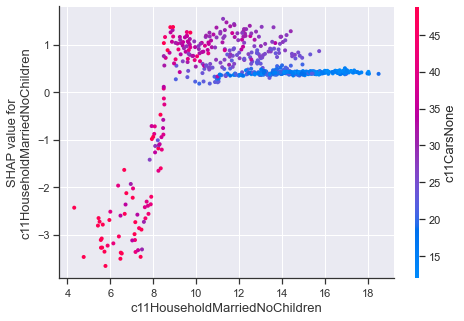

<Figure size 1152x720 with 0 Axes>

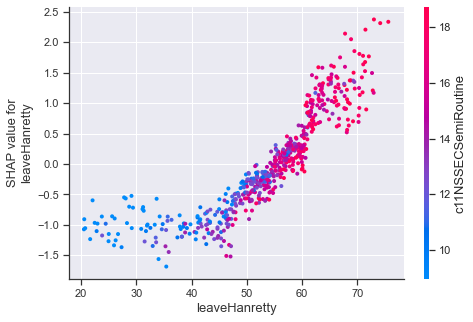

<Figure size 1152x720 with 0 Axes>

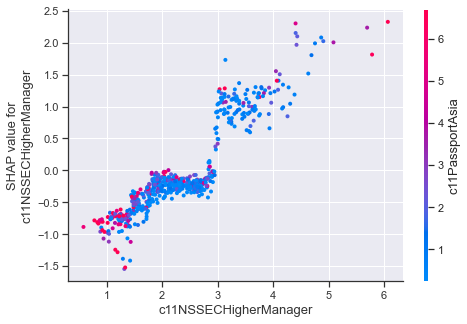

<Figure size 1152x720 with 0 Axes>

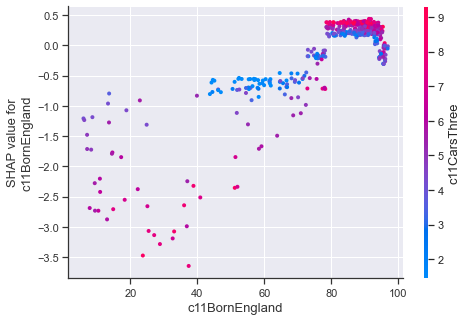

<Figure size 1152x720 with 0 Axes>

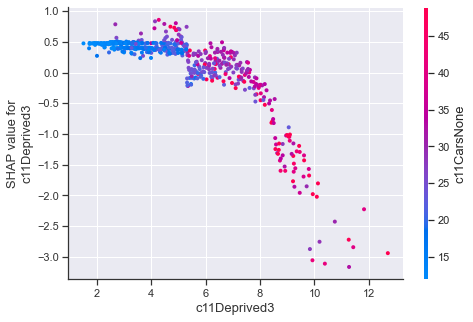

<Figure size 1152x720 with 0 Axes>

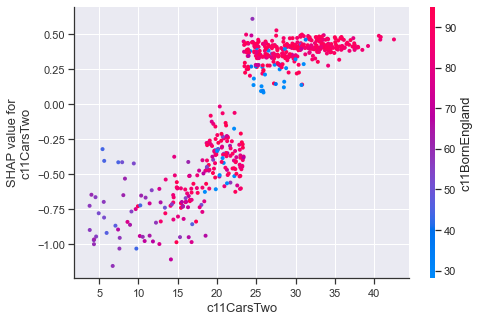

<Figure size 1152x720 with 0 Axes>

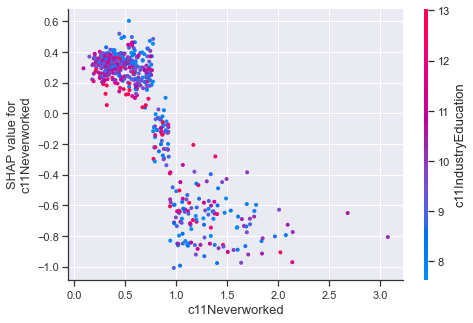

<Figure size 1152x720 with 0 Axes>

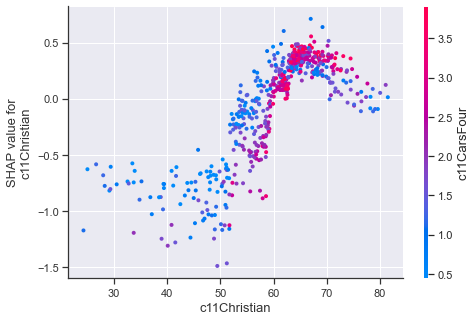

<Figure size 1152x720 with 0 Axes>

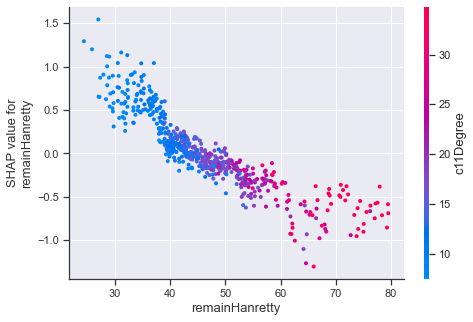

<Figure size 1152x720 with 0 Axes>

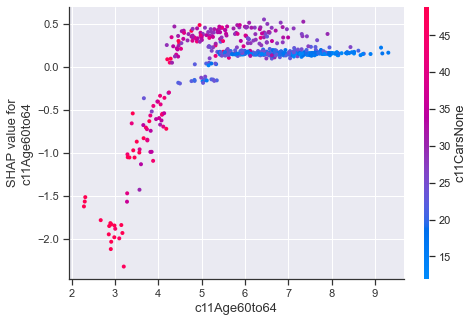

<Figure size 1152x720 with 0 Axes>

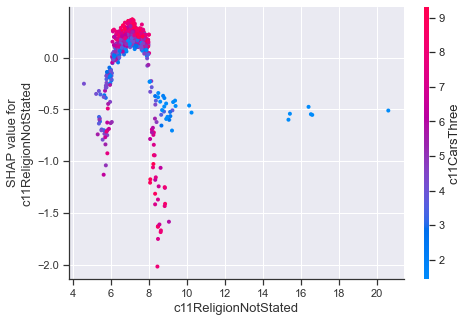

<Figure size 1152x720 with 0 Axes>

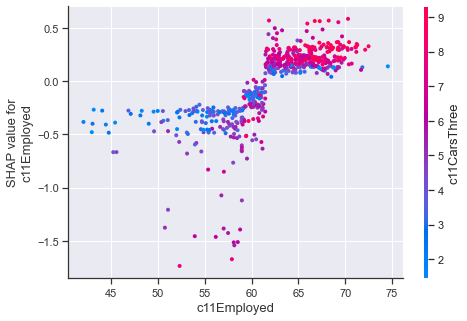

<Figure size 1152x720 with 0 Axes>

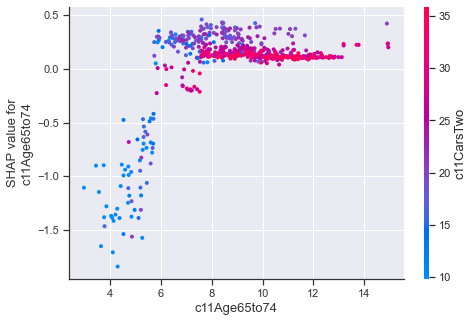

<Figure size 1152x720 with 0 Axes>

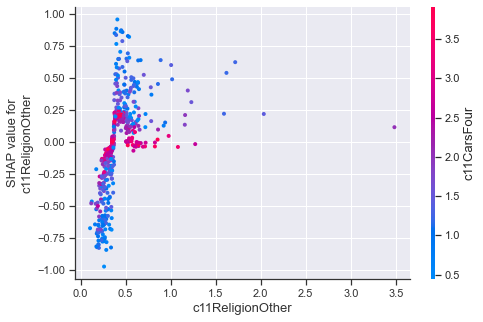

<Figure size 1152x720 with 0 Axes>

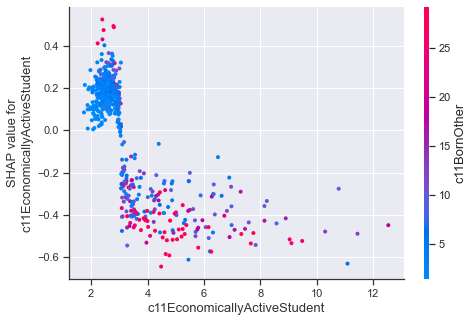

<Figure size 1152x720 with 0 Axes>

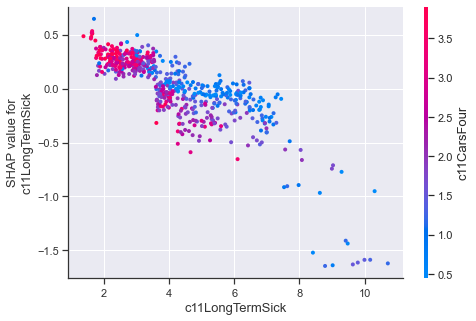

<Figure size 1152x720 with 0 Axes>

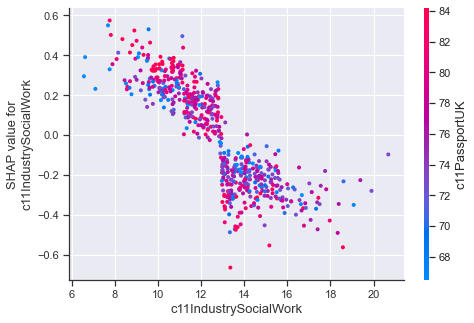

<Figure size 1152x720 with 0 Axes>

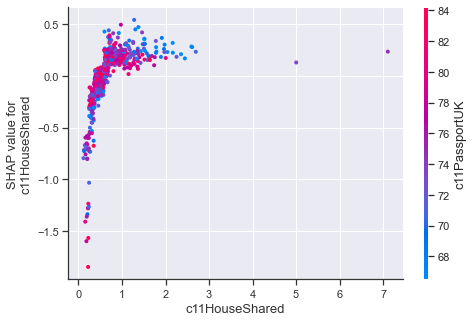

<Figure size 1152x720 with 0 Axes>

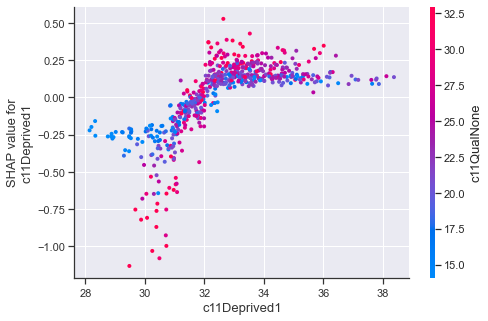

<Figure size 1152x720 with 0 Axes>

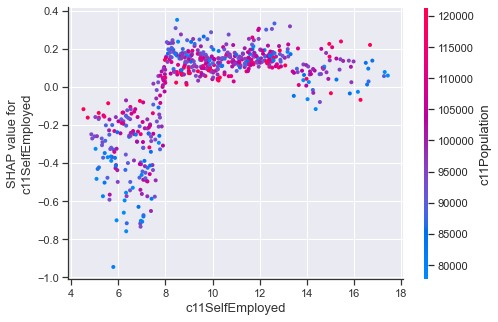

<Figure size 1152x720 with 0 Axes>

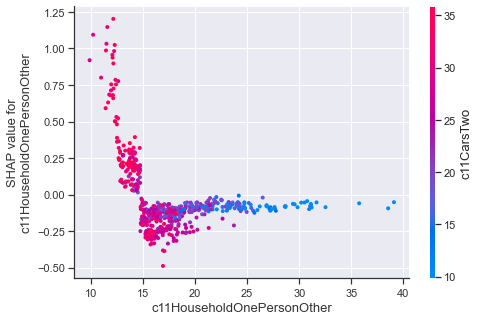

<Figure size 1152x720 with 0 Axes>

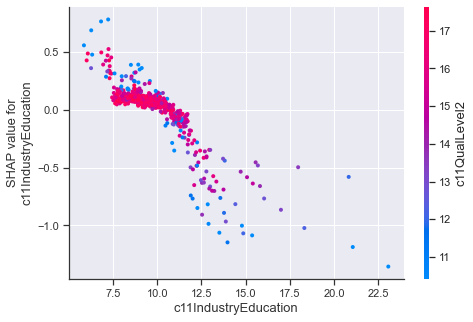

<Figure size 1152x720 with 0 Axes>

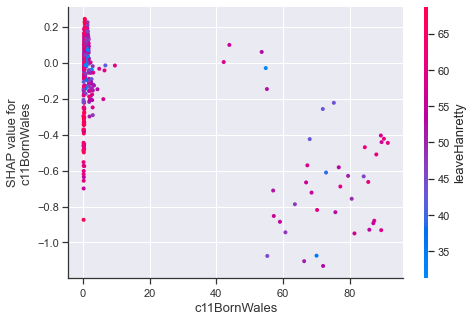

<Figure size 1152x720 with 0 Axes>

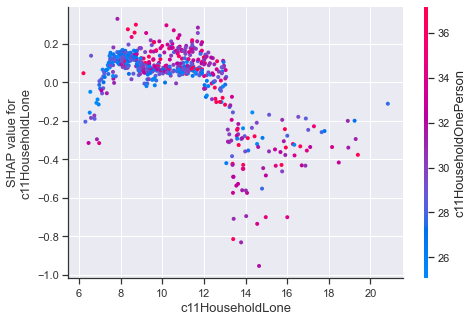

<Figure size 1152x720 with 0 Axes>

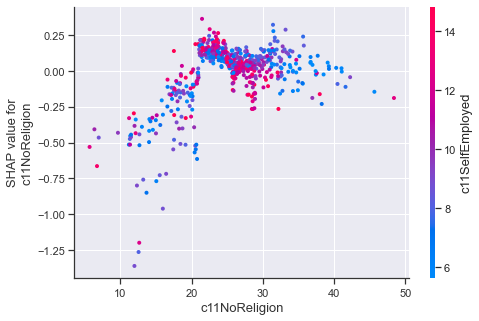

<Figure size 1152x720 with 0 Axes>

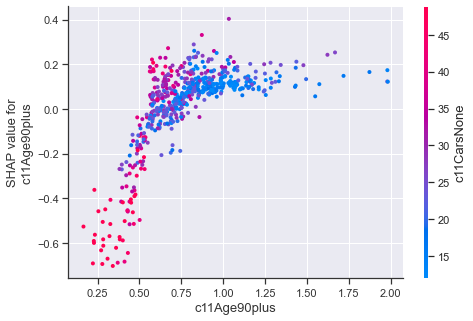

<Figure size 1152x720 with 0 Axes>

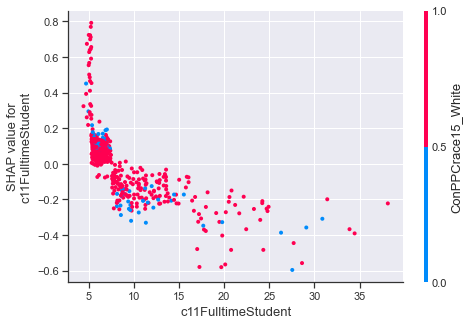

<Figure size 1152x720 with 0 Axes>

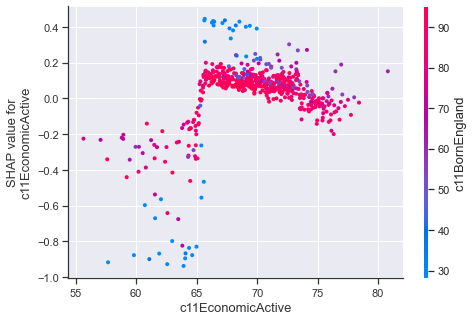

<Figure size 1152x720 with 0 Axes>

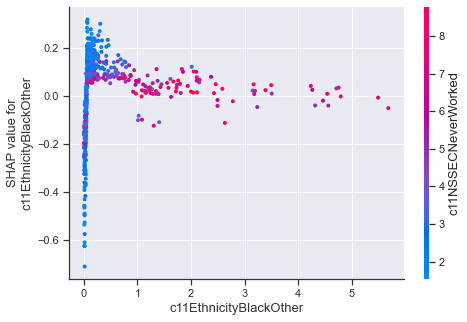

<Figure size 1152x720 with 0 Axes>

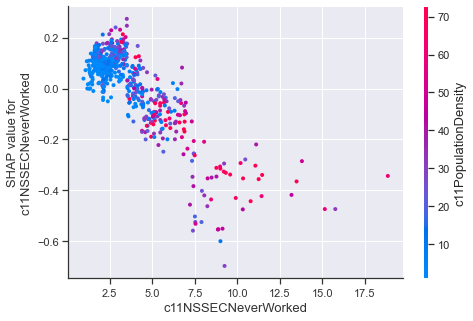

<Figure size 1152x720 with 0 Axes>

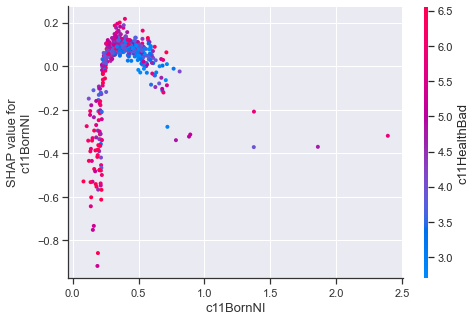

<Figure size 1152x720 with 0 Axes>

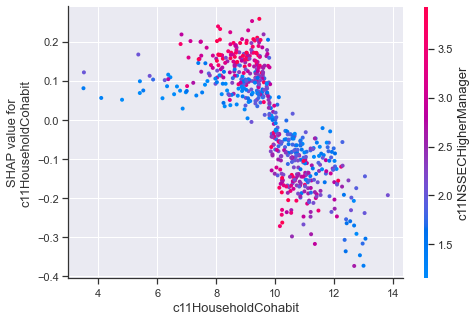

<Figure size 1152x720 with 0 Axes>

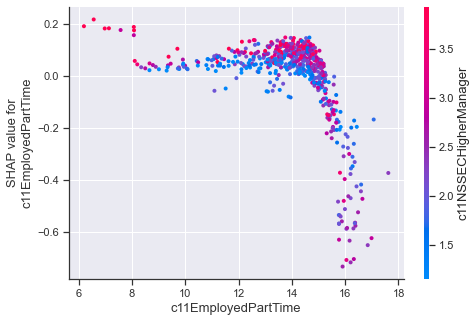

<Figure size 1152x720 with 0 Axes>

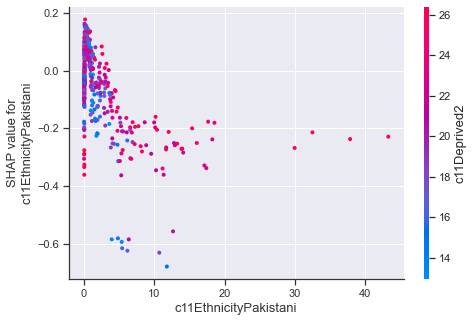

<Figure size 1152x720 with 0 Axes>

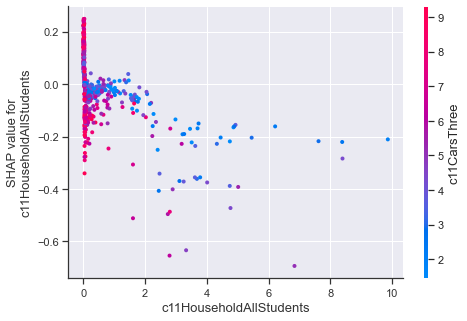

<Figure size 1152x720 with 0 Axes>

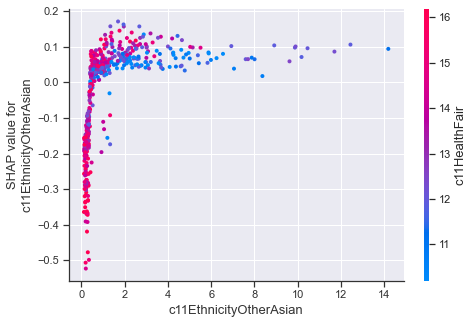

In [59]:
df_simp = pd.get_dummies(BES_census_data.drop(drop_cols,axis=1))

var_stub = "Con17"
Treatment = var_stub

var_list = [var_stub]
var_stub_list = [var_stub,]
mask = df_simp[var_stub].notnull() & (BES_census_data["Country"]!="Scotland")
wt_cols = []
min_features = 30
colname = "Con17"
dependence_plots = True

alg = get_xgboost_alg(classification_problem=False)
title = "Con17_minusScotland"

(explainer, shap_values, train_columns, train_index, alg,output_subfolder)=\
    xgboost_run(subdir=colname,dataset=df_simp[mask].drop(wt_cols,axis=1),
            var_list=var_list,var_stub_list=var_stub_list,
            use_specific_weights=None,
            min_features = min(df_simp.shape[1]-1,min_features),verbosity=0,
            skip_bar_plot=True,dependence_plots=dependence_plots,alg=alg,eval_metric=eval_metric,                    
            title = title)

MSE: 23.21, MAE: 3.92, EV: 0.90, R2: 0.90


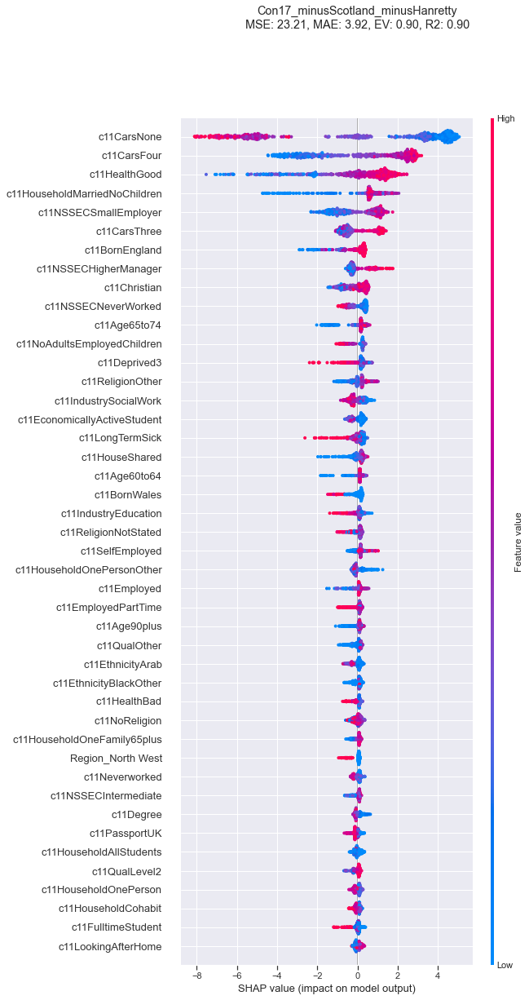

<Figure size 1152x720 with 0 Axes>

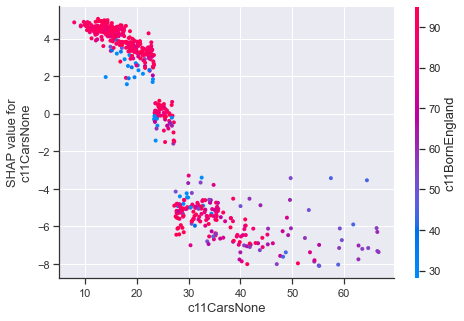

<Figure size 1152x720 with 0 Axes>

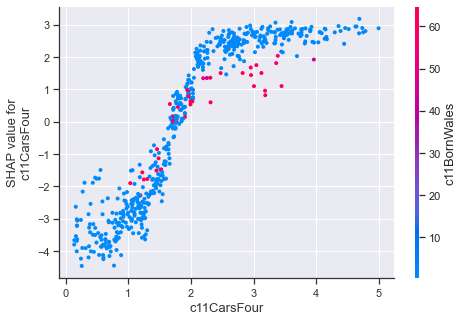

<Figure size 1152x720 with 0 Axes>

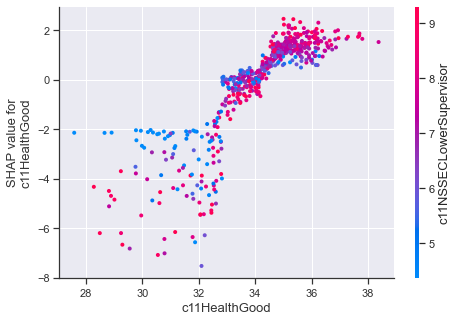

<Figure size 1152x720 with 0 Axes>

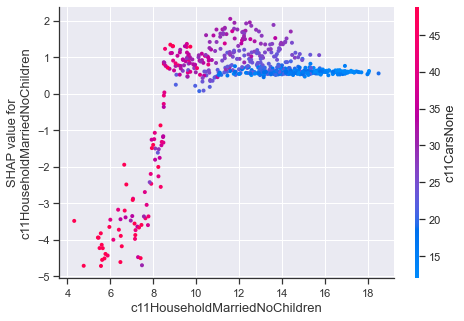

<Figure size 1152x720 with 0 Axes>

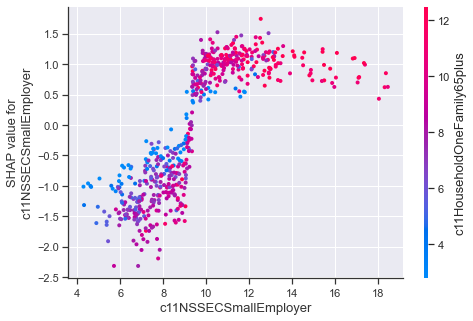

<Figure size 1152x720 with 0 Axes>

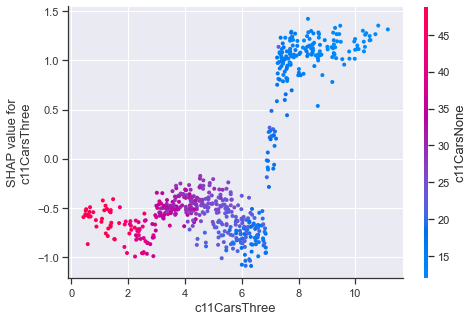

<Figure size 1152x720 with 0 Axes>

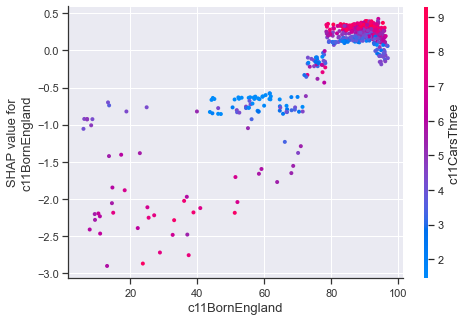

<Figure size 1152x720 with 0 Axes>

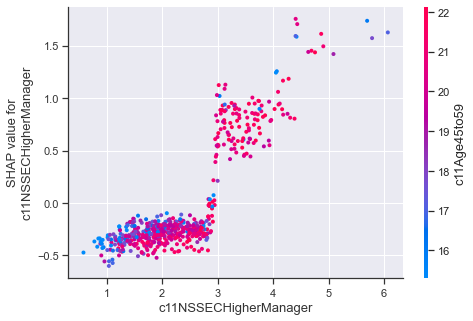

<Figure size 1152x720 with 0 Axes>

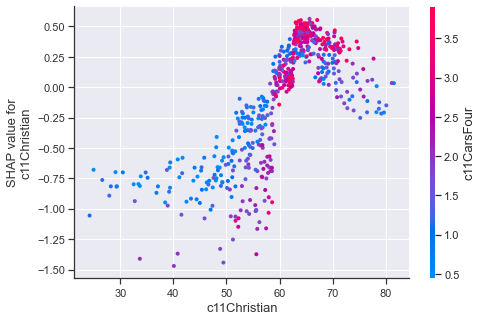

<Figure size 1152x720 with 0 Axes>

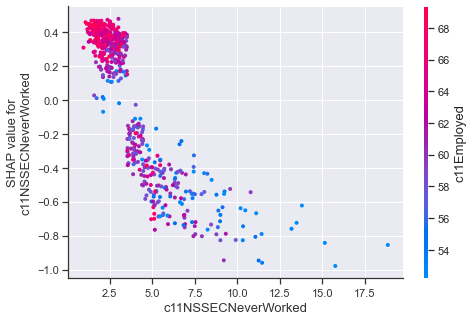

<Figure size 1152x720 with 0 Axes>

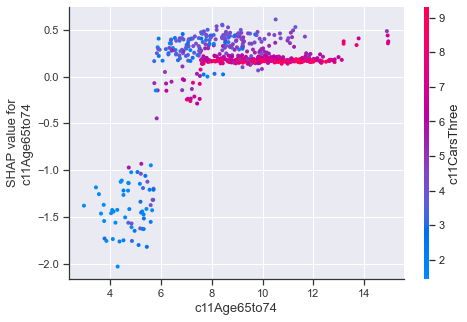

<Figure size 1152x720 with 0 Axes>

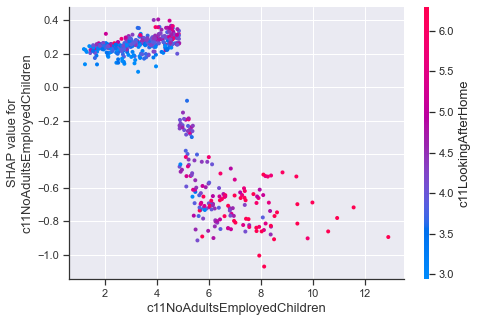

<Figure size 1152x720 with 0 Axes>

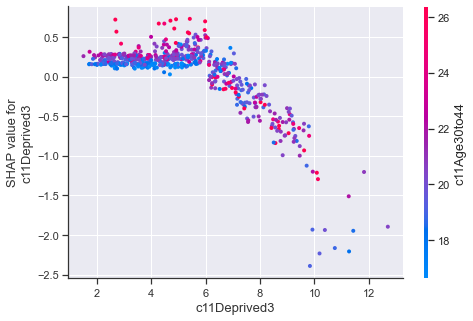

<Figure size 1152x720 with 0 Axes>

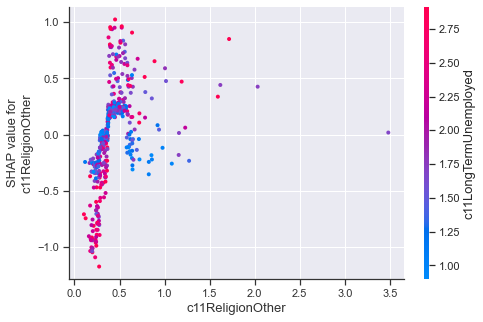

<Figure size 1152x720 with 0 Axes>

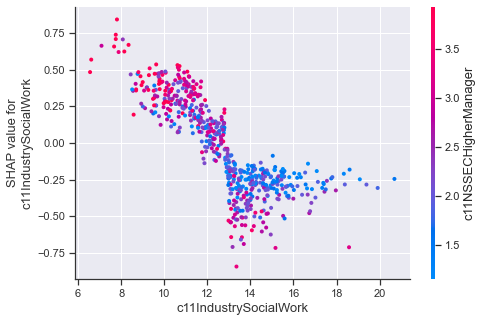

<Figure size 1152x720 with 0 Axes>

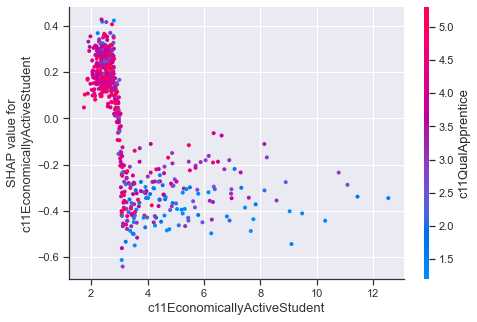

<Figure size 1152x720 with 0 Axes>

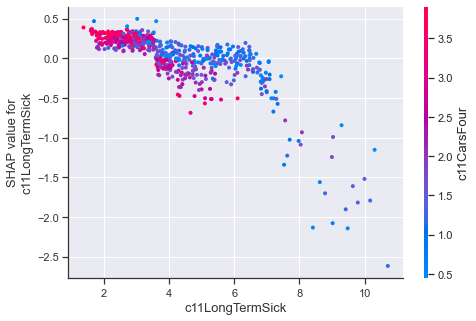

<Figure size 1152x720 with 0 Axes>

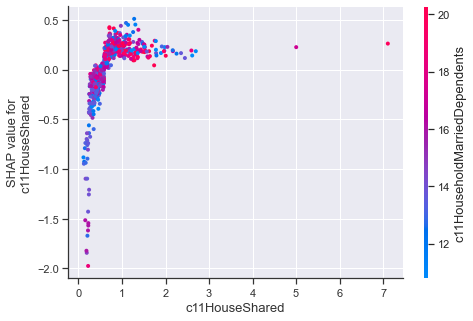

<Figure size 1152x720 with 0 Axes>

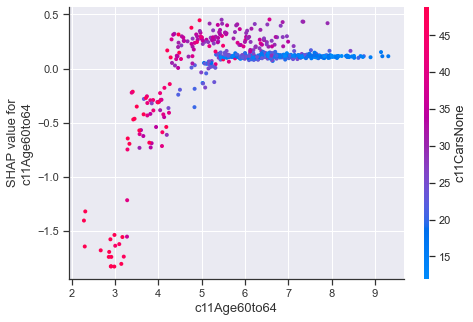

<Figure size 1152x720 with 0 Axes>

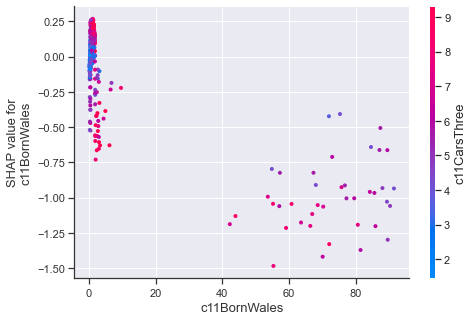

<Figure size 1152x720 with 0 Axes>

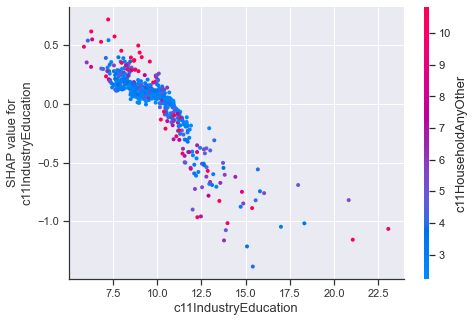

<Figure size 1152x720 with 0 Axes>

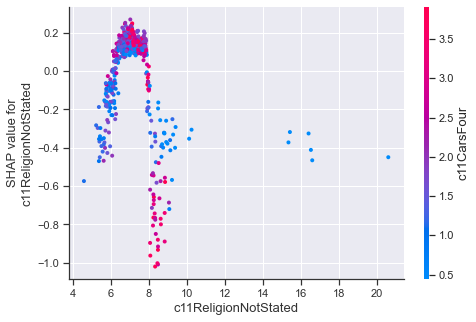

<Figure size 1152x720 with 0 Axes>

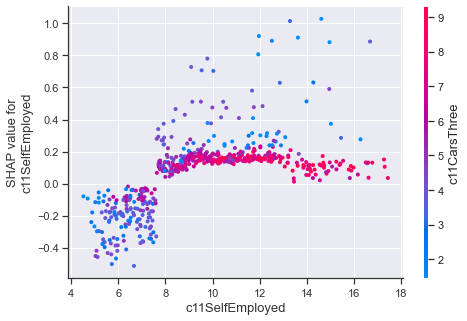

<Figure size 1152x720 with 0 Axes>

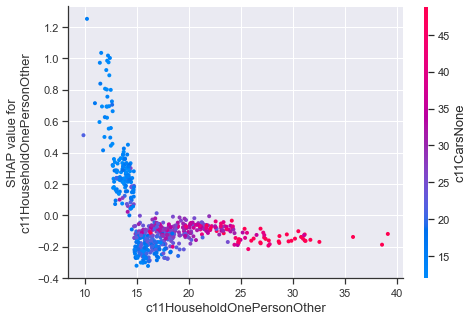

<Figure size 1152x720 with 0 Axes>

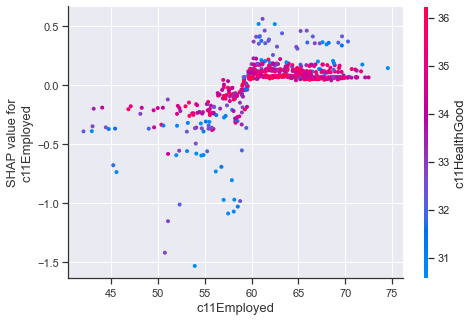

<Figure size 1152x720 with 0 Axes>

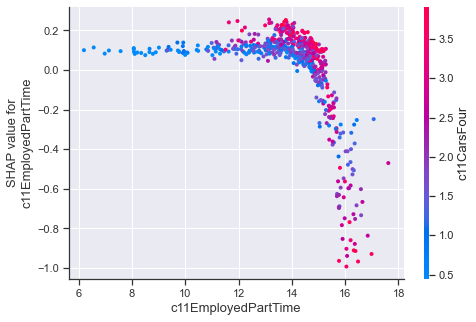

<Figure size 1152x720 with 0 Axes>

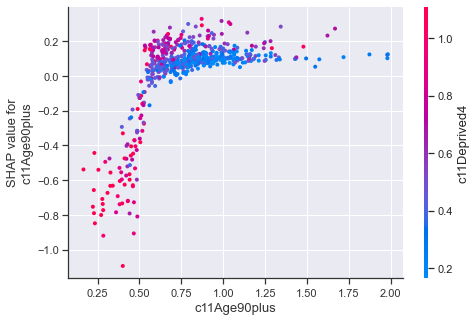

<Figure size 1152x720 with 0 Axes>

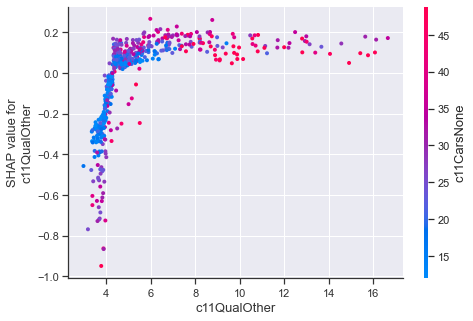

<Figure size 1152x720 with 0 Axes>

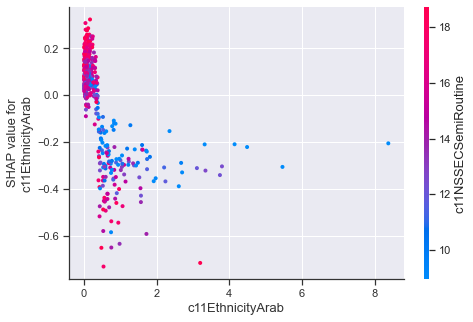

<Figure size 1152x720 with 0 Axes>

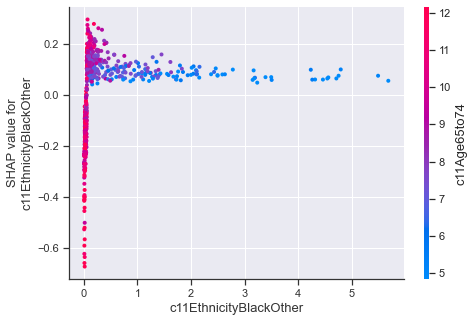

<Figure size 1152x720 with 0 Axes>

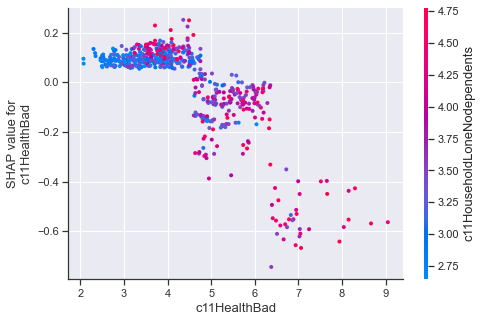

<Figure size 1152x720 with 0 Axes>

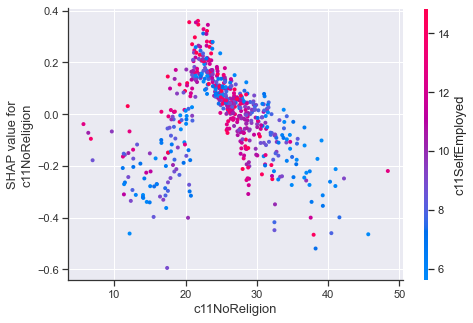

<Figure size 1152x720 with 0 Axes>

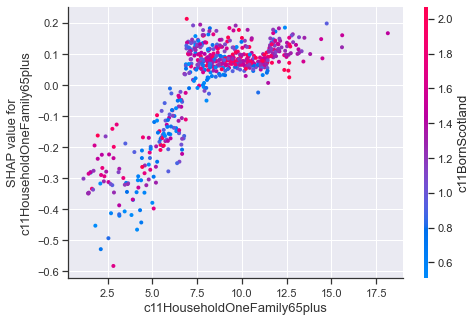

<Figure size 1152x720 with 0 Axes>

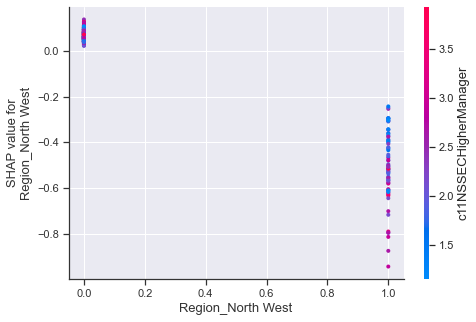

<Figure size 1152x720 with 0 Axes>

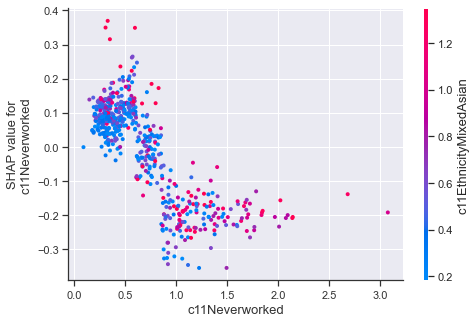

<Figure size 1152x720 with 0 Axes>

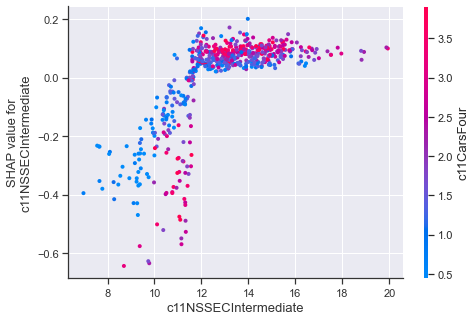

<Figure size 1152x720 with 0 Axes>

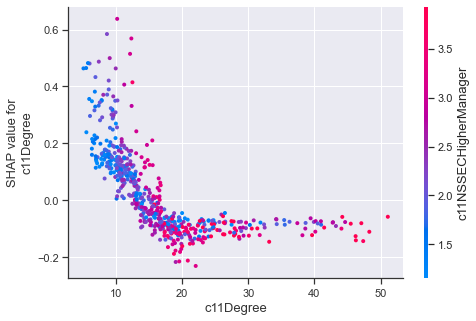

<Figure size 1152x720 with 0 Axes>

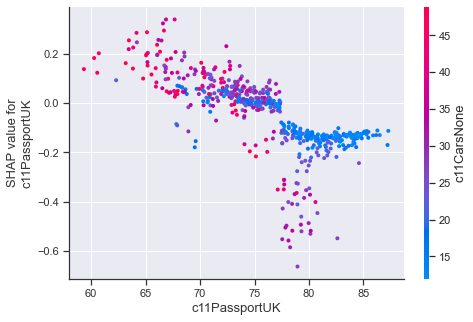

<Figure size 1152x720 with 0 Axes>

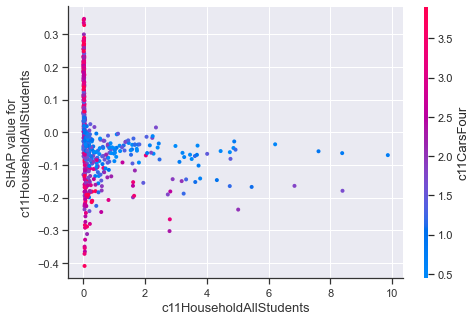

<Figure size 1152x720 with 0 Axes>

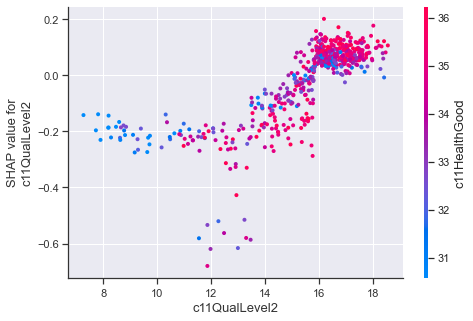

<Figure size 1152x720 with 0 Axes>

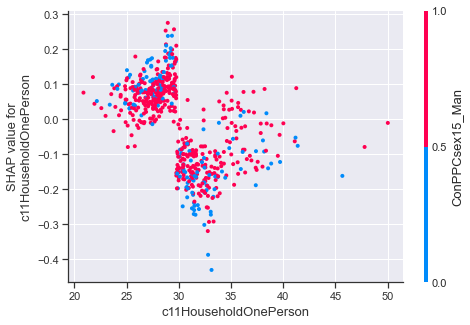

<Figure size 1152x720 with 0 Axes>

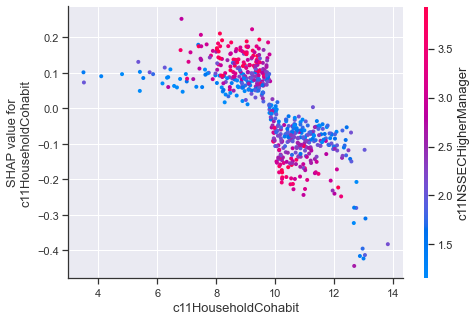

<Figure size 1152x720 with 0 Axes>

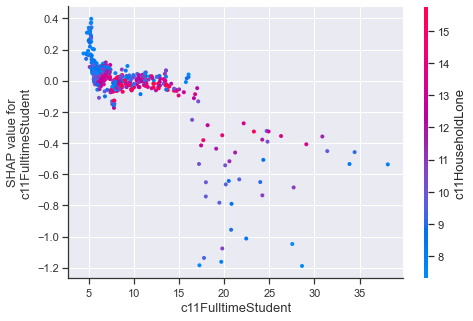

<Figure size 1152x720 with 0 Axes>

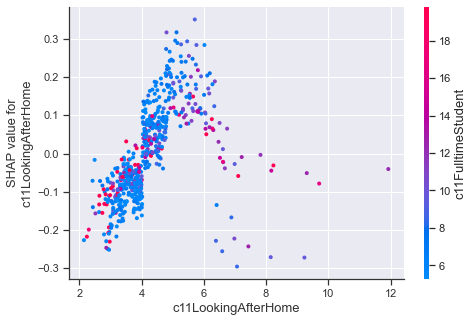

In [60]:
df_simp = pd.get_dummies(BES_census_data.drop(drop_cols,axis=1))

var_stub = "Con17"
Treatment = var_stub

var_list = [var_stub]
var_stub_list = [var_stub,]
mask = df_simp[var_stub].notnull() & (BES_census_data["Country"]!="Scotland")
wt_cols = ["leaveHanretty","remainHanretty"]
min_features = 30
colname = "Con17"
dependence_plots = True

alg = get_xgboost_alg(classification_problem=False)
title = "Con17_minusScotland_minusHanretty"

(explainer, shap_values, train_columns, train_index, alg,output_subfolder)=\
    xgboost_run(subdir=colname,dataset=df_simp[mask].drop(wt_cols,axis=1),
            var_list=var_list,var_stub_list=var_stub_list,
            use_specific_weights=None,
            min_features = min(df_simp.shape[1]-1,min_features),verbosity=0,
            skip_bar_plot=True,dependence_plots=dependence_plots,alg=alg,eval_metric=eval_metric,                    
            title = title)

In [166]:
search(BES_census_data,"c11Age").index

Index(['c11Age0to4', 'c11Age5to7', 'c11Age8to9', 'c11Age10to14', 'c11Age15',
       'c11Age16to17', 'c11Age18to19', 'c11Age20to24', 'c11Age25to29',
       'c11Age30to44', 'c11Age45to59', 'c11Age60to64', 'c11Age65to74',
       'c11Age75to84', 'c11Age85to89', 'c11Age90plus', 'c11AgeMean'],
      dtype='object')

In [121]:
BES_census_data["c11DeprivedMean"] = (BES_census_data["c11Deprived1"]+(BES_census_data["c11Deprived2"]*2)+(BES_census_data["c11Deprived3"]*3)+(BES_census_data["c11Deprived4"]*4))/100

In [110]:
BES_census_data["c11CarsMean"] = (BES_census_data["c11CarsOne"]+(BES_census_data["c11CarsTwo"]*2)+(BES_census_data["c11CarsThree"]*3)+(BES_census_data["c11CarsFour"]*4))/100

In [131]:
BES_census_data[search(BES_census_data,"c11Cars(None|One|Two|Three|Four)").index].sum(axis=1)

0      100.0
1      100.0
2      100.0
3      100.0
4      100.0
       ...  
627    100.0
628    100.0
629    100.0
630    100.0
631    100.0
Length: 632, dtype: float64

In [177]:
BES_census_data["c11AgeMean"] = (
                                 BES_census_data["c11Age18to19"]*18.5+\
                                 BES_census_data["c11Age20to24"]*22+\
                                 BES_census_data["c11Age25to29"]*27+\
                                 BES_census_data["c11Age30to44"]*37+\
                                 BES_census_data["c11Age45to59"]*52+\
                                 BES_census_data["c11Age60to64"]*62+\
                                 BES_census_data["c11Age65to74"]*69.5+\
                                 BES_census_data["c11Age75to84"]*79.5+\
                                 BES_census_data["c11Age85to89"]*87+\
                                 BES_census_data["c11Age90plus"]*95  )/100

# BES_census_data["c11Age0to4"]*2+\
#                                  BES_census_data["c11Age5to7"]*6+\
#                                  BES_census_data["c11Age8to9"]*8.5+\
#                                  BES_census_data["c11Age10to14"]*12+\
#                                  BES_census_data["c11Age15"]*15+\
#                                  BES_census_data["c11Age16to17"]*16.5+\

In [118]:
BES_census_data["c11AgeMean"].describe()

count    632.000000
mean      39.811749
std        3.011172
min       30.298900
25%       38.104013
50%       39.980847
75%       41.885278
max       48.855777
Name: c11AgeMean, dtype: float64

MSE: 22.77, MAE: 3.86, EV: 0.90, R2: 0.90


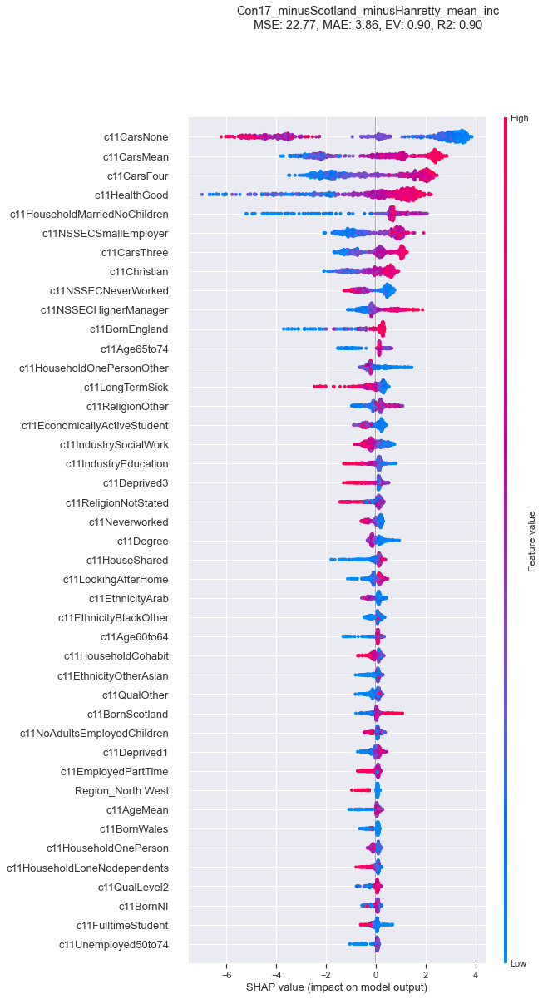

<Figure size 1152x720 with 0 Axes>

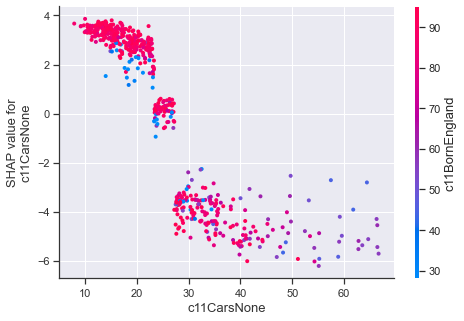

<Figure size 1152x720 with 0 Axes>

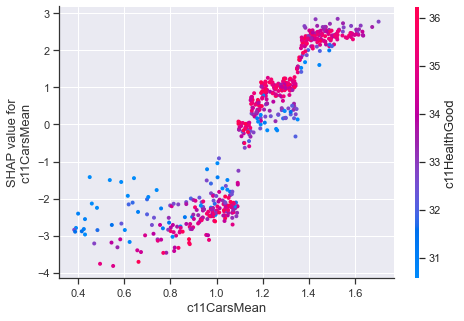

<Figure size 1152x720 with 0 Axes>

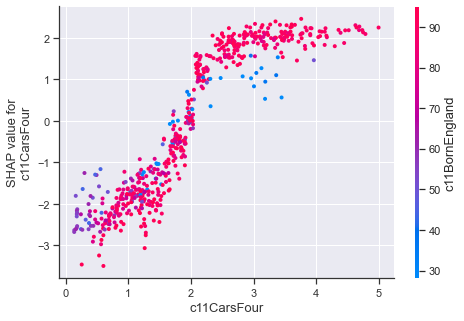

<Figure size 1152x720 with 0 Axes>

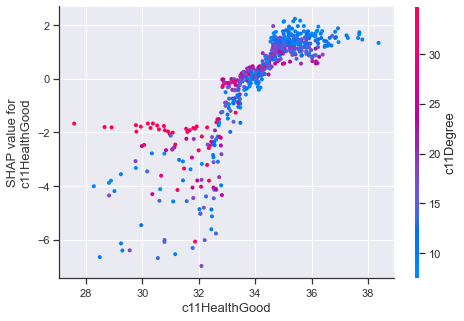

<Figure size 1152x720 with 0 Axes>

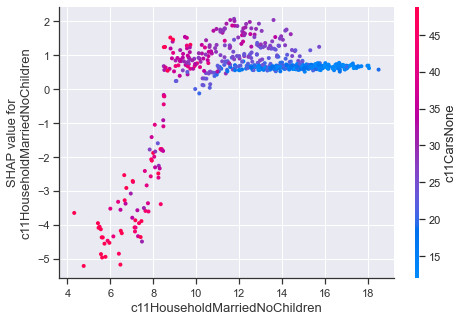

<Figure size 1152x720 with 0 Axes>

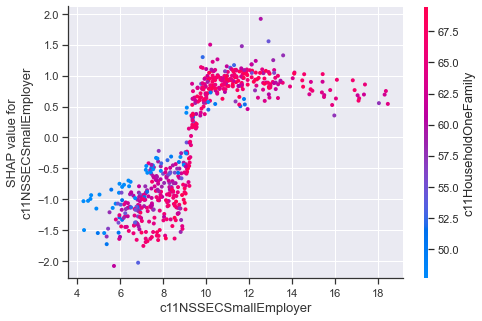

<Figure size 1152x720 with 0 Axes>

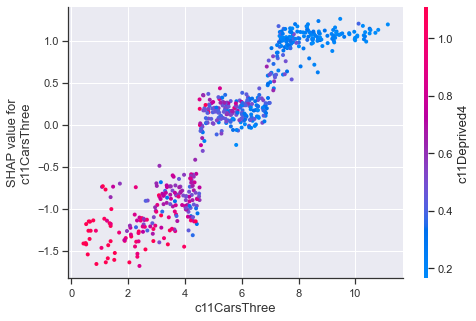

<Figure size 1152x720 with 0 Axes>

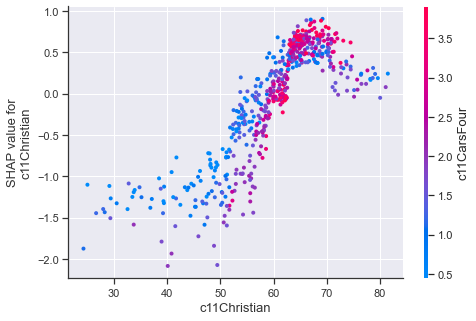

<Figure size 1152x720 with 0 Axes>

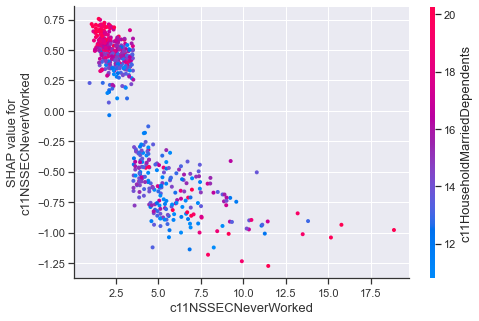

<Figure size 1152x720 with 0 Axes>

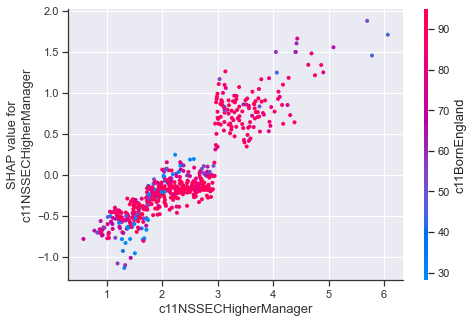

<Figure size 1152x720 with 0 Axes>

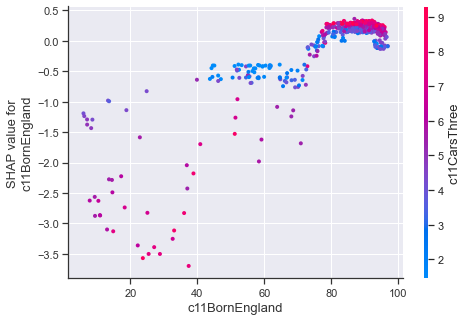

<Figure size 1152x720 with 0 Axes>

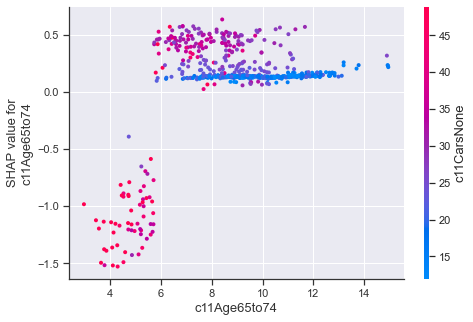

<Figure size 1152x720 with 0 Axes>

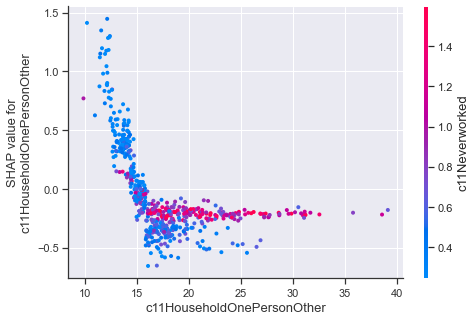

<Figure size 1152x720 with 0 Axes>

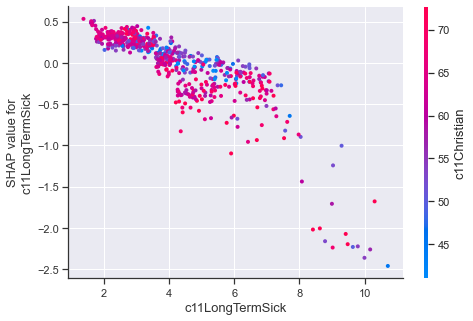

<Figure size 1152x720 with 0 Axes>

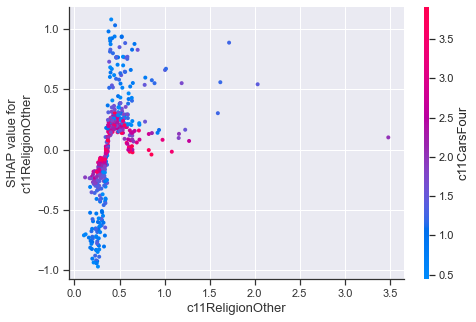

<Figure size 1152x720 with 0 Axes>

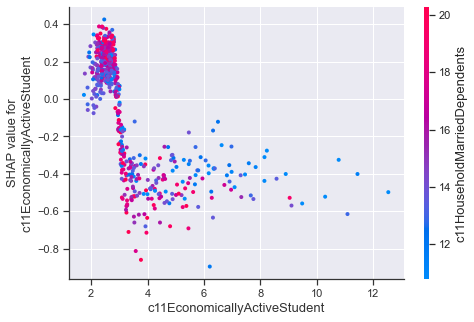

<Figure size 1152x720 with 0 Axes>

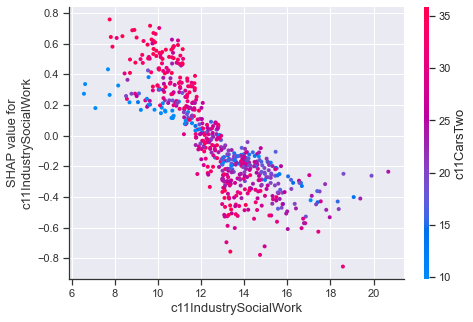

<Figure size 1152x720 with 0 Axes>

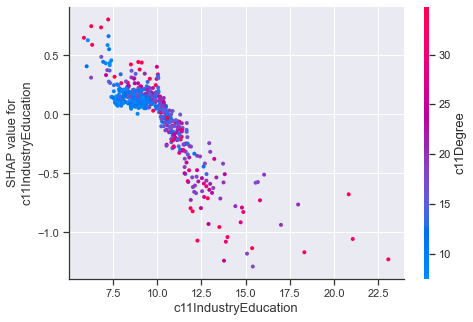

<Figure size 1152x720 with 0 Axes>

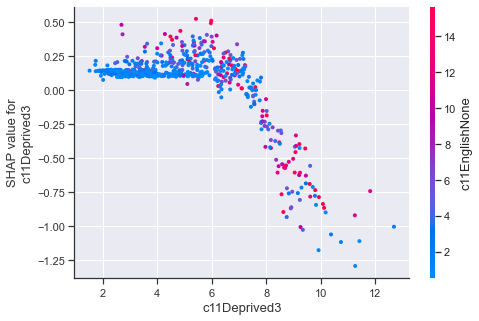

<Figure size 1152x720 with 0 Axes>

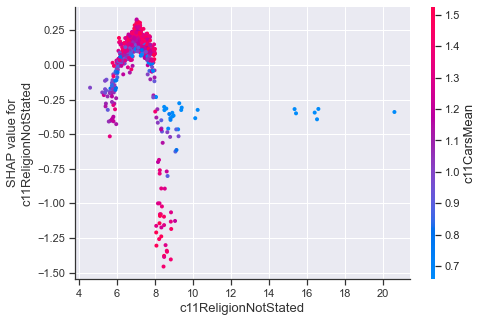

<Figure size 1152x720 with 0 Axes>

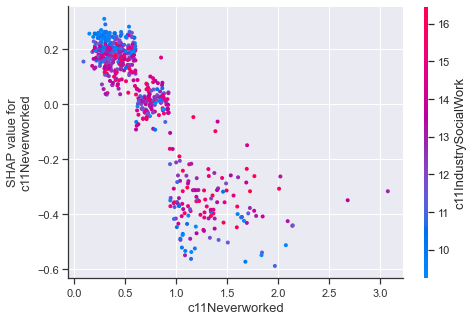

<Figure size 1152x720 with 0 Axes>

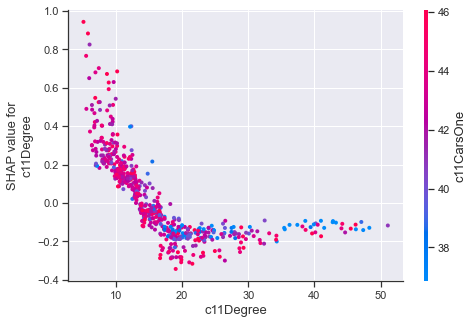

<Figure size 1152x720 with 0 Axes>

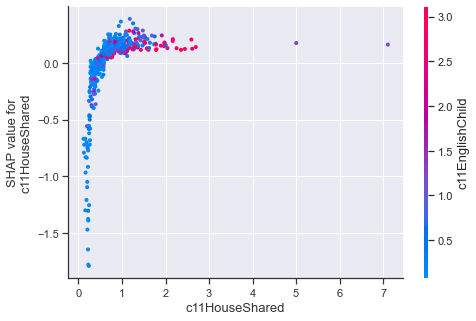

<Figure size 1152x720 with 0 Axes>

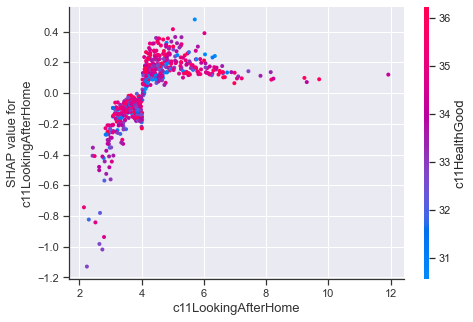

<Figure size 1152x720 with 0 Axes>

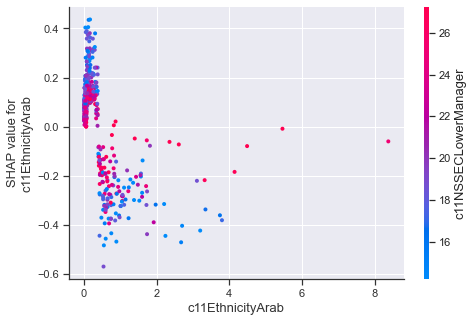

<Figure size 1152x720 with 0 Axes>

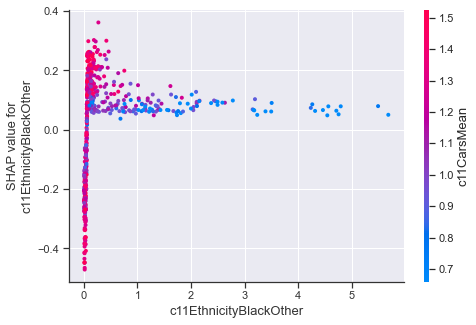

<Figure size 1152x720 with 0 Axes>

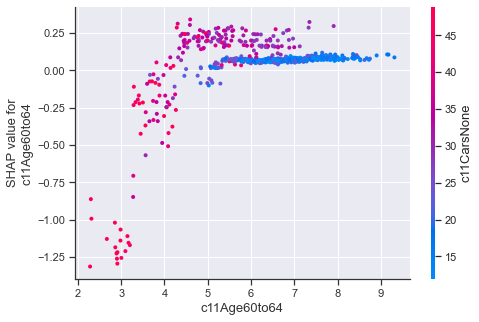

<Figure size 1152x720 with 0 Axes>

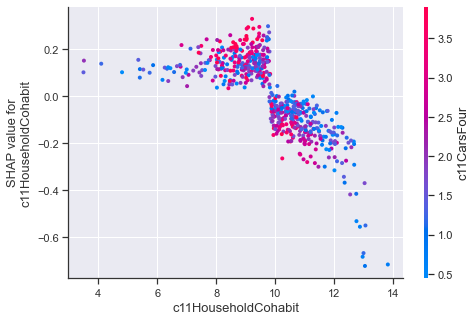

<Figure size 1152x720 with 0 Axes>

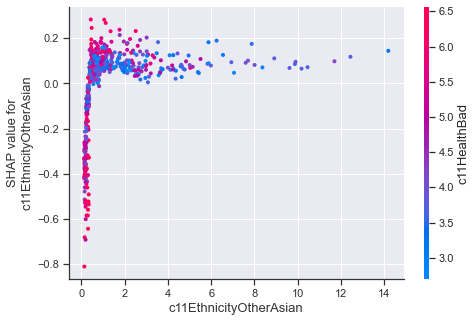

<Figure size 1152x720 with 0 Axes>

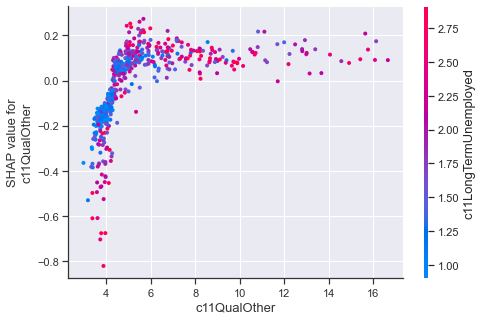

<Figure size 1152x720 with 0 Axes>

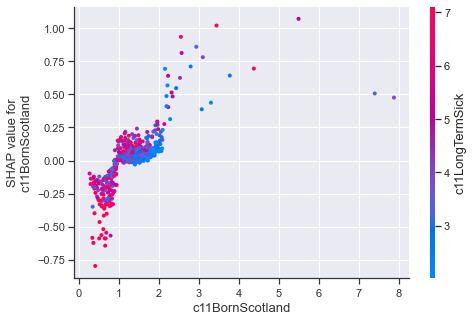

<Figure size 1152x720 with 0 Axes>

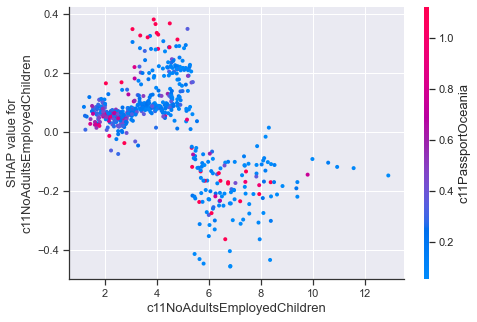

<Figure size 1152x720 with 0 Axes>

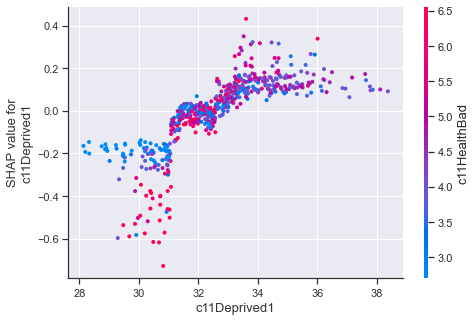

<Figure size 1152x720 with 0 Axes>

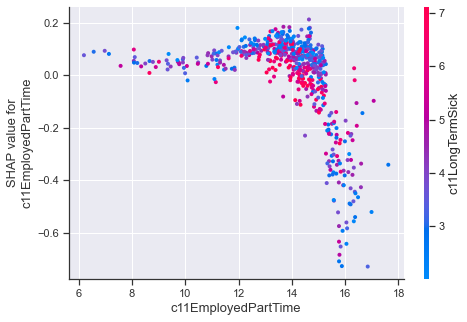

<Figure size 1152x720 with 0 Axes>

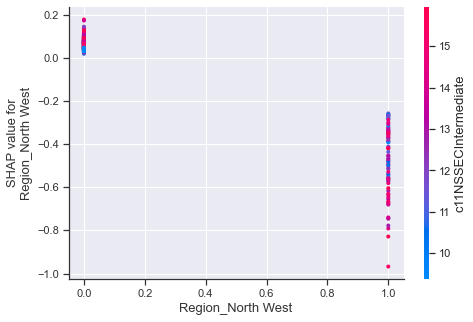

<Figure size 1152x720 with 0 Axes>

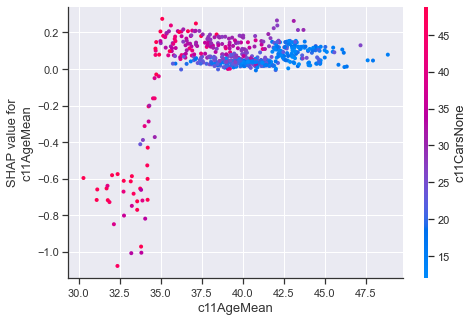

<Figure size 1152x720 with 0 Axes>

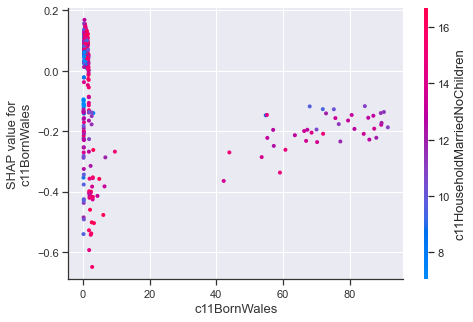

<Figure size 1152x720 with 0 Axes>

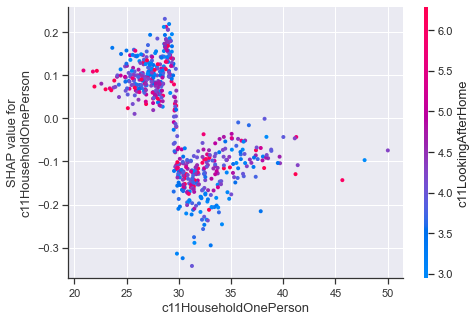

<Figure size 1152x720 with 0 Axes>

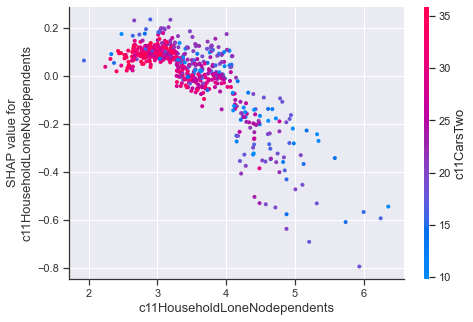

<Figure size 1152x720 with 0 Axes>

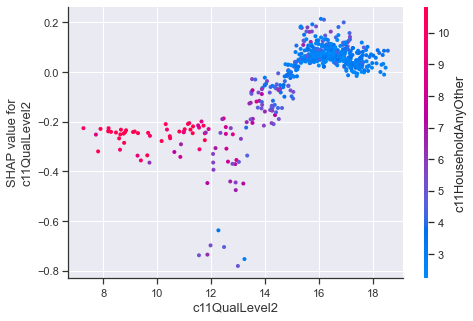

<Figure size 1152x720 with 0 Axes>

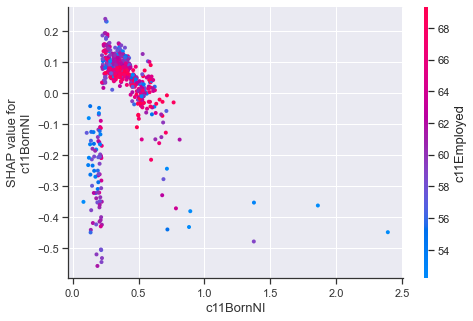

<Figure size 1152x720 with 0 Axes>

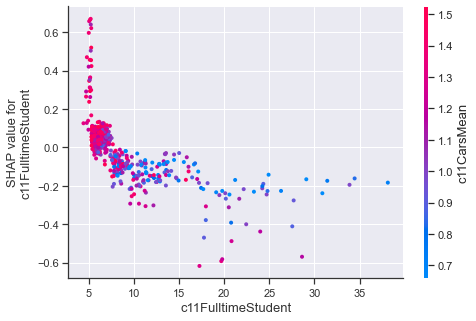

<Figure size 1152x720 with 0 Axes>

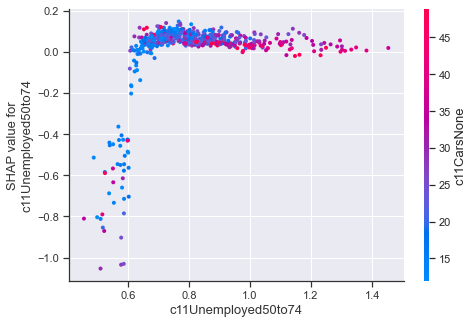

In [124]:
var_stub = "Con17"
Treatment = var_stub

var_list = [var_stub]
var_stub_list = [var_stub,]
mask = df_simp[var_stub].notnull() & (BES_census_data["Country"]!="Scotland")
wt_cols = ["leaveHanretty","remainHanretty",
          ]
min_features = 30
colname = "Con17"
dependence_plots = True

alg = get_xgboost_alg(classification_problem=False)
title = "Con17_minusScotland_minusHanretty_mean_inc"

(explainer, shap_values, train_columns, train_index, alg,output_subfolder)=\
    xgboost_run(subdir=colname,dataset=df_simp[mask].drop(wt_cols,axis=1),
            var_list=var_list,var_stub_list=var_stub_list,
            use_specific_weights=None,
            min_features = min(df_simp.shape[1]-1,min_features),verbosity=0,
            skip_bar_plot=True,dependence_plots=dependence_plots,alg=alg,eval_metric=eval_metric,                    
            title = title)

MSE: 27.69, MAE: 4.21, EV: 0.88, R2: 0.88


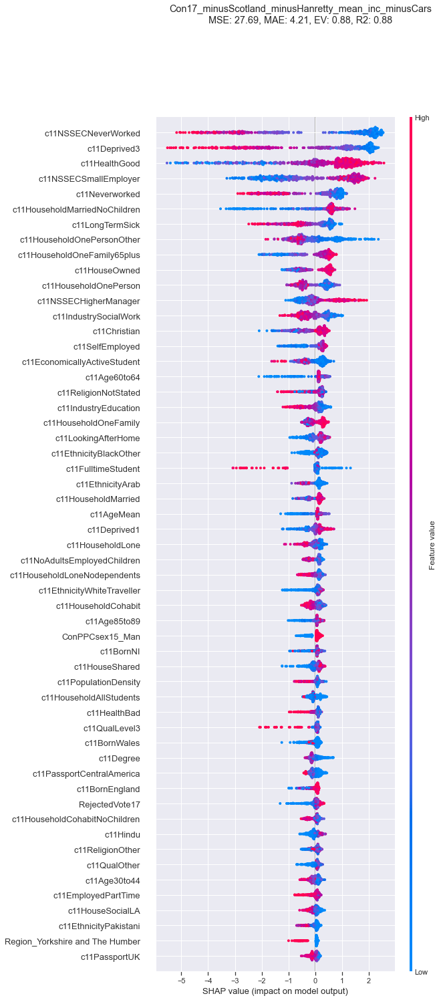

<Figure size 1152x720 with 0 Axes>

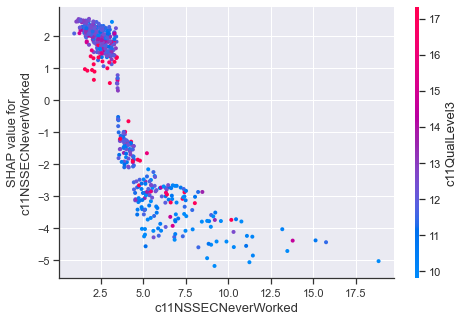

<Figure size 1152x720 with 0 Axes>

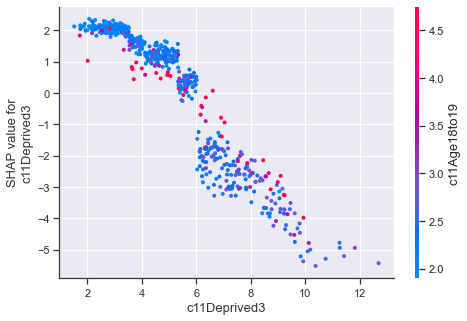

<Figure size 1152x720 with 0 Axes>

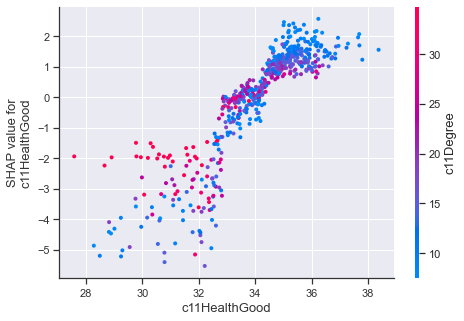

<Figure size 1152x720 with 0 Axes>

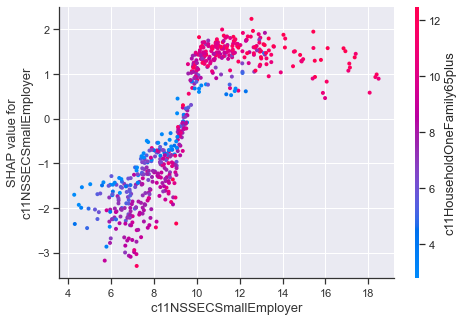

<Figure size 1152x720 with 0 Axes>

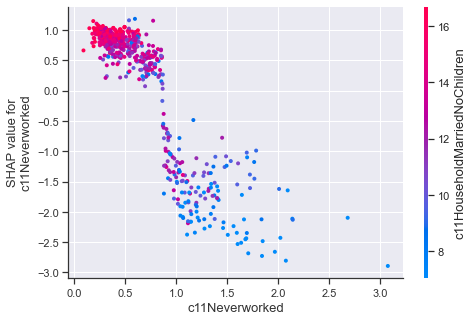

<Figure size 1152x720 with 0 Axes>

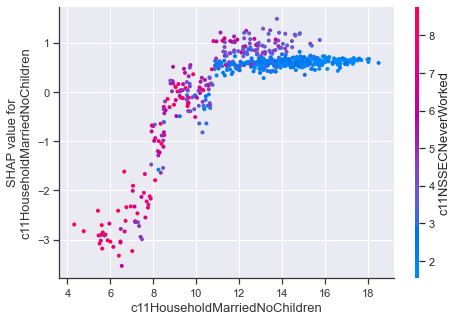

<Figure size 1152x720 with 0 Axes>

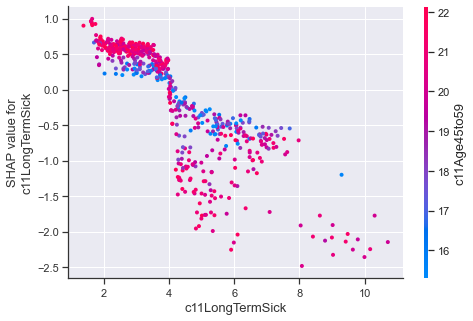

<Figure size 1152x720 with 0 Axes>

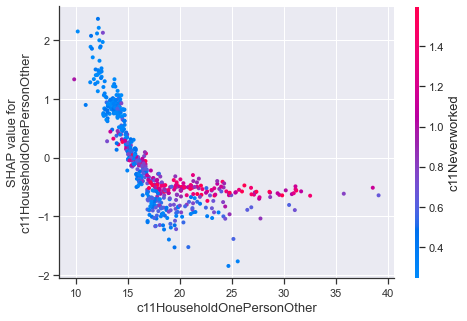

<Figure size 1152x720 with 0 Axes>

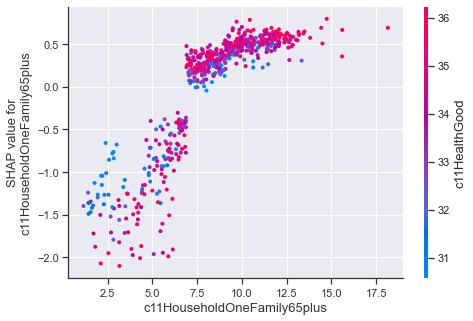

<Figure size 1152x720 with 0 Axes>

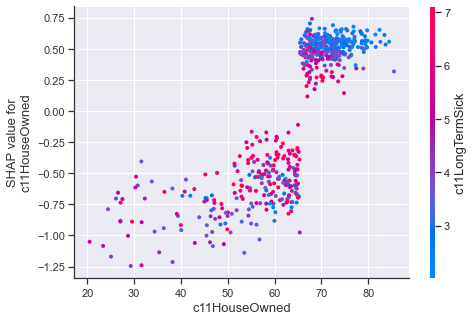

<Figure size 1152x720 with 0 Axes>

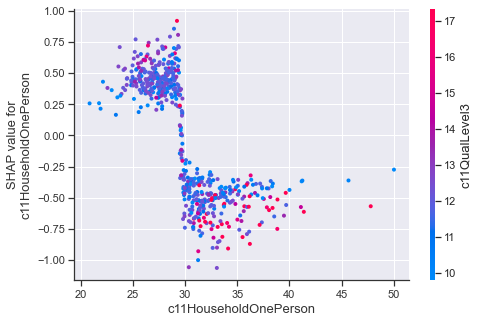

<Figure size 1152x720 with 0 Axes>

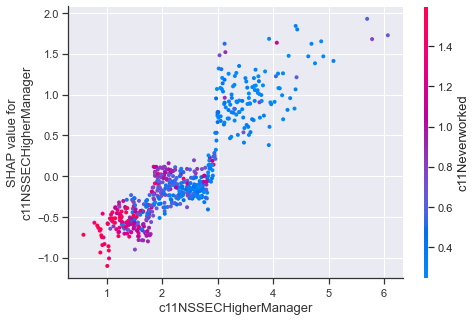

<Figure size 1152x720 with 0 Axes>

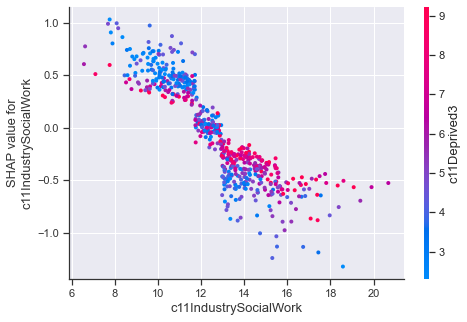

<Figure size 1152x720 with 0 Axes>

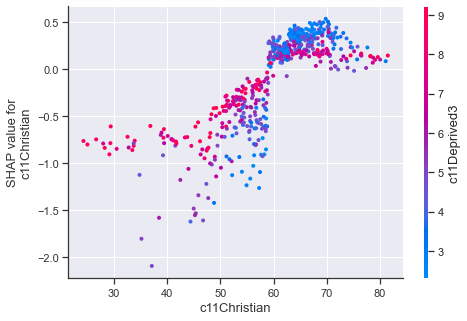

<Figure size 1152x720 with 0 Axes>

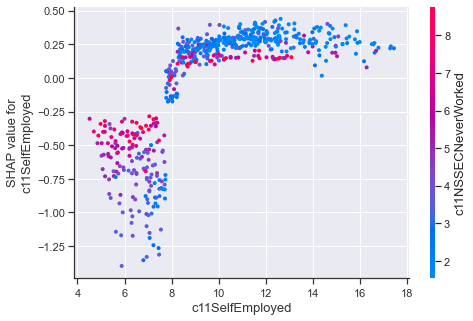

<Figure size 1152x720 with 0 Axes>

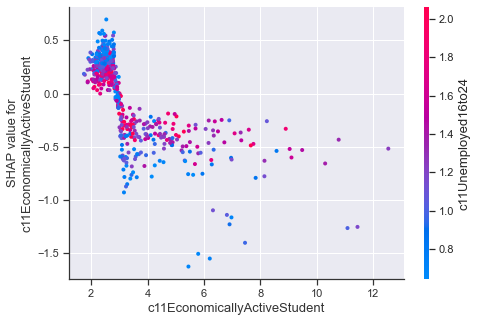

<Figure size 1152x720 with 0 Axes>

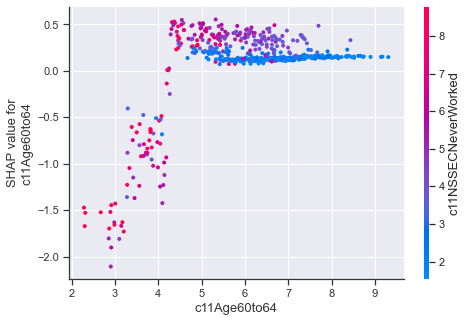

<Figure size 1152x720 with 0 Axes>

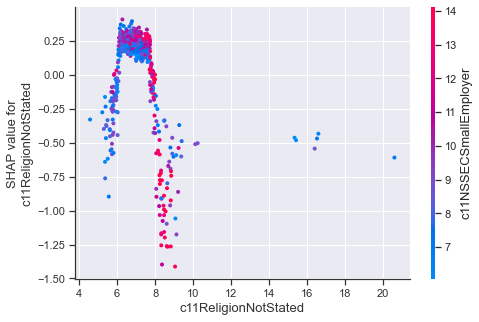

<Figure size 1152x720 with 0 Axes>

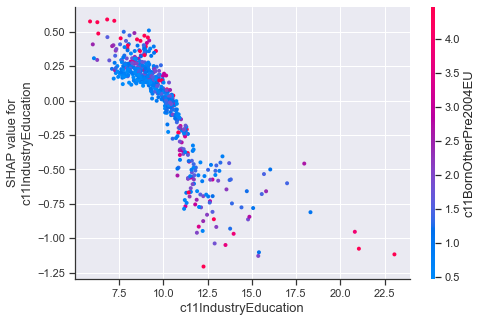

<Figure size 1152x720 with 0 Axes>

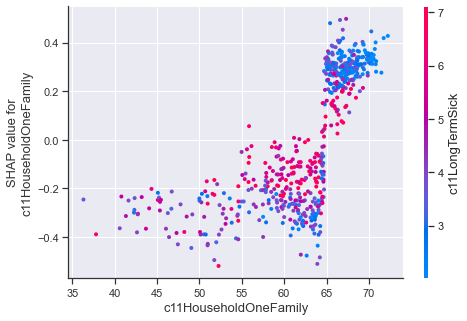

<Figure size 1152x720 with 0 Axes>

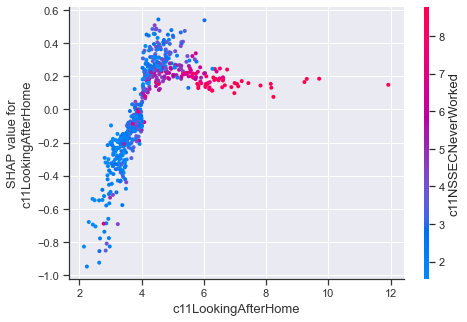

<Figure size 1152x720 with 0 Axes>

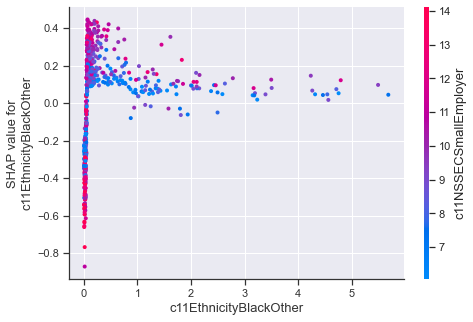

<Figure size 1152x720 with 0 Axes>

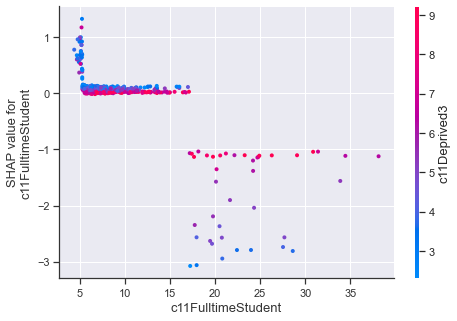

<Figure size 1152x720 with 0 Axes>

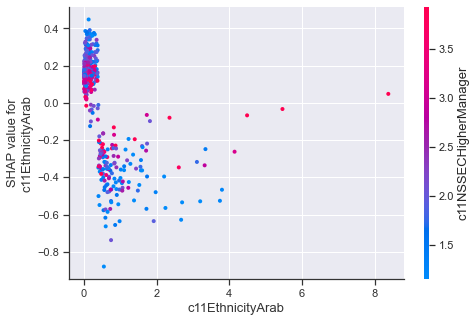

<Figure size 1152x720 with 0 Axes>

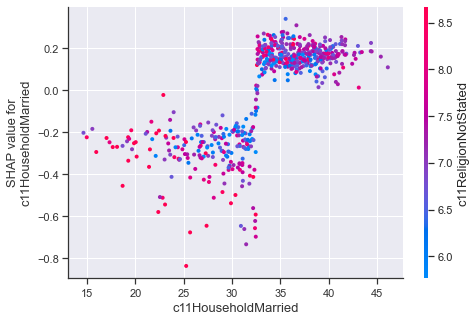

<Figure size 1152x720 with 0 Axes>

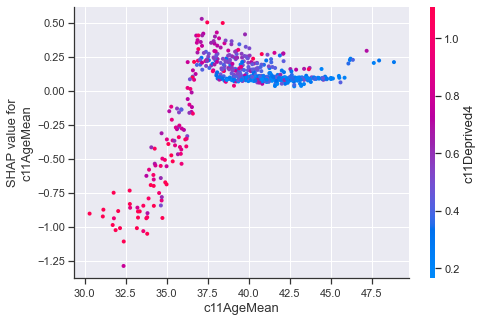

<Figure size 1152x720 with 0 Axes>

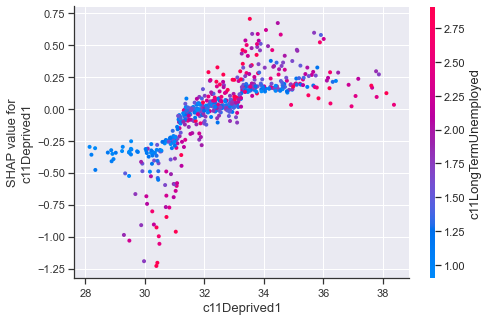

<Figure size 1152x720 with 0 Axes>

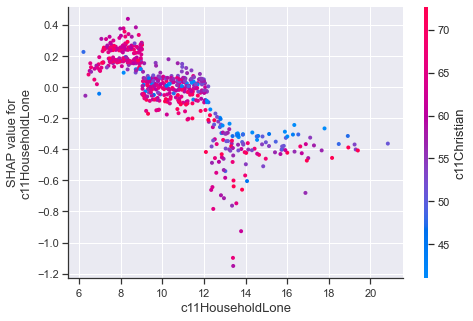

<Figure size 1152x720 with 0 Axes>

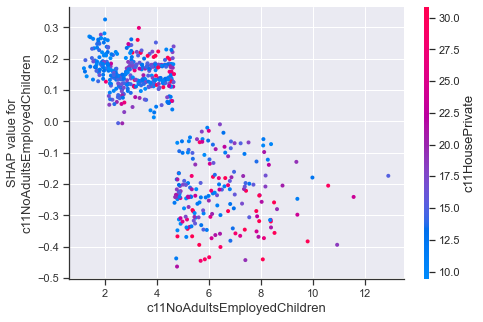

<Figure size 1152x720 with 0 Axes>

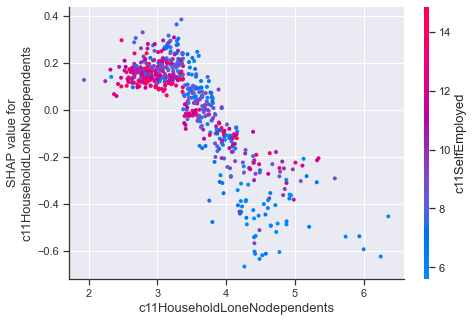

<Figure size 1152x720 with 0 Axes>

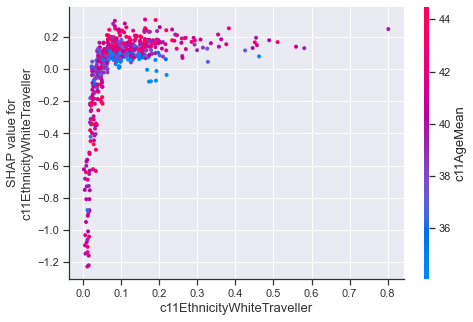

<Figure size 1152x720 with 0 Axes>

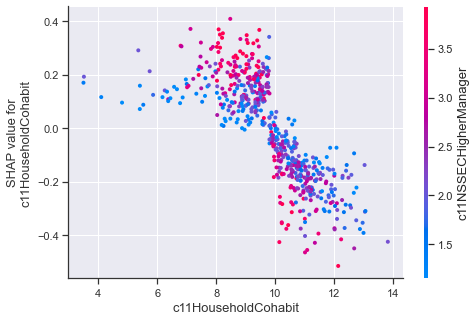

<Figure size 1152x720 with 0 Axes>

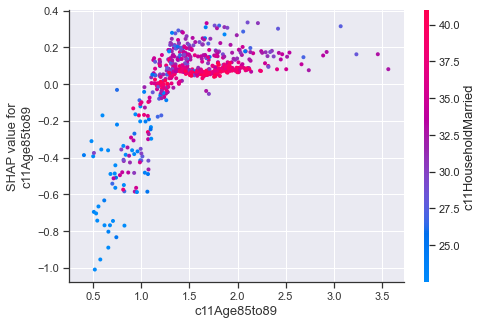

<Figure size 1152x720 with 0 Axes>

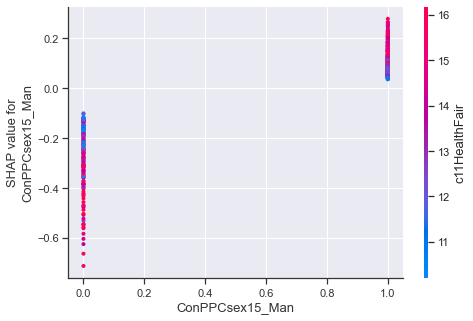

<Figure size 1152x720 with 0 Axes>

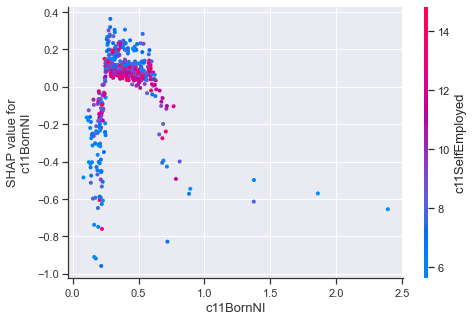

<Figure size 1152x720 with 0 Axes>

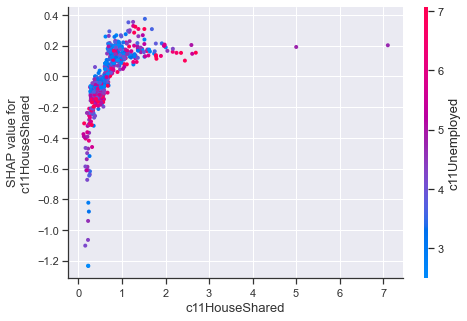

<Figure size 1152x720 with 0 Axes>

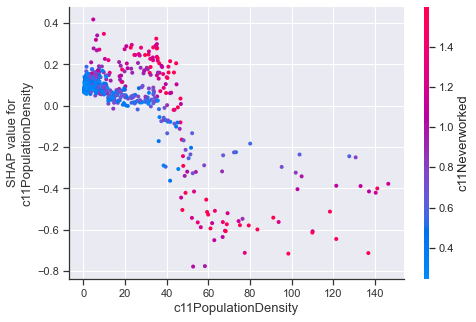

<Figure size 1152x720 with 0 Axes>

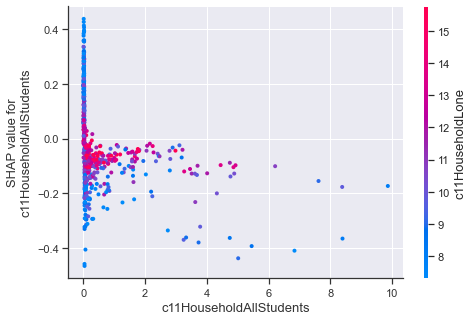

<Figure size 1152x720 with 0 Axes>

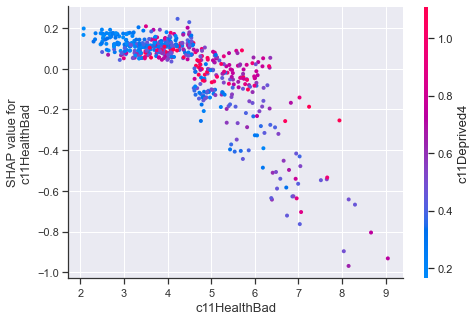

<Figure size 1152x720 with 0 Axes>

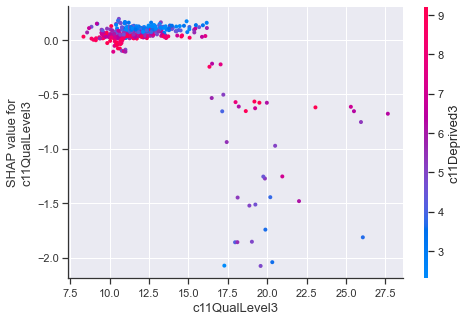

<Figure size 1152x720 with 0 Axes>

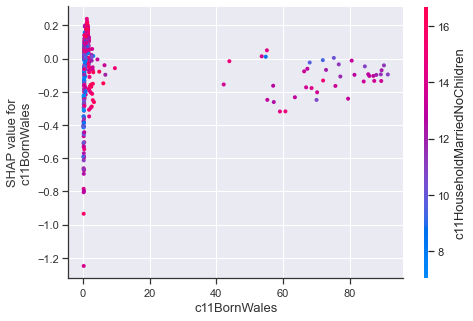

<Figure size 1152x720 with 0 Axes>

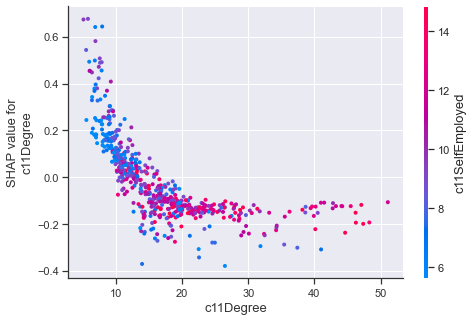

<Figure size 1152x720 with 0 Axes>

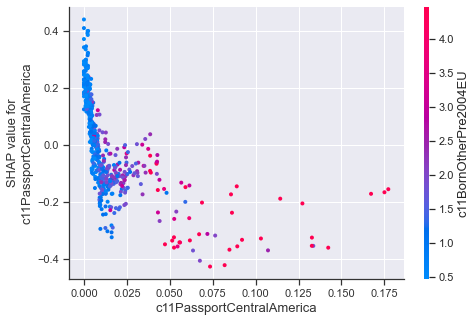

<Figure size 1152x720 with 0 Axes>

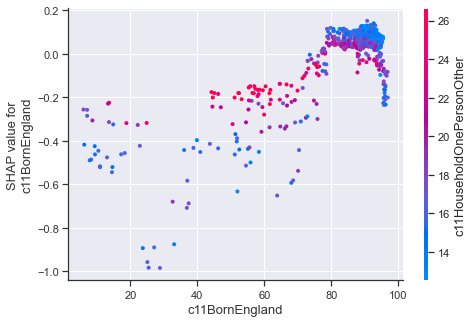

<Figure size 1152x720 with 0 Axes>

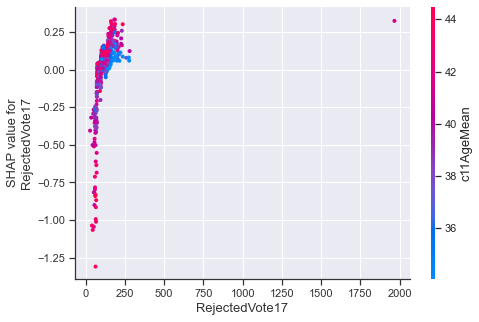

<Figure size 1152x720 with 0 Axes>

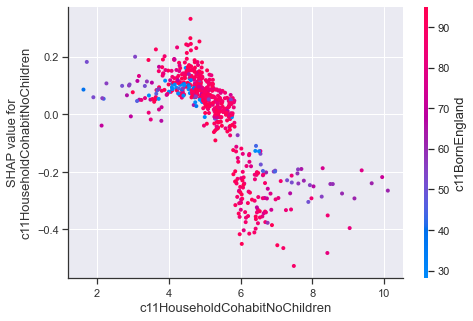

<Figure size 1152x720 with 0 Axes>

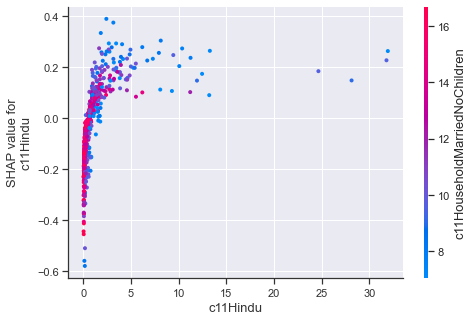

<Figure size 1152x720 with 0 Axes>

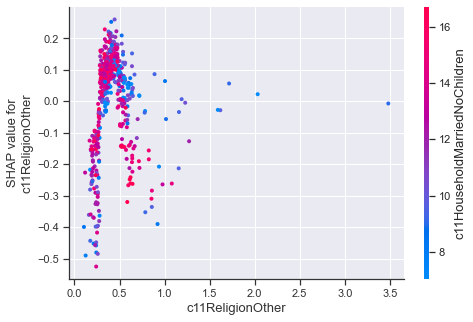

<Figure size 1152x720 with 0 Axes>

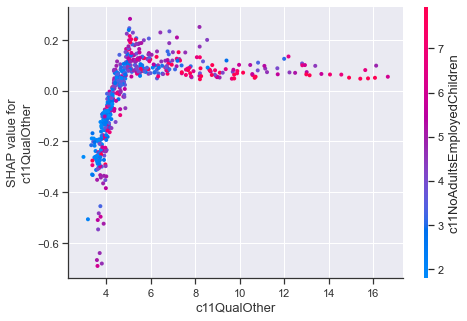

<Figure size 1152x720 with 0 Axes>

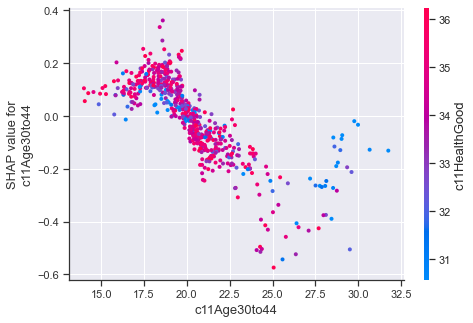

<Figure size 1152x720 with 0 Axes>

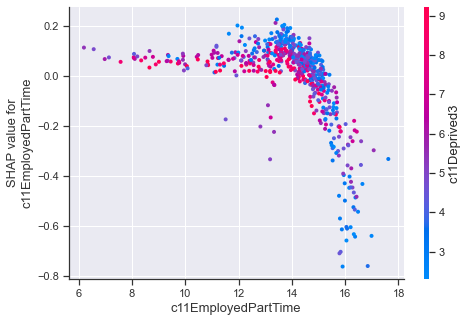

<Figure size 1152x720 with 0 Axes>

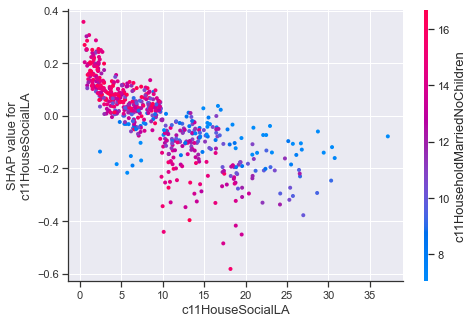

<Figure size 1152x720 with 0 Axes>

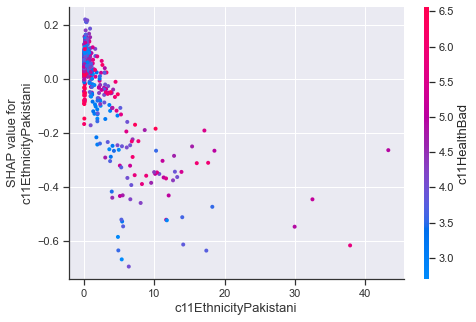

<Figure size 1152x720 with 0 Axes>

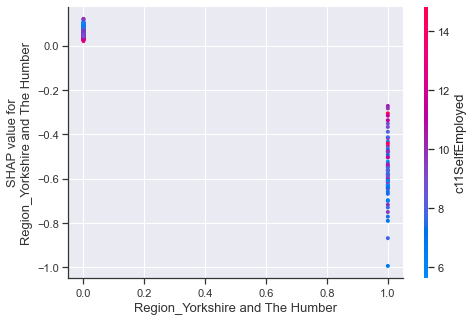

<Figure size 1152x720 with 0 Axes>

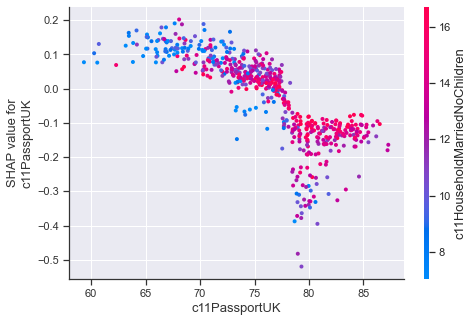

In [134]:
var_stub = "Con17"
Treatment = var_stub

var_list = [var_stub]
var_stub_list = [var_stub,]
mask = df_simp[var_stub].notnull() & (BES_census_data["Country"]!="Scotland")
wt_cols = ["leaveHanretty","remainHanretty",
          'c11CarsNone', 'c11CarsOne', 'c11CarsTwo', 'c11CarsThree', 'c11CarsFour', 'c11CarsMean']
min_features = 30
colname = "Con17"
dependence_plots = True

alg = get_xgboost_alg(classification_problem=False)
title = "Con17_minusScotland_minusHanretty_mean_inc_minusCars"

(explainer, shap_values, train_columns, train_index, alg,output_subfolder)=\
    xgboost_run(subdir=colname,dataset=df_simp[mask].drop(wt_cols,axis=1),
            var_list=var_list,var_stub_list=var_stub_list,
            use_specific_weights=None,
            min_features = min(df_simp.shape[1]-1,min_features),verbosity=0,
            skip_bar_plot=True,dependence_plots=dependence_plots,alg=alg,eval_metric=eval_metric,                    
            title = title)

MSE: 29.24, MAE: 4.41, EV: 0.87, R2: 0.87


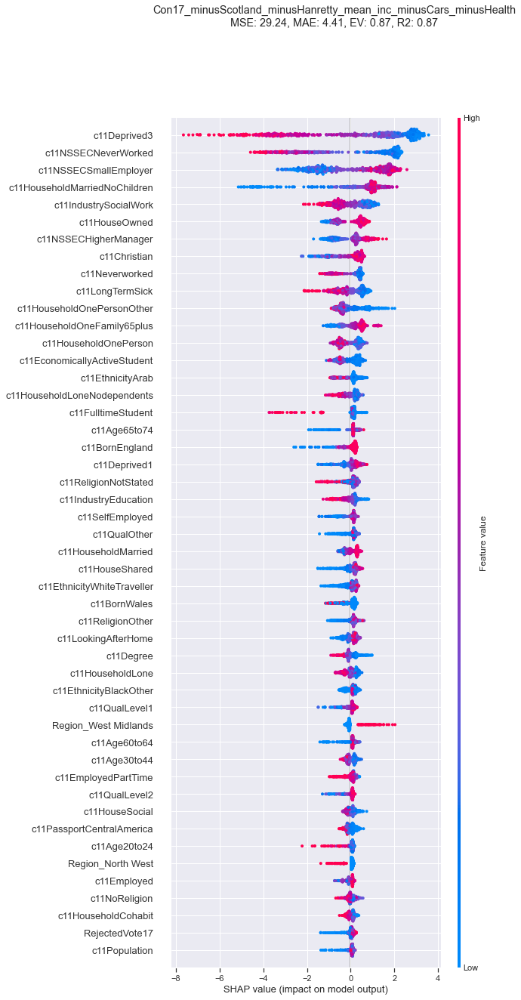

<Figure size 1152x720 with 0 Axes>

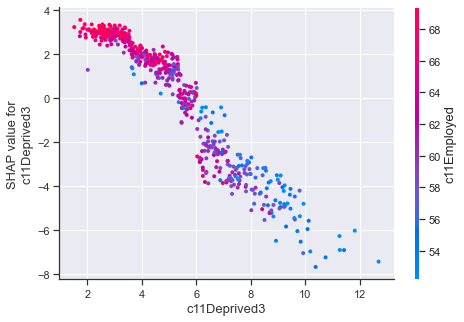

<Figure size 1152x720 with 0 Axes>

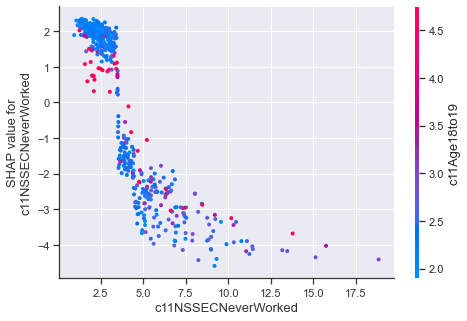

<Figure size 1152x720 with 0 Axes>

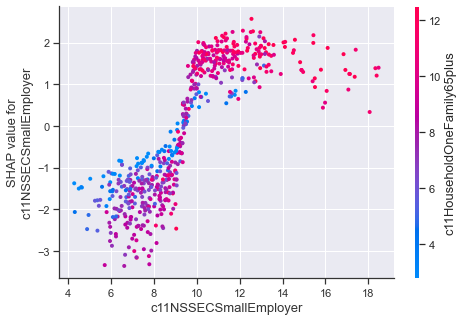

<Figure size 1152x720 with 0 Axes>

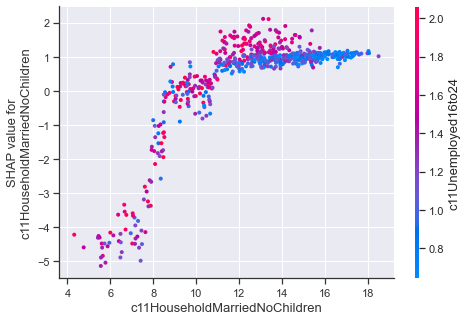

<Figure size 1152x720 with 0 Axes>

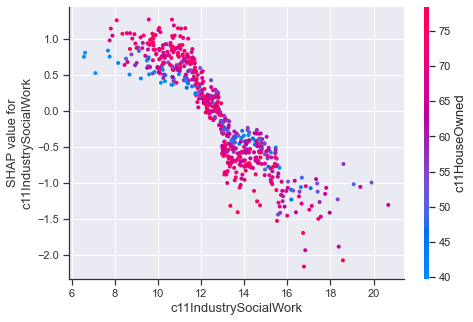

<Figure size 1152x720 with 0 Axes>

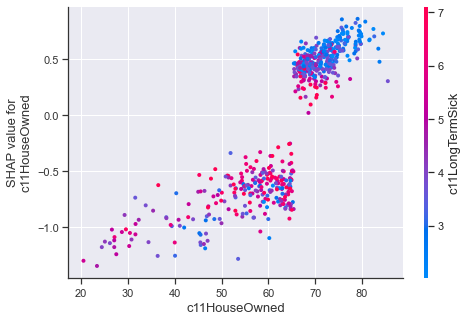

<Figure size 1152x720 with 0 Axes>

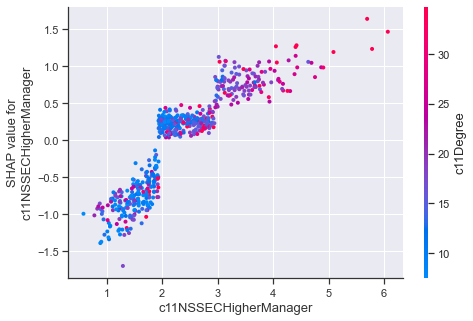

<Figure size 1152x720 with 0 Axes>

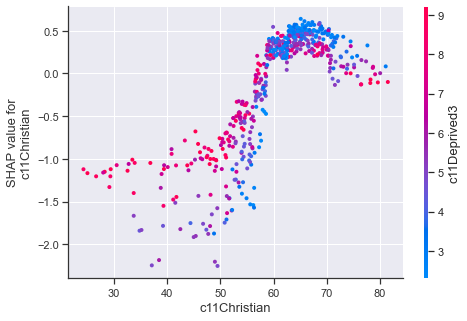

<Figure size 1152x720 with 0 Axes>

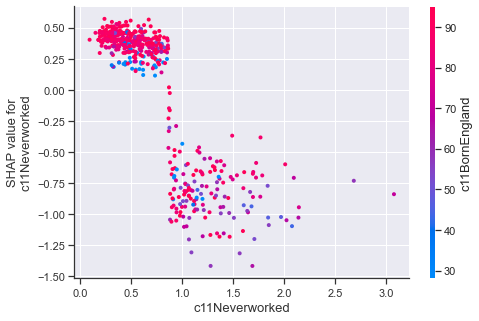

<Figure size 1152x720 with 0 Axes>

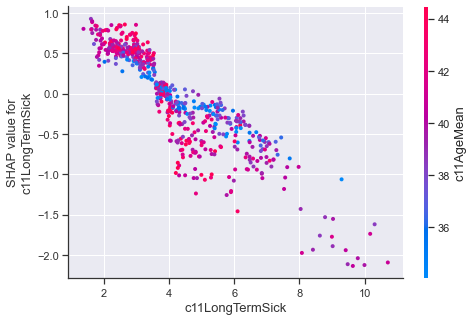

<Figure size 1152x720 with 0 Axes>

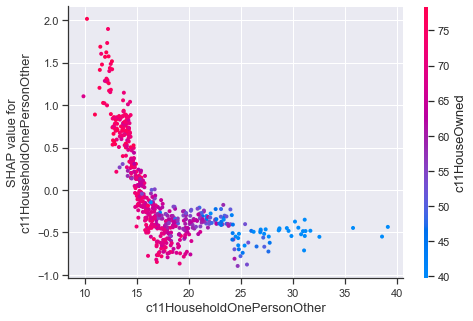

<Figure size 1152x720 with 0 Axes>

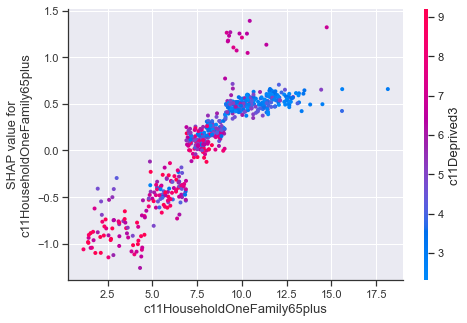

<Figure size 1152x720 with 0 Axes>

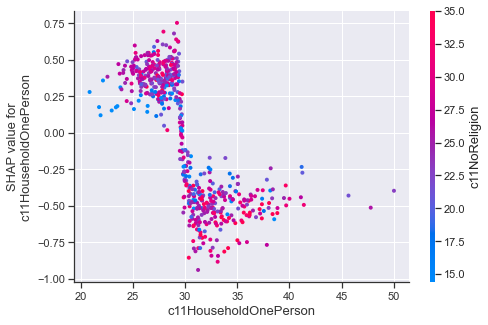

<Figure size 1152x720 with 0 Axes>

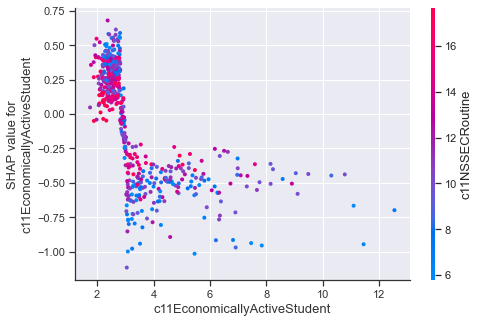

<Figure size 1152x720 with 0 Axes>

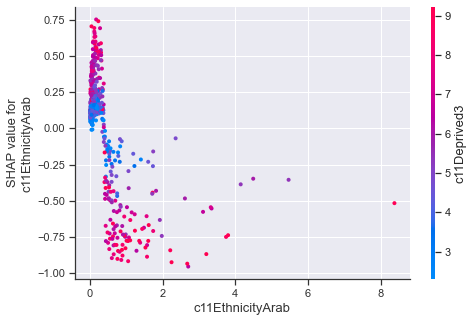

<Figure size 1152x720 with 0 Axes>

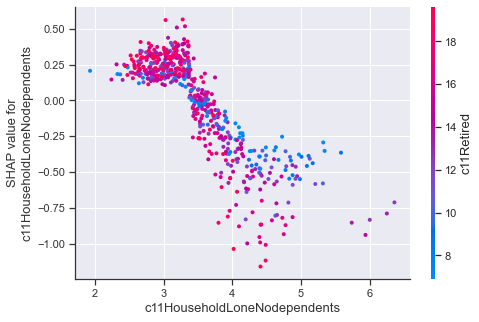

<Figure size 1152x720 with 0 Axes>

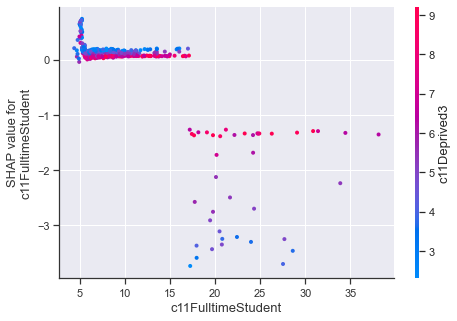

<Figure size 1152x720 with 0 Axes>

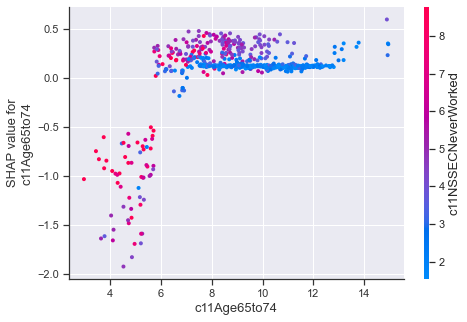

<Figure size 1152x720 with 0 Axes>

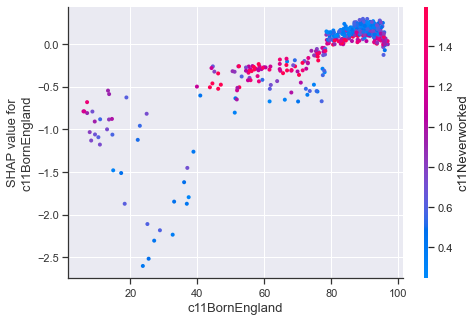

<Figure size 1152x720 with 0 Axes>

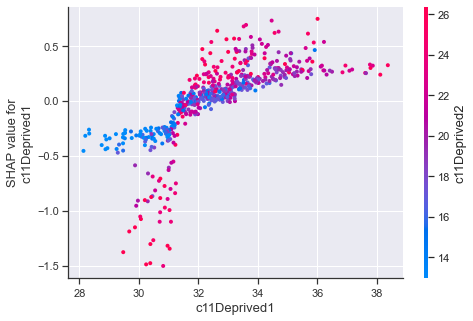

<Figure size 1152x720 with 0 Axes>

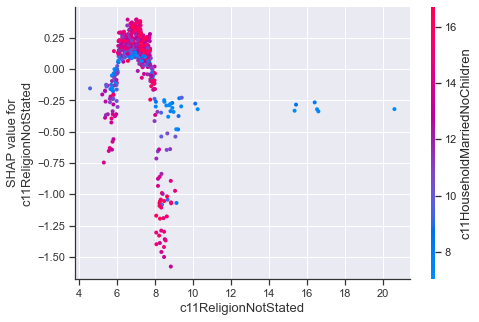

<Figure size 1152x720 with 0 Axes>

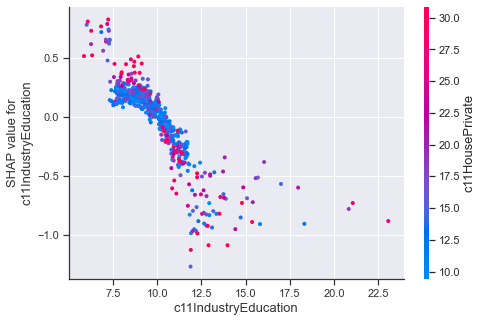

<Figure size 1152x720 with 0 Axes>

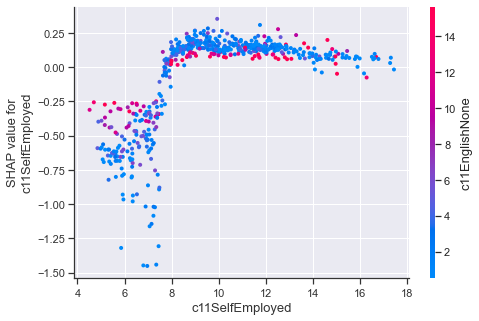

<Figure size 1152x720 with 0 Axes>

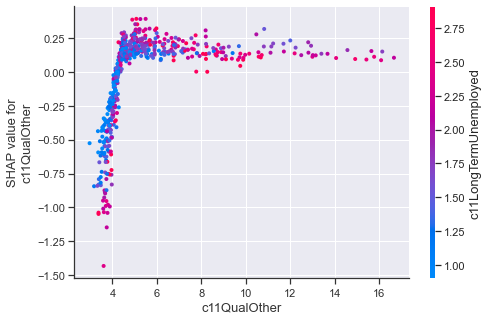

<Figure size 1152x720 with 0 Axes>

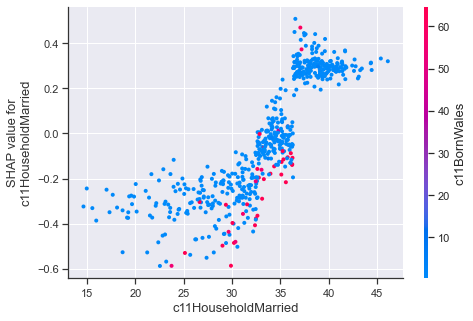

<Figure size 1152x720 with 0 Axes>

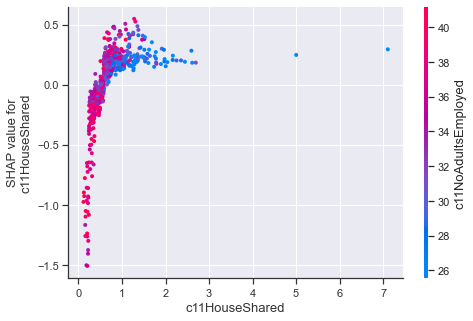

<Figure size 1152x720 with 0 Axes>

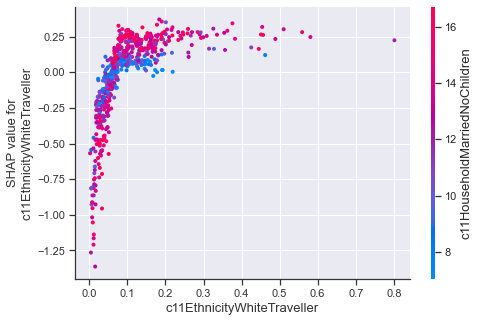

<Figure size 1152x720 with 0 Axes>

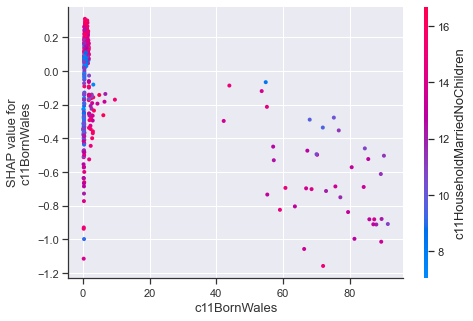

<Figure size 1152x720 with 0 Axes>

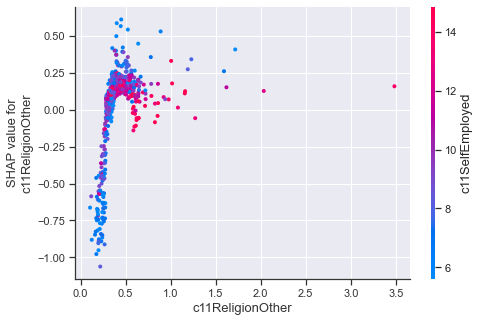

<Figure size 1152x720 with 0 Axes>

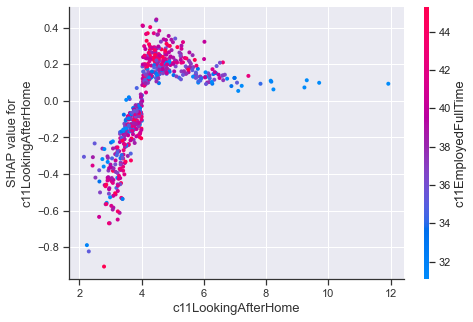

<Figure size 1152x720 with 0 Axes>

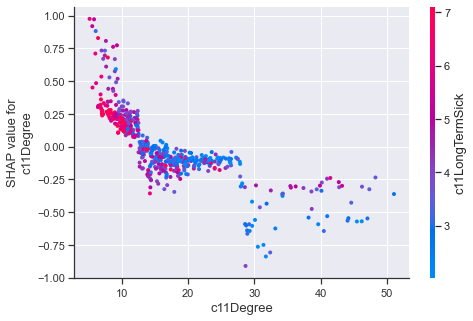

<Figure size 1152x720 with 0 Axes>

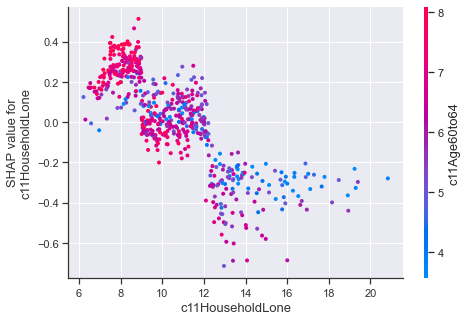

<Figure size 1152x720 with 0 Axes>

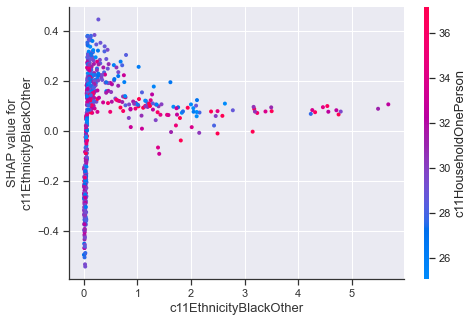

<Figure size 1152x720 with 0 Axes>

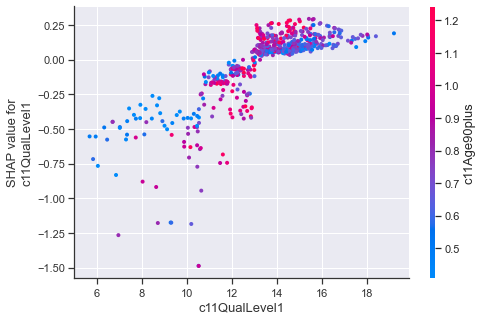

<Figure size 1152x720 with 0 Axes>

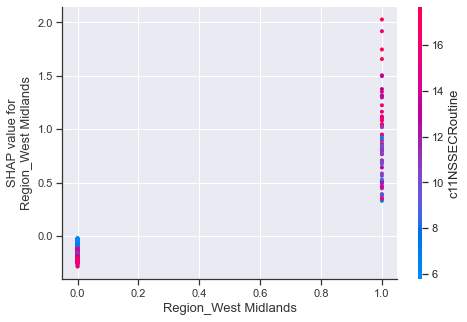

<Figure size 1152x720 with 0 Axes>

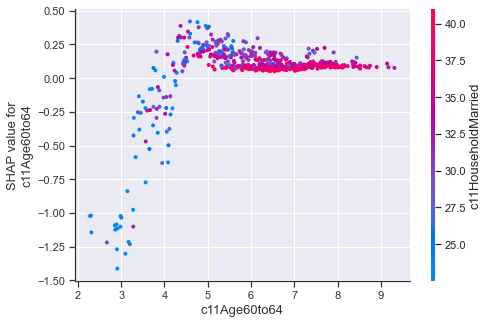

<Figure size 1152x720 with 0 Axes>

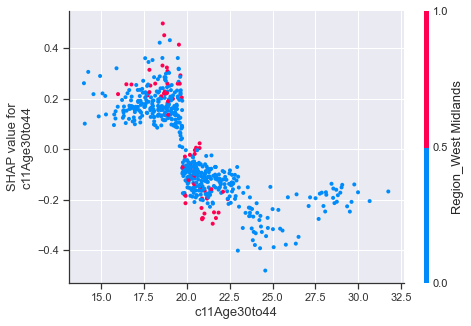

<Figure size 1152x720 with 0 Axes>

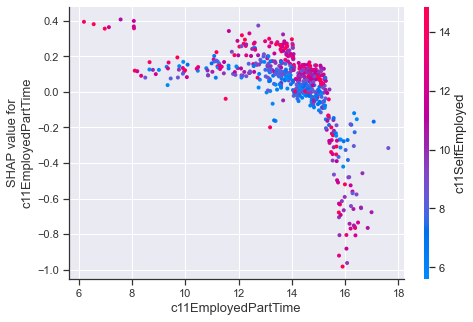

<Figure size 1152x720 with 0 Axes>

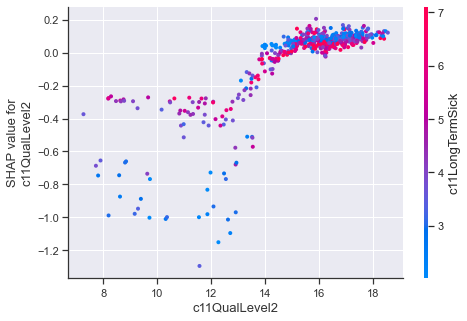

<Figure size 1152x720 with 0 Axes>

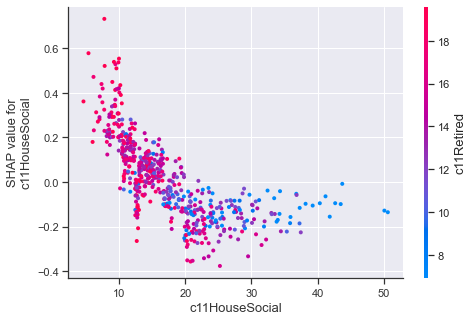

<Figure size 1152x720 with 0 Axes>

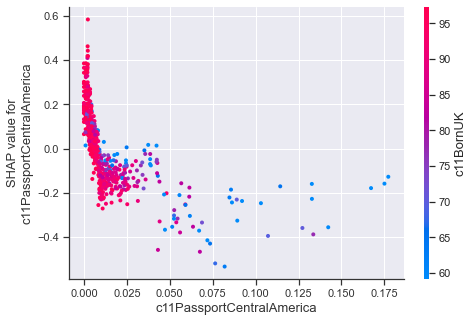

<Figure size 1152x720 with 0 Axes>

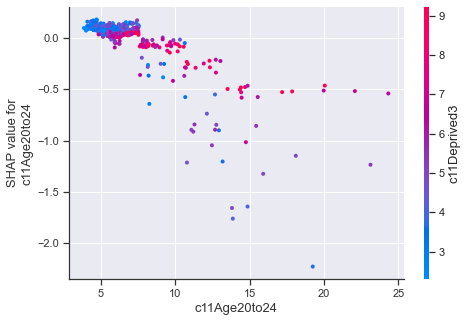

<Figure size 1152x720 with 0 Axes>

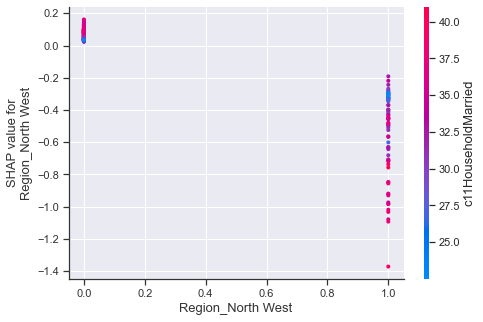

<Figure size 1152x720 with 0 Axes>

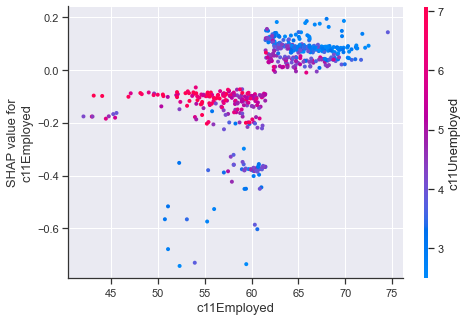

<Figure size 1152x720 with 0 Axes>

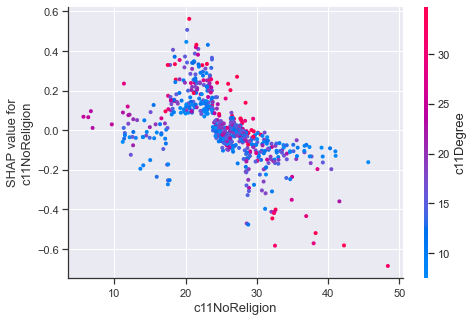

<Figure size 1152x720 with 0 Axes>

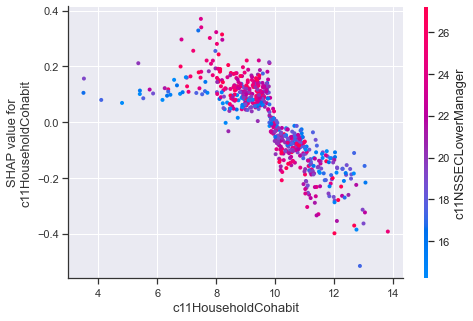

<Figure size 1152x720 with 0 Axes>

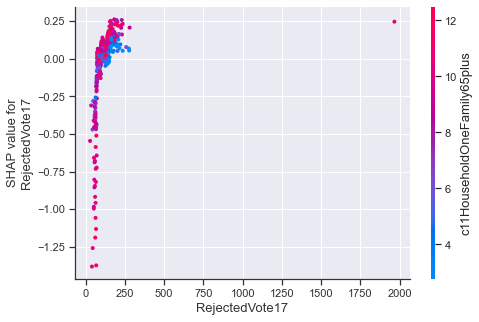

<Figure size 1152x720 with 0 Axes>

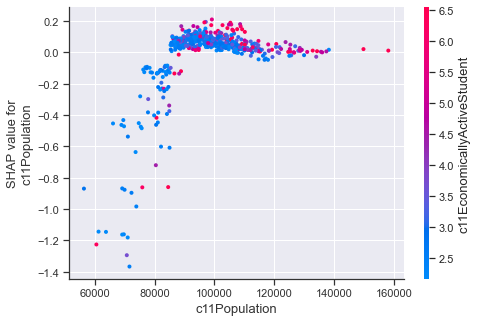

In [136]:
var_stub = "Con17"
Treatment = var_stub

var_list = [var_stub]
var_stub_list = [var_stub,]
mask = df_simp[var_stub].notnull() & (BES_census_data["Country"]!="Scotland")
wt_cols = ["leaveHanretty","remainHanretty",
          'c11CarsNone', 'c11CarsOne', 'c11CarsTwo', 'c11CarsThree', 'c11CarsFour', 'c11CarsMean',
          'c11HealthVeryGood', 'c11HealthGood', 'c11HealthFair', 'c11HealthBad','c11HealthVeryBad']
min_features = 30
colname = "Con17"
dependence_plots = True

alg = get_xgboost_alg(classification_problem=False)
title = "Con17_minusScotland_minusHanretty_mean_inc_minusCars_minusHealth"

(explainer, shap_values, train_columns, train_index, alg,output_subfolder)=\
    xgboost_run(subdir=colname,dataset=df_simp[mask].drop(wt_cols,axis=1),
            var_list=var_list,var_stub_list=var_stub_list,
            use_specific_weights=None,
            min_features = min(df_simp.shape[1]-1,min_features),verbosity=0,
            skip_bar_plot=True,dependence_plots=dependence_plots,alg=alg,eval_metric=eval_metric,                    
            title = title)

MSE: 28.10, MAE: 4.27, EV: 0.87, R2: 0.87


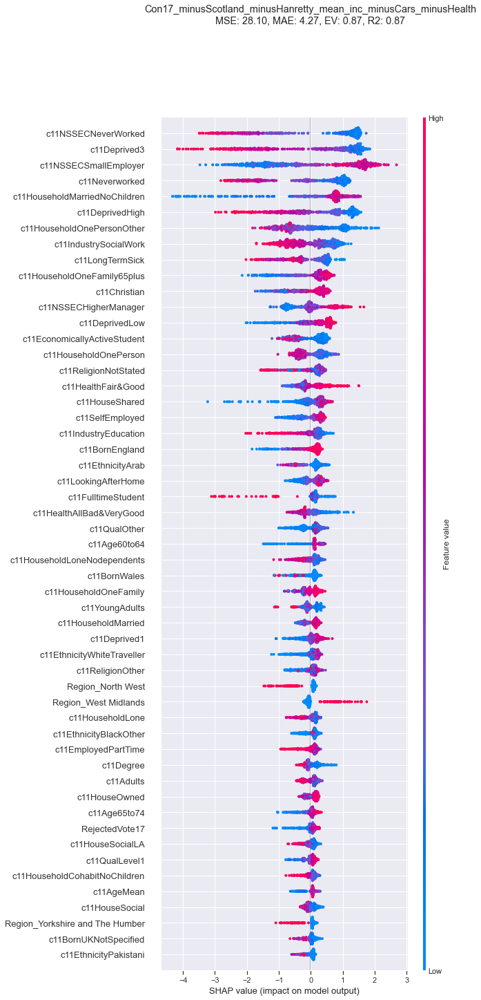

<Figure size 1152x720 with 0 Axes>

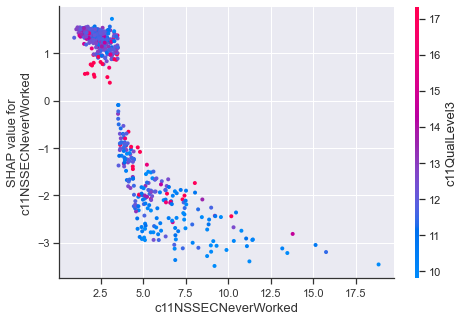

<Figure size 1152x720 with 0 Axes>

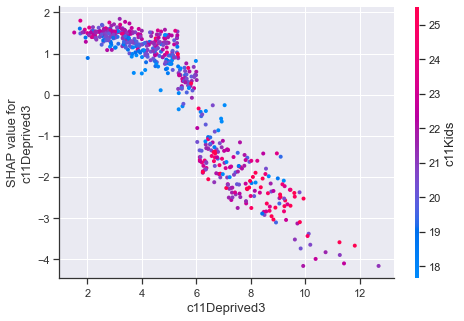

<Figure size 1152x720 with 0 Axes>

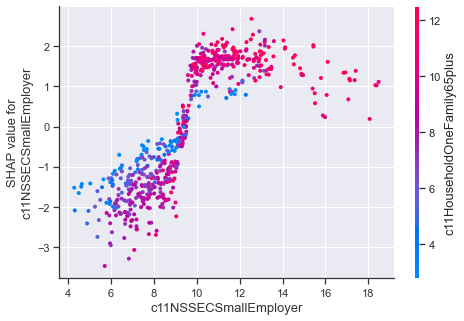

<Figure size 1152x720 with 0 Axes>

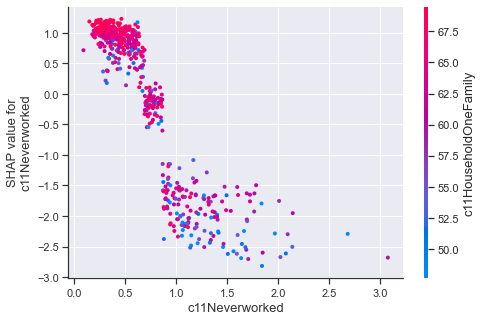

<Figure size 1152x720 with 0 Axes>

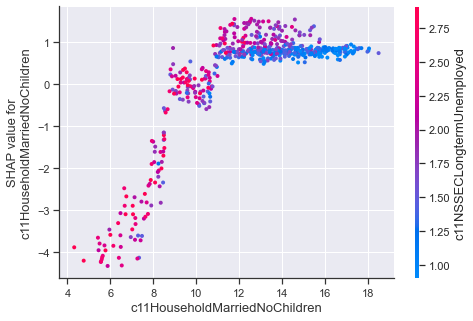

<Figure size 1152x720 with 0 Axes>

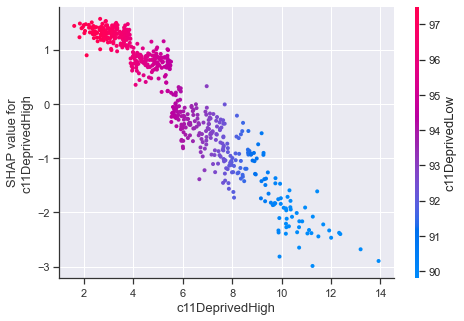

<Figure size 1152x720 with 0 Axes>

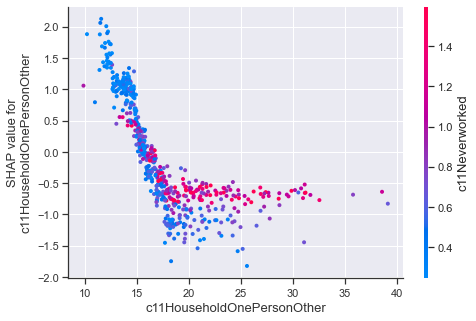

<Figure size 1152x720 with 0 Axes>

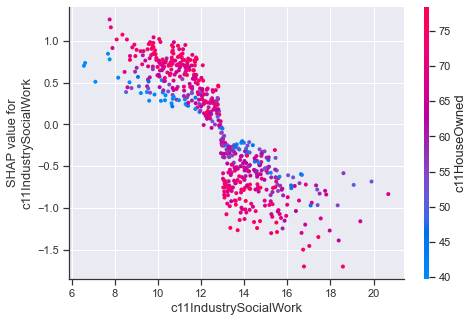

<Figure size 1152x720 with 0 Axes>

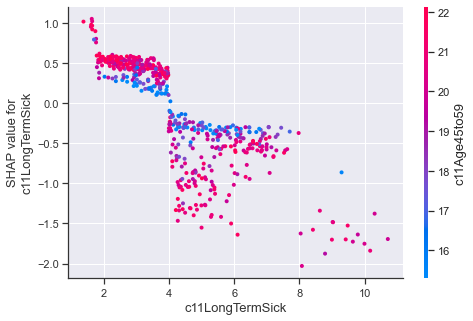

<Figure size 1152x720 with 0 Axes>

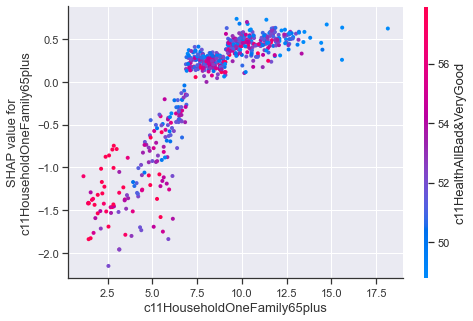

<Figure size 1152x720 with 0 Axes>

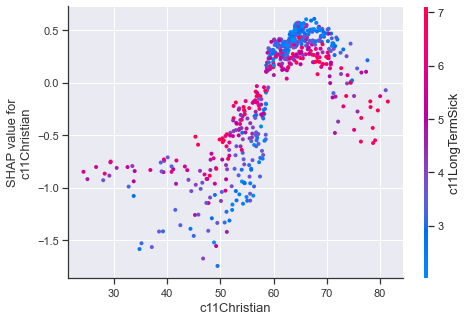

<Figure size 1152x720 with 0 Axes>

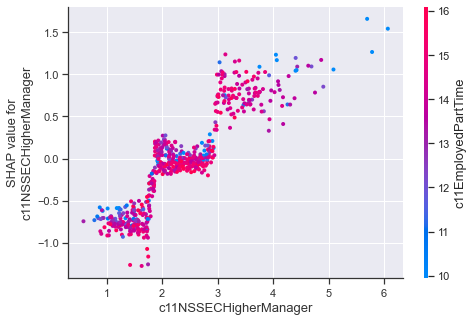

<Figure size 1152x720 with 0 Axes>

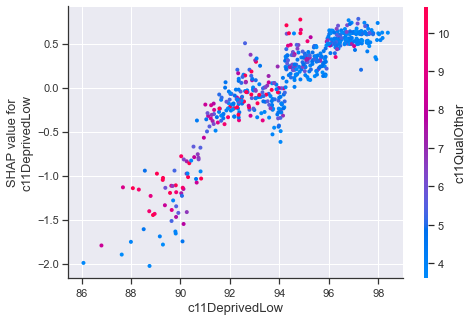

<Figure size 1152x720 with 0 Axes>

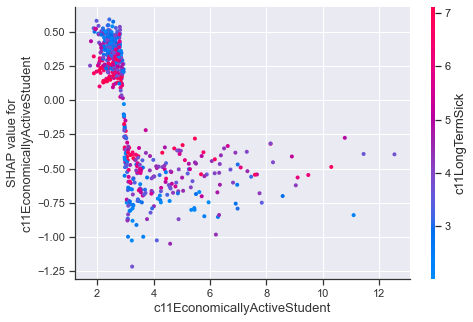

<Figure size 1152x720 with 0 Axes>

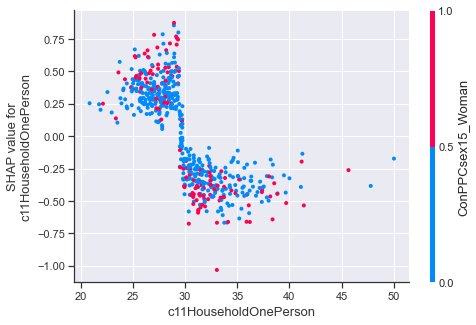

<Figure size 1152x720 with 0 Axes>

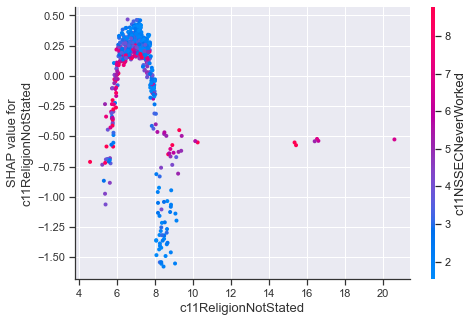

<Figure size 1152x720 with 0 Axes>

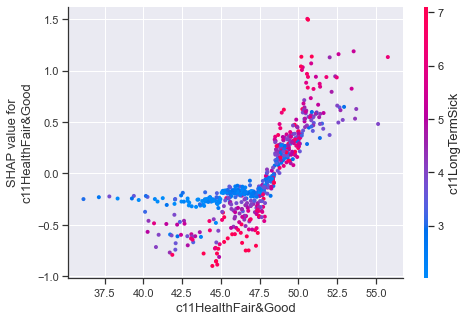

<Figure size 1152x720 with 0 Axes>

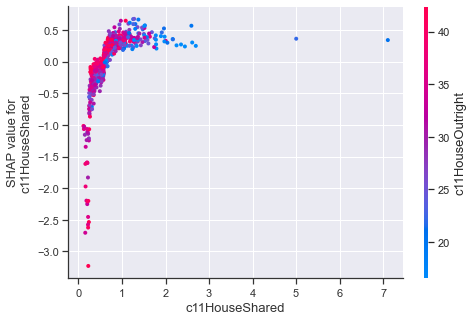

<Figure size 1152x720 with 0 Axes>

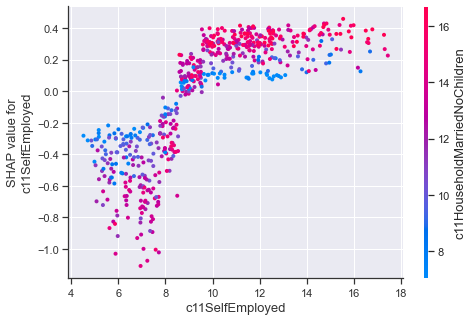

<Figure size 1152x720 with 0 Axes>

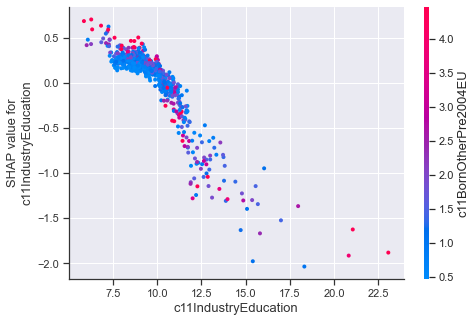

<Figure size 1152x720 with 0 Axes>

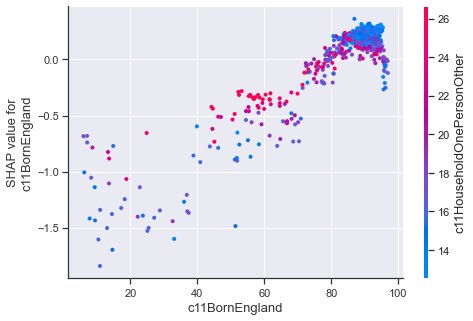

<Figure size 1152x720 with 0 Axes>

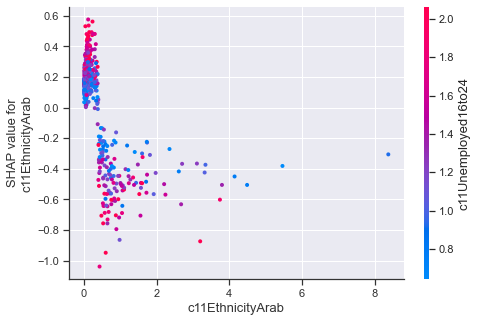

<Figure size 1152x720 with 0 Axes>

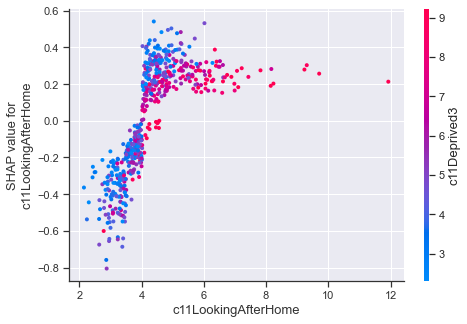

<Figure size 1152x720 with 0 Axes>

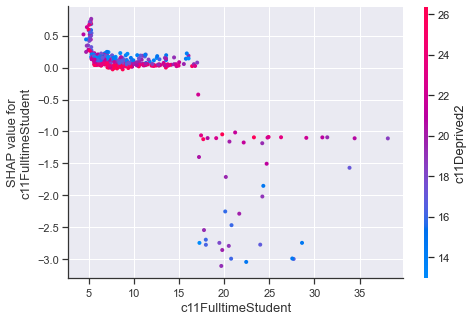

<Figure size 1152x720 with 0 Axes>

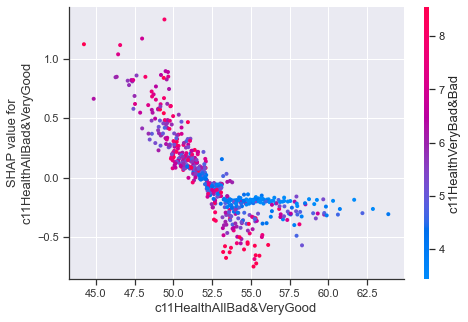

<Figure size 1152x720 with 0 Axes>

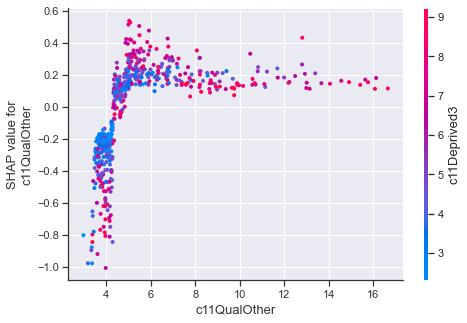

<Figure size 1152x720 with 0 Axes>

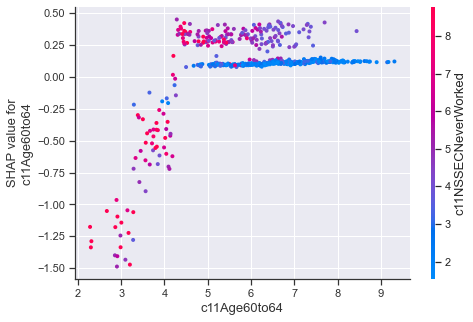

<Figure size 1152x720 with 0 Axes>

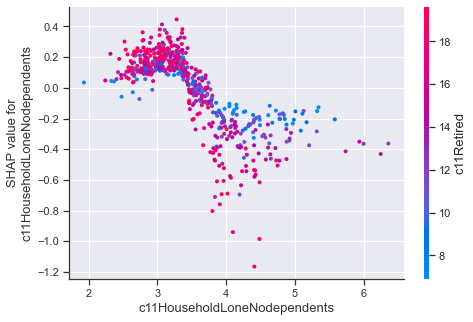

<Figure size 1152x720 with 0 Axes>

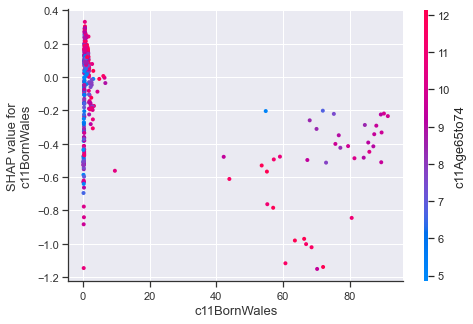

<Figure size 1152x720 with 0 Axes>

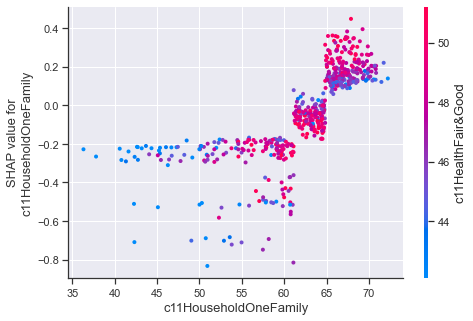

<Figure size 1152x720 with 0 Axes>

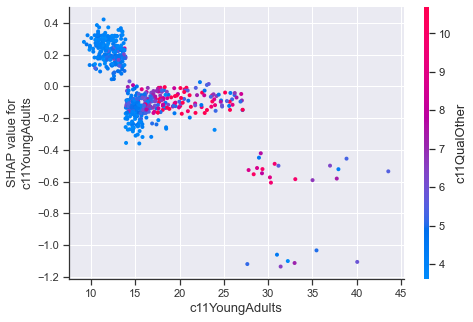

<Figure size 1152x720 with 0 Axes>

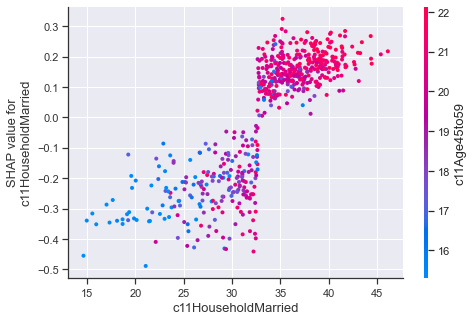

<Figure size 1152x720 with 0 Axes>

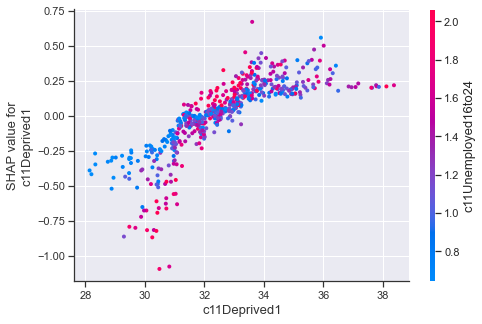

<Figure size 1152x720 with 0 Axes>

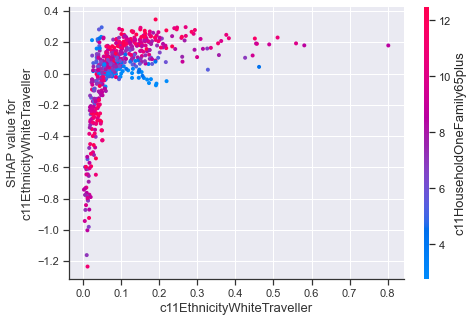

<Figure size 1152x720 with 0 Axes>

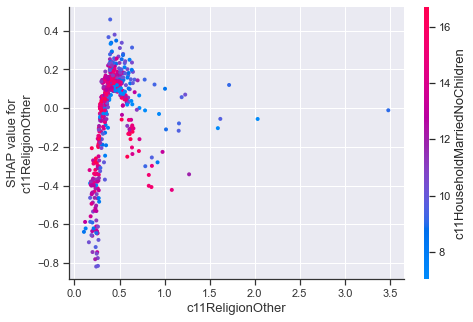

<Figure size 1152x720 with 0 Axes>

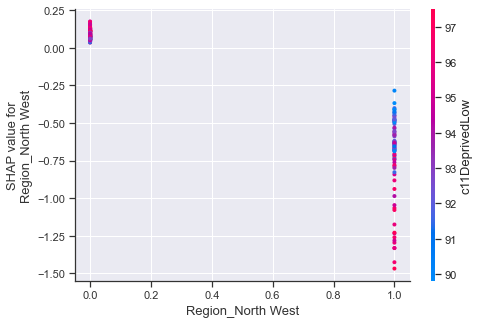

<Figure size 1152x720 with 0 Axes>

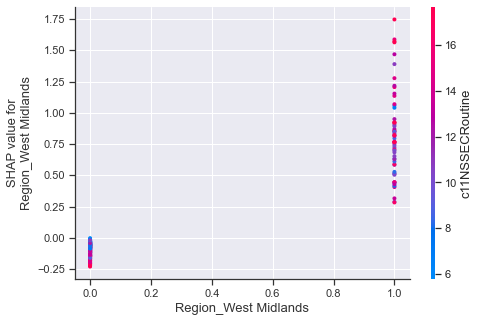

<Figure size 1152x720 with 0 Axes>

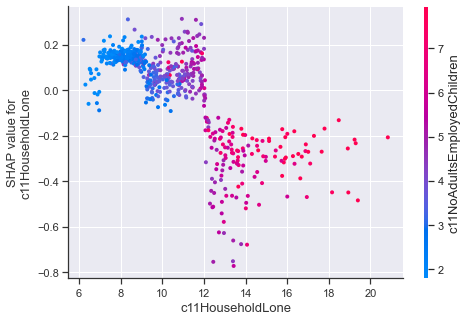

<Figure size 1152x720 with 0 Axes>

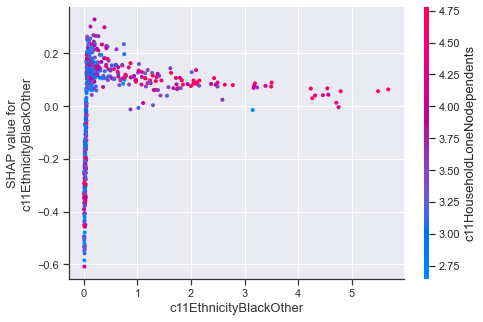

<Figure size 1152x720 with 0 Axes>

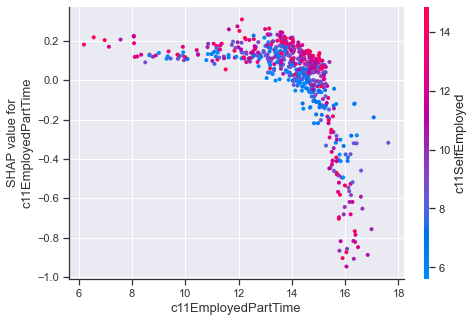

<Figure size 1152x720 with 0 Axes>

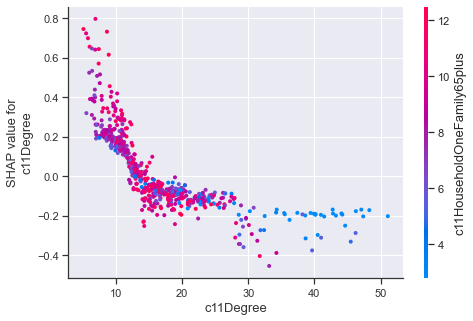

<Figure size 1152x720 with 0 Axes>

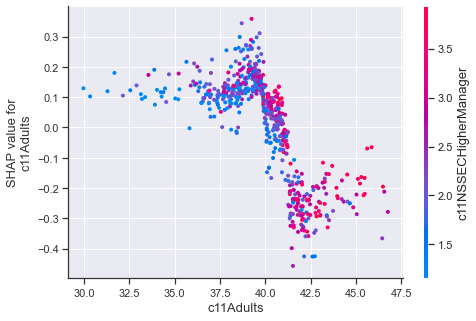

<Figure size 1152x720 with 0 Axes>

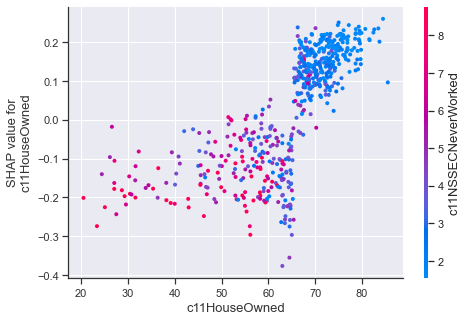

<Figure size 1152x720 with 0 Axes>

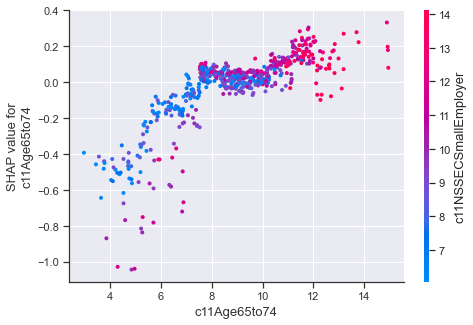

<Figure size 1152x720 with 0 Axes>

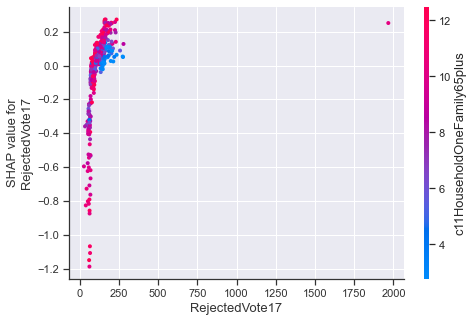

<Figure size 1152x720 with 0 Axes>

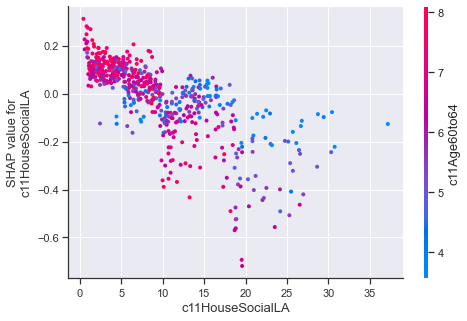

<Figure size 1152x720 with 0 Axes>

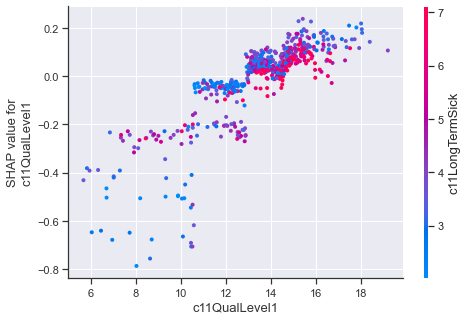

<Figure size 1152x720 with 0 Axes>

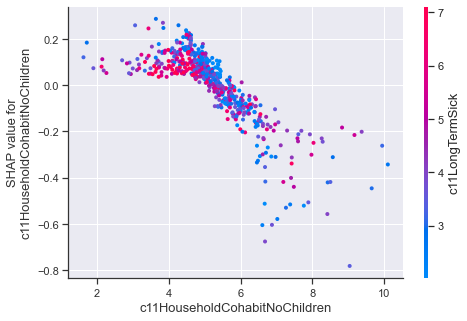

<Figure size 1152x720 with 0 Axes>

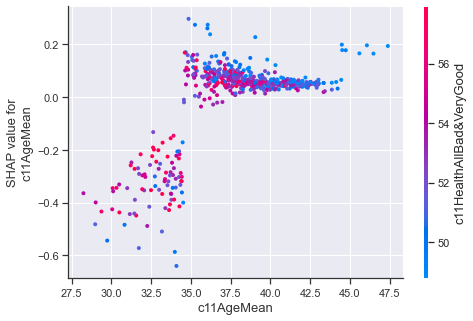

<Figure size 1152x720 with 0 Axes>

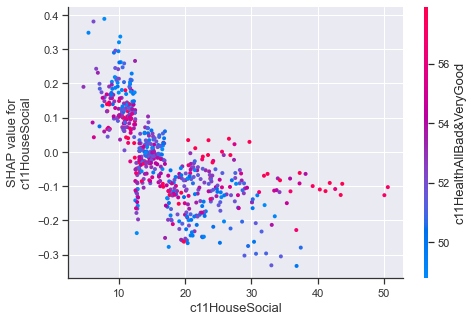

<Figure size 1152x720 with 0 Axes>

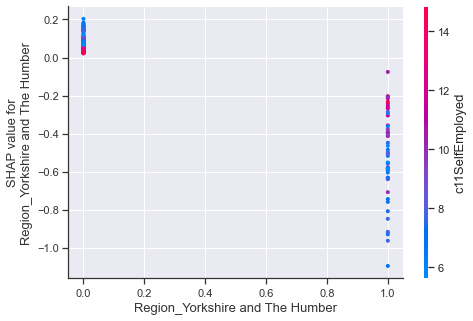

<Figure size 1152x720 with 0 Axes>

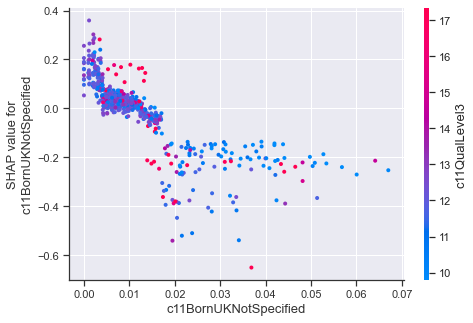

<Figure size 1152x720 with 0 Axes>

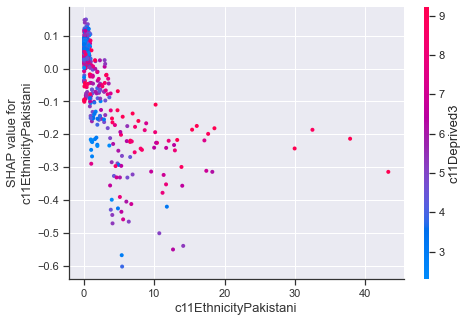

In [264]:
var_stub = "Con17"
Treatment = var_stub

var_list = [var_stub]
var_stub_list = [var_stub,]
mask = df_simp[var_stub].notnull() & (BES_census_data["Country"]!="Scotland")
wt_cols = ["leaveHanretty","remainHanretty",
          'c11CarsNone', 'c11CarsOne', 'c11CarsTwo', 'c11CarsThree', 'c11CarsFour', 'c11CarsMean','c11CarsMoreThanNone',
          'c11HealthVeryGood', 'c11HealthGood', 'c11HealthFair', 'c11HealthBad','c11HealthVeryBad','c11HealthMean']
min_features = 30
colname = "Con17"
dependence_plots = True

alg = get_xgboost_alg(classification_problem=False)
title = "Con17_minusScotland_minusHanretty_mean_inc_minusCars_minusHealth"

(explainer, shap_values, train_columns, train_index, alg,output_subfolder)=\
    xgboost_run(subdir=colname,dataset=df_simp[mask].drop(wt_cols,axis=1),
            var_list=var_list,var_stub_list=var_stub_list,
            use_specific_weights=None,
            min_features = min(df_simp.shape[1]-1,min_features),verbosity=0,
            skip_bar_plot=True,dependence_plots=dependence_plots,alg=alg,eval_metric=eval_metric,                    
            title = title)

MSE: 68.48, MAE: 6.68, EV: 0.69, R2: 0.69


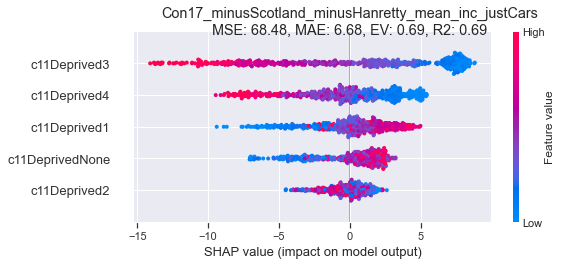

<Figure size 1152x720 with 0 Axes>

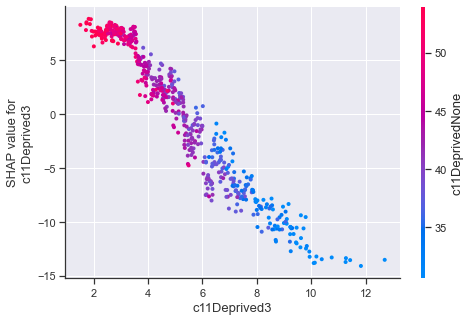

<Figure size 1152x720 with 0 Axes>

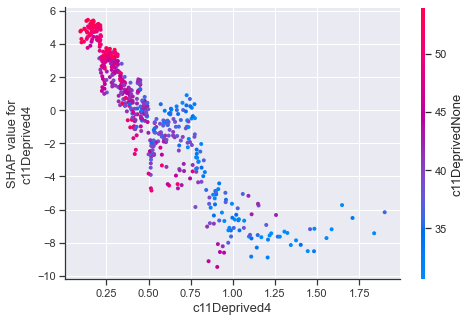

<Figure size 1152x720 with 0 Axes>

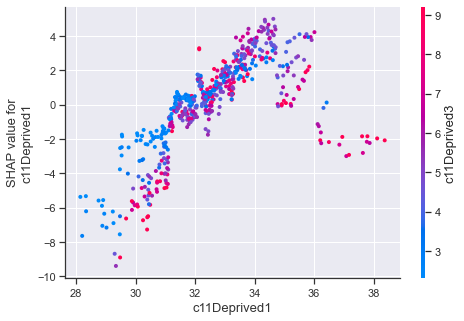

<Figure size 1152x720 with 0 Axes>

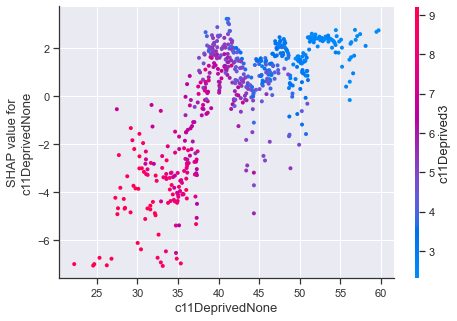

<Figure size 1152x720 with 0 Axes>

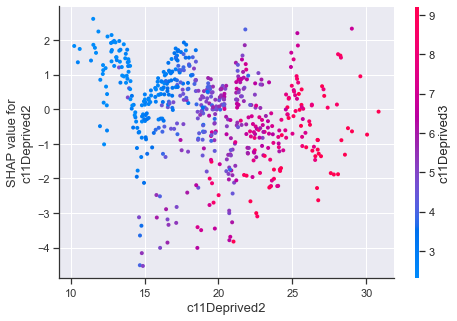

In [293]:
df_simp = pd.get_dummies(BES_census_data.drop(drop_cols,axis=1))

var_stub = "Con17"
Treatment = var_stub

var_list = [var_stub]
var_stub_list = [var_stub,]
mask = df_simp[var_stub].notnull() & (BES_census_data["Country"]!="Scotland")
wt_cols = ["leaveHanretty","remainHanretty",
          
          ]
min_features = 30
colname = "Con17"
dependence_plots = True

alg = get_xgboost_alg(classification_problem=False)
title = "Con17_minusScotland_minusHanretty_mean_inc_justCars"

(explainer, shap_values, train_columns, train_index, alg,output_subfolder)=\
    xgboost_run(subdir=colname,dataset=df_simp[mask].drop(wt_cols,axis=1)[[

'c11DeprivedNone',
 'c11Deprived1',
 'c11Deprived2',
 'c11Deprived3',
 'c11Deprived4',
#  'c11DeprivedMean',
#  'c11DeprivedHigh',
#  'c11DeprivedLow'
]+[var_stub]],
            var_list=var_list,var_stub_list=var_stub_list,
            use_specific_weights=None,
            min_features = min(df_simp.shape[1]-1,min_features),verbosity=0,
            skip_bar_plot=True,dependence_plots=dependence_plots,alg=alg,eval_metric=eval_metric,                    
            title = title)

predCon17 = pd.Series(alg.predict(df_simp[train_columns]),index=df_simp.index)

In [247]:
list(search(BES_census_data,"Deprived").index)


# .83
#  'c11YoungAdults',
#  'c11Elderly',
#  "c11HealthVeryBad&Bad",
#  "c11HealthFair&Good",
#  "c11CarsMoreThanNone",

['c11DeprivedNone',
 'c11Deprived1',
 'c11Deprived2',
 'c11Deprived3',
 'c11Deprived4',
 'c11DeprivedMean',
 'c11DeprivedHigh',
 'c11DeprivedLow']

In [258]:
## kids
BES_census_data["c11DeprivedHigh"] =BES_census_data["c11Deprived3"]+BES_census_data["c11Deprived4"]
BES_census_data["c11DeprivedLow"] =BES_census_data["c11Deprived2"]+BES_census_data["c11Deprived1"]+BES_census_data["c11DeprivedNone"]

In [172]:
## kids
BES_census_data["c11Kids"] =BES_census_data["c11Age0to4"]+\
                            BES_census_data["c11Age5to7"]+\
                            BES_census_data["c11Age8to9"]+\
                            BES_census_data["c11Age10to14"]+\
                            BES_census_data["c11Age15"]+\
                            BES_census_data["c11Age16to17"]
# 'c11Age0to4', 'c11Age5to7', 'c11Age8to9', 'c11Age10to14', 'c11Age15',  'c11Age16to17',
## young adults
BES_census_data["c11YoungAdults"] =BES_census_data["c11Age18to19"]+\
                            BES_census_data["c11Age20to24"]+\
                            BES_census_data["c11Age25to29"]
# 'c11Age18to19', 'c11Age20to24', 'c11Age25to29',
## adult
BES_census_data["c11Adults"] =BES_census_data["c11Age30to44"]+\
                              BES_census_data["c11Age45to59"]
# 'c11Age30to44', 'c11Age45to59',
## elderly
BES_census_data["c11Elderly"] =BES_census_data["c11Age60to64"]+\
                            BES_census_data["c11Age65to74"]+\
                            BES_census_data["c11Age75to84"]+\
                            BES_census_data["c11Age85to89"]+\
                            BES_census_data["c11Age90plus"]
# 'c11Age60to64', 'c11Age65to74', 'c11Age75to84', 'c11Age85to89', 'c11Age90plus'

In [ ]:
## r^ .69 *from just Cars*, r^ .65 from just CarsNone/c11CarsMoreThanNone
## r^.61 from Health (.65 with HealtMean added), c11HealthVeryBad r^2 .37 - not nearly as easy to nail down
# r^2 .62 from Age, r^2 .55
# r^2 .6 from Deprivation .69, .6 with High/Low alone

In [211]:
BES_census_data["c11HealthMean"] = (BES_census_data["c11HealthVeryBad"]+\
                                    BES_census_data["c11HealthBad"])-\
                                    (BES_census_data["c11HealthFair"]+\
                                    BES_census_data["c11HealthGood"])
                                    ## still not very good

In [188]:
BES_census_data["c11HealthVeryBad&Bad"] = BES_census_data["c11HealthVeryBad"]+BES_census_data["c11HealthBad"]
BES_census_data["c11HealthFair&Good"] = BES_census_data["c11HealthFair"]+BES_census_data["c11HealthGood"]
BES_census_data["c11CarsMoreThanNone"] = BES_census_data["c11CarsOne"]+BES_census_data["c11CarsTwo"]+BES_census_data["c11CarsThree"]+BES_census_data["c11CarsFour"]

In [1612]:
# search(BES_census_data,"c11Health").index

In [294]:
# BES_census_data[[ 'Con17', 'Lab17', 'LD17', 'SNP17',
#        'PC17', 'UKIP17', 'Green17']].sum(axis=1)

## vote share is excluding non-voters
## wonder what the best way of measuring whether including non-voting % 'improves' the model?

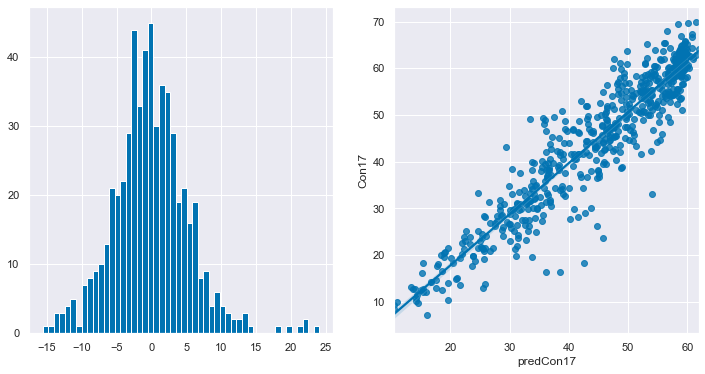

In [299]:
merged.loc[ BES_census_data.loc[df_simp.index,"ONSConstID"],"predCon17" ] = predCon17.values

merged["residCon17"] = merged["predCon17"] - merged["Con17"]
merged["residCon17"].loc[merged["Country"]=="Scotland"] = np.nan

fig, axes = plt.subplots(nrows=1,ncols=2,figsize=(12,6))
merged["residCon17"].hist(bins=50,ax=axes[0])
mask = merged["residCon17"].notnull()
# plt.figure()
sns.regplot(merged["predCon17"][mask],merged["Con17"][mask],ax=axes[1])

In [304]:
# merged["residCon17"].dropna().sort_values()

In [303]:
# merged["residCon17"].dropna().sort_values()
# merged[merged["residCon17"].notnull()].sort_values(by="residCon17")

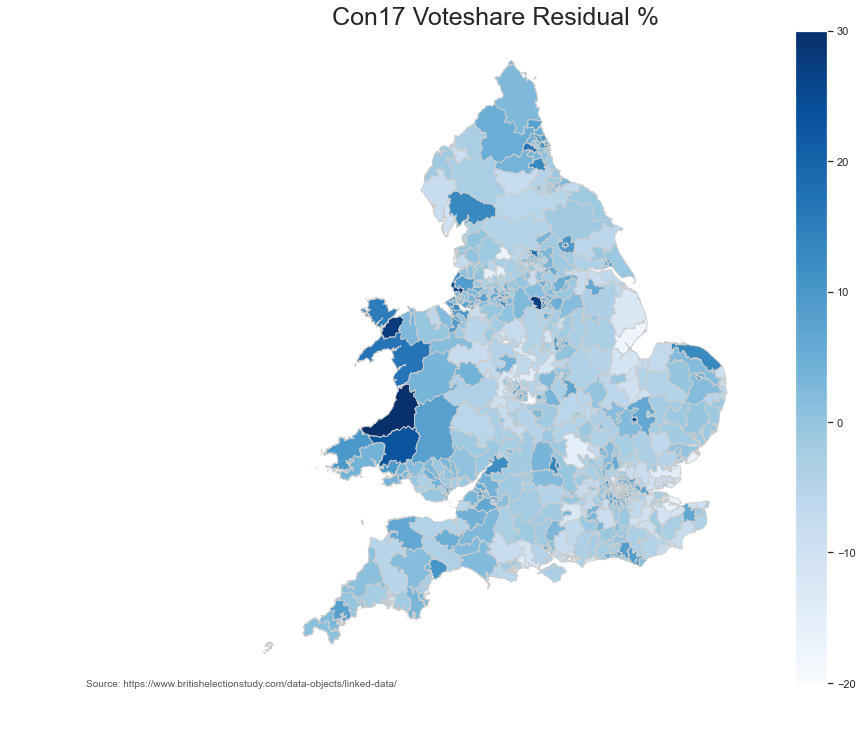

In [302]:
# set a variable that will call whatever column we want to visualise on the map
variable = "residCon17"
# title = 'Leave%\n(Constituency level - estimate by Chris Hanretty)'
title = "Con17 Voteshare Residual %"

# set the range for the choropleth
vmin, vmax = np.floor(merged[variable].min()/10)*10, np.ceil(merged[variable].max()/10)*10

# create figure and axes for Matplotlib
fig, ax = plt.subplots(1, figsize=(16, 12))

# create map
merged.plot(column=variable, cmap='Blues', linewidth=0.8, ax=ax, edgecolor='0.8')

# Now we can customise and add annotations

# remove the axis
ax.axis('off')

# add a title
ax.set_title(title, \
              fontdict={'fontsize': '25',
                        'fontweight' : '3'})

# create an annotation for the  data source
ax.annotate('Source: https://www.britishelectionstudy.com/data-objects/linked-data/',
           xy=(0.1, .08), xycoords='figure fraction',
           horizontalalignment='left', verticalalignment='top',
           fontsize=10, color='#555555')

# Create colorbar as a legend
sm = plt.cm.ScalarMappable(cmap='Blues', norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm._A = []
cbar = fig.colorbar(sm)

Treatment = "Chloropleth"
output_subfolder = create_subdir(BES_output_folder,Treatment)
fname = output_subfolder +Treatment + ".png"
# this will save the figure as a high-res png. you can also save as svg
plt.savefig( fname, bbox_inches='tight', dpi=300 )


# fig.savefig('testmap.png', dpi=300)

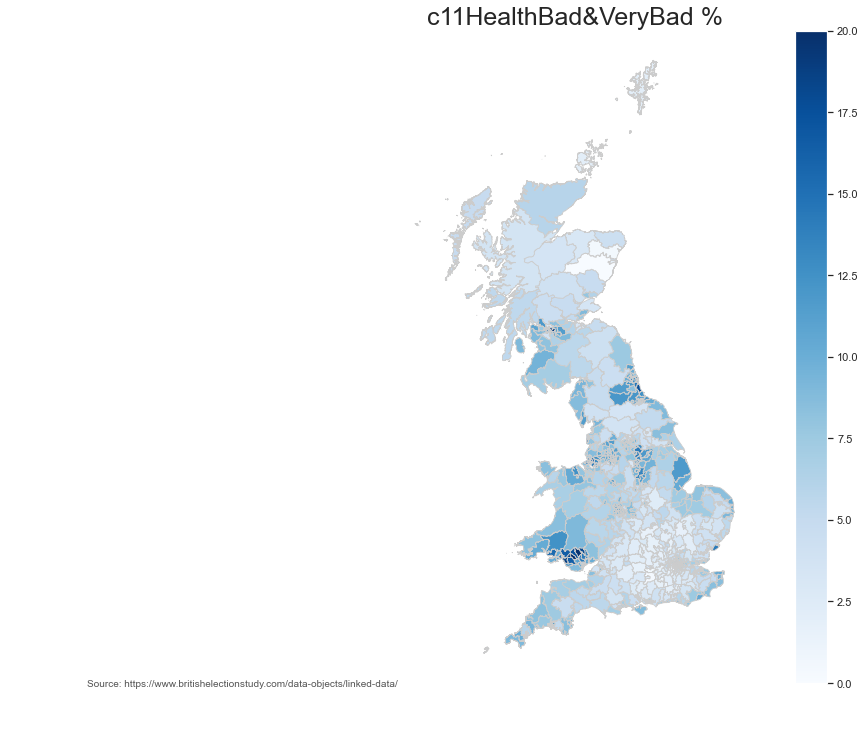

In [311]:
# set a variable that will call whatever column we want to visualise on the map
variable = "c11HealthBad&VeryBad"
# title = 'Leave%\n(Constituency level - estimate by Chris Hanretty)'
title = "c11HealthBad&VeryBad %"

# set the range for the choropleth
vmin, vmax = np.floor(merged[variable].min()/10)*10, np.ceil(merged[variable].max()/10)*10

# create figure and axes for Matplotlib
fig, ax = plt.subplots(1, figsize=(16, 12))

# create map
merged.plot(column=variable, cmap='Blues', linewidth=0.8, ax=ax, edgecolor='0.8')

# Now we can customise and add annotations

# remove the axis
ax.axis('off')

# add a title
ax.set_title(title, \
              fontdict={'fontsize': '25',
                        'fontweight' : '3'})

# create an annotation for the  data source
ax.annotate('Source: https://www.britishelectionstudy.com/data-objects/linked-data/',
           xy=(0.1, .08), xycoords='figure fraction',
           horizontalalignment='left', verticalalignment='top',
           fontsize=10, color='#555555')

# Create colorbar as a legend
sm = plt.cm.ScalarMappable(cmap='Blues', norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm._A = []
cbar = fig.colorbar(sm)

Treatment = "Chloropleth"
output_subfolder = create_subdir(BES_output_folder,Treatment)
fname = output_subfolder +Treatment + ".png"
# this will save the figure as a high-res png. you can also save as svg
plt.savefig( fname, bbox_inches='tight', dpi=300 )


# fig.savefig('testmap.png', dpi=300)

In [310]:
merged["c11HealthBad&VeryBad"] = merged["c11HealthBad"]+merged["c11HealthVeryBad"]

In [305]:
search(merged,"Health")

c11HealthVeryGood    632
c11HealthGood        632
c11HealthFair        632
c11HealthBad         632
c11HealthVeryBad     632
dtype: int64

In [1608]:
# merged.loc[merged["residCon17"].dropna().sort_values().tail(5).index]

In [1607]:
# merged.loc[merged["residCon17"].dropna().sort_values().head(10).index]

In [71]:
occ_df = pd.read_excel( open(BES_small_data_files+'Census2011-ConstituencyProfile-uk.xlsx','rb'), sheet_name='KS608D' )
occ_df.columns = occ_df.loc[3]
occ_df = occ_df.drop([0,1,2,3,654,])
occ_df

var_list = ["CON%ELEM","CON%OPS","CON%SAL_SERV","CON%CAR_LEI_","CON%SKILL","CON%ADMIN_SEC","CON%ASSOC_PROF_TECH",
 "CON%PROF","CON%MAN_DIR_SEN"]

occ_df = occ_df.set_index("ONSConstID").loc[merged.index]
var_list = ["CON%ELEM","CON%OPS","CON%SAL_SERV","CON%CAR_LEI_","CON%SKILL","CON%ADMIN_SEC","CON%ASSOC_PROF_TECH",
 "CON%PROF","CON%MAN_DIR_SEN"]
merged[var_list] = occ_df[var_list].values
merseyside = ["Birkenhead","Bootle","Garston and Halewood","Knowsley",
             "Liverpool, Riverside","Liverpool, Walton","Liverpool, Wavertree","Liverpool, West Derby",
             "Sefton Central","Southport","St Helens North","St Helens South and Whiston",
             "Wallasey","Wirral South","Wirral West"]
merged["Merseyside"] = merged["PCON13NM"].isin(merseyside)

3,CON%ELEM,CON%OPS,CON%SAL_SERV,CON%CAR_LEI_,CON%SKILL,CON%ADMIN_SEC,CON%ASSOC_PROF_TECH,CON%PROF,CON%MAN_DIR_SEN
4,12.285019,7.909029,7.575243,10.369993,15.716225,9.560987,10.678321,14.185902,11.71928
5,12.753241,10.302983,8.610831,10.820461,15.136226,10.566897,9.925224,12.566949,9.317188
6,10.063991,7.921272,11.128078,9.511344,11.637095,13.03568,12.061276,15.304441,9.336824
7,10.988004,8.381791,11.328514,10.254597,12.067159,14.971973,12.046205,11.886427,8.075331
8,12.642747,7.215305,8.08959,8.332719,9.631867,11.404995,11.515509,22.203394,8.963874
...,...,...,...,...,...,...,...,...,...
649,10.661445,7.747938,9.3829,8.972606,13.332504,15.454432,9.426416,16.013925,9.007833
650,9.257318,7.493919,8.227795,10.001677,19.690933,12.381531,7.418435,17.189466,8.338925
651,9.411736,6.664736,8.788954,9.747266,14.830907,17.655152,8.924132,15.135057,8.84206
652,11.307561,12.173583,9.876824,9.041122,12.933485,13.308698,8.23574,15.198029,7.924957


In [ ]:
###################################################

In [833]:
import statsmodels.api as sm

In [33]:
# Welsh language is a pain to get at
# Merseyside


# Birkenhead
# Bootle
# Garston and Halewood
# Knowsley
# Liverpool, Riverside
# Liverpool, Walton
# Liverpool, Wavertree
# Liverpool, West Derby
# Sefton Central
# Southport
# St Helens North
# St Helens South and Whiston
# Wallasey
# Wirral South
# Wirral West

merseyside = ["Birkenhead","Bootle","Garston and Halewood","Knowsley",
             "Liverpool, Riverside","Liverpool, Walton","Liverpool, Wavertree","Liverpool, West Derby",
             "Sefton Central","Southport","St Helens North","St Helens South and Whiston",
             "Wallasey","Wirral South","Wirral West"]
len(merseyside)

## occupational variables - don't use the ones in the BES subset!
# https://commonslibrary.parliament.uk/research-briefings/rp14-10/

# can get from here (sheet KS608D)

## arg - even the age categories aren't the standard ones!

15

In [21]:
# JK regression model of area-level 2017 Conservative vote share
# intercept  0.89***
# Deprived3 -4.34
# Level4qual-1.27
# Age55-64  -0.36
# Managers+  2.88
# Sales&Serv-1.53
# Welsh lang-0.26
# Merseyside-0.09

# N=573
# R2=.86 

Series([], dtype: float64)

In [67]:
# merged

jk_list = ["c11Deprived3","c11QualLevel4","c11Age60to64","CON%MAN_DIR_SEN","CON%SAL_SERV","Merseyside",]

In [169]:
# merged.columns[-200:-150]
# dataset[jk_list]["CON%MAN_DIR_SEN"]

In [87]:
dataset = merged[merged["Country"].isin(["England","Wales"])]

Y = dataset['Con17']/100
X = dataset[jk_list].astype('float')
X = sm.add_constant(X)
model = sm.OLS(Y,X)
results = model.fit()
results.params
#  merged["Con17"]

const              0.880626
c11Deprived3      -0.045216
c11QualLevel4     -0.013179
c11Age60to64      -0.011484
CON%MAN_DIR_SEN    0.031507
CON%SAL_SERV      -0.013349
Merseyside        -0.084330
dtype: float64

In [82]:
# intercept  0.89***
# Deprived3 -4.34
# Level4qual-1.27
# Age55-64  -0.36
# Managers+  2.88
# Sales&Serv-1.53
# Welsh lang-0.26
# Merseyside-0.09

## looks like they made a transcription booboo and multiplied everything but Merseyside by 100
# results not identical, but missing *welsh lang* and *age category* not identical

PCON13CD
E14000530    55.056180
E14000531    65.408227
E14000532    51.019132
E14000533    56.547554
E14000534    62.355616
               ...    
W07000076    25.214907
W07000077    27.224115
W07000078    47.471983
W07000079    29.754016
W07000080    30.191580
Name: Con17, Length: 573, dtype: float64

In [168]:
# model.predict(results.params)

In [103]:
# merged.loc[ BES_census_data.loc[df_simp.index,"ONSConstID"],"predCon17" ] = predCon17.values

# merged["residCon17"] = merged["predCon17"] - merged["Con17"]
# merged["residCon17"].loc[merged["Country"]=="Scotland"] = np.nan

# fig, axes = plt.subplots(nrows=1,ncols=2,figsize=(12,6))
# merged["residCon17"].hist(bins=50,ax=axes[0])
# mask = merged["residCon17"].notnull()
# # plt.figure()
# sns.regplot(merged["predCon17"][mask],merged["Con17"][mask],ax=axes[1])

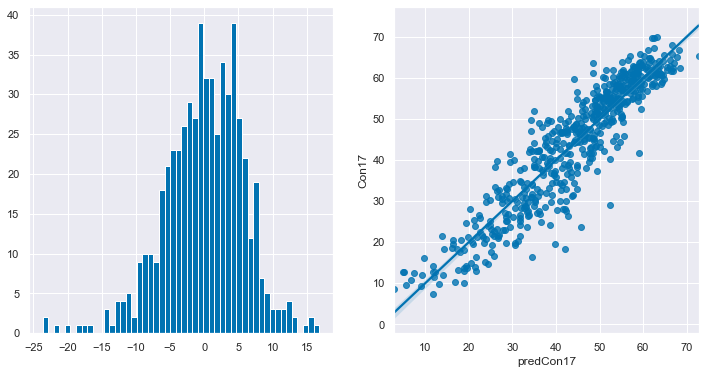

In [105]:
merged["predCon17"]=np.nan
merged.loc[dataset.index,"predCon17"] = model.predict(results.params)*100
merged["residCon17"] = merged["Con17"] - merged["predCon17"]

fig, axes = plt.subplots(nrows=1,ncols=2,figsize=(12,6))
merged["residCon17"].hist(bins=50,ax=axes[0])
mask = merged["residCon17"].notnull()
# plt.figure()
sns.regplot(merged["predCon17"][mask],merged["Con17"][mask],ax=axes[1])

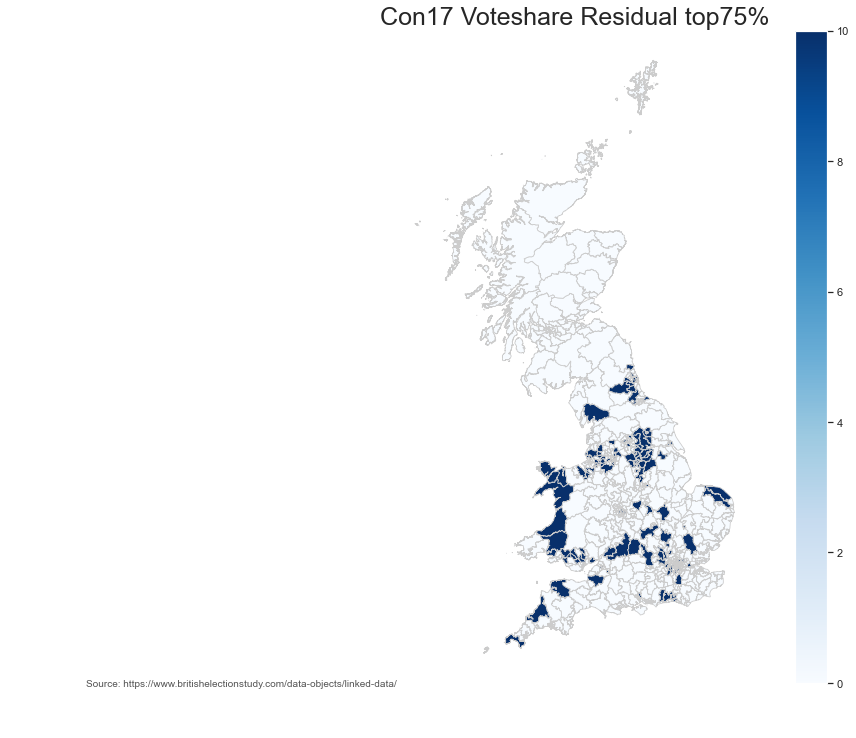

In [118]:
merged["residCon17_top75"] = merged["residCon17"]<merged["residCon17"].quantile(.25)

# set a variable that will call whatever column we want to visualise on the map
variable = "residCon17_top75"
# title = 'Leave%\n(Constituency level - estimate by Chris Hanretty)'
title = "Con17 Voteshare Residual top75%"

# set the range for the choropleth
vmin, vmax = np.floor(merged[variable].min()/10)*10, np.ceil(merged[variable].max()/10)*10

# create figure and axes for Matplotlib
fig, ax = plt.subplots(1, figsize=(16, 12))

# create map
merged.plot(column=variable, cmap='Blues', linewidth=0.8, ax=ax, edgecolor='0.8')

# Now we can customise and add annotations

# remove the axis
ax.axis('off')

# add a title
ax.set_title(title, \
              fontdict={'fontsize': '25',
                        'fontweight' : '3'})

# create an annotation for the  data source
ax.annotate('Source: https://www.britishelectionstudy.com/data-objects/linked-data/',
           xy=(0.1, .08), xycoords='figure fraction',
           horizontalalignment='left', verticalalignment='top',
           fontsize=10, color='#555555')

# Create colorbar as a legend
sm = plt.cm.ScalarMappable(cmap='Blues', norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm._A = []
cbar = fig.colorbar(sm)

Treatment = "Chloropleth"
output_subfolder = create_subdir(BES_output_folder,Treatment)
fname = output_subfolder +Treatment + ".png"
# this will save the figure as a high-res png. you can also save as svg
plt.savefig( fname, bbox_inches='tight', dpi=1000 )

# fig.savefig('testmap.png', dpi=300)

In [167]:
## guess I could exclude wales!

# https://statswales.gov.wales/Catalogue/Welsh-Language/Census-Welsh-Language/welshlanguageskills-by-ediv-2011census


In [125]:
# welsh_df = pd.read_csv(BES_small_data_files+"welshlanguageskills.csv")
# welsh_df
# welsh_df.drop(['Unnamed: 0', 'Unnamed: 1'],axis=1).dropna()

## wrong geo subunits!

In [177]:
# pd.read_excel(BES_small_data_files+"welsh_constituency_data.xls",sheet="WelshLanguage")


In [166]:
# welsh_df.loc[ [x.strip() for x in merged[merged["Country"]=="Wales"].index] ]

In [157]:
# [welsh_df.loc[x] for x in merged[merged["Country"]=="Wales"]["PCON13NM"].values]


Index(['North Wales', 'Aberconwy', 'Alyn and Deeside', 'Arfon', 'Clwyd South',
       'Clwyd West', 'Delyn', 'Vale of Clwyd', 'Wrexham', 'Ynys Mon',
       'Mid and West Wales', 'Brecon and Radnorshire',
       'Carmarthen East and Dinefwr',
       'Carmarthen West and South Pembrokeshire', 'Ceredigion',
       'Dwyfor Meirionnydd', 'Llanelli', 'Montgomeryshire',
       'Preseli Pembrokeshire', 'South Wales West', 'Aberavon', 'Bridgend',
       'Gower', 'Neath', 'Ogmore', 'Swansea East', 'Swansea West',
       'South Wales Central', 'Cardiff Central', 'Cardiff North',
       'Cardiff South and Penarth', 'Cardiff West', 'Cynon Valley',
       'Pontypridd', 'Rhondda', 'Vale of Glamorgan', 'South Wales East',
       'Blaenau Gwent', 'Caerphilly', 'Islwyn', 'Merthyr Tydfil and Rhymney',
       'Monmouth', 'Newport East', 'Newport West', 'Torfaen'],
      dtype='object', name='Assembly Constituency Area')

In [176]:
import statsmodels.api as sm
jk_list = ["c11Deprived3","c11QualLevel4","c11Age60to64","CON%MAN_DIR_SEN","CON%SAL_SERV","Merseyside","speakWelsh"]
dataset = merged[merged["Country"].isin(["England","Wales"])]

Y = dataset['Con17']/100
X = dataset[jk_list].astype('float')
X = sm.add_constant(X)
model = sm.OLS(Y,X)
results = model.fit()
results.summary()


<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  Con17   R-squared:                       0.863
Model:                            OLS   Adj. R-squared:                  0.861
Method:                 Least Squares   F-statistic:                     508.7
Date:                Thu, 13 Jan 2022   Prob (F-statistic):          3.37e-239
Time:                        21:44:12   Log-Likelihood:                 845.85
No. Observations:                 573   AIC:                            -1676.
Df Residuals:                     565   BIC:                            -1641.
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
===================================================================================
                      coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------
const               0.8492      0.049     17.424      0.000       0.753       0.945
c11Deprived3       -0.0427      0.002    -22.929      0.000      -0.046      -0.039
c11QualLevel4      -0.0122      0.001    -21.092      0.000      -0.013      -0.011
c11Age60to64       -0.0042      0.003     -1.376      0.170      -0.010       0.002
CON%MAN_DIR_SEN     0.0281      0.002     13.776      0.000       0.024       0.032
CON%SAL_SERV       -0.0147      0.002     -6.144      0.000      -0.019      -0.010
Merseyside         -0.0973      0.015     -6.386      0.000      -0.127      -0.067
speakWelsh         -0.2889      0.038     -7.689      0.000      -0.363      -0.215
==============================================================================
Omnibus:                       20.676   Durbin-Watson:                   1.914
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               25.122
Skew:                          -0.375   Prob(JB):                     3.51e-06
Kurtosis:                       3.700   Cond. No.                         676.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [181]:
results.params

const              0.849203
c11Deprived3      -0.042708
c11QualLevel4     -0.012221
c11Age60to64      -0.004226
CON%MAN_DIR_SEN    0.028136
CON%SAL_SERV      -0.014700
Merseyside        -0.097289
speakWelsh        -0.288907
dtype: float64

In [ ]:
# intercept  0.89***
# Deprived3 -4.34
# Level4qual-1.27
# Age55-64  -0.36
# Managers+  2.88
# Sales&Serv-1.53
# Welsh lang-0.26
# Merseyside-0.09

## looks like they made a transcription booboo and multiplied everything but Merseyside by 100
# results not identical, but missing *welsh lang* and *age category* not identical

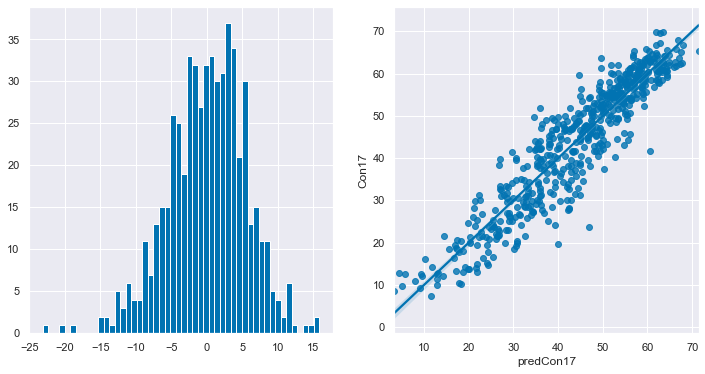

In [179]:
merged["predCon17"]=np.nan
merged.loc[dataset.index,"predCon17"] = model.predict(results.params)*100
merged["residCon17"] = merged["Con17"] - merged["predCon17"]

fig, axes = plt.subplots(nrows=1,ncols=2,figsize=(12,6))
merged["residCon17"].hist(bins=50,ax=axes[0])
mask = merged["residCon17"].notnull()
# plt.figure()
sns.regplot(merged["predCon17"][mask],merged["Con17"][mask],ax=axes[1])

In [210]:
merged["residCon17_jkrep"] = merged["residCon17"]

## save this for comparison!

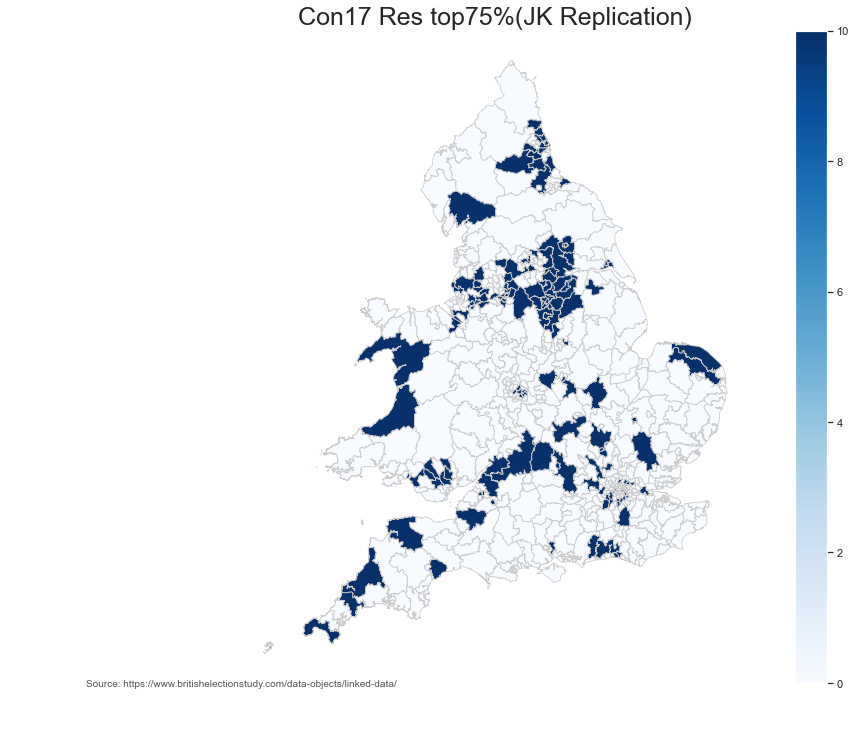

In [231]:
merged["residCon17_top75"] = merged["residCon17_jkrep"]<merged["residCon17_jkrep"].quantile(.25)
merged.loc[merged["Country"].isin(["Scotland"]),"residCon17_top75"]=np.nan
# set a variable that will call whatever column we want to visualise on the map
variable = "residCon17_top75"
# title = 'Leave%\n(Constituency level - estimate by Chris Hanretty)'
title = "Con17 Res top75%(JK Replication)"

# set the range for the choropleth
vmin, vmax = np.floor(merged[variable].min()/10)*10, np.ceil(merged[variable].max()/10)*10

# create figure and axes for Matplotlib
fig, ax = plt.subplots(1, figsize=(16, 12))

# create map
merged.plot(column=variable, cmap='Blues', linewidth=0.8, ax=ax, edgecolor='0.8')

# Now we can customise and add annotations

# remove the axis
ax.axis('off')

# add a title
ax.set_title(title, \
              fontdict={'fontsize': '25',
                        'fontweight' : '3'})

# create an annotation for the  data source
ax.annotate('Source: https://www.britishelectionstudy.com/data-objects/linked-data/',
           xy=(0.1, .08), xycoords='figure fraction',
           horizontalalignment='left', verticalalignment='top',
           fontsize=10, color='#555555')

# Create colorbar as a legend
sm = plt.cm.ScalarMappable(cmap='Blues', norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm._A = []
cbar = fig.colorbar(sm)

Treatment = "Chloropleth"
output_subfolder = create_subdir(BES_output_folder,Treatment)
fname = output_subfolder +title +".png"
# this will save the figure as a high-res png. you can also save as svg
plt.savefig( fname, bbox_inches='tight', dpi=1000 )

# fig.savefig('testmap.png', dpi=300)

In [ ]:
##### 

In [207]:
BES_census_data["ConstituencyName"] = BES_census_data["ConstituencyName"].replace("Ynys Môn","Ynys Mon")
BES_census_data["Merseyside"] = BES_census_data["ConstituencyName"].isin(merseyside).astype(float)
BES_census_data["speakWelsh"] = [welsh_df.loc[x,"Percentage aged 3+ who can speak Welsh"] if x in welsh_df.index else 0 for x in BES_census_data["ConstituencyName"]  ]
var_list = ["CON%ELEM","CON%OPS","CON%SAL_SERV","CON%CAR_LEI_","CON%SKILL","CON%ADMIN_SEC","CON%ASSOC_PROF_TECH",
 "CON%PROF","CON%MAN_DIR_SEN"]
BES_census_data[var_list] = occ_df.loc[BES_census_data["ONSConstID"],var_list].values

MSE: 23.88, MAE: 3.92, EV: 0.89, R2: 0.89


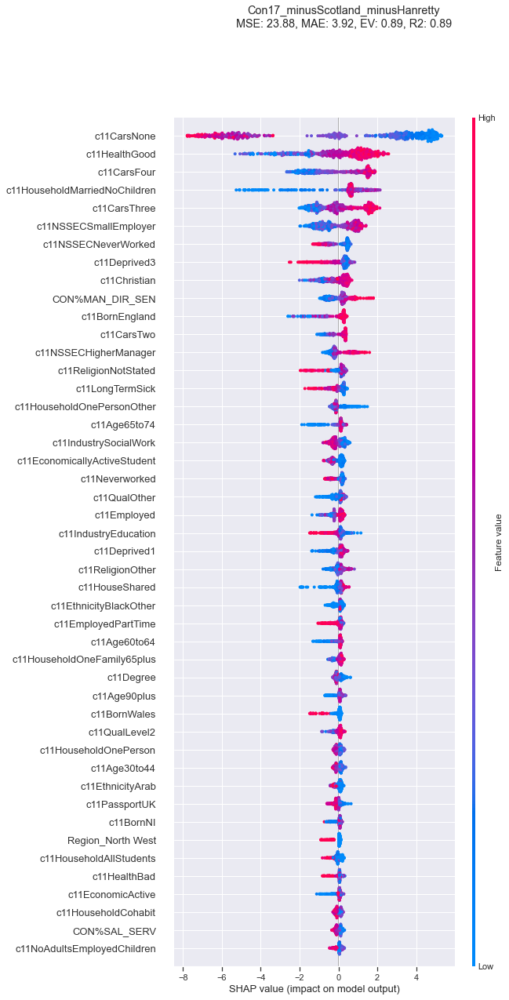

<Figure size 1152x720 with 0 Axes>

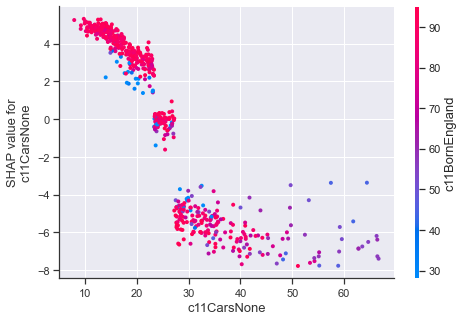

<Figure size 1152x720 with 0 Axes>

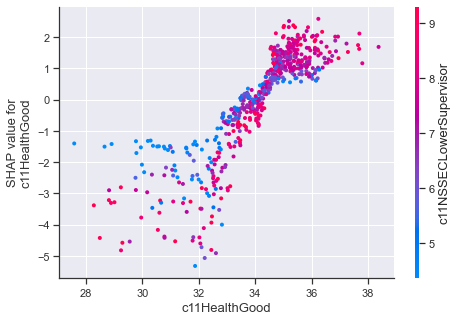

<Figure size 1152x720 with 0 Axes>

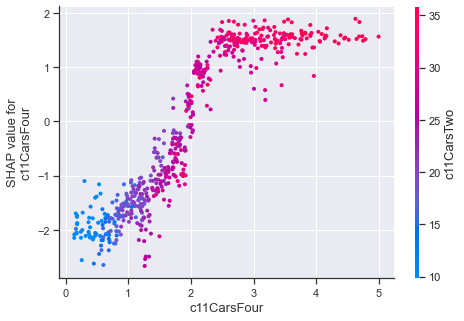

<Figure size 1152x720 with 0 Axes>

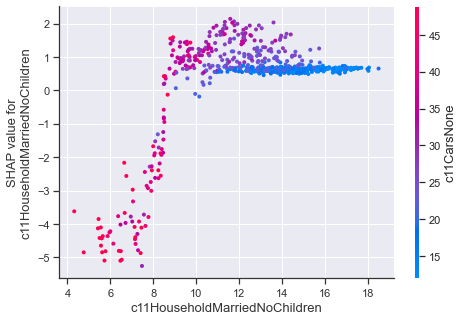

<Figure size 1152x720 with 0 Axes>

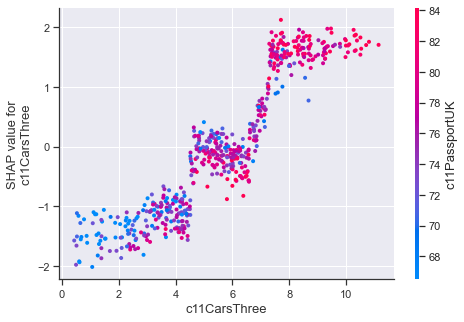

<Figure size 1152x720 with 0 Axes>

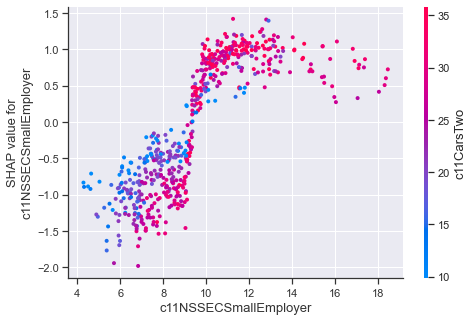

<Figure size 1152x720 with 0 Axes>

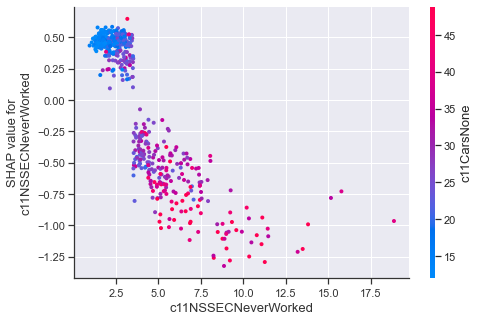

<Figure size 1152x720 with 0 Axes>

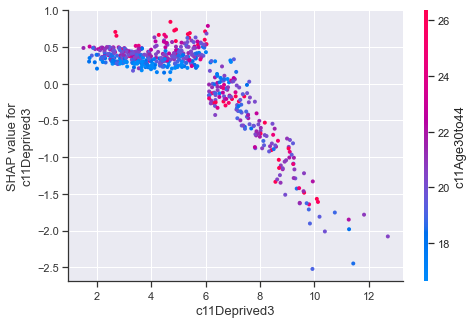

<Figure size 1152x720 with 0 Axes>

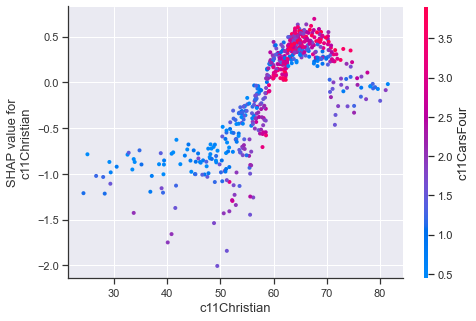

<Figure size 1152x720 with 0 Axes>

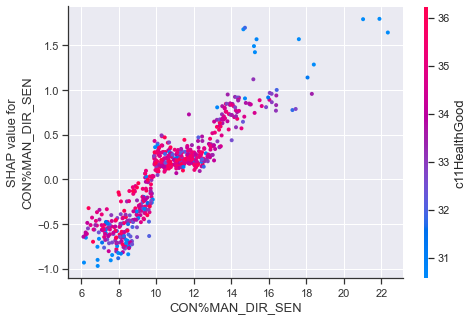

<Figure size 1152x720 with 0 Axes>

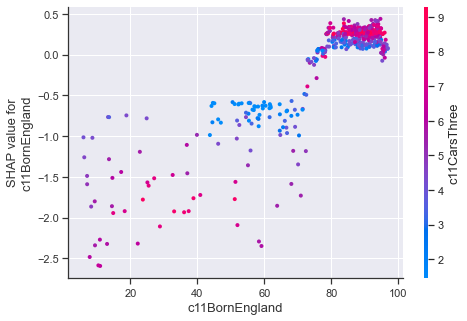

<Figure size 1152x720 with 0 Axes>

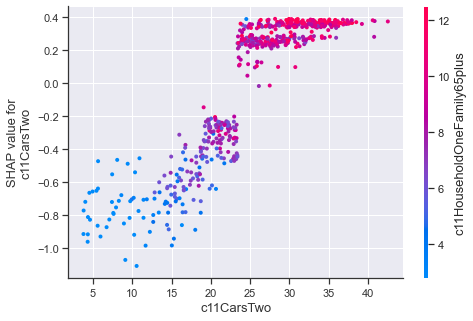

<Figure size 1152x720 with 0 Axes>

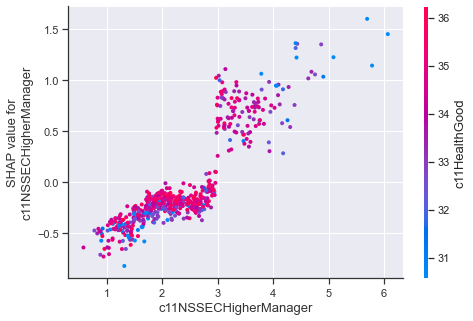

<Figure size 1152x720 with 0 Axes>

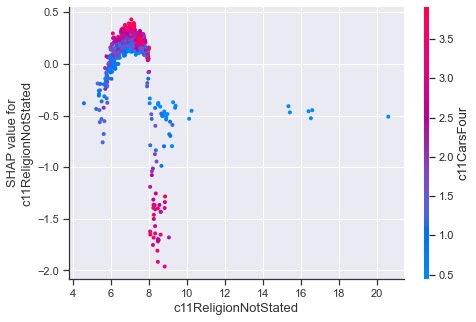

<Figure size 1152x720 with 0 Axes>

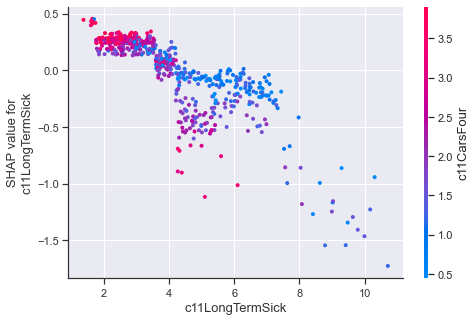

<Figure size 1152x720 with 0 Axes>

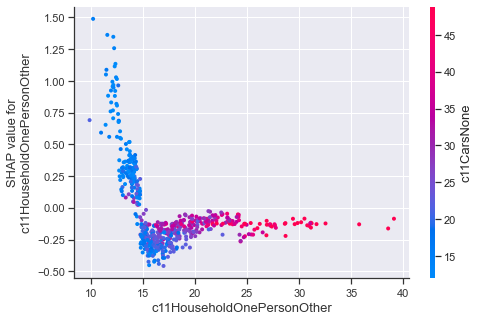

<Figure size 1152x720 with 0 Axes>

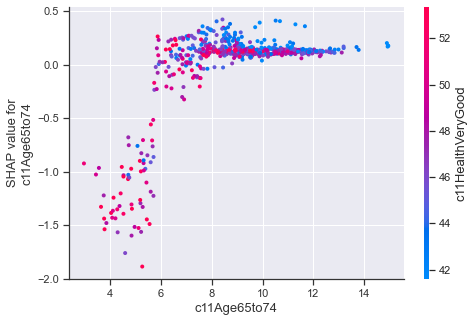

<Figure size 1152x720 with 0 Axes>

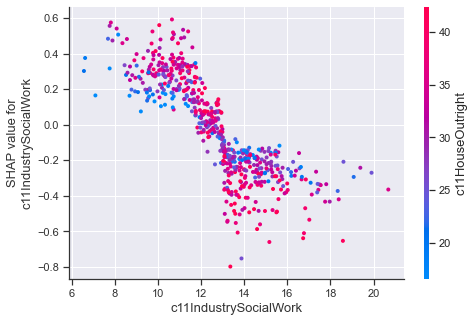

<Figure size 1152x720 with 0 Axes>

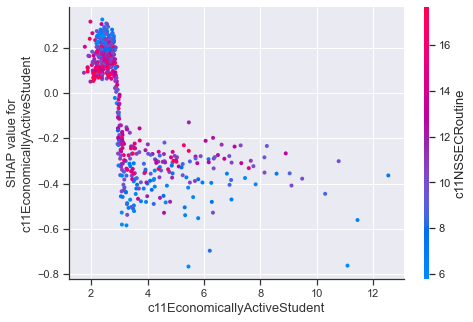

<Figure size 1152x720 with 0 Axes>

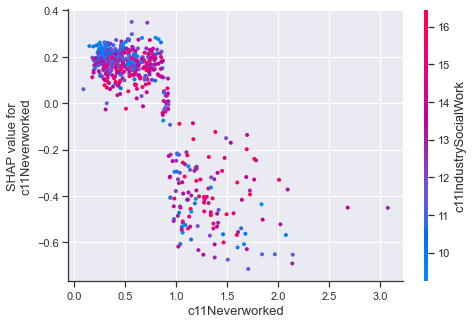

<Figure size 1152x720 with 0 Axes>

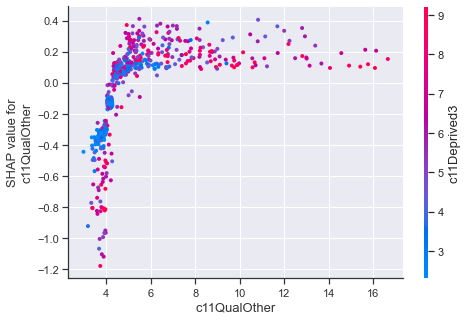

<Figure size 1152x720 with 0 Axes>

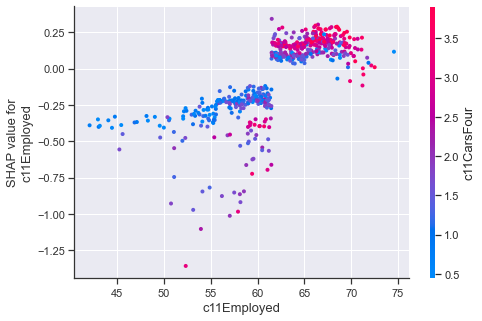

<Figure size 1152x720 with 0 Axes>

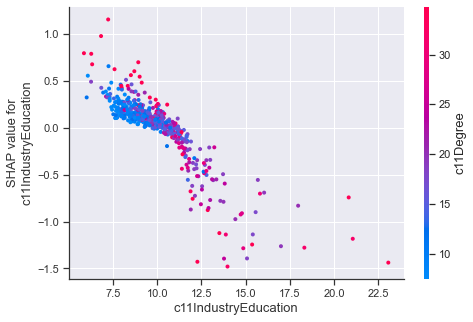

<Figure size 1152x720 with 0 Axes>

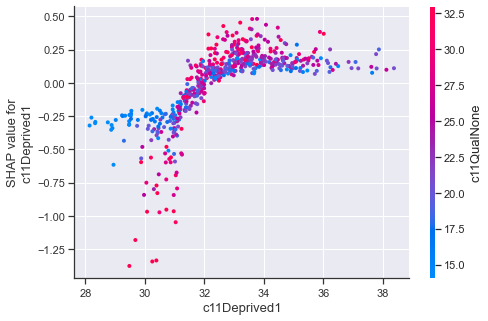

<Figure size 1152x720 with 0 Axes>

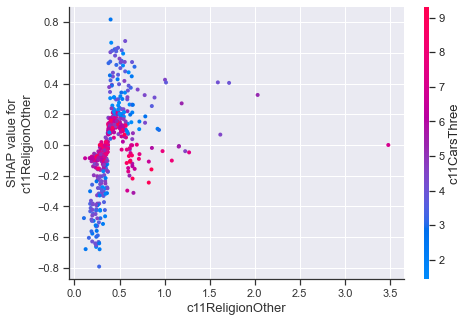

<Figure size 1152x720 with 0 Axes>

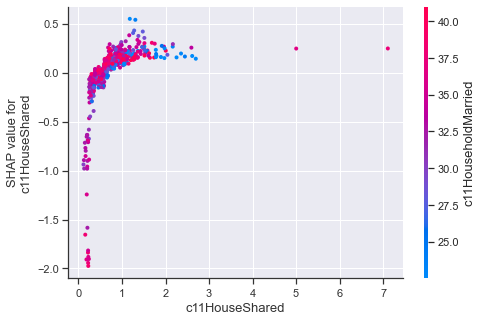

<Figure size 1152x720 with 0 Axes>

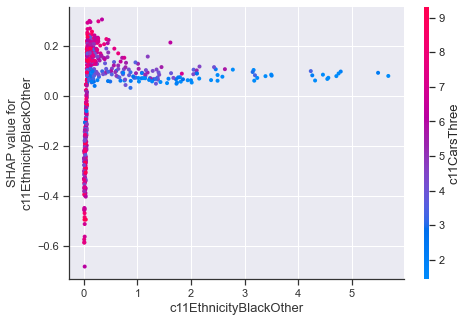

<Figure size 1152x720 with 0 Axes>

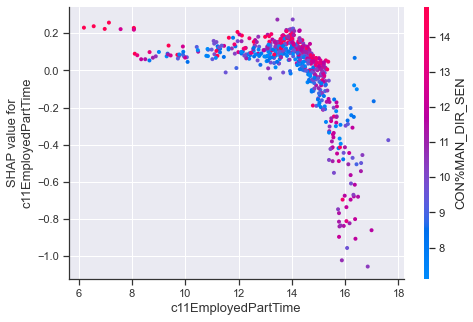

<Figure size 1152x720 with 0 Axes>

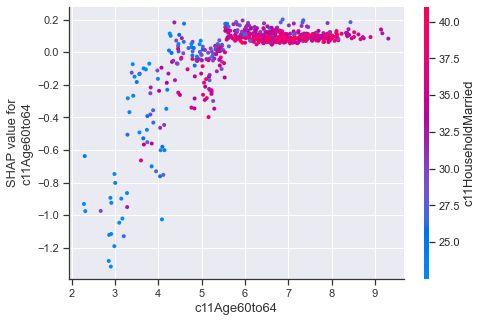

<Figure size 1152x720 with 0 Axes>

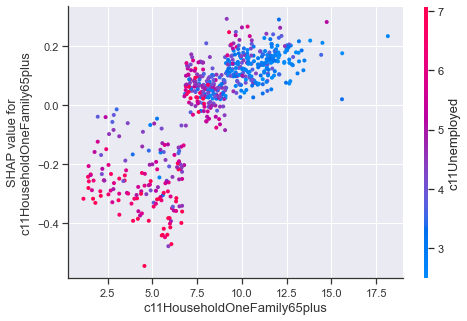

<Figure size 1152x720 with 0 Axes>

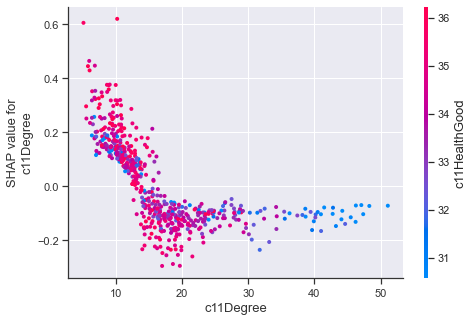

<Figure size 1152x720 with 0 Axes>

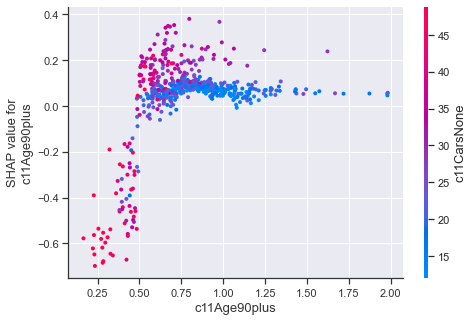

<Figure size 1152x720 with 0 Axes>

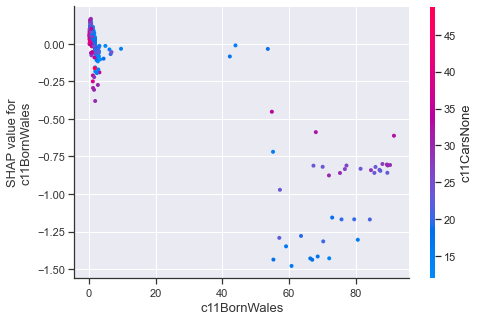

<Figure size 1152x720 with 0 Axes>

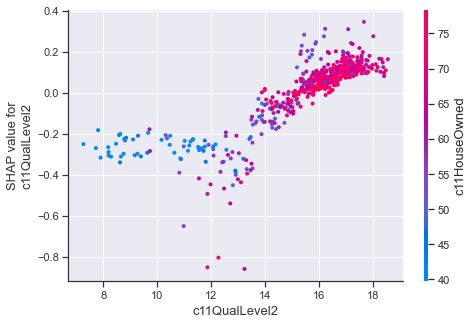

<Figure size 1152x720 with 0 Axes>

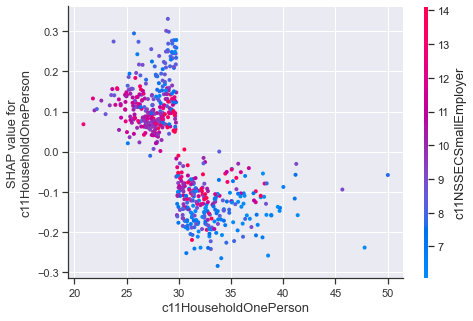

<Figure size 1152x720 with 0 Axes>

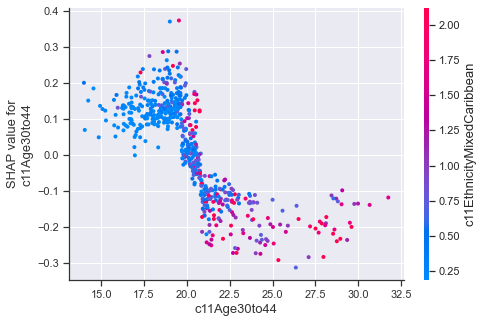

<Figure size 1152x720 with 0 Axes>

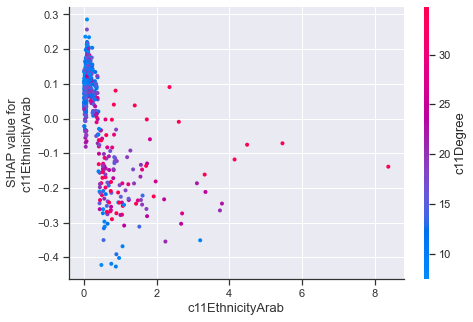

<Figure size 1152x720 with 0 Axes>

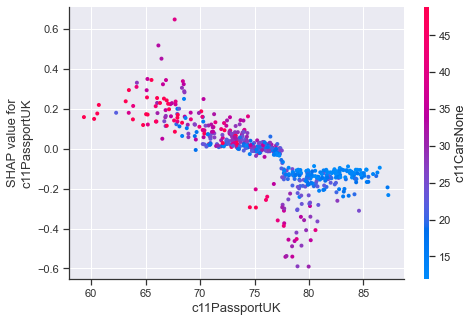

<Figure size 1152x720 with 0 Axes>

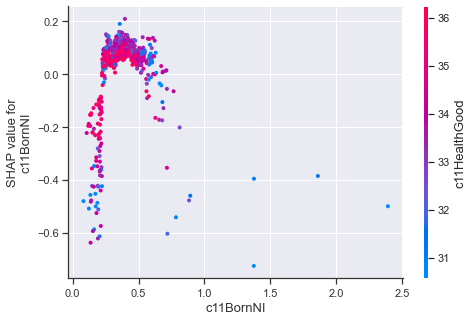

<Figure size 1152x720 with 0 Axes>

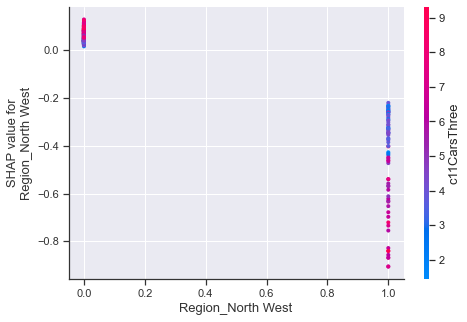

<Figure size 1152x720 with 0 Axes>

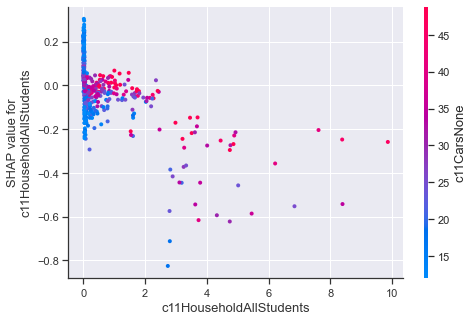

<Figure size 1152x720 with 0 Axes>

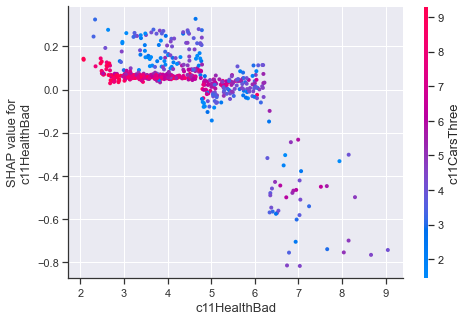

<Figure size 1152x720 with 0 Axes>

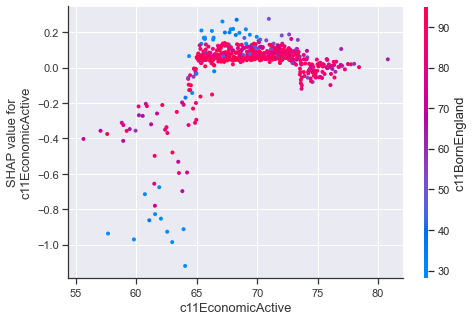

<Figure size 1152x720 with 0 Axes>

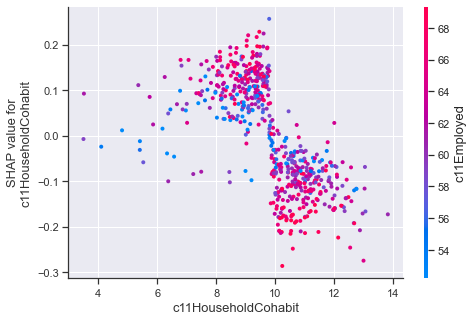

<Figure size 1152x720 with 0 Axes>

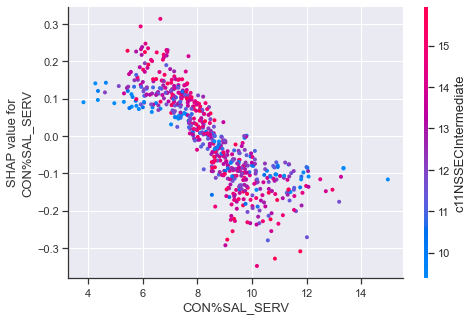

<Figure size 1152x720 with 0 Axes>

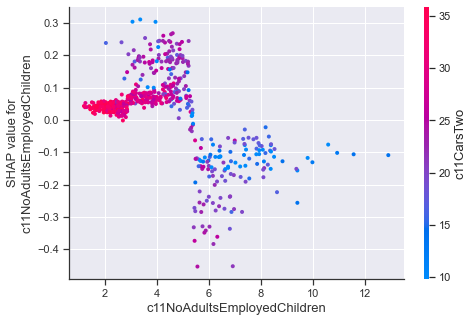

In [592]:
df_simp = pd.get_dummies(BES_census_data.drop(drop_cols,axis=1))

var_stub = "Con17"
Treatment = var_stub

var_list = [var_stub]
var_stub_list = [var_stub,]
mask = df_simp[var_stub].notnull() & (BES_census_data["Country"]!="Scotland")
wt_cols = ["leaveHanretty","remainHanretty"]
min_features = 30
colname = "Con17"
dependence_plots = True

alg = get_xgboost_alg(classification_problem=False)
title = "Con17_minusScotland_minusHanretty"

(explainer, shap_values, train_columns, train_index, alg,output_subfolder)=\
    xgboost_run(subdir=colname,dataset=df_simp[mask].drop(wt_cols,axis=1),
            var_list=var_list,var_stub_list=var_stub_list,
            use_specific_weights=None,
            min_features = min(df_simp.shape[1]-1,min_features),verbosity=0,
            skip_bar_plot=True,dependence_plots=dependence_plots,alg=alg,eval_metric=eval_metric,                    
            title = title)

In [589]:
better_half_nonlinear = train_columns[np.abs(shap_values).mean(0)>pd.Series(np.abs(shap_values).mean(0)).quantile(.5)]
better_half_nonlinear

Index(['RejectedVote17', 'RejectedVote15', 'c11Population',
       'c11PopulationDensity', 'c11Male', 'c11Female', 'c11Households',
       'c11Communal', 'c11Age0to4', 'c11Age5to7',
       ...
       'LDPPCsex15_Woman', 'LDPPCrace15_White', 'LDPPCrace15_BME',
       'PCPPCsex15_Man', 'UKIPPPCsex15_Man', 'UKIPPPCsex15_Woman',
       'UKIPPPCrace15_White', 'GreenPPCsex15_Man', 'GreenPPCsex15_Woman',
       'GreenPPCrace15_White'],
      dtype='object', length=236)

MSE: 28.72, MAE: 4.25, EV: 0.87, R2: 0.87


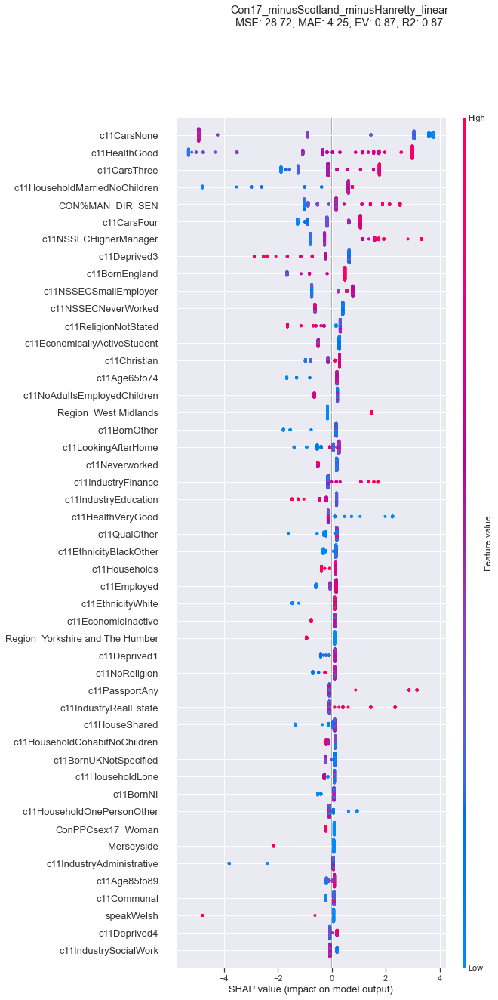

<Figure size 1152x720 with 0 Axes>

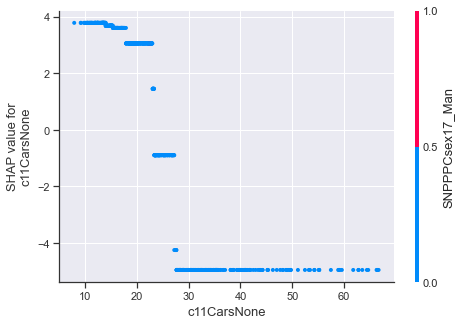

<Figure size 1152x720 with 0 Axes>

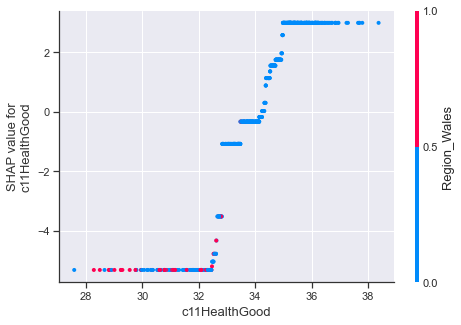

<Figure size 1152x720 with 0 Axes>

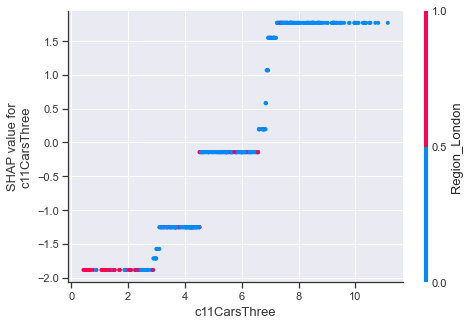

<Figure size 1152x720 with 0 Axes>

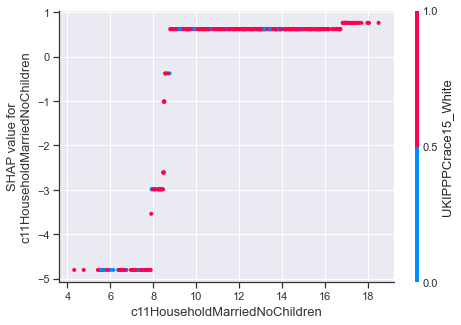

<Figure size 1152x720 with 0 Axes>

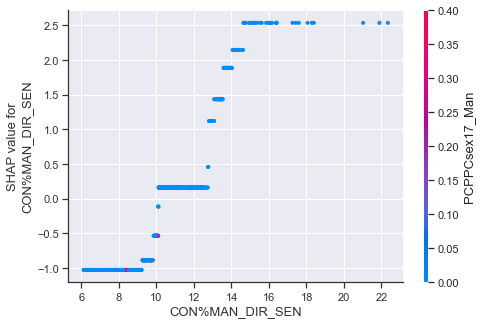

<Figure size 1152x720 with 0 Axes>

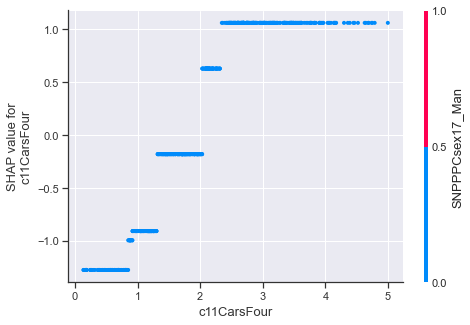

<Figure size 1152x720 with 0 Axes>

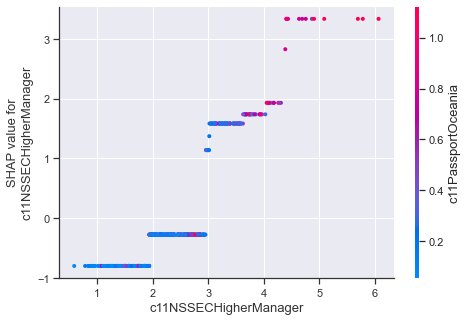

<Figure size 1152x720 with 0 Axes>

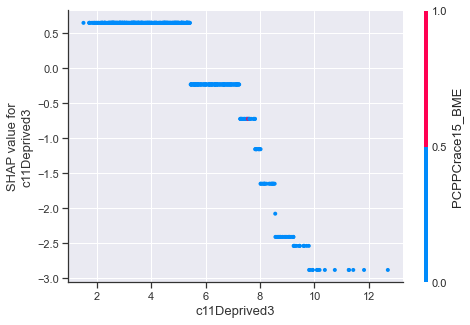

<Figure size 1152x720 with 0 Axes>

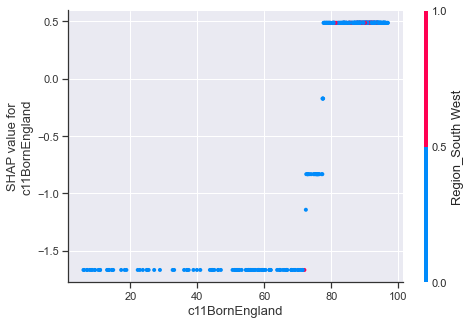

<Figure size 1152x720 with 0 Axes>

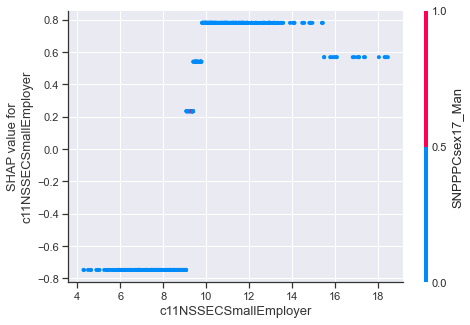

<Figure size 1152x720 with 0 Axes>

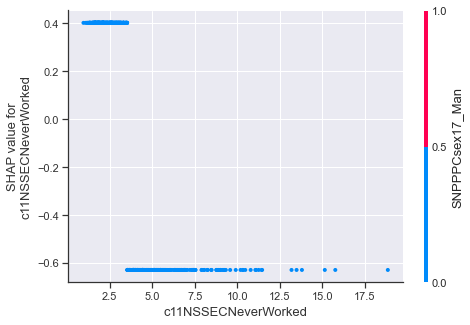

<Figure size 1152x720 with 0 Axes>

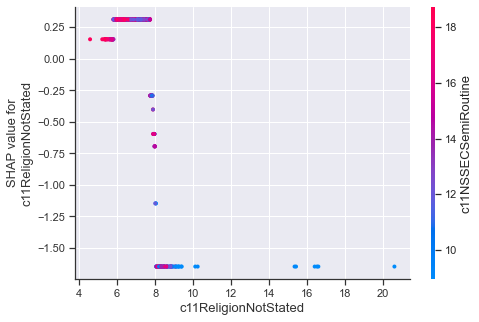

<Figure size 1152x720 with 0 Axes>

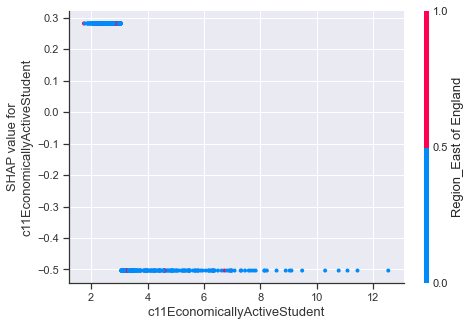

<Figure size 1152x720 with 0 Axes>

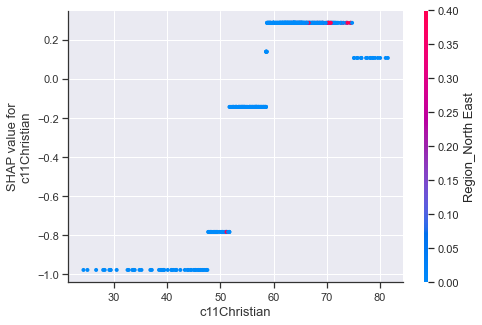

<Figure size 1152x720 with 0 Axes>

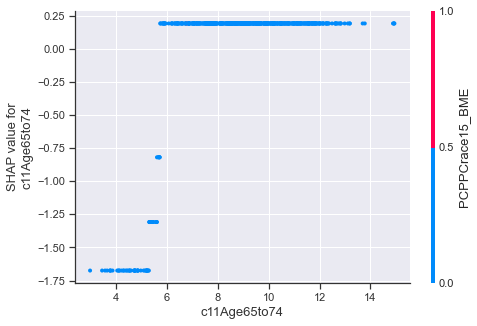

<Figure size 1152x720 with 0 Axes>

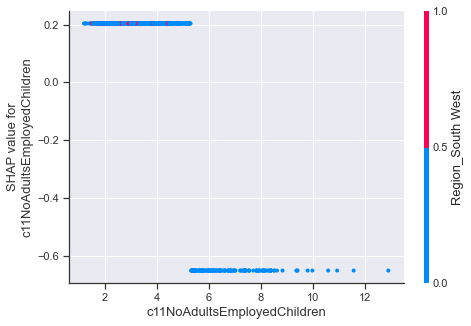

<Figure size 1152x720 with 0 Axes>

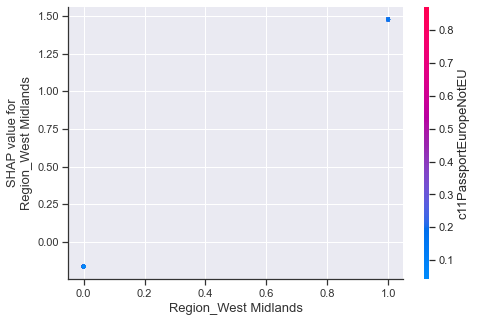

<Figure size 1152x720 with 0 Axes>

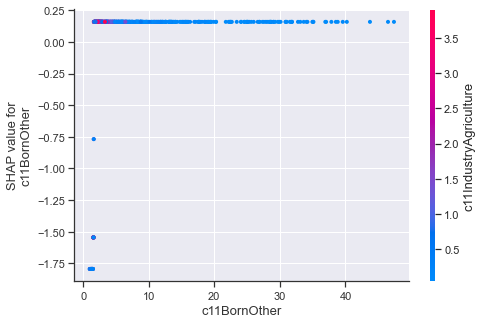

<Figure size 1152x720 with 0 Axes>

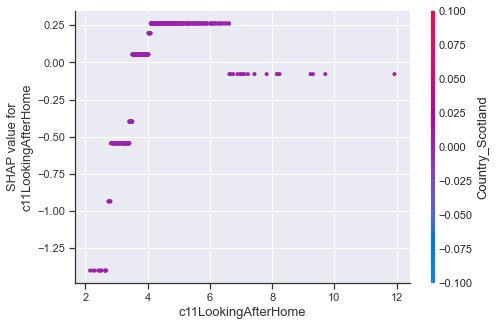

<Figure size 1152x720 with 0 Axes>

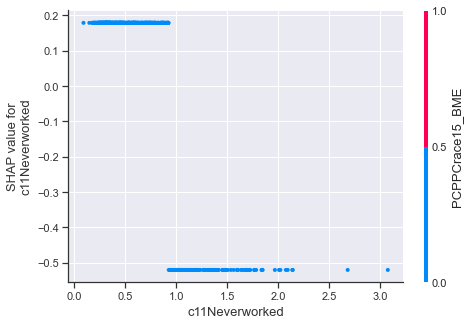

<Figure size 1152x720 with 0 Axes>

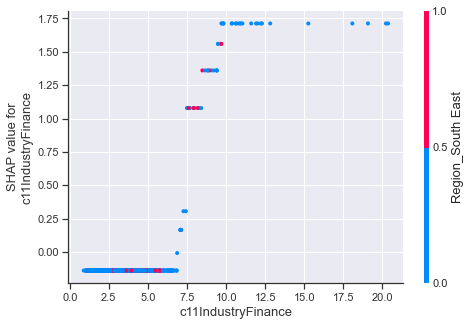

<Figure size 1152x720 with 0 Axes>

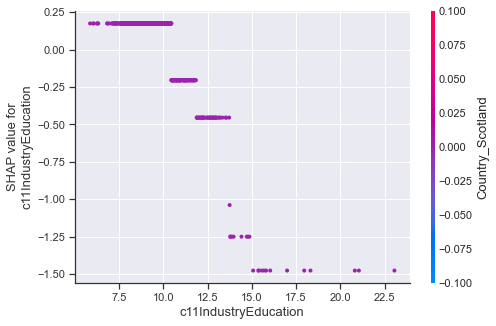

<Figure size 1152x720 with 0 Axes>

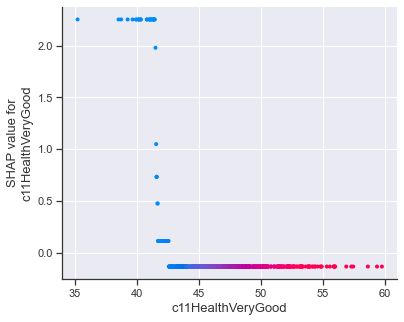

<Figure size 1152x720 with 0 Axes>

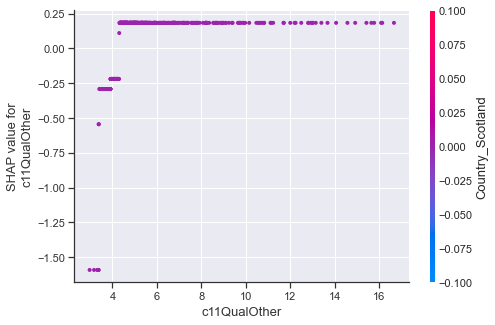

<Figure size 1152x720 with 0 Axes>

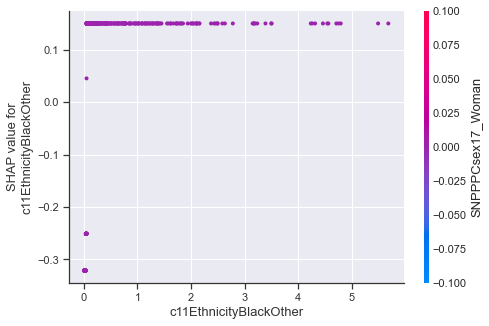

<Figure size 1152x720 with 0 Axes>

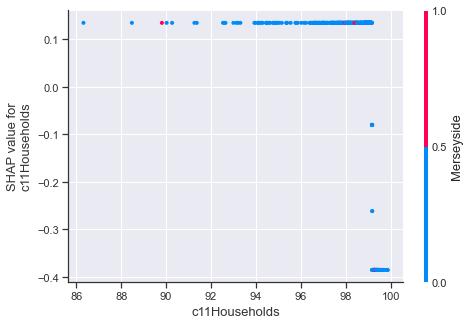

<Figure size 1152x720 with 0 Axes>

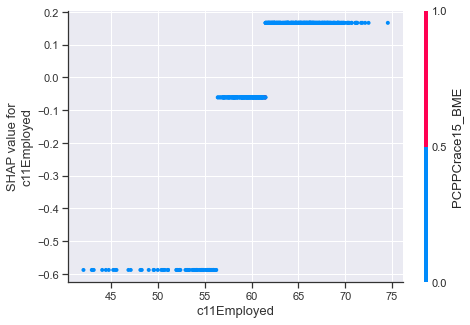

<Figure size 1152x720 with 0 Axes>

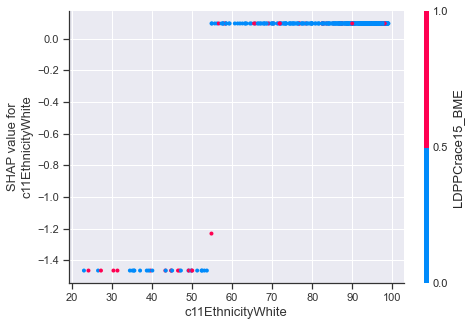

<Figure size 1152x720 with 0 Axes>

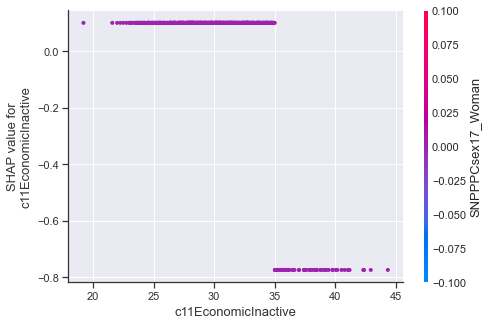

<Figure size 1152x720 with 0 Axes>

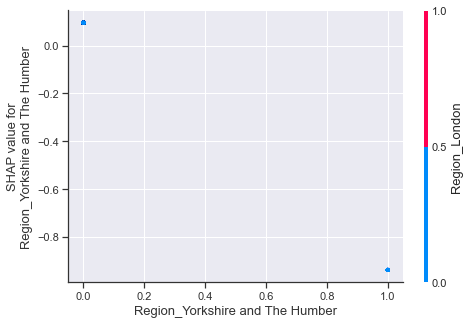

<Figure size 1152x720 with 0 Axes>

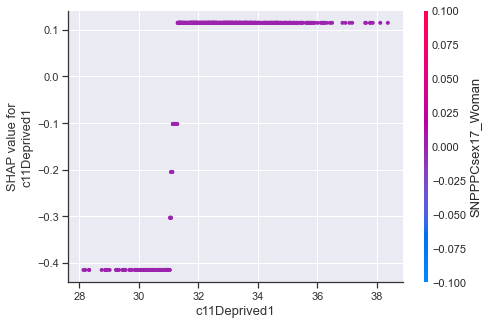

<Figure size 1152x720 with 0 Axes>

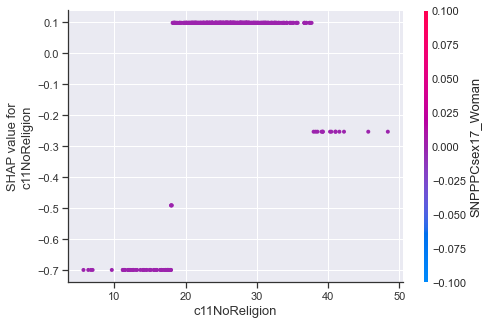

<Figure size 1152x720 with 0 Axes>

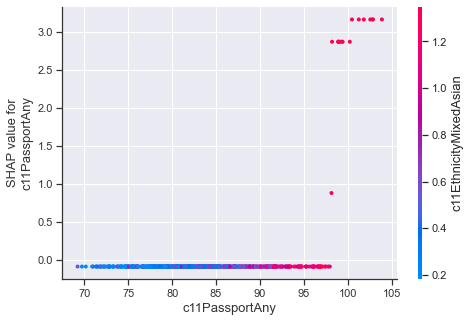

<Figure size 1152x720 with 0 Axes>

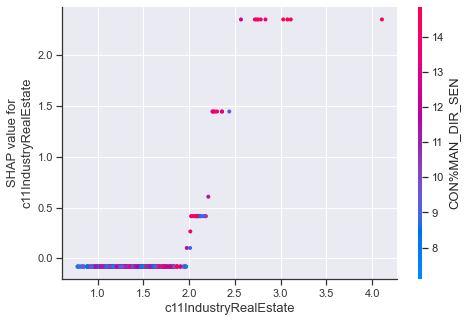

<Figure size 1152x720 with 0 Axes>

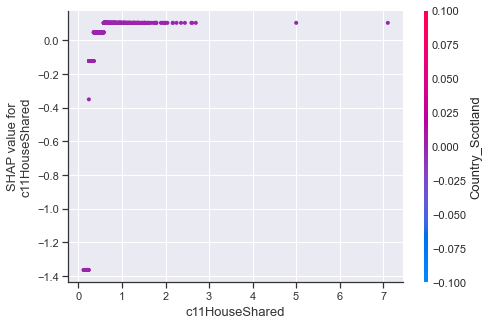

<Figure size 1152x720 with 0 Axes>

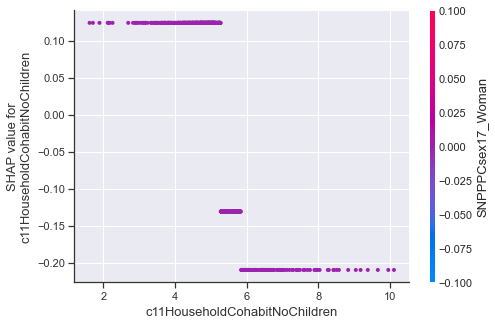

<Figure size 1152x720 with 0 Axes>

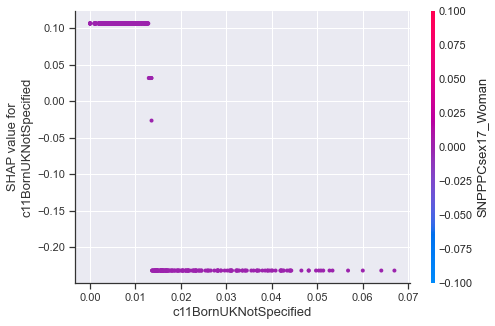

<Figure size 1152x720 with 0 Axes>

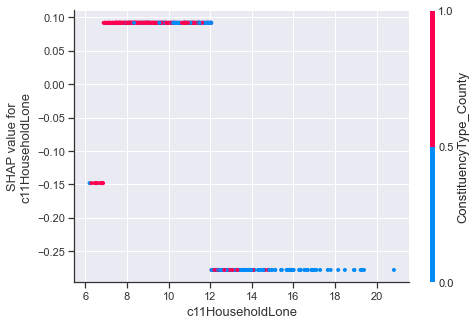

<Figure size 1152x720 with 0 Axes>

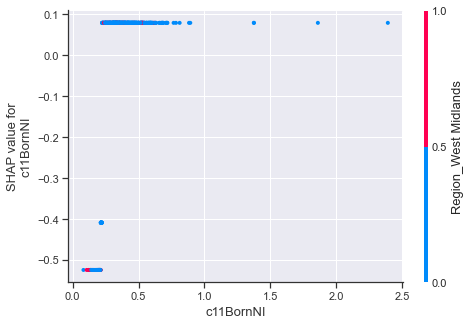

<Figure size 1152x720 with 0 Axes>

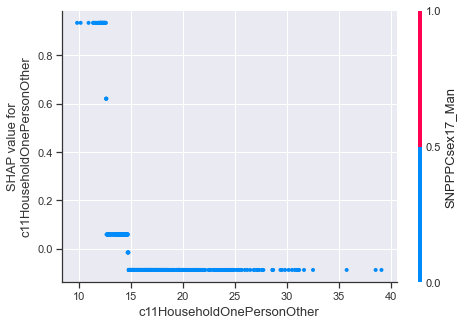

<Figure size 1152x720 with 0 Axes>

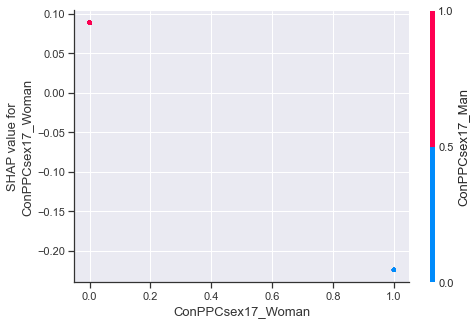

<Figure size 1152x720 with 0 Axes>

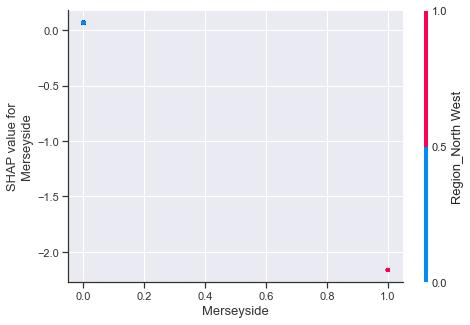

<Figure size 1152x720 with 0 Axes>

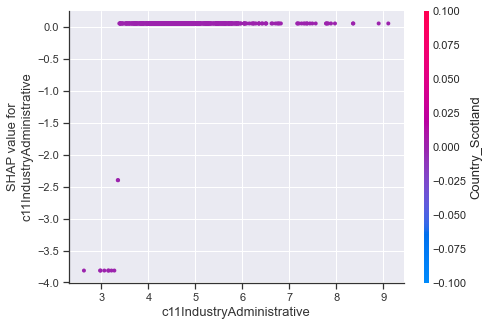

<Figure size 1152x720 with 0 Axes>

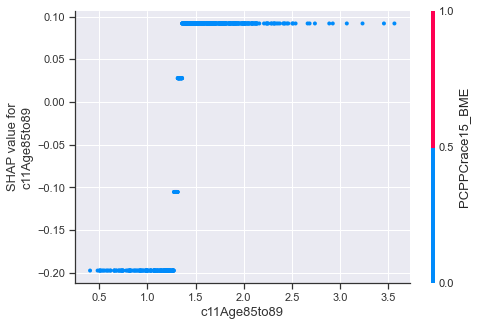

<Figure size 1152x720 with 0 Axes>

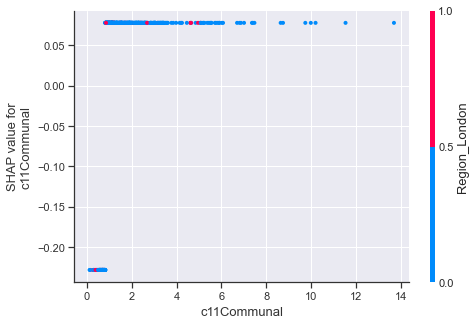

<Figure size 1152x720 with 0 Axes>

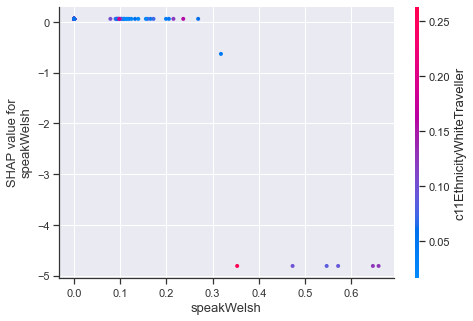

<Figure size 1152x720 with 0 Axes>

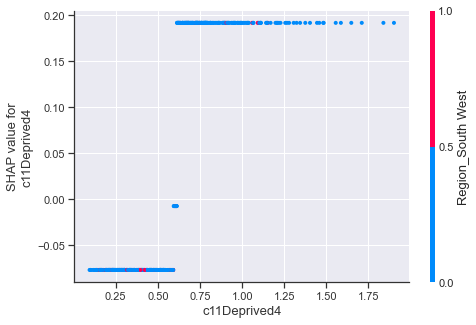

<Figure size 1152x720 with 0 Axes>

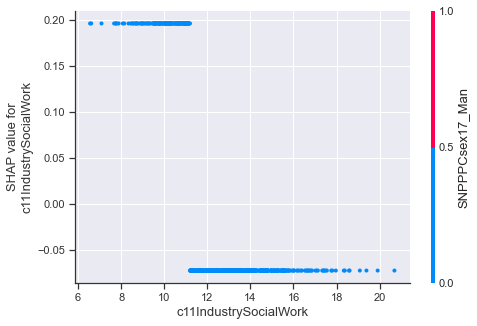

In [601]:
var_stub = "Con17"
Treatment = var_stub

var_list = [var_stub]
var_stub_list = [var_stub,]
mask = df_simp[var_stub].notnull() & (BES_census_data["Country"]!="Scotland")
wt_cols = ["leaveHanretty","remainHanretty"]
min_features = 30
colname = "Con17"
dependence_plots = True

alg = get_xgboost_alg(classification_problem=False)
alg.max_depth=1 ## try to force to linearity!
title = "Con17_minusScotland_minusHanretty_linear"

(explainer, shap_values, train_columns, train_index, alg,output_subfolder)=\
    xgboost_run(subdir=colname,dataset=df_simp[mask].drop(wt_cols,axis=1),
            var_list=var_list,var_stub_list=var_stub_list,
            use_specific_weights=None,
            min_features = min(df_simp.shape[1]-1,min_features),verbosity=0,
            skip_bar_plot=True,dependence_plots=dependence_plots,alg=alg,eval_metric=eval_metric,                    
            title = title)

In [602]:
better_half_linear = train_columns[np.abs(shap_values).mean(0)>0]

In [607]:
len([x for x in better_half_linear if x in better_half_nonlinear]),len(better_half_linear),len(better_half_nonlinear),

(86, 101, 128)

In [608]:
smaller_set = [x for x in better_half_linear if x in better_half_nonlinear]

In [617]:
"speakWelsh" in better_half_nonlinear

True

MSE: 31.89, MAE: 4.54, EV: 0.86, R2: 0.86


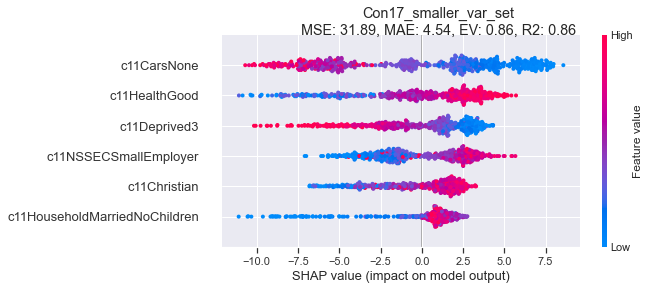

<Figure size 1152x720 with 0 Axes>

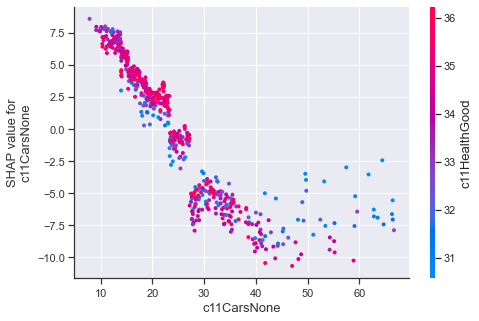

<Figure size 1152x720 with 0 Axes>

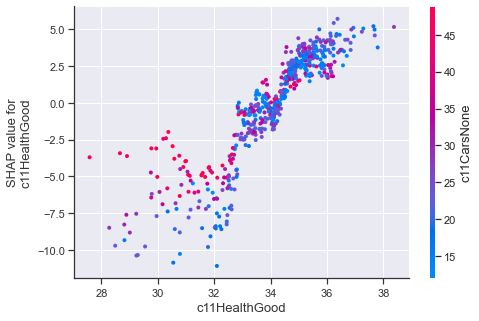

<Figure size 1152x720 with 0 Axes>

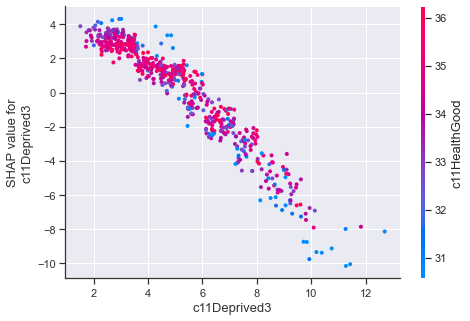

<Figure size 1152x720 with 0 Axes>

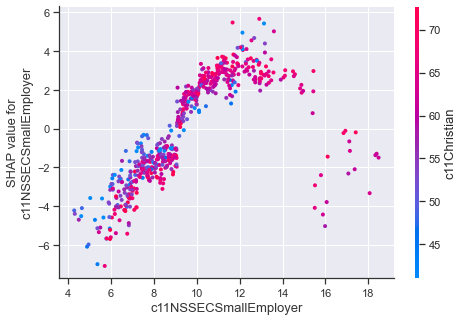

<Figure size 1152x720 with 0 Axes>

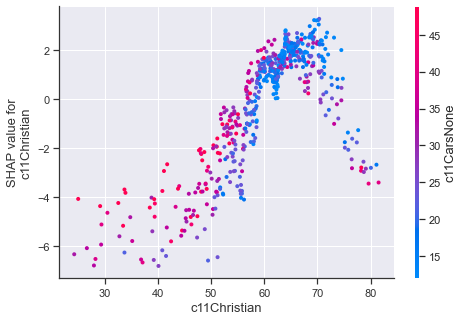

<Figure size 1152x720 with 0 Axes>

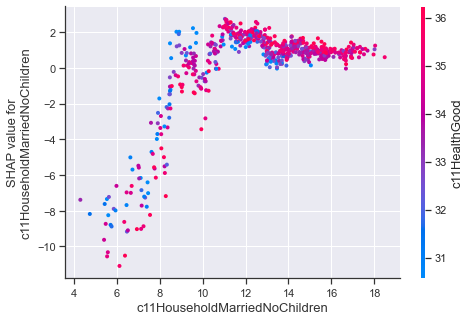

In [600]:
var_stub = "Con17"
Treatment = var_stub

specific_vars = ["c11CarsNone","c11HealthGood","c11NSSECSmallEmployer",
                 "c11HouseholdMarriedNoChildren","c11Deprived3","c11Christian"]

var_list = [var_stub]
var_stub_list = [var_stub,]
mask = df_simp[var_stub].notnull() & (BES_census_data["Country"]!="Scotland")
wt_cols = ["leaveHanretty","remainHanretty"]
min_features = 30
colname = "Con17"
dependence_plots = True

alg = get_xgboost_alg(classification_problem=False)
title = "Con17_smaller_var_set"

(explainer, shap_values, train_columns, train_index, alg,output_subfolder)=\
    xgboost_run(subdir=colname,dataset=df_simp[mask].drop(wt_cols,axis=1)[specific_vars+[var_stub]],
            var_list=var_list,var_stub_list=var_stub_list,
            use_specific_weights=None,
            min_features = min(df_simp.shape[1]-1,min_features),verbosity=0,
            skip_bar_plot=True,dependence_plots=dependence_plots,alg=alg,eval_metric=eval_metric,                    
            title = title)

In [216]:
predCon17 = pd.Series(alg.predict(df_simp[train_columns]),index=df_simp.index)

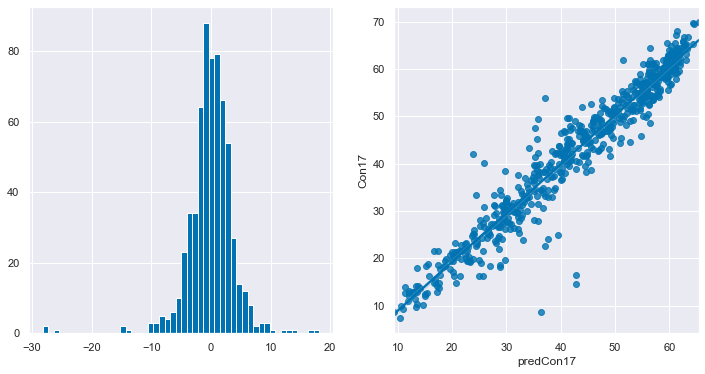

In [220]:
merged["predCon17"]=np.nan
merged.loc[ BES_census_data.loc[df_simp.index,"ONSConstID"],"predCon17" ] = predCon17.values
# merged.loc[dataset.index,"predCon17"] = model.predict(results.params)*100
merged["residCon17"] = merged["Con17"] - merged["predCon17"]

fig, axes = plt.subplots(nrows=1,ncols=2,figsize=(12,6))
merged["residCon17"].hist(bins=50,ax=axes[0])
mask = merged["residCon17"].notnull()
# plt.figure()
sns.regplot(merged["predCon17"][mask],merged["Con17"][mask],ax=axes[1])

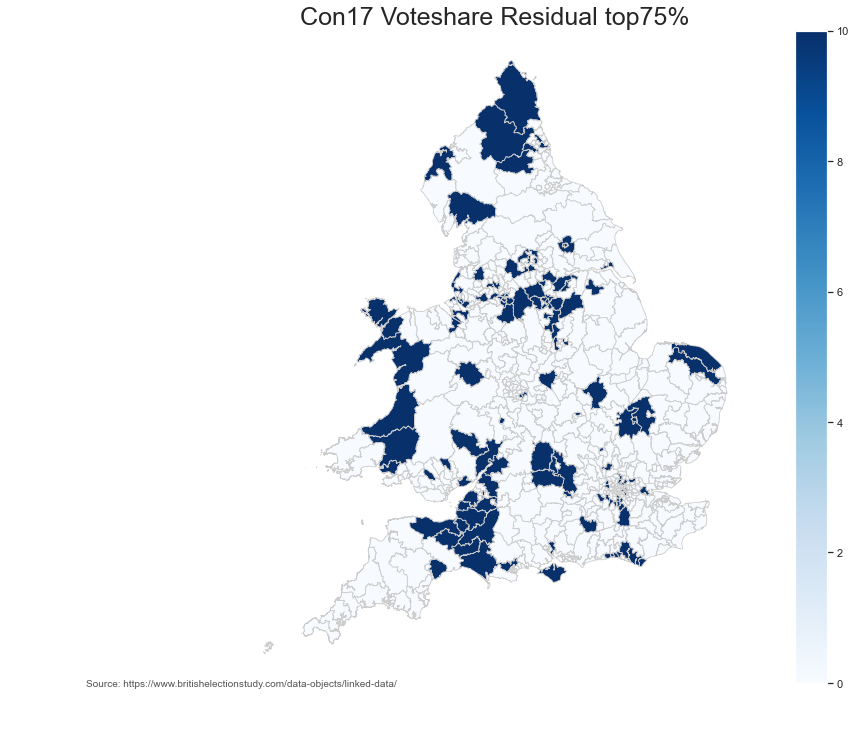

In [349]:
merged["residCon17_top75"] = merged["residCon17"]<merged["residCon17"].quantile(.25)
merged.loc[merged["Country"].isin(["Scotland"]),"residCon17_top75"]=np.nan

# set a variable that will call whatever column we want to visualise on the map
variable = "residCon17_top75"
# title = 'Leave%\n(Constituency level - estimate by Chris Hanretty)'
title = "Con17 Voteshare Residual top75%"

# set the range for the choropleth
vmin, vmax = np.floor(merged[variable].min()/10)*10, np.ceil(merged[variable].max()/10)*10

# create figure and axes for Matplotlib
fig, ax = plt.subplots(1, figsize=(16, 12))

# create map
merged.plot(column=variable, cmap='Blues', linewidth=0.8, ax=ax, edgecolor='0.8')

# Now we can customise and add annotations

# remove the axis
ax.axis('off')

# add a title
ax.set_title(title, \
              fontdict={'fontsize': '25',
                        'fontweight' : '3'})

# create an annotation for the  data source
ax.annotate('Source: https://www.britishelectionstudy.com/data-objects/linked-data/',
           xy=(0.1, .08), xycoords='figure fraction',
           horizontalalignment='left', verticalalignment='top',
           fontsize=10, color='#555555')

# Create colorbar as a legend
sm = plt.cm.ScalarMappable(cmap='Blues', norm=plt.Normalize(vmin=vmin, vmax=vmax))
sm._A = []
cbar = fig.colorbar(sm)

Treatment = "Chloropleth"
output_subfolder = create_subdir(BES_output_folder,Treatment)
fname = output_subfolder +title +".png"
# this will save the figure as a high-res png. you can also save as svg
plt.savefig( fname, bbox_inches='tight', dpi=1000 )

# fig.savefig('testmap.png', dpi=300)

In [232]:
merged["residCon17_top75"] = merged["residCon17"]<merged["residCon17"].quantile(.25)
merged.loc[merged["Country"].isin(["Scotland"]),"residCon17_top75"]=np.nan
new_fit_binary = merged["residCon17_top75"].copy()

merged["residCon17_top75"] = merged["residCon17_jkrep"]<merged["residCon17_jkrep"].quantile(.25)
merged.loc[merged["Country"].isin(["Scotland"]),"residCon17_top75"]=np.nan
jk_fit_binary = merged["residCon17_top75"].copy()

In [234]:
new_fit_binary.value_counts()

0.0    442
1.0    131
Name: residCon17_top75, dtype: int64

In [235]:
jk_fit_binary.value_counts()

0.0    430
1.0    143
Name: residCon17_top75, dtype: int64

In [237]:
(new_fit_binary*jk_fit_binary).sum()

76.0

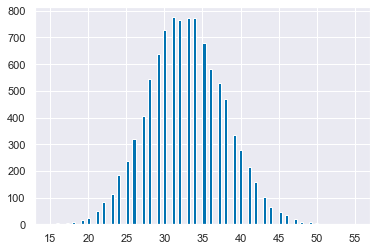

In [263]:
hacker_stats = pd.DataFrame( np.random.rand(new_fit_binary.shape[0],10000)<new_fit_binary.mean() ).astype(float)
hacker_stats.apply(lambda x: (x*jk_fit_binary.values).sum()).hist(bins=100)

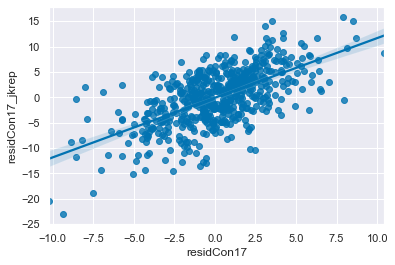

In [265]:
sns.regplot(x=merged["residCon17"],y=merged["residCon17_jkrep"])

In [277]:
import statsmodels.api as sm
dataset = merged[merged["Country"].isin(["England","Wales"])]

Y = dataset['Con17']/100
X = dataset[specific_vars].astype('float')
X = sm.add_constant(X)
model = sm.OLS(Y,X)
results = model.fit()
results.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  Con17   R-squared:                       0.772
Model:                            OLS   Adj. R-squared:                  0.770
Method:                 Least Squares   F-statistic:                     319.5
Date:                Sat, 15 Jan 2022   Prob (F-statistic):          4.34e-178
Time:                        22:50:35   Log-Likelihood:                 699.90
No. Observations:                 573   AIC:                            -1386.
Df Residuals:                     566   BIC:                            -1355.
Df Model:                           6                                         
Covariance Type:            nonrobust                                         
=================================================================================================
                                    coef    std err          t      P>|t|      [0.025      0.975]
-------------------------------------------------------------------------------------------------
const                            -0.3275      0.078     -4.187      0.000      -0.481      -0.174
c11CarsNone                      -0.0017      0.001     -2.941      0.003      -0.003      -0.001
c11HealthGood                     0.0209      0.002     11.088      0.000       0.017       0.025
c11NSSECSmallEmployer             0.0056      0.001      3.851      0.000       0.003       0.008
c11HouseholdMarriedNoChildren     0.0082      0.002      3.706      0.000       0.004       0.013
c11Deprived3                     -0.0286      0.002    -12.381      0.000      -0.033      -0.024
c11Christian                      0.0016      0.000      3.542      0.000       0.001       0.002
==============================================================================
Omnibus:                       21.834   Durbin-Watson:                   1.867
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               43.608
Skew:                          -0.205   Prob(JB):                     3.39e-10
Kurtosis:                       4.288   Cond. No.                     1.97e+03
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 1.97e+03. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

In [ ]:
## let's try putting JKES's variables into a forest regression

,c11CarsThree,c11HealthGood,c11NSSECHigherManager,c11NSSECNeverWorked,c11Age65to74
0,4.854913,28.279376,1.276570,4.945936,9.535330
1,5.989419,32.620757,1.750612,2.544322,12.005672
6,7.269561,35.648852,2.707991,2.626362,7.028348
7,7.049333,35.730247,2.466014,3.005847,11.750721
8,6.459851,30.666418,3.787637,2.151737,8.780321
...,...,...,...,...,...
627,6.764144,36.233296,2.631408,1.832355,10.634652
628,7.517814,30.550100,2.097682,3.150458,12.292297
629,2.283468,33.713432,1.735585,1.995492,6.557173
630,5.685916,34.715878,3.017229,1.256450,10.765060


In [648]:
%%time
masked_df_simp = df_simp[mask].copy()
Y = masked_df_simp[var_stub]
res_store = pd.DataFrame(columns = ["r2","cond"])




for spec_vars in list(combinations(list(better_half_linear),3)):

    model = sm.OLS(Y,sm.add_constant(masked_df_simp[list(spec_vars)]))
    results = model.fit()
    res_store.loc["|".join(spec_vars)] = [results.rsquared,results.condition_number]

Wall time: 50min 36s


In [674]:
res_store.sort_values(by='cond',ascending=False).head(200)
# c11Male,c11Female - drop one!
# c11Households,c11Communal
# c11HouseSocial|c11HouseSocialLA|c11HouseSocialOther

,r2,cond
RejectedVote17|c11Male|c11Female,0.081842,3.378055e+18
c11Male|c11Female|c11Households,0.074149,2.621244e+18
c11Male|c11Female|c11EthnicityWhite,0.275398,2.430532e+18
c11Male|c11Female|c11BornUK,0.198943,2.418694e+18
c11Male|c11Female|c11PassportAny,0.074812,2.325043e+18
...,...,...
c11Households|c11Communal|c11EthnicityArab,0.153244,3.662141e+17
c11Households|c11Communal|c11NoReligion,0.015454,3.660952e+17
c11Households|c11Communal|c11HouseSocialLA,0.324339,3.496441e+17
c11HouseSocial|c11HouseSocialLA|c11HouseSocialOther,0.453287,1.593367e+16


In [913]:
BES_census_data[["c11Male","c11Female","c11Households","c11Communal","c11HouseSocial","c11HouseSocialLA","c11HouseSocialOther"]].corr()

,c11Male,c11Female,c11Households,c11Communal,c11HouseSocial,c11HouseSocialLA,c11HouseSocialOther
c11Male,1.000000,-1.000000,0.215008,0.336147,0.151769,0.106671,0.082421
c11Female,-1.000000,1.000000,-0.215008,-0.336147,-0.151769,-0.106671,-0.082421
c11Households,0.215008,-0.215008,1.000000,-0.068713,-0.251171,-0.149529,-0.171544
c11Communal,0.336147,-0.336147,-0.068713,1.000000,0.038773,-0.031087,0.096969
c11HouseSocial,0.151769,-0.151769,-0.251171,0.038773,1.000000,0.742839,0.491030
c11HouseSocialLA,0.106671,-0.106671,-0.149529,-0.031087,0.742839,1.000000,-0.218447
c11HouseSocialOther,0.082421,-0.082421,-0.171544,0.096969,0.491030,-0.218447,1.000000


In [932]:
BES_census_data.drop(strict_drop_vars,axis=1).corr(min_periods=10).replace(1,0).max().sort_values().dropna().tail(50)

UKIP15                      0.951245
Lab10                       0.953441
LabVote10                   0.953441
UKIPVote10                  0.953697
UKIP10                      0.953697
Con17                       0.954666
UKIP17                      0.956285
UKIPVote17                  0.956285
BNP10                       0.957914
BNPVote10                   0.957914
c11EthnicityBlackAfrican    0.958094
c11CarsTwo                  0.959558
c11BornIreland              0.959717
c11EthnicityWhiteIrish      0.959717
c11Age90plus                0.961776
c11Age85to89                0.961776
ConVote17                   0.962141
c11Degree                   0.963272
c11QualLevel4               0.963272
c11HealthVeryBad            0.963591
c11HealthBad                0.963591
c11Age60to64                0.965234
Lab17                       0.965889
Lab15                       0.965889
c11EthnicityBlackOther      0.967539
c11EthnicityBlack           0.967539
c11BornOtherEU              0.968882
c

In [933]:
BES_census_data.corr(min_periods=10)["c11Households"].sort_values().dropna()

c11Communal                      -1.000000
c11Age18to19                     -0.762369
c11EconomicallyInactiveStudent   -0.700627
c11FulltimeStudent               -0.694118
c11HouseholdAllStudents          -0.652158
                                    ...   
c11Age5to7                        0.420857
c11Age8to9                        0.468620
c11Age15                          0.478955
c11Age10to14                      0.500577
c11Households                     1.000000
Name: c11Households, Length: 273, dtype: float64

0.9956280825671314

In [920]:
BES_census_data[["c11BornScotland","c11Households"]]

,c11BornScotland,c11Households
0,0.662302,99.287799
1,1.143313,97.594611
2,72.349329,0.945401
3,74.242733,0.971609
4,78.557409,0.989249
...,...,...
627,1.509604,97.991253
628,1.015039,98.838726
629,2.074570,97.369657
630,2.286214,94.755155


In [936]:
# c11LongTermUnemployed<->c11NSSECLongtermUnemployed,c11Unemployed
# Green17, GreenVote17 
# c11HousePrivateLandlord <-> c11HousePrivate
# Green10 <-> GreenVote10
# c11FulltimeStudent <-> c11EconomicallyInactiveStudent
# c11PassportEU <-> c11BornOtherEU
# c11HouseholdLone <-> c11HouseholdLoneDependents
# c11PassportIreland <-> c11EthnicityWhiteIrish
# c11EthnicityWhiteBritish <-> c11EthnicityWhite

# c11EconomicActive             -1.000000
# c11EconomicInactive           -1.000000
# c11Male                       -1.000000
# c11Female                     -1.000000
# remainHanretty                -1.000000
# leaveHanretty                 -1.000000

# c11PassportNone               -0.994953
# c11PassportAny                -0.994953

# c11BornScotland               -0.993506
# c11Households                 -0.993506
# ???????


# c11BornOther                  -0.987962
# c11EthnicityWhiteBritish      -0.982135 (c11BornOther)
# c11BornUK                     -0.987962

# c11EnglishAll                 -0.986686
# c11EnglishNone                -0.986686
# c11EnglishOne                 -0.980912 (c11EnglishAll)

# c11Households                 -1.000000
# c11Communal                   -1.000000


strict_drop_vars = ["c11LongTermUnemployed","c11Unemployed","c11HousePrivateLandlord",
                    "c11EconomicallyInactiveStudent","c11PassportIreland","c11HouseholdLoneDependents","c11PassportEU",
                    "c11BornOther","c11BornUK","c11EthnicityWhite","c11EconomicInactive","c11Male",
                    "remainHanretty","leaveHanretty","c11PassportNone","c11EnglishAll","c11EnglishOne","c11Communal"]

In [937]:
df_simp.drop(strict_drop_vars,axis=1)

,Con17,RejectedVote17,RejectedVote15,c11Population,c11PopulationDensity,c11Female,c11Households,c11Age0to4,c11Age5to7,c11Age8to9,...,PCPPCrace15_White,PCPPCrace15_BME,UKIPPPCsex15_Man,UKIPPPCsex15_Woman,UKIPPPCrace15_White,UKIPPPCrace15_BME,GreenPPCsex15_Man,GreenPPCsex15_Woman,GreenPPCrace15_White,GreenPPCrace15_BME
0,17.737766,57,57,66133,3.751395,51.233121,99.287799,5.511621,3.161810,2.000514,...,1,0,1,0,1,0,1,0,1,0
1,44.594090,78,59,56415,0.935424,51.665337,97.594611,4.956129,2.761677,1.777896,...,1,0,1,0,1,0,0,1,1,0
2,22.692276,55,78,99654,20.458633,50.562948,0.945401,5.376603,2.587954,1.524274,...,0,0,0,0,0,0,0,0,0,0
3,42.132470,63,56,93197,11.490198,50.528450,0.971609,5.063468,2.489351,1.611640,...,0,0,0,1,1,0,1,0,1,0
4,47.852785,49,43,91710,0.279272,50.610620,0.989249,5.851052,3.577582,2.240759,...,0,0,1,0,1,0,1,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
627,54.489597,94,163,106783,2.662853,50.637274,97.991253,5.811787,3.228042,2.053698,...,0,0,1,0,1,0,0,1,1,0
628,27.789226,40,67,69751,0.980694,50.862353,98.838726,5.559777,2.984903,1.981334,...,1,0,1,0,1,0,0,0,0,0
629,30.174427,213,224,104359,44.501633,50.685614,97.369657,5.827001,2.761621,1.655823,...,0,0,1,0,1,0,1,0,1,0
630,51.118812,146,154,93692,3.770519,52.194424,94.755155,4.905435,3.057892,1.999103,...,0,0,1,0,1,0,0,1,1,0


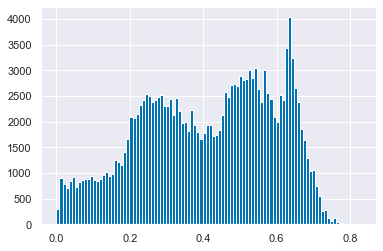

In [655]:
res_store["r2"].hist(bins=100)

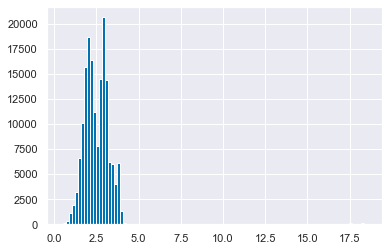

In [665]:
res_store["cond"].apply(lambda x: np.log10(x)).hist(bins=100)

In [713]:
pd.DataFrame([x.split("|") for x in res_store[(res_store["r2"]>=.6)&(res_store["cond"]<=350)].index]).stack().value_counts().head(50)

vc = pd.DataFrame([x.split("|") for x in res_store[(res_store["r2"]>=.6)&(res_store["cond"]<=350)].index]).stack().value_counts()
vc[vc>=540].index

Index(['c11CarsFour', 'c11Deprived3', 'c11CarsThree', 'c11CarsNone',
       'c11HouseholdMarriedNoChildren', 'c11NoAdultsEmployedChildren',
       'c11NSSECHigherManager', 'CON%MAN_DIR_SEN', 'c11Neverworked',
       'c11HealthBad', 'c11HouseholdLone', 'c11NSSECNeverWorked',
       'c11HouseholdOnePersonOther', 'c11FulltimeStudent', 'c11Age65to74',
       'c11Age60to64', 'c11HouseholdLoneNodependents',
       'c11EconomicallyActiveStudent', 'c11IndustryConstruction', 'c11Degree',
       'c11NSSECIntermediate', 'c11IndustrySocialWork', 'c11LookingAfterHome',
       'c11Age16to17', 'c11HouseSocial', 'CON%PROF', 'c11Deprived4',
       'c11NSSECSmallEmployer'],
      dtype='object')

In [714]:
final_cut = ['c11CarsFour', 'c11Deprived3', 'c11CarsThree', 'c11CarsNone',
       'c11HouseholdMarriedNoChildren', 'c11NoAdultsEmployedChildren',
       'c11NSSECHigherManager', 'CON%MAN_DIR_SEN', 'c11Neverworked',
       'c11HealthBad', 'c11HouseholdLone', 'c11NSSECNeverWorked',
       'c11HouseholdOnePersonOther', 'c11FulltimeStudent', 'c11Age65to74',
       'c11Age60to64', 'c11HouseholdLoneNodependents',
       'c11EconomicallyActiveStudent', 'c11IndustryConstruction', 'c11Degree',
       'c11NSSECIntermediate', 'c11IndustrySocialWork', 'c11LookingAfterHome',
       'c11Age16to17', 'c11HouseSocial', 'CON%PROF', 'c11Deprived4',
       'c11NSSECSmallEmployer']

res_store_5 = pd.DataFrame(columns = ["r2","cond"])

for spec_vars in list(combinations(final_cut,5)):

    model = sm.OLS(Y,sm.add_constant(masked_df_simp[list(spec_vars)]))
    results = model.fit()
    res_store_5.loc["|".join(spec_vars)] = [results.rsquared,results.condition_number]

In [717]:
res_store_5.sort_values(by='r2',ascending=False).head(200).head(50)

,r2,cond
CON%MAN_DIR_SEN|c11HealthBad|c11NSSECNeverWorked|c11Degree|c11LookingAfterHome,0.845266,263.385849
CON%MAN_DIR_SEN|c11HealthBad|c11NSSECNeverWorked|c11EconomicallyActiveStudent|c11Degree,0.844994,285.016513
CON%MAN_DIR_SEN|c11HealthBad|c11NSSECNeverWorked|c11FulltimeStudent|c11Degree,0.843667,277.229603
CON%MAN_DIR_SEN|c11HealthBad|c11HouseholdLone|c11NSSECNeverWorked|c11Degree,0.842968,304.968085
CON%MAN_DIR_SEN|c11HealthBad|c11NSSECNeverWorked|c11Age65to74|c11Degree,0.842592,257.428331
CON%MAN_DIR_SEN|c11HealthBad|c11NSSECNeverWorked|c11HouseholdLoneNodependents|c11Degree,0.842491,260.848435
c11HouseholdMarriedNoChildren|CON%MAN_DIR_SEN|c11HealthBad|c11NSSECNeverWorked|c11Degree,0.842059,336.784485
c11NSSECHigherManager|CON%MAN_DIR_SEN|c11HealthBad|c11NSSECNeverWorked|c11Degree,0.841853,226.699353
CON%MAN_DIR_SEN|c11HealthBad|c11NSSECNeverWorked|c11Degree|c11IndustrySocialWork,0.841799,316.475425
c11Deprived3|CON%MAN_DIR_SEN|c11Degree|c11IndustrySocialWork|c11Deprived4,0.841592,333.829195


In [ ]:
# CON%MAN_DIR_SEN
# c11Degree
# c11HealthBad
# c11Deprived3|c11NSSECNeverWorked|?c11Neverworked

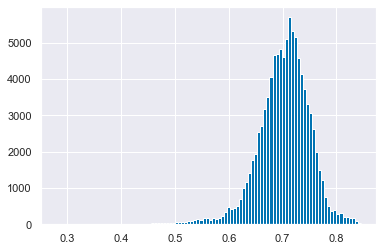

In [718]:
res_store_5["r2"].hist(bins=100)

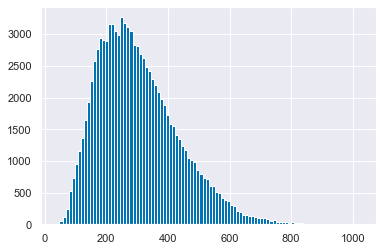

In [719]:
res_store_5["cond"].hist(bins=100)

In [726]:
pd.DataFrame([x.split("|") for x in res_store_5[(res_store_5["r2"]>=.7)].index]).stack().value_counts().head(50)

# vc = pd.DataFrame([x.split("|") for x in res_store[(res_store["r2"]>=.6)&(res_store["cond"]<=350)].index]).stack().value_counts()
# vc[vc>=540].index

c11Deprived3                     15992
c11HealthBad                     13759
CON%MAN_DIR_SEN                  11946
c11NSSECHigherManager            11686
c11CarsThree                     11423
c11CarsNone                      11219
c11CarsFour                      10763
c11NSSECNeverWorked              10323
c11Degree                         9976
c11NSSECIntermediate              9740
c11HouseholdMarriedNoChildren     9674
c11HouseholdLoneNodependents      9548
CON%PROF                          9539
c11FulltimeStudent                9497
c11IndustrySocialWork             9385
c11LookingAfterHome               9229
c11EconomicallyActiveStudent      8942
c11Neverworked                    8699
c11HouseholdLone                  8653
c11NoAdultsEmployedChildren       8477
c11IndustryConstruction           8282
c11Age65to74                      8272
c11Age60to64                      8243
c11HouseholdOnePersonOther        7918
c11Age16to17                      7584
c11NSSECSmallEmployer    

In [730]:
pd.DataFrame([x.split("|") for x in res_store_5[(res_store_5["r2"]>=.84)].index]).stack().value_counts().head(50)

c11Degree                        30
CON%MAN_DIR_SEN                  30
c11HealthBad                     29
c11NSSECNeverWorked              24
c11EconomicallyActiveStudent      4
c11Deprived3                      4
c11Deprived4                      3
c11HouseholdLone                  3
c11IndustrySocialWork             2
c11Neverworked                    2
c11FulltimeStudent                2
c11NSSECIntermediate              1
c11HouseholdLoneNodependents      1
c11Age16to17                      1
c11NoAdultsEmployedChildren       1
c11LookingAfterHome               1
c11CarsNone                       1
c11NSSECHigherManager             1
c11HouseSocial                    1
c11Age65to74                      1
c11IndustryConstruction           1
c11CarsThree                      1
c11HouseholdMarriedNoChildren     1
CON%PROF                          1
c11NSSECSmallEmployer             1
c11CarsFour                       1
c11Age60to64                      1
c11HouseholdOnePersonOther  

In [747]:
final_cut = ['c11CarsFour', 'c11Deprived3', 'c11CarsThree', 'c11CarsNone',
       'c11HouseholdMarriedNoChildren', 'c11NoAdultsEmployedChildren',
       'c11NSSECHigherManager', 'CON%MAN_DIR_SEN', 'c11Neverworked',
       'c11HealthBad', 'c11HouseholdLone', 'c11NSSECNeverWorked',
       'c11HouseholdOnePersonOther', 'c11FulltimeStudent', 'c11Age65to74',
       'c11Age60to64', 'c11HouseholdLoneNodependents',
       'c11EconomicallyActiveStudent', 'c11IndustryConstruction', 'c11Degree',
       'c11NSSECIntermediate', 'c11IndustrySocialWork', 'c11LookingAfterHome',
       'c11Age16to17', 'c11HouseSocial', 'CON%PROF', 'c11Deprived4',
       'c11NSSECSmallEmployer']+['c11BornEngland','c11Christian','speakWelsh','Merseyside','CON%SAL_SERV','c11QualLevel4']
['c11Neverworked','c11CarsFour','c11NSSECHigherManager']
masked_df_simp[final_cut].corr().replace(1,np.nan)["c11QualLevel4"].sort_values()
## too much, drop 

c11HealthBad                    -0.662874
CON%SAL_SERV                    -0.645974
c11IndustryConstruction         -0.567026
c11Age16to17                    -0.503500
c11Deprived3                    -0.428301
c11IndustrySocialWork           -0.383004
c11HouseholdLone                -0.380342
c11NoAdultsEmployedChildren     -0.368879
c11HouseholdLoneNodependents    -0.299249
c11Neverworked                  -0.293063
c11Age65to74                    -0.276452
c11Christian                    -0.266925
c11Age60to64                    -0.258264
c11NSSECIntermediate            -0.226220
c11BornEngland                  -0.212150
c11NSSECNeverWorked             -0.180021
c11LookingAfterHome             -0.178201
c11HouseholdMarriedNoChildren   -0.121974
c11HouseSocial                  -0.087931
Merseyside                      -0.081175
speakWelsh                      -0.045358
c11Deprived4                    -0.019950
c11CarsThree                     0.018994
c11CarsNone                      0

In [748]:
final_cut = ['c11CarsFour', 'c11Deprived3', 'c11CarsThree', 'c11CarsNone',
       'c11HouseholdMarriedNoChildren', 'c11NoAdultsEmployedChildren',
       'c11NSSECHigherManager', 'CON%MAN_DIR_SEN', 'c11Neverworked',
       'c11HealthBad', 'c11HouseholdLone', 'c11NSSECNeverWorked',
       'c11HouseholdOnePersonOther', 'c11FulltimeStudent', 'c11Age65to74',
       'c11Age60to64', 'c11HouseholdLoneNodependents',
       'c11EconomicallyActiveStudent', 'c11IndustryConstruction', 'c11Degree',
       'c11NSSECIntermediate', 'c11IndustrySocialWork', 'c11LookingAfterHome',
       'c11Age16to17', 'c11HouseSocial', 'CON%PROF', 'c11Deprived4',
       'c11NSSECSmallEmployer']+['c11BornEngland','c11Christian','speakWelsh','Merseyside','CON%SAL_SERV','c11QualLevel4']

# "c11Deprived3","c11QualLevel4","c11Age60to64","CON%MAN_DIR_SEN","CON%SAL_SERV",
#                  "Merseyside","speakWelsh",

#                  "c11NSSECSmallEmployer",
#                  "c11NSSECHigherManager",
#                  "c11NSSECNeverWorked",
#                  "c11HouseholdMarriedNoChildren",
#                  "c11Deprived3",
#                  "c11Christian",
#                  "c11BornEngland",

res_store_5_add = pd.DataFrame(columns = ["r2","cond"])

for spec_vars in list(combinations(final_cut,5)):

    model = sm.OLS(Y,sm.add_constant(masked_df_simp[list(spec_vars)]))
    results = model.fit()
    res_store_5_add.loc["|".join(spec_vars)] = [results.rsquared,results.condition_number]

In [753]:
res_store_5_add.sort_values(by='r2',ascending=False).head(50)

,r2,cond
c11Deprived3|CON%MAN_DIR_SEN|speakWelsh|Merseyside|c11QualLevel4,0.854254,469.306912
c11Deprived3|CON%MAN_DIR_SEN|c11Deprived4|speakWelsh|c11QualLevel4,0.852469,477.973103
CON%MAN_DIR_SEN|c11HealthBad|c11NSSECNeverWorked|c11Degree|speakWelsh,0.852300,347.714576
c11Deprived3|CON%MAN_DIR_SEN|speakWelsh|CON%SAL_SERV|c11QualLevel4,0.851673,540.483916
c11Deprived3|CON%MAN_DIR_SEN|c11Degree|speakWelsh|Merseyside,0.851189,336.715367
CON%MAN_DIR_SEN|c11HealthBad|c11NSSECNeverWorked|c11Degree|Merseyside,0.850469,227.905917
c11Deprived3|CON%MAN_DIR_SEN|c11HealthBad|speakWelsh|c11QualLevel4,0.850028,489.730643
c11Deprived3|CON%MAN_DIR_SEN|c11Deprived4|CON%SAL_SERV|c11QualLevel4,0.849853,550.652957
c11Deprived3|CON%MAN_DIR_SEN|c11Deprived4|Merseyside|c11QualLevel4,0.849634,341.840922
c11Deprived3|c11NSSECHigherManager|CON%MAN_DIR_SEN|c11Deprived4|c11QualLevel4,0.849444,357.081081


In [620]:
import scipy.special
scipy.special.comb(len(better_half_linear),3)

166650.0

In [724]:
scipy.special.comb(28,5)

98280.0

In [743]:
scipy.special.comb(28+7,6)

1623160.0

In [744]:
1623160/98280

16.515669515669515

In [1121]:
scipy.special.comb(50,5)*(100/100000)/3600

0.5885444444444445

In [1084]:
scipy.special.comb(240,4)*(100/100000)/3600

37.447316666666666

In [1170]:
scipy.special.comb(30,7)*(100/100000)/3600

0.5655

In [945]:
(2275280.0*11.3/10000)/3600
# .7 hrs is manageable!

0.7141851111111112

In [953]:
(134810340.0*11.3/10000)/3600
# need to reduce by factor 5

42.31546783333333

In [875]:
pre_made_list = list(combinations(list(masked_df_simp.drop(["leaveHanretty","remainHanretty","Con17"],axis=1).columns),3))[0:10000]

In [1098]:
%%time
masked_df_simp["const"]=1.0
# res_store_3_open = pd.DataFrame(columns = ["r2","cond"])
long_list=list(combinations(list(masked_df_simp.drop(strict_drop_vars+["Con17"],axis=1).columns),3))
res_list = []
for spec_vars in list(combinations(list(masked_df_simp.drop(strict_drop_vars+["Con17"],axis=1).columns),3)):
#     test = masked_df_simp.loc[:,list(spec_vars)]
    results = sm.OLS(masked_df_simp["Con17"],masked_df_simp[list(spec_vars)+["const"]]).fit()
    res_list.append((results.rsquared,results.condition_number))
#     res_store_3_open.loc["|".join(spec_vars)] = [results.rsquared,results.condition_number]

res_store_3_open = pd.DataFrame(res_list,index = long_list)
res_store_3_open.columns = ["r2","cond"]
res_store_3_open.sort_values(by="r2",ascending=False)

Wall time: 35min 18s


,r2,cond
"(c11LongTermSick, c11Degree, CON%MAN_DIR_SEN)",0.835307,189.631907
"(c11QualLevel4, c11Deprived3, CON%MAN_DIR_SEN)",0.829227,278.186114
"(c11Degree, c11HealthBad, CON%MAN_DIR_SEN)",0.819803,216.137693
"(c11Degree, c11Deprived3, CON%MAN_DIR_SEN)",0.817136,207.011262
"(c11NSSECHigherManager, c11LongTermSick, c11Degree)",0.817091,137.405787
...,...,...
"(SNPPPCsex17_Woman, SNPPPCrace15_White, const)",0.000000,inf
"(SNPPPCsex17_Woman, SNPPPCsex15_Woman, const)",0.000000,inf
"(SNPPPCsex17_Woman, SNPPPCsex15_Man, const)",0.000000,inf
"(Region_Scotland, SNPPPCsex17_Woman, const)",0.000000,inf


In [1114]:
res_store_3_open.sort_values(by="r2",ascending=False).head(50)

,r2,cond
"(c11LongTermSick, c11Degree, CON%MAN_DIR_SEN)",0.835307,189.631907
"(c11QualLevel4, c11Deprived3, CON%MAN_DIR_SEN)",0.829227,278.186114
"(c11Degree, c11HealthBad, CON%MAN_DIR_SEN)",0.819803,216.137693
"(c11Degree, c11Deprived3, CON%MAN_DIR_SEN)",0.817136,207.011262
"(c11NSSECHigherManager, c11LongTermSick, c11Degree)",0.817091,137.405787
"(c11Degree, c11HealthVeryBad, CON%MAN_DIR_SEN)",0.813772,202.967103
"(c11LongTermSick, c11QualLevel4, CON%MAN_DIR_SEN)",0.813195,272.384507
"(c11EthnicityWhiteBritish, c11HealthGood, CON%MAN_DIR_SEN)",0.812706,1863.948934
"(c11CarsNone, c11HealthGood, CON%MAN_DIR_SEN)",0.808967,1085.404896
"(c11Deprived3, CON%PROF, CON%MAN_DIR_SEN)",0.808521,195.622681


In [1099]:
top_160 = pd.DataFrame([list(x) for x in res_store_3_open[(res_store_3_open["r2"]>.5)&(res_store_3_open["cond"]<1000)].index]).stack().value_counts().index[0:160]

In [1100]:
%%time
masked_df_simp["const"]=1.0

long_list=list(combinations(top_160,4))
res_list = []
for spec_vars in long_list:

    results = sm.OLS(masked_df_simp["Con17"],masked_df_simp[list(spec_vars)+["const"]]).fit()
    res_list.append((results.rsquared,results.condition_number))

res_store_4_top160 = pd.DataFrame(res_list,index = long_list)
res_store_4_top160.columns = ["r2","cond"]
res_store_4_top160.sort_values(by="r2",ascending=False)

Wall time: 6h 35min 43s


,r2,cond
"(c11Deprived3, CON%MAN_DIR_SEN, c11HealthGood, c11QualLevel4)",0.852454,1393.134509
"(c11LongTermSick, CON%MAN_DIR_SEN, c11Degree, c11Muslim)",0.849212,197.840672
"(c11Deprived3, CON%MAN_DIR_SEN, c11HealthGood, c11Degree)",0.848716,1176.202591
"(c11NSSECNeverWorked, c11LongTermSick, CON%MAN_DIR_SEN, c11Degree)",0.847303,198.194736
"(c11LongTermSick, CON%MAN_DIR_SEN, c11Degree, c11EthnicityPakistani)",0.846344,193.940869
...,...,...
"(c11HouseholdCohabitDependents, c11HouseholdCohabitNoChildren, c11HouseShared, c11IndustryRealEstate)",0.001569,74.562826
"(c11HouseholdCohabitDependents, c11HouseholdCohabitNoChildren, c11IndustryFinance, c11IndustryRealEstate)",0.001151,86.863531
"(c11IndustryProfessional, c11HouseholdCohabitNodependents, c11IndustryFinance, c11IndustryRealEstate)",0.001122,113.832690
"(c11HouseholdCohabitDependents, c11HouseholdCohabitNodependents, c11IndustryFinance, c11IndustryRealEstate)",0.001012,95.759719


In [1113]:
res_store_4_top160.sort_values(by="r2",ascending=False).head(50)

,r2,cond
"(c11Deprived3, CON%MAN_DIR_SEN, c11HealthGood, c11QualLevel4)",0.852454,1393.134509
"(c11LongTermSick, CON%MAN_DIR_SEN, c11Degree, c11Muslim)",0.849212,197.840672
"(c11Deprived3, CON%MAN_DIR_SEN, c11HealthGood, c11Degree)",0.848716,1176.202591
"(c11NSSECNeverWorked, c11LongTermSick, CON%MAN_DIR_SEN, c11Degree)",0.847303,198.194736
"(c11LongTermSick, CON%MAN_DIR_SEN, c11Degree, c11EthnicityPakistani)",0.846344,193.940869
"(c11NSSECNeverWorked, c11LongTermSick, CON%MAN_DIR_SEN, c11QualLevel4)",0.846039,278.830374
"(c11LongTermSick, CON%MAN_DIR_SEN, c11QualLevel4, c11Muslim)",0.845785,277.633458
"(c11NSSECNeverWorked, CON%MAN_DIR_SEN, c11HealthGood, c11Degree)",0.845773,917.899173
"(c11Neverworked, c11LongTermSick, CON%MAN_DIR_SEN, c11Degree)",0.845131,204.923501
"(c11LongTermSick, CON%MAN_DIR_SEN, c11Degree, c11HouseholdOtherDependents)",0.844970,213.488001


In [ ]:
## c11HealthGood (and Cars implicitly), both seem to raise condition no v high (high collinearity)

# CON%MAN_DIR_SEN+(c11Degree/c11QualLevel4)+(c11LongTermSick/c11Deprived3/c11Health?)

In [ ]:
# SNPPPCrace15_BME                   0.000000
# Country_Scotland                   0.000000
# Region_Scotland                    0.000000
# SNPPPCrace15_White                 0.000000
# SNPPPCsex17_Woman                  0.000000
# SNPPPCsex15_Woman                  0.000000
# SNPPPCsex15_Man                    0.000000
# c11BornUKNotSpecified              0.000132
# c11PassportCentralAmerica          0.000553
# PCPPCrace15_BME                    0.001745
# SNPPPCsex17_Man                    0.001745

# drop these automatically as too low variance

In [1110]:
masked_df_simp.var().sort_values().head(20)

const                              0.000000
SNPPPCrace15_BME                   0.000000
Country_Scotland                   0.000000
Region_Scotland                    0.000000
SNPPPCrace15_White                 0.000000
SNPPPCsex17_Woman                  0.000000
SNPPPCsex15_Woman                  0.000000
SNPPPCsex15_Man                    0.000000
c11BornUKNotSpecified              0.000132
c11PassportCentralAmerica          0.000553
PCPPCrace15_BME                    0.001745
SNPPPCsex17_Man                    0.001745
speakWelsh                         0.004272
c11HouseholdAll65plus              0.007278
c11EthnicityWhiteTraveller         0.008149
c11HouseholdCohabitNodependents    0.014335
PCPPCsex15_Woman                   0.017177
PCPPCsex17_Woman                   0.018862
c11Age15                           0.020892
Merseyside                         0.025537
dtype: float64

In [1104]:
list(top_160)

['c11CarsFour',
 'c11CarsThree',
 'c11HouseholdOneFamily65plus',
 'c11Neverworked',
 'c11NSSECNeverWorked',
 'c11NoAdultsEmployedChildren',
 'c11HouseholdMarriedNoChildren',
 'c11Deprived3',
 'c11CarsTwo',
 'c11CarsNone',
 'c11HouseholdMarried',
 'c11LongTermSick',
 'c11HouseOwned',
 'CON%MAN_DIR_SEN',
 'c11HouseholdLone',
 'c11NSSECHigherManager',
 'c11HealthVeryBad',
 'c11Deprived4',
 'c11HouseSocial',
 'c11HealthBad',
 'c11Deprived2',
 'c11DeprivedNone',
 'c11NSSECLongtermUnemployed',
 'c11Unemployed16to24',
 'c11HouseOutright',
 'c11HouseholdOneFamily',
 'c11HouseholdLoneNodependents',
 'c11Employed',
 'c11Age60to64',
 'c11HouseholdOnePersonOther',
 'c11Age25to29',
 'c11EconomicInactiveOther',
 'c11Age65to74',
 'c11NSSECLowerManager',
 'CON%SAL_SERV',
 'c11QualLevel2',
 'c11SelfEmployed',
 'c11HouseholdOther',
 'c11HouseholdMarriedDependents',
 'c11NSSECSmallEmployer',
 'c11Age75to84',
 'c11Age85to89',
 'c11IndustrySocialWork',
 'c11PopulationDensity',
 'c11HealthGood',
 'c11Age90p

In [ ]:
## top 50 variables!

In [1128]:
top_50 = pd.DataFrame([list(x) for x in res_store_4_top160[(res_store_4_top160["r2"]>.6)&(res_store_4_top160["cond"]<1000)].index]).stack().value_counts().index[0:50]

In [1129]:
top_50

Index(['c11CarsFour', 'c11CarsThree', 'c11CarsTwo', 'c11Deprived3',
       'c11CarsNone', 'c11LongTermSick', 'c11HouseholdMarriedNoChildren',
       'CON%MAN_DIR_SEN', 'c11HealthVeryBad', 'c11HouseholdOneFamily65plus',
       'c11HealthBad', 'c11NoAdultsEmployedChildren', 'c11NSSECHigherManager',
       'c11Neverworked', 'c11HouseholdLone', 'c11Deprived2',
       'c11NSSECNeverWorked', 'c11HouseholdMarried',
       'c11HouseholdLoneNodependents', 'c11Unemployed16to24', 'c11QualLevel2',
       'c11Age60to64', 'c11Age65to74', 'c11IndustrySocialWork',
       'c11DeprivedNone', 'c11Age25to29', 'c11HouseOutright',
       'c11HouseholdOnePersonOther', 'c11Age75to84', 'c11QualLevel1',
       'c11Age85to89', 'c11NSSECSmallEmployer', 'c11HealthGood', 'c11Degree',
       'c11FulltimeStudent', 'c11Retired', 'c11NoAdultsEmployed',
       'c11Age20to24', 'c11NSSECLongtermUnemployed', 'c11HouseholdOther',
       'CON%SAL_SERV', 'c11HouseSocial', 'c11HouseholdMarriedDependents',
       'c11HouseOwned

In [1125]:
# res_store_4_top160["cond"].hist(bins=100)

In [1132]:
%%time
masked_df_simp["const"]=1.0

long_list=list(combinations(top_50,5))
res_list = []
for spec_vars in long_list:

    results = sm.OLS(masked_df_simp["Con17"],masked_df_simp[list(spec_vars)+["const"]]).fit()
    res_list.append((results.rsquared,results.condition_number))

res_store_5_top50 = pd.DataFrame(res_list,index = long_list)
res_store_5_top50.columns = ["r2","cond"]
res_store_5_top50.sort_values(by="r2",ascending=False)

Wall time: 31min 48s


,r2,cond
"(c11LongTermSick, CON%MAN_DIR_SEN, c11NSSECNeverWorked, c11HealthGood, c11Degree)",0.859492,1674.998831
"(CON%MAN_DIR_SEN, c11HealthBad, c11NSSECNeverWorked, c11HealthGood, c11Degree)",0.859033,1608.468858
"(c11Deprived3, CON%MAN_DIR_SEN, c11Age25to29, c11HealthGood, c11Degree)",0.857502,1233.715846
"(CON%MAN_DIR_SEN, c11NSSECHigherManager, c11NSSECNeverWorked, c11HealthGood, c11Degree)",0.855624,919.676518
"(CON%MAN_DIR_SEN, c11NSSECNeverWorked, c11HealthGood, c11Degree, c11HealthFair)",0.855566,1313.480208
...,...,...
"(c11QualLevel1, c11NoAdultsEmployed, c11HouseholdMarriedDependents, CON%PROF, c11HealthFair)",0.275910,1169.103825
"(c11QualLevel1, c11NoAdultsEmployed, CON%PROF, c11IndustryConstruction, c11HealthFair)",0.275665,1079.091443
"(c11IndustrySocialWork, c11QualLevel1, c11Degree, c11NoAdultsEmployed, c11HealthFair)",0.256452,1487.796388
"(c11QualLevel1, c11Degree, c11NoAdultsEmployed, CON%PROF, c11HealthFair)",0.238897,1566.830615


In [1133]:
res_store_5_top50.sort_values(by="r2",ascending=False).head(50)

,r2,cond
"(c11LongTermSick, CON%MAN_DIR_SEN, c11NSSECNeverWorked, c11HealthGood, c11Degree)",0.859492,1674.998831
"(CON%MAN_DIR_SEN, c11HealthBad, c11NSSECNeverWorked, c11HealthGood, c11Degree)",0.859033,1608.468858
"(c11Deprived3, CON%MAN_DIR_SEN, c11Age25to29, c11HealthGood, c11Degree)",0.857502,1233.715846
"(CON%MAN_DIR_SEN, c11NSSECHigherManager, c11NSSECNeverWorked, c11HealthGood, c11Degree)",0.855624,919.676518
"(CON%MAN_DIR_SEN, c11NSSECNeverWorked, c11HealthGood, c11Degree, c11HealthFair)",0.855566,1313.480208
"(CON%MAN_DIR_SEN, c11NSSECNeverWorked, c11HealthGood, c11Degree, c11HouseholdMarriedDependents)",0.855472,986.557450
"(c11LongTermSick, CON%MAN_DIR_SEN, c11NSSECNeverWorked, c11Age25to29, c11Degree)",0.854892,249.864101
"(c11LongTermSick, CON%MAN_DIR_SEN, c11Neverworked, c11HealthGood, c11Degree)",0.854701,1624.218212
"(c11Deprived3, CON%MAN_DIR_SEN, c11NSSECHigherManager, c11HealthGood, c11Degree)",0.854359,1212.012061
"(c11CarsThree, CON%MAN_DIR_SEN, c11NSSECNeverWorked, c11HealthGood, c11Degree)",0.854074,927.433208


In [ ]:
# CON%MAN_DIR_SEN,c11Degree(/quallevel4 wasn't included),c11NSSECNeverWorked(Deprived3/c11Neverworked),
# c11HealthGood(/student/age25-29)

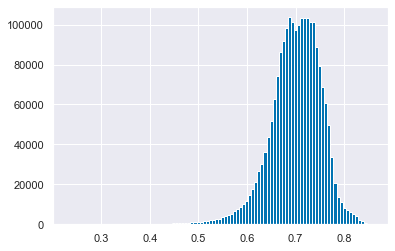

In [1134]:
res_store_5_top50["r2"].hist(bins=100)

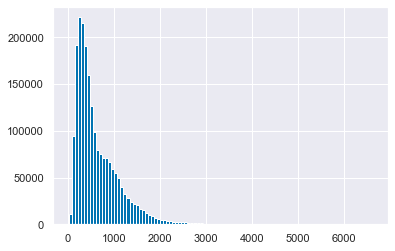

In [1135]:
res_store_5_top50["cond"].hist(bins=100)

In [1138]:
pd.DataFrame([list(x) for x in res_store_5_top50[(res_store_5_top50["r2"]>.7)&(res_store_5_top50["cond"]<750)].index]).stack().value_counts()

c11LongTermSick                  143046
c11Deprived3                     142158
c11HealthVeryBad                 134221
c11HealthBad                     132856
c11NSSECHigherManager            102283
CON%MAN_DIR_SEN                  101553
c11CarsThree                      99470
c11HouseholdOneFamily65plus       99251
c11QualLevel1                     97062
c11IndustrySocialWork             96031
c11CarsFour                       93445
c11QualLevel2                     87239
c11Degree                         82984
c11Deprived2                      82144
c11HouseholdMarriedNoChildren     81162
CON%PROF                          80860
c11FulltimeStudent                80235
c11HouseholdLoneNodependents      79569
c11Age65to74                      76922
c11NSSECNeverWorked               76646
c11CarsNone                       76506
c11EconomicallyActiveStudent      75783
c11CarsTwo                        75414
c11Age85to89                      74787
c11Retired                        74776


In [ ]:
## worst performers / offenders on high cond no

# c11HouseOwned                     15239
# c11DeprivedNone                   11367
# c11HealthGood                      2132

### How about drop these three and add c11QualLevel4, speakWelsh, Merseyside

In [1148]:
top_50 = [x for x in top_50 if x not in ["c11HouseOwned","c11DeprivedNone","c11HealthGood"]]
top_50.extend(["c11QualLevel4","speakWelsh","Merseyside"])
len(top_50)

50

In [1149]:
%%time
masked_df_simp["const"]=1.0

long_list=list(combinations(top_50,5))
res_list = []
for spec_vars in long_list:

    results = sm.OLS(masked_df_simp["Con17"],masked_df_simp[list(spec_vars)+["const"]]).fit()
    res_list.append((results.rsquared,results.condition_number))

res_store_5_top50_diff = pd.DataFrame(res_list,index = long_list)
res_store_5_top50_diff.columns = ["r2","cond"]
res_store_5_top50_diff.sort_values(by="r2",ascending=False)

Wall time: 32min 30s


,r2,cond
"(c11LongTermSick, CON%MAN_DIR_SEN, c11NSSECNeverWorked, c11Degree, speakWelsh)",0.856807,348.966894
"(c11LongTermSick, CON%MAN_DIR_SEN, c11Neverworked, c11Degree, speakWelsh)",0.855421,348.738328
"(c11LongTermSick, CON%MAN_DIR_SEN, c11NSSECNeverWorked, c11Degree, Merseyside)",0.855314,200.797106
"(c11LongTermSick, CON%MAN_DIR_SEN, c11NSSECNeverWorked, c11Age25to29, c11Degree)",0.854892,249.864101
"(c11Deprived3, CON%MAN_DIR_SEN, c11QualLevel4, speakWelsh, Merseyside)",0.854254,469.306912
...,...,...
"(c11IndustrySocialWork, c11NoAdultsEmployed, c11HealthFair, c11QualLevel4, speakWelsh)",0.160270,830.042068
"(c11NoAdultsEmployed, CON%PROF, c11HealthFair, c11QualLevel4, Merseyside)",0.151194,812.060918
"(c11NoAdultsEmployed, CON%PROF, c11HealthFair, c11QualLevel4, speakWelsh)",0.149123,856.746208
"(c11NoAdultsEmployed, CON%PROF, c11HealthFair, speakWelsh, Merseyside)",0.142812,670.605450


In [1150]:
res_store_5_top50_diff.sort_values(by="r2",ascending=False).head(50)

,r2,cond
"(c11LongTermSick, CON%MAN_DIR_SEN, c11NSSECNeverWorked, c11Degree, speakWelsh)",0.856807,348.966894
"(c11LongTermSick, CON%MAN_DIR_SEN, c11Neverworked, c11Degree, speakWelsh)",0.855421,348.738328
"(c11LongTermSick, CON%MAN_DIR_SEN, c11NSSECNeverWorked, c11Degree, Merseyside)",0.855314,200.797106
"(c11LongTermSick, CON%MAN_DIR_SEN, c11NSSECNeverWorked, c11Age25to29, c11Degree)",0.854892,249.864101
"(c11Deprived3, CON%MAN_DIR_SEN, c11QualLevel4, speakWelsh, Merseyside)",0.854254,469.306912
"(c11LongTermSick, CON%MAN_DIR_SEN, c11NSSECNeverWorked, c11FulltimeStudent, c11QualLevel4)",0.853238,317.125346
"(c11LongTermSick, CON%MAN_DIR_SEN, c11Neverworked, c11FulltimeStudent, c11QualLevel4)",0.852951,323.157191
"(c11LongTermSick, CON%MAN_DIR_SEN, c11NSSECNeverWorked, c11EconomicallyActiveStudent, c11QualLevel4)",0.852942,333.749577
"(c11LongTermSick, CON%MAN_DIR_SEN, c11Neverworked, c11EconomicallyActiveStudent, c11QualLevel4)",0.852816,338.597678
"(c11LongTermSick, CON%MAN_DIR_SEN, c11Neverworked, c11Degree, Merseyside)",0.852418,207.175463


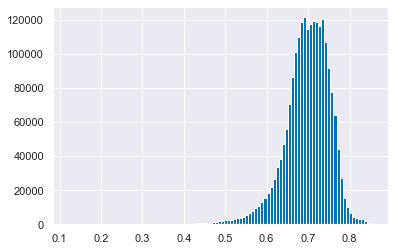

In [1157]:
res_store_5_top50_diff["r2"].hist(bins=100)

In [1158]:
top_35 = pd.DataFrame([list(x) for x in res_store_5_top50_diff[(res_store_5_top50_diff["r2"]>.7)&(res_store_5_top50_diff["cond"]<750)].index]).stack().value_counts().index[0:35]

In [1159]:
%%time
masked_df_simp["const"]=1.0

long_list=list(combinations(top_35,6))
res_list = []
for spec_vars in long_list:

    results = sm.OLS(masked_df_simp["Con17"],masked_df_simp[list(spec_vars)+["const"]]).fit()
    res_list.append((results.rsquared,results.condition_number))

res_store_6_top35 = pd.DataFrame(res_list,index = long_list)
res_store_6_top35.columns = ["r2","cond"]
res_store_6_top35.sort_values(by="r2",ascending=False)

Wall time: 25min 4s


,r2,cond
"(c11HealthBad, CON%MAN_DIR_SEN, speakWelsh, c11Degree, c11NSSECNeverWorked, c11HealthFair)",0.860786,443.495102
"(c11LongTermSick, CON%MAN_DIR_SEN, speakWelsh, c11Degree, c11NSSECNeverWorked, c11EconomicallyActiveStudent)",0.860480,353.134379
"(c11LongTermSick, CON%MAN_DIR_SEN, speakWelsh, c11Degree, c11EconomicallyActiveStudent, c11Neverworked)",0.860245,352.672998
"(c11LongTermSick, CON%MAN_DIR_SEN, speakWelsh, c11Degree, c11FulltimeStudent, c11NSSECNeverWorked)",0.859418,377.859627
"(c11LongTermSick, CON%MAN_DIR_SEN, speakWelsh, c11Degree, c11FulltimeStudent, c11Neverworked)",0.858905,377.463323
...,...,...
"(speakWelsh, c11QualLevel1, c11Degree, c11FulltimeStudent, c11EconomicallyActiveStudent, c11Age20to24)",0.353439,486.453598
"(speakWelsh, c11QualLevel1, c11FulltimeStudent, CON%PROF, c11EconomicallyActiveStudent, c11NoAdultsEmployed)",0.350710,1020.536685
"(speakWelsh, c11IndustrySocialWork, c11QualLevel1, c11Degree, c11HealthFair, c11NoAdultsEmployed)",0.267956,1488.119694
"(speakWelsh, c11QualLevel1, c11Degree, CON%PROF, c11HealthFair, c11NoAdultsEmployed)",0.251703,1567.765130


In [1160]:
res_store_6_top35.sort_values(by="r2",ascending=False).head(50)

,r2,cond
"(c11HealthBad, CON%MAN_DIR_SEN, speakWelsh, c11Degree, c11NSSECNeverWorked, c11HealthFair)",0.860786,443.495102
"(c11LongTermSick, CON%MAN_DIR_SEN, speakWelsh, c11Degree, c11NSSECNeverWorked, c11EconomicallyActiveStudent)",0.860480,353.134379
"(c11LongTermSick, CON%MAN_DIR_SEN, speakWelsh, c11Degree, c11EconomicallyActiveStudent, c11Neverworked)",0.860245,352.672998
"(c11LongTermSick, CON%MAN_DIR_SEN, speakWelsh, c11Degree, c11FulltimeStudent, c11NSSECNeverWorked)",0.859418,377.859627
"(c11LongTermSick, CON%MAN_DIR_SEN, speakWelsh, c11Degree, c11FulltimeStudent, c11Neverworked)",0.858905,377.463323
"(c11LongTermSick, CON%MAN_DIR_SEN, speakWelsh, c11Degree, c11NSSECNeverWorked, c11NoAdultsEmployedChildren)",0.858358,356.337178
"(c11LongTermSick, CON%MAN_DIR_SEN, speakWelsh, c11Degree, c11Neverworked, c11NoAdultsEmployedChildren)",0.858183,354.010984
"(c11LongTermSick, CON%MAN_DIR_SEN, speakWelsh, c11Degree, c11NSSECNeverWorked, c11Age20to24)",0.858058,364.187236
"(c11LongTermSick, CON%MAN_DIR_SEN, speakWelsh, c11Degree, c11HouseholdLoneNodependents, c11NSSECNeverWorked)",0.858038,353.038465
"(c11LongTermSick, CON%MAN_DIR_SEN, c11CarsFour, speakWelsh, c11Degree, c11NSSECNeverWorked)",0.857948,376.602316


In [ ]:
# CON%MAN_DIR_SEN,c11Degree, speakWelsh, c11NSSECNeverWorked(c11neverworked),c11LongTermSick(c11HealthBad),

In [1182]:
top_25 = pd.DataFrame([list(x) for x in res_store_6_top35[(res_store_6_top35["r2"]>.82)&(res_store_6_top35["cond"]<1000)].index]).stack().value_counts().index[0:30]

In [1183]:
%%time
masked_df_simp["const"]=1.0

long_list=list(combinations(top_25,7))
res_list = []
for spec_vars in long_list:

    results = sm.OLS(masked_df_simp["Con17"],masked_df_simp[list(spec_vars)+["const"]]).fit()
    res_list.append((results.rsquared,results.condition_number))

res_store_7_top25 = pd.DataFrame(res_list,index = long_list)
res_store_7_top25.columns = ["r2","cond"]
res_store_7_top25.sort_values(by="r2",ascending=False)

Wall time: 32min 37s


,r2,cond
"(c11Degree, CON%MAN_DIR_SEN, c11HealthBad, speakWelsh, c11NSSECNeverWorked, c11EconomicallyActiveStudent, c11QualLevel2)",0.866008,898.502092
"(c11Degree, CON%MAN_DIR_SEN, c11LongTermSick, speakWelsh, c11HouseholdLone, c11NSSECNeverWorked, c11NoAdultsEmployedChildren)",0.865864,391.145806
"(c11Degree, CON%MAN_DIR_SEN, c11HealthBad, c11HealthVeryBad, c11HealthFair, speakWelsh, c11NSSECNeverWorked)",0.865430,456.553067
"(c11Degree, CON%MAN_DIR_SEN, c11LongTermSick, c11HouseholdLone, c11NSSECNeverWorked, c11EconomicallyActiveStudent, c11NoAdultsEmployedChildren)",0.863953,371.597066
"(c11Degree, CON%MAN_DIR_SEN, c11LongTermSick, speakWelsh, c11NSSECNeverWorked, c11EconomicallyActiveStudent, c11QualLevel2)",0.863920,805.273427
...,...,...
"(c11Degree, CON%PROF, c11Age85to89, c11Age75to84, c11Retired, c11HouseholdOther, c11EconomicallyActiveStudent)",0.468833,353.038709
"(c11QualLevel1, c11Age85to89, c11Age65to74, c11Age75to84, c11HouseholdOther, c11Age60to64, c11EconomicallyActiveStudent)",0.466770,361.112486
"(c11QualLevel1, c11Age85to89, c11Age65to74, c11Age75to84, c11HouseholdOther, c11Age60to64, c11QualLevel2)",0.465295,506.160738
"(c11Degree, CON%PROF, c11Age65to74, c11Age75to84, c11HouseholdOther, c11Age60to64, c11EconomicallyActiveStudent)",0.465087,392.968532


In [1184]:
res_store_7_top25.sort_values(by="r2",ascending=False).head(50)

,r2,cond
"(c11Degree, CON%MAN_DIR_SEN, c11HealthBad, speakWelsh, c11NSSECNeverWorked, c11EconomicallyActiveStudent, c11QualLevel2)",0.866008,898.502092
"(c11Degree, CON%MAN_DIR_SEN, c11LongTermSick, speakWelsh, c11HouseholdLone, c11NSSECNeverWorked, c11NoAdultsEmployedChildren)",0.865864,391.145806
"(c11Degree, CON%MAN_DIR_SEN, c11HealthBad, c11HealthVeryBad, c11HealthFair, speakWelsh, c11NSSECNeverWorked)",0.865430,456.553067
"(c11Degree, CON%MAN_DIR_SEN, c11LongTermSick, c11HouseholdLone, c11NSSECNeverWorked, c11EconomicallyActiveStudent, c11NoAdultsEmployedChildren)",0.863953,371.597066
"(c11Degree, CON%MAN_DIR_SEN, c11LongTermSick, speakWelsh, c11NSSECNeverWorked, c11EconomicallyActiveStudent, c11QualLevel2)",0.863920,805.273427
"(c11Degree, CON%MAN_DIR_SEN, c11LongTermSick, speakWelsh, c11HouseholdLoneNodependents, c11NSSECNeverWorked, c11EconomicallyActiveStudent)",0.863343,358.512639
"(c11Degree, CON%MAN_DIR_SEN, c11HealthBad, c11HealthFair, speakWelsh, c11NSSECNeverWorked, c11EconomicallyActiveStudent)",0.863309,511.202571
"(c11Degree, CON%MAN_DIR_SEN, c11HealthBad, c11HealthFair, speakWelsh, c11NSSECNeverWorked, c11CarsThree)",0.863306,517.036739
"(c11Degree, CON%MAN_DIR_SEN, c11LongTermSick, speakWelsh, c11NSSECNeverWorked, c11HouseholdOther, c11EconomicallyActiveStudent)",0.863280,376.395293
"(c11Degree, CON%MAN_DIR_SEN, c11HealthBad, c11HealthFair, speakWelsh, c11NSSECNeverWorked, c11CarsFour)",0.863190,478.930005


In [ ]:
# c11Degree, CON%MAN_DIR_SEN, c11NSSECNeverWorked(/v occ c11Neverworked),speakWelsh,c11LongTermSick(/c11HealthBad)

In [1185]:
# pd.DataFrame([list(x) for x in res_store_6_top35[(res_store_6_top35["r2"]>.82)&(res_store_6_top35["cond"]<1000)].index]).stack().value_counts()

In [867]:
# 10000: 17.2s
# 10000: removed add_constant 4.2s
# 10000: loc access 4.38s
# 10000: with OLS, 10.1s
# 10000: with OLS, pre_made_list 10.2s
# 10000: with OLS, with saving 11.5s

# 1000/s -> 3.6M/hr

# strict_drop_vars -> 241 variables

,const,c11Age10to14,LabPPCsex15_Man,GreenPPCrace15_BME
0,1.0,5.750533,1,0
1,1.0,5.475494,0,0
6,1.0,5.810127,1,0
7,1.0,5.959155,1,0
8,1.0,6.328747,1,0
...,...,...,...,...
627,1.0,5.572048,0,0
628,1.0,5.370532,1,0
629,1.0,4.375281,0,0
630,1.0,5.492465,1,0


In [824]:
%%time
### try to find any subtle combos
masked_df_simp = df_simp[mask].copy()
Y = masked_df_simp[var_stub]
masked_df_simp["const"]=1.0
res_store_open = pd.DataFrame(columns = ["r2","cond"])

for spec_vars in list(combinations(list(masked_df_simp.drop(["leaveHanretty","remainHanretty","Con17"],axis=1).columns),3)):

    model = sm.OLS(Y,masked_df_simp[list(spec_vars)])
    results = model.fit()
    res_store_open.loc["|".join(spec_vars)] = [results.rsquared,results.condition_number]

KeyboardInterrupt: 

In [872]:
spec_vars

('c11Age10to14', 'LabPPCsex15_Man', 'GreenPPCrace15_BME')

In [828]:
res_store_open.sort_values(by='r2',ascending=False).head(50)

,r2,cond
c11PopulationDensity|c11NSSECHigherManager|c11HealthGood,0.788670,9.248398e+02
c11PopulationDensity|c11HealthGood|CON%MAN_DIR_SEN,0.786364,9.558470e+02
c11Age10to14|c11Deprived3|CON%PROF,0.759154,2.512977e+02
c11Households|c11Deprived3|CON%PROF,0.758901,6.594384e+03
c11Communal|c11Deprived3|CON%PROF,0.758901,9.792826e+01
c11Population|c11Deprived3|CON%PROF,0.758044,7.945682e+05
c11Age8to9|c11Deprived3|CON%PROF,0.757897,1.960770e+02
c11PopulationDensity|c11Deprived3|CON%PROF,0.757866,2.638351e+02
c11Male|c11Deprived3|CON%PROF,0.757537,3.384983e+03
c11Female|c11Deprived3|CON%PROF,0.757537,3.763214e+03


In [1543]:
def add_identity(axes, *line_args, **line_kwargs):
    identity, = axes.plot([], [], *line_args, **line_kwargs)
    def callback(axes):
        low_x, high_x = axes.get_xlim()
        low_y, high_y = axes.get_ylim()
        low = max(low_x, low_y)
        high = min(high_x, high_y)
        identity.set_data([low, high], [low, high])
    callback(axes)
    axes.callbacks.connect('xlim_changed', callback)
    axes.callbacks.connect('ylim_changed', callback)
    return axes

def sm_and_xgb_plot(var_stub,title,specific_vars,geomask=None):
    from scipy import stats
    Treatment = var_stub
    var_list = [var_stub]
    var_stub_list = [var_stub,]
    mask = df_simp[var_stub].notnull()
    if geomask is not None:
        mask = mask&geomask
    
    min_features = 30
    colname = var_stub
    dependence_plots = True

    alg = get_xgboost_alg(classification_problem=False)
    (explainer, shap_values, train_columns, train_index, alg,output_subfolder)=\
        xgboost_run(subdir=colname,dataset=df_simp[mask][specific_vars+[var_stub]],
                var_list=var_list,var_stub_list=var_stub_list,
                use_specific_weights=None,
                min_features = min(df_simp.shape[1]-1,min_features),verbosity=0,
                skip_bar_plot=True,dependence_plots=dependence_plots,alg=alg,eval_metric=eval_metric,                    
                title = title)
    xgboost_pred = pd.Series(alg.predict(df_simp[train_columns]),index=df_simp.index)

    import statsmodels.api as sm
    Y = df_simp[mask][var_stub]
    X = df_simp[mask][specific_vars].astype('float')
    X = sm.add_constant(X)
    model = sm.OLS(Y,X)
    results = model.fit()
    Xnew = df_simp[train_columns].astype('float')
    Xnew = sm.add_constant(Xnew)
    statsmodels_pred = model.predict(results.params,Xnew)
    display( results.summary() );
    #########################################################

    ons_ids = BES_census_data.loc[df_simp.index,"ONSConstID"]
#     if geomask is not None:
#         ons_ids = ons_ids[geomask]

    xgb_var = title+"_xgb"+"_und"
    sm_var = title+"_sm"+"_und"

    print("!!!!!!!!!!!!!!!!!!!!!!")
    print(xgb_var,sm_var,title)
    merged[title+"_xgb"]=np.nan
    merged.loc[ ons_ids , title+"_xgb" ] = xgboost_pred.values
    merged[xgb_var] = merged["Con17"] - merged[title+"_xgb"]

    merged[title+"_sm"]=np.nan
    merged.loc[ ons_ids , title+"_sm" ] = statsmodels_pred
    merged[sm_var] = merged["Con17"] - merged[title+"_sm"]

    merged_mask = merged.reset_index()['PCON13CD'].isin(ons_ids[mask]).values    
    

    fig, axes = plt.subplots(nrows=1,ncols=5,figsize=(16.5,4))
    merged[xgb_var][merged_mask].hist(bins=50,ax=axes[0])
#     mask = merged[xgb_var].notnull()
    sns.regplot(merged[title+"_xgb"][merged_mask],merged[var_stub][merged_mask],ax=axes[1])
    r, p = stats.pearsonr( merged[title+"_xgb"][merged_mask] ,  merged[var_stub][merged_mask] )
    axes[1].text(0.05, .9, 'r={:.2f}, p={:.2g}'.format(r, round(p,4)),verticalalignment='top', transform=axes[1].transAxes);
    add_identity(axes[1], color='r', ls='--')

    merged[sm_var][merged_mask].hist(bins=50,ax=axes[2])
#     mask = merged[sm_var].notnull()
    sns.regplot(merged[title+"_sm"][merged_mask],merged[var_stub][merged_mask],ax=axes[3])
    r, p = stats.pearsonr(  merged[title+"_sm"][merged_mask], merged[var_stub][merged_mask] )
    axes[3].text(0.05, .9, 'r={:.2f}, p={:.2g}'.format(r, round(p,4)),verticalalignment='top', transform=axes[3].transAxes);
    add_identity(axes[3], color='r', ls='--')

    axes[0].set_ylabel("freq");
    axes[0].set_xlabel("underperf vs model (xgb)");
    axes[1].set_ylabel(var_stub);
    axes[1].set_xlabel(var_stub+" pred (xgb)");
    axes[2].set_ylabel("freq");
    axes[2].set_xlabel("underperf vs model (sm)");
    axes[3].set_ylabel(var_stub);
    axes[3].set_xlabel(var_stub+" pred (sm)");

    
    g = sns.regplot(x=merged[xgb_var][merged_mask], y=merged[sm_var][merged_mask], ax = axes[4])
    r, p = stats.pearsonr( merged[xgb_var][merged_mask] , merged[sm_var][merged_mask] )
    axes[4].text(0.05, .9, 'r={:.2f}, p={:.2g}'.format(r, round(p,4)),verticalalignment='top', transform=axes[4].transAxes);
    axes[4].set_ylabel("underperf vs model (sm)");
    axes[4].set_xlabel("underperf vs model (xgb)");
    add_identity(axes[4], color='r', ls='--')
    plt.suptitle("Residual histograms and regression plots for each of Xgboost/Statsmodels models\nFollowed by regression of each models residuals");
    ##########################################################

    top75 = False
    add_colorbar = True

    if top75 == True:
        merged[xgb_var] = merged[xgb_var]<merged[xgb_var].quantile(.25)
        merged[sm_var] = merged[sm_var]<merged[sm_var].quantile(.25)
    else:
        merged[xgb_var] = -merged[xgb_var]
        merged[sm_var] = -merged[sm_var]
    merged.loc[merged["Country"].isin(["Scotland"]),xgb_var]=np.nan
    merged.loc[merged["Country"].isin(["Scotland"]),sm_var]=np.nan

    suptitle = "2017GE: Conservative Performance\nRelative To Demographic Model"
    symmetrical_colour_scale = True
    # set the range for the choropleth
    vmin, vmax = np.floor(merged[[xgb_var,sm_var]].min().min()/10)*10, np.ceil(merged[[xgb_var,sm_var]].max().max()/10)*10
    
    if symmetrical_colour_scale:
        max_abs_scale = max(abs(vmin),abs(vmax))
        vmin = (vmin/abs(vmin))*max_abs_scale
        vmax = (vmax/abs(vmax))*max_abs_scale

    # create figure and axes for Matplotlib
    fig, ax = plt.subplots(nrows=1,ncols=2, figsize=(16, 10))

    # create map
    merged.plot(column=xgb_var, cmap='seismic', norm=plt.Normalize(vmin=vmin, vmax=vmax), linewidth=0.1, ax=ax[0], edgecolor='0.8',aspect=1)
    # remove the axis
    ax[0].axis('off')
    # add a title
    ax[0].set_title(suptitle+"(xgb)", \
                  fontdict={'fontsize': '18',
                            'fontweight' : '3'})

    # create map
    merged.plot(column=sm_var,  cmap='seismic', norm=plt.Normalize(vmin=vmin, vmax=vmax), linewidth=0.1, ax=ax[1], edgecolor='0.8',aspect=1)
    # remove the axis
    ax[1].axis('off')
    # add a title
    ax[1].set_title(suptitle+"(sm)", \
                  fontdict={'fontsize': '18',
                            'fontweight' : '3'})



    # create an annotation for the  data source
    plt.annotate('Source: https://www.britishelectionstudy.com/data-objects/linked-data/',
               xy=(0.3, .17), xycoords='figure fraction',
               verticalalignment='bottom',
                 #horizontalalignment='middle', 
               fontsize=10, color='#555555')

    if add_colorbar:
        # Create colorbar as a legend
        sm = plt.cm.ScalarMappable(cmap=plt.cm.get_cmap('seismic').reversed(),#'seismic',
                                   norm=plt.Normalize(vmin=vmin, vmax=vmax))
#         sm._A = []
        cbar = fig.colorbar(sm,
#                             pad=-.5,
#                             orientation='horizontal',
                            pad=0,
                            location='top',ax=ax[0:2], shrink=.2,fraction=.3)
        # location='bottom',

    Treatment = "Chloropleth"
    output_subfolder = create_subdir(BES_output_folder,Treatment)
    fname = output_subfolder +suptitle +".png"
    # this will save the figure as a high-res png. you can also save as svg
    plt.savefig( fname, bbox_inches='tight', dpi=1000 )
    return ()

def model_comparison(var_stub,title,specific_vars_list,geomask=None,model_type='sm'):
    from scipy import stats
    Treatment = var_stub
    var_list = [var_stub]
    var_stub_list = [var_stub,]
    mask = df_simp[var_stub].notnull()
    if geomask is not None:
        mask = mask&geomask
    ons_ids = BES_census_data.loc[df_simp.index,"ONSConstID"]    
#     print("MASK DEBUG")
#     print(mask.sum())
    ######
    count=1
#     model_list = []
    for specific_vars in specific_vars_list:
        print("model"+str(count))
        min_features = 30
        colname = var_stub
        dependence_plots = True
        alg = get_xgboost_alg(classification_problem=False)
        (explainer, shap_values, train_columns, train_index, alg,output_subfolder)=\
            xgboost_run(subdir=colname,dataset=df_simp[mask][specific_vars+[var_stub]],
                    var_list=var_list,var_stub_list=var_stub_list,
                    use_specific_weights=None,
                    min_features = min(df_simp.shape[1]-1,min_features),verbosity=0,
                    skip_bar_plot=True,dependence_plots=dependence_plots,alg=alg,eval_metric=eval_metric,                    
                    title = title)
        xgboost_pred = pd.Series(alg.predict(df_simp[train_columns]),index=df_simp.index)
        ######
        import statsmodels.api as sm
        Y = df_simp[mask][var_stub]
        X = df_simp[mask][specific_vars].astype('float')
        X = sm.add_constant(X)
        model = sm.OLS(Y,X)
        results = model.fit()
        Xnew = df_simp[train_columns].astype('float')
        Xnew = sm.add_constant(Xnew)
        statsmodels_pred = model.predict(results.params,Xnew)
        display( results.summary() );
        ######
        pred_name = title+"_model"+str(count)
        merged[pred_name]=np.nan
        if model_type == "xgb":
            merged.loc[ ons_ids , pred_name ] = xgboost_pred.values
        else:
            merged.loc[ ons_ids , pred_name ] = statsmodels_pred
        merged[pred_name+"_und"] = merged[var_stub] - merged[pred_name]
        
        count=count+1

    
    merged_mask = merged.reset_index()['PCON13CD'].isin(ons_ids[mask]).values

    if len(specific_vars_list)==2:
    
        fig, axes = plt.subplots(nrows=1,ncols=5,figsize=(16.5,4))
        merged[title+"_model1"+"_und"][merged_mask].hist(bins=50,ax=axes[0])
    #     mask = merged[xgb_var].notnull()
#         model1 = title+"_model1"
#         model2 = title+"_model2"
        sns.regplot(merged[title+"_model1"][merged_mask],merged[var_stub][merged_mask],ax=axes[1])
        r, p = stats.pearsonr( merged[title+"_model1"][merged_mask] , merged[var_stub][merged_mask] )
        axes[1].text(0.05, .9, 'r={:.2f}, p={:.2g}'.format(r, round(p,4)),verticalalignment='top', transform=axes[1].transAxes);
        add_identity(axes[1], color='r', ls='--')
        
        merged[title+"_model2"+"_und"][merged_mask].hist(bins=50,ax=axes[2])
    #     mask = merged[sm_var].notnull()
        sns.regplot(merged[title+"_model2"][merged_mask],merged[var_stub][merged_mask],ax=axes[3])
        r, p = stats.pearsonr( merged[title+"_model2"][merged_mask] , merged[var_stub][merged_mask] )
        axes[3].text(0.05, .9, 'r={:.2f}, p={:.2g}'.format(r, round(p,4)),verticalalignment='top', transform=axes[3].transAxes);
        add_identity(axes[3], color='r', ls='--')

        axes[0].set_ylabel("freq");
        axes[0].set_xlabel("model 1 residuals");
        axes[1].set_ylabel(var_stub);
        axes[1].set_xlabel(var_stub+" model 1 pred");
        axes[2].set_ylabel("freq");
        axes[2].set_xlabel("model 2 residuals");
        axes[3].set_ylabel(var_stub);
        axes[3].set_xlabel(var_stub+" model 2 pred");

        g = sns.regplot(x=merged[title+"_model1"+"_und"][merged_mask],
                        y=merged[title+"_model2"+"_und"][merged_mask], ax = axes[4])
        r, p = stats.pearsonr( merged[title+"_model1"+"_und"][merged_mask],
                               merged[title+"_model2"+"_und"][merged_mask] )
        axes[4].set_ylabel("model 1 residuals");
        axes[4].set_xlabel("model 2 residuals");
        axes[4].text(0.05, .9, 'r={:.2f}, p={:.2g}'.format(r, round(p,4)),verticalalignment='top', transform=axes[4].transAxes);
        add_identity(axes[4], color='r', ls='--')
        
        fig.tight_layout()
#         plt.suptitle("Residual histograms and regression plots for each of Xgboost/Statsmodels models\nFollowed by regression of each models residuals");
    ##########################################################

    top75 = False
    fraction = .25
    add_colorbar = True
#     plt_title = "2017GE: Conservative Performance\nRelative To Demographic Model"
    symmetrical_colour_scale = True    
    
    var_list = [title+"_model"+str(x)+"_und" for x in range(1,len(specific_vars_list)+1)]
    
    for resid in var_list:
        if top75 == True:
            merged[resid] = merged[resid]<merged[resid].quantile(fraction)
        else:
            merged[resid] = -merged[resid]
        merged.loc[merged["Country"].isin(["Scotland"]),resid]=np.nan


    # set the range for the choropleth
    vmin, vmax = np.floor(merged[var_list].min().min()/10)*10, np.ceil(merged[var_list].max().max()/10)*10
    if symmetrical_colour_scale:
        max_abs_scale = max(abs(vmin),abs(vmax))
        vmin = (vmin/abs(vmin))*max_abs_scale
        vmax = (vmax/abs(vmax))*max_abs_scale

    # create figure and axes for Matplotlib
    fig, ax = plt.subplots(nrows=1,ncols=len(specific_vars_list),
                           figsize=(16, 10))
    
    for var_no in range(len(var_list)):
        # create map
        merged.plot(column=var_list[var_no], cmap='seismic', norm=plt.Normalize(vmin=vmin, vmax=vmax), linewidth=0.1,
                    ax=ax[var_no], edgecolor='0.8',aspect=1)

        # remove the axis
        ax[var_no].axis('off')
        # add a title
        ax[var_no].set_title("model"+str(var_no+1), \
                      fontdict={'fontsize': '18',
                                'fontweight' : '3'})
    
#     # create map
#     merged.plot(column=sm_var,  cmap='seismic', norm=plt.Normalize(vmin=vmin, vmax=vmax), linewidth=0.1, ax=ax[1], edgecolor='0.8',aspect=1)
#     # remove the axis
#     ax[1].axis('off')
#     # add a title
#     ax[1].set_title(title+"(sm)", \
#                   fontdict={'fontsize': '18',
#                             'fontweight' : '3'})



    # create an annotation for the  data source
    plt.annotate('Source: https://www.britishelectionstudy.com/data-objects/linked-data/',
               xy=(0.3, .17), xycoords='figure fraction',
               verticalalignment='bottom',
                 #horizontalalignment='middle', 
               fontsize=10, color='#555555')

    if add_colorbar:
        # Create colorbar as a legend
        sm = plt.cm.ScalarMappable(cmap=plt.cm.get_cmap('seismic').reversed(),#'seismic',
                                   norm=plt.Normalize(vmin=vmin, vmax=vmax))
#         sm._A = []
        if len(specific_vars_list)==2:
            location = 'top'
        else:
            location = 'bottom'
        cbar = fig.colorbar(sm,
#                             pad=-.5,
#                             orientation='horizontal',
                            pad=0,
                            location=location,ax=ax[0:len(specific_vars_list)], shrink=.2,fraction=.3)
        # location='bottom',

#     plt.suptitle(title)
        
    Treatment = "Chloropleth"
    output_subfolder = create_subdir(BES_output_folder,Treatment)
    fname = output_subfolder +title +".png"
    # this will save the figure as a high-res png. you can also save as svg
    plt.savefig( fname, bbox_inches='tight', dpi=1000 )
    return ()

MSE: 27.25, MAE: 4.01, EV: 0.88, R2: 0.88


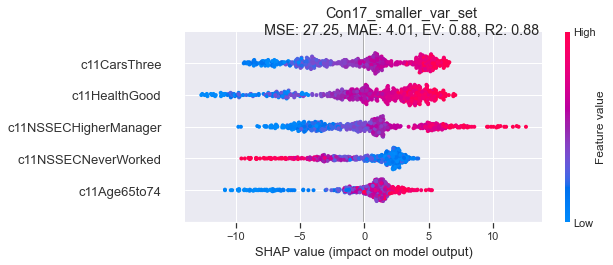

<Figure size 1152x720 with 0 Axes>

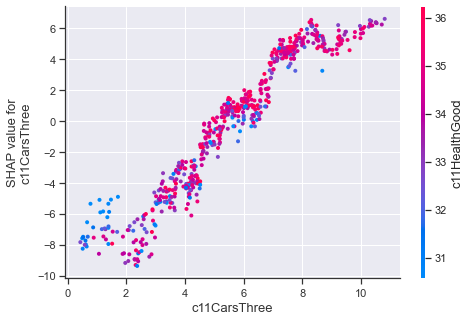

<Figure size 1152x720 with 0 Axes>

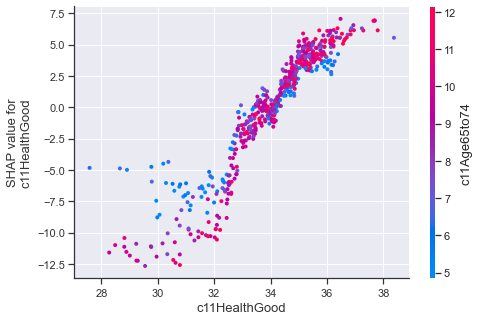

<Figure size 1152x720 with 0 Axes>

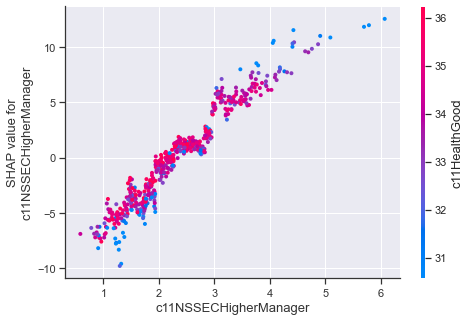

<Figure size 1152x720 with 0 Axes>

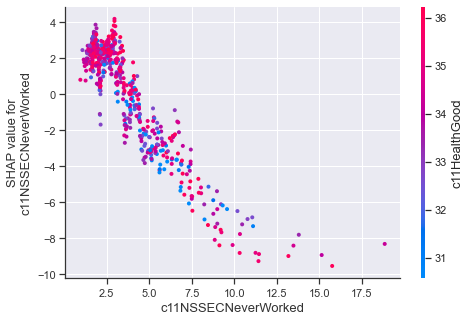

<Figure size 1152x720 with 0 Axes>

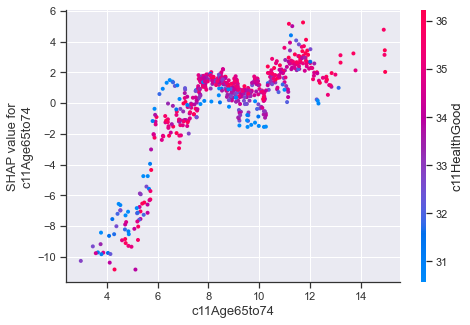

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  Con17   R-squared:                       0.834
Model:                            OLS   Adj. R-squared:                  0.832
Method:                 Least Squares   F-statistic:                     568.4
Date:                Sun, 23 Jan 2022   Prob (F-statistic):          6.22e-218
Time:                        15:18:17   Log-Likelihood:                -1844.5
No. Observations:                 572   AIC:                             3701.
Df Residuals:                     566   BIC:                             3727.
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
=========================================================================================
                            coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                   -97.5919      5.888    -16.576      0.000    -109.156     -86.028
c11CarsThree              1.6679      0.194      8.589      0.000       1.287       2.049
c11HealthGood             3.3365      0.161     20.675      0.000       3.020       3.654
c11NSSECHigherManager     6.3180      0.413     15.281      0.000       5.506       7.130
c11NSSECNeverWorked      -1.1176      0.168     -6.636      0.000      -1.448      -0.787
c11Age65to74              0.9318      0.175      5.338      0.000       0.589       1.275
==============================================================================
Omnibus:                        7.959   Durbin-Watson:                   1.771
Prob(Omnibus):                  0.019   Jarque-Bera (JB):               10.106
Skew:                          -0.146   Prob(JB):                      0.00639
Kurtosis:                       3.582   Cond. No.                         828.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

!!!!!!!!!!!!!!!!!!!!!!
Con17_smaller_var_set_xgb_und Con17_smaller_var_set_sm_und Con17_smaller_var_set


()

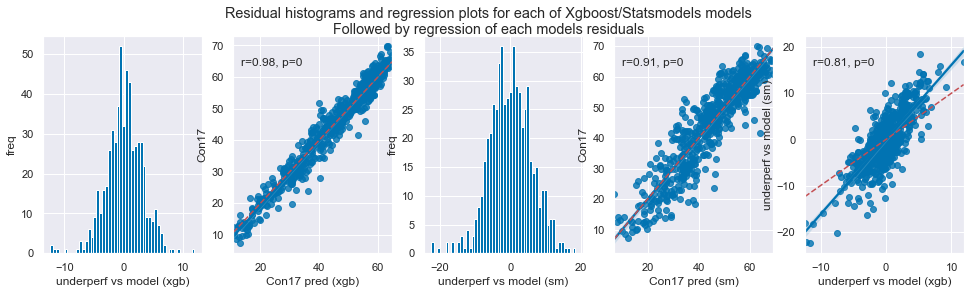

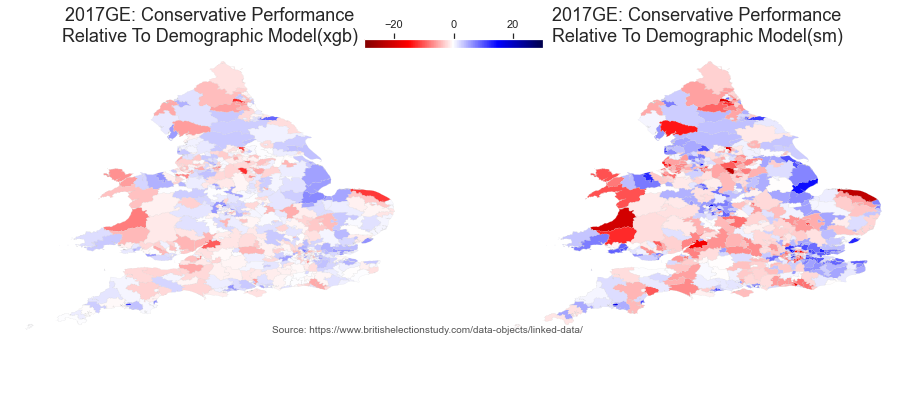

In [1585]:
var_stub = "Con17"
title = "Con17_smaller_var_set"
specific_vars = [
#     "c11CarsNone",#"c11CarsFour","c11CarsThree",
                 "c11CarsThree",
                 "c11HealthGood",
#                  "c11NSSECSmallEmployer",
                 "c11NSSECHigherManager",
                 "c11NSSECNeverWorked",
#                  "c11HouseholdMarriedNoChildren",
#                  "c11Deprived3",
#                  "c11Christian",
#                  "c11BornEngland",
                 "c11Age65to74",
#                 "CON%SAL_SERV"
#     "CON%MAN_DIR_SEN"
#     "c11Age60to64"
#     "c11QualLevel4"
#                  "Merseyside",
#     "speakWelsh" # too much collinearity!
                ]
#,
geomask = (BES_census_data["Country"]!="Scotland")&(BES_census_data["Winner17"]!="Speaker")

sm_and_xgb_plot(var_stub,title,specific_vars,geomask=geomask)

MSE: 30.86, MAE: 4.39, EV: 0.86, R2: 0.86


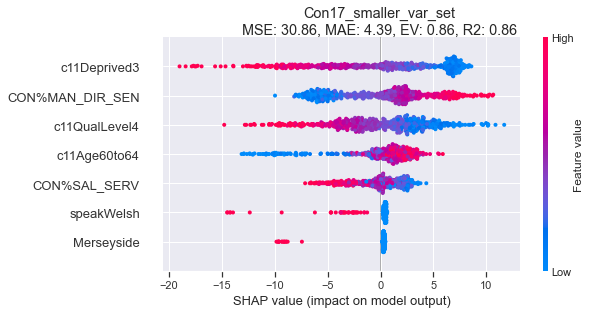

<Figure size 1152x720 with 0 Axes>

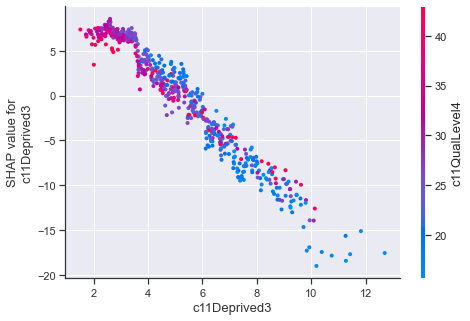

<Figure size 1152x720 with 0 Axes>

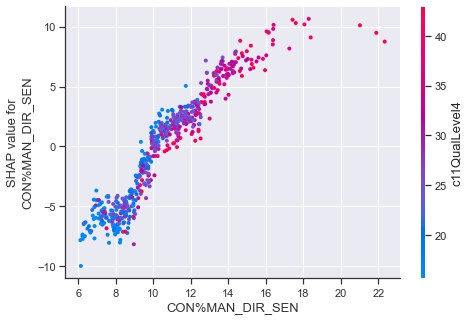

<Figure size 1152x720 with 0 Axes>

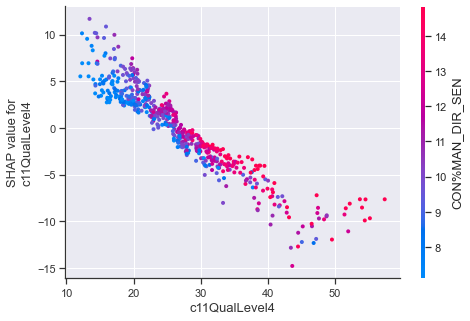

<Figure size 1152x720 with 0 Axes>

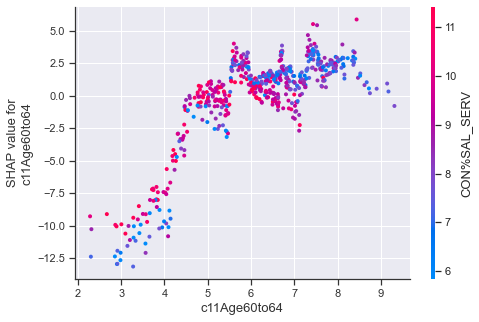

<Figure size 1152x720 with 0 Axes>

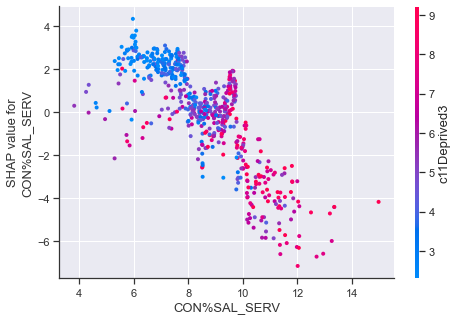

<Figure size 1152x720 with 0 Axes>

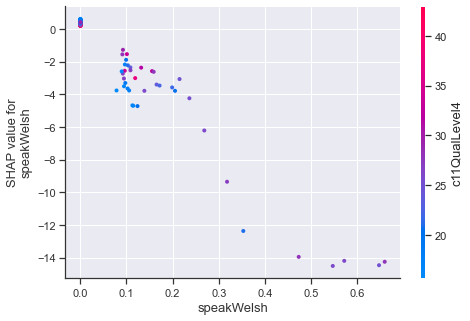

<Figure size 1152x720 with 0 Axes>

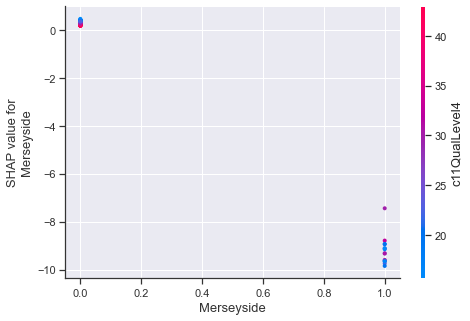

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  Con17   R-squared:                       0.863
Model:                            OLS   Adj. R-squared:                  0.862
Method:                 Least Squares   F-statistic:                     510.5
Date:                Sun, 23 Jan 2022   Prob (F-statistic):          1.42e-239
Time:                        15:18:27   Log-Likelihood:                -1792.0
No. Observations:                 573   AIC:                             3600.
Df Residuals:                     565   BIC:                             3635.
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
===================================================================================
                      coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------
const              85.0426      4.864     17.482      0.000      75.488      94.597
c11Deprived3       -4.2732      0.186    -22.993      0.000      -4.638      -3.908
c11QualLevel4      -1.2230      0.058    -21.162      0.000      -1.337      -1.109
c11Age60to64       -0.4329      0.306     -1.415      0.158      -1.034       0.168
CON%MAN_DIR_SEN     2.8133      0.204     13.805      0.000       2.413       3.214
CON%SAL_SERV       -1.4728      0.239     -6.165      0.000      -1.942      -1.004
Merseyside         -9.7191      1.521     -6.391      0.000     -12.706      -6.732
speakWelsh        -29.5358      3.781     -7.813      0.000     -36.961     -22.110
==============================================================================
Omnibus:                       20.799   Durbin-Watson:                   1.754
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               25.471
Skew:                          -0.374   Prob(JB):                     2.95e-06
Kurtosis:                       3.713   Cond. No.                         676.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

!!!!!!!!!!!!!!!!!!!!!!
Con17_smaller_var_set_xgb_und Con17_smaller_var_set_sm_und Con17_smaller_var_set


()

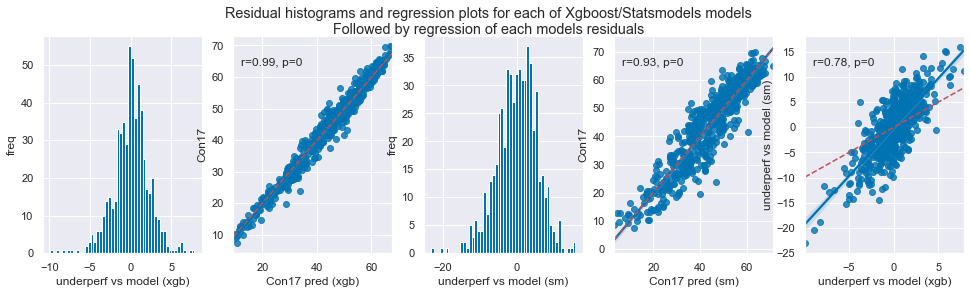

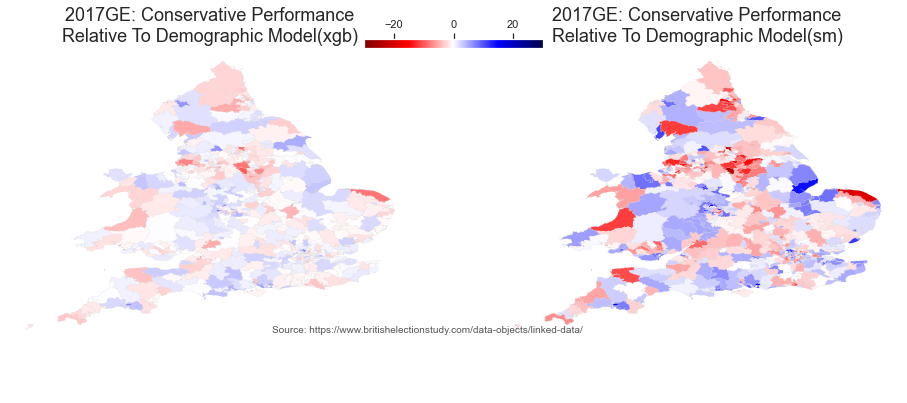

In [1586]:
var_stub = "Con17"
title = "Con17_smaller_var_set"
specific_vars = ["c11Deprived3","c11QualLevel4","c11Age60to64","CON%MAN_DIR_SEN","CON%SAL_SERV",
                 "Merseyside","speakWelsh",
                ]
geomask = (BES_census_data["Country"]!="Scotland")

sm_and_xgb_plot(var_stub,title,specific_vars,geomask=geomask)

In [1595]:
fa_sup = ['FA_0',
'FA_1',
'FA_2',
'FA_5',
'FA_7',]

best_triplet = ["c11CarsNone","c11HealthGood","c11NSSECHigherManager"]

best_quintet = ["c11LongTermSick","CON%MAN_DIR_SEN","c11NSSECNeverWorked","c11HealthGood","c11Degree"]

best_septet = ["c11Degree", "CON%MAN_DIR_SEN", "c11LongTermSick", "speakWelsh", "c11HouseholdLone", "c11NSSECNeverWorked", "c11NoAdultsEmployedChildren"]

jk_es_set = ["c11Deprived3","c11QualLevel4","c11Age60to64","CON%MAN_DIR_SEN","CON%SAL_SERV",
                 "Merseyside","speakWelsh",]

model1
MSE: 36.80, MAE: 4.42, EV: 0.83, R2: 0.83


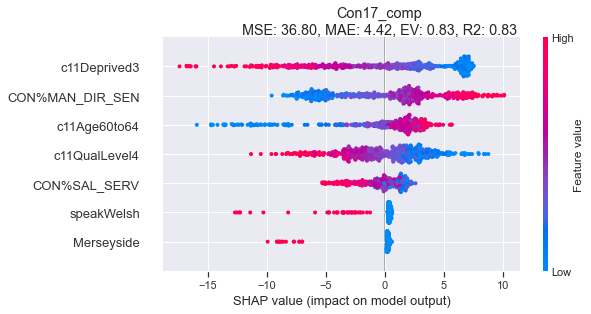

<Figure size 1152x720 with 0 Axes>

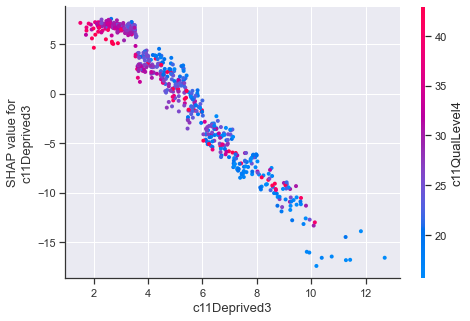

<Figure size 1152x720 with 0 Axes>

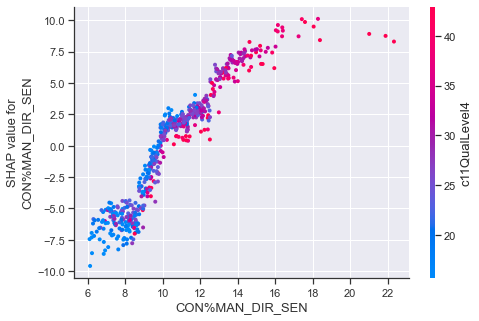

<Figure size 1152x720 with 0 Axes>

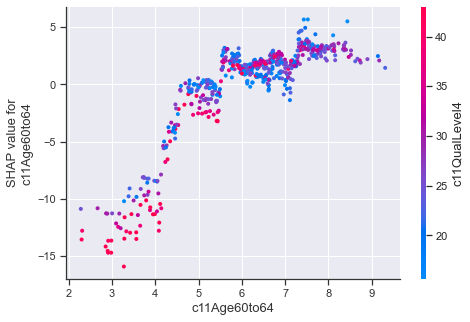

<Figure size 1152x720 with 0 Axes>

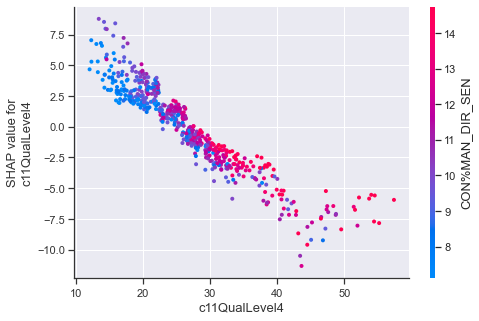

<Figure size 1152x720 with 0 Axes>

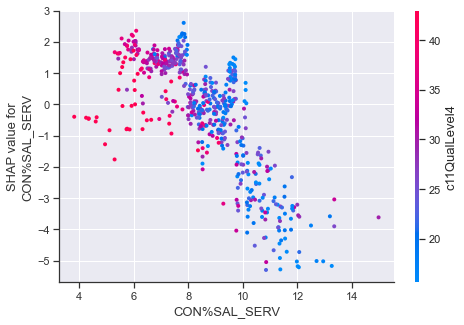

<Figure size 1152x720 with 0 Axes>

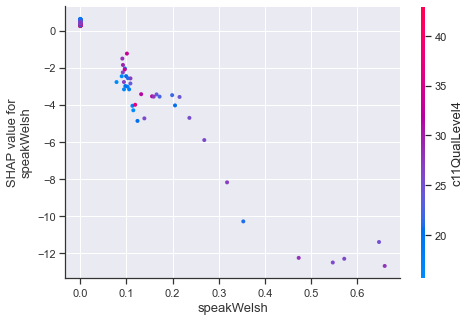

<Figure size 1152x720 with 0 Axes>

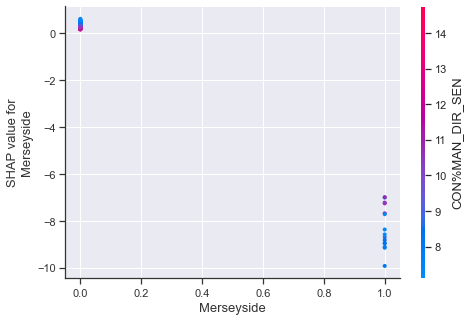

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  Con17   R-squared:                       0.863
Model:                            OLS   Adj. R-squared:                  0.861
Method:                 Least Squares   F-statistic:                     507.8
Date:                Sun, 23 Jan 2022   Prob (F-statistic):          9.15e-239
Time:                        19:08:56   Log-Likelihood:                -1789.3
No. Observations:                 572   AIC:                             3595.
Df Residuals:                     564   BIC:                             3629.
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
===================================================================================
                      coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------
const              84.9957      4.869     17.456      0.000      75.432      94.559
c11Deprived3       -4.2732      0.186    -22.977      0.000      -4.639      -3.908
c11QualLevel4      -1.2237      0.058    -21.151      0.000      -1.337      -1.110
c11Age60to64       -0.4349      0.306     -1.420      0.156      -1.036       0.167
CON%MAN_DIR_SEN     2.8199      0.204     13.790      0.000       2.418       3.222
CON%SAL_SERV       -1.4714      0.239     -6.154      0.000      -1.941      -1.002
Merseyside         -9.7139      1.522     -6.383      0.000     -12.703      -6.725
speakWelsh        -29.5239      3.783     -7.804      0.000     -36.955     -22.093
==============================================================================
Omnibus:                       20.757   Durbin-Watson:                   1.755
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               25.363
Skew:                          -0.374   Prob(JB):                     3.11e-06
Kurtosis:                       3.710   Cond. No.                         675.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

model2
MSE: 44.88, MAE: 4.84, EV: 0.80, R2: 0.80


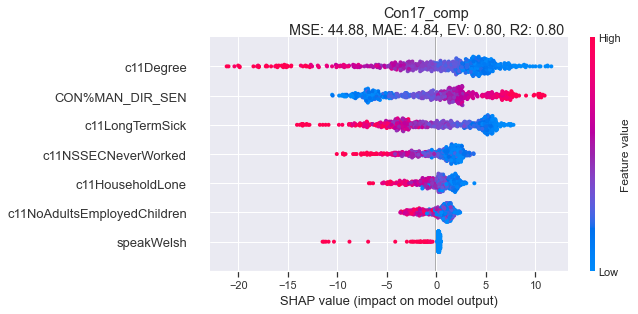

<Figure size 1152x720 with 0 Axes>

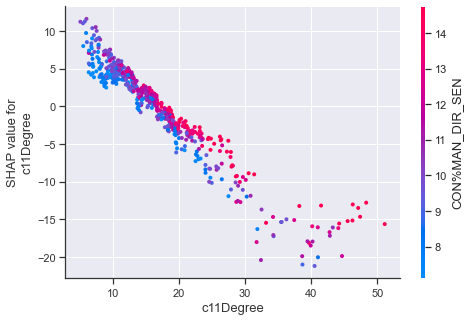

<Figure size 1152x720 with 0 Axes>

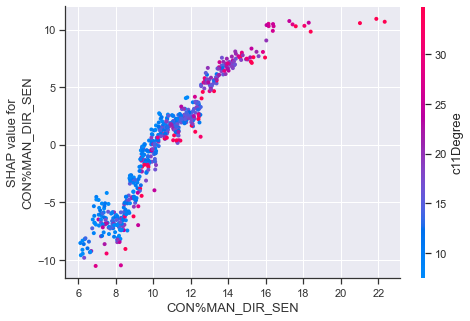

<Figure size 1152x720 with 0 Axes>

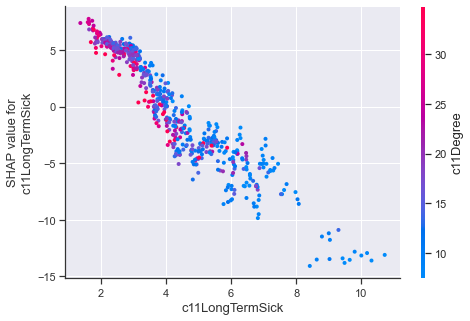

<Figure size 1152x720 with 0 Axes>

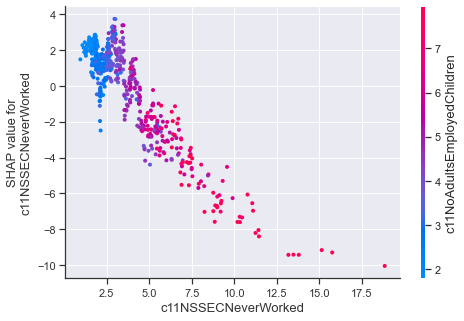

<Figure size 1152x720 with 0 Axes>

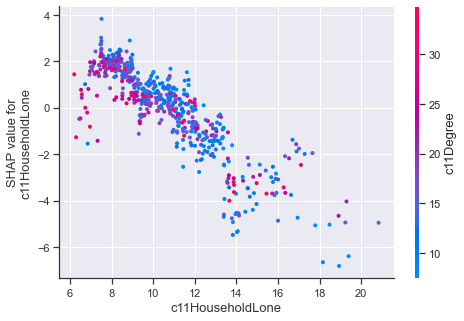

<Figure size 1152x720 with 0 Axes>

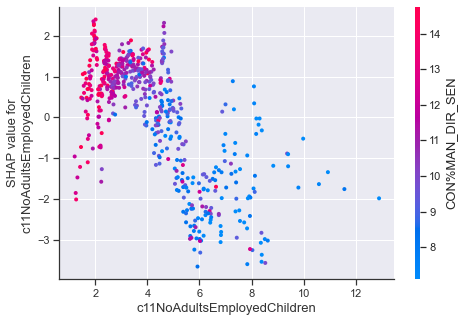

<Figure size 1152x720 with 0 Axes>

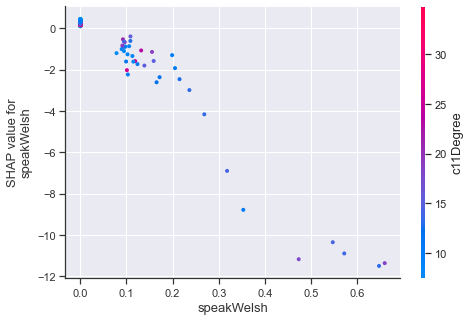

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  Con17   R-squared:                       0.866
Model:                            OLS   Adj. R-squared:                  0.864
Method:                 Least Squares   F-statistic:                     518.5
Date:                Sun, 23 Jan 2022   Prob (F-statistic):          5.56e-241
Time:                        19:08:58   Log-Likelihood:                -1784.1
No. Observations:                 572   AIC:                             3584.
Df Residuals:                     564   BIC:                             3619.
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
===============================================================================================
                                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
const                          54.4828      2.705     20.139      0.000      49.169      59.797
c11Degree                      -1.1445      0.037    -30.760      0.000      -1.218      -1.071
CON%MAN_DIR_SEN                 3.3303      0.161     20.631      0.000       3.013       3.647
c11LongTermSick                -3.9655      0.225    -17.597      0.000      -4.408      -3.523
speakWelsh                    -22.5777      3.686     -6.126      0.000     -29.817     -15.338
c11HouseholdLone               -1.4069      0.250     -5.621      0.000      -1.898      -0.915
c11NSSECNeverWorked            -2.0696      0.236     -8.778      0.000      -2.533      -1.607
c11NoAdultsEmployedChildren     3.1362      0.525      5.969      0.000       2.104       4.168
==============================================================================
Omnibus:                       24.712   Durbin-Watson:                   1.755
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               35.434
Skew:                          -0.367   Prob(JB):                     2.02e-08
Kurtosis:                       3.973   Cond. No.                         391.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

()

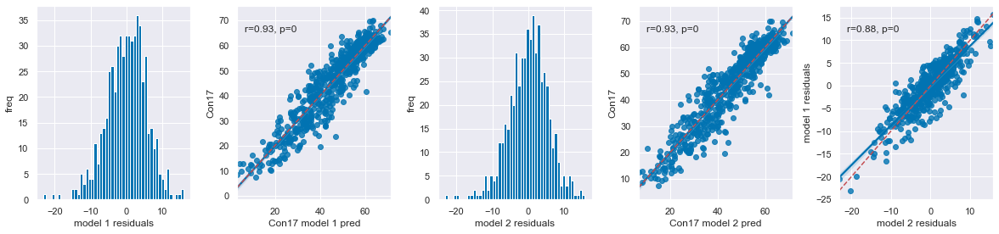

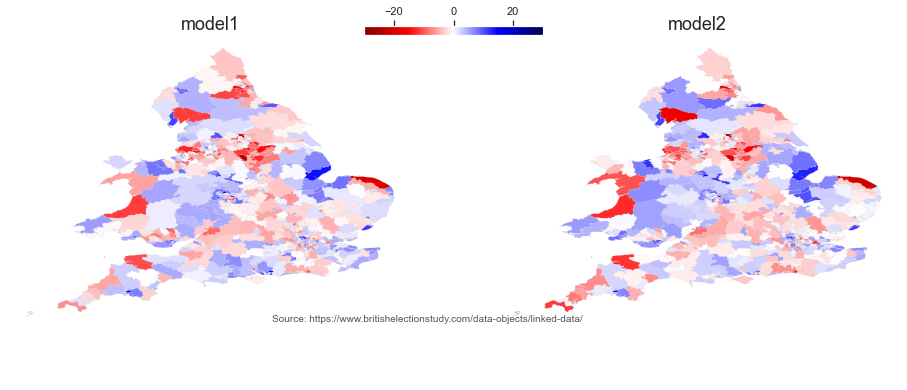

In [1604]:
var_stub = "Con17"
title = "Con17_comp"
specific_vars_list = [jk_es_set,best_septet]
                      
geomask = (BES_census_data["Country"]!="Scotland")&(BES_census_data["Winner17"]!="Speaker")

model_comparison(var_stub,title,specific_vars_list,geomask=geomask,model_type='sm')

model1
MSE: 36.80, MAE: 4.42, EV: 0.83, R2: 0.83


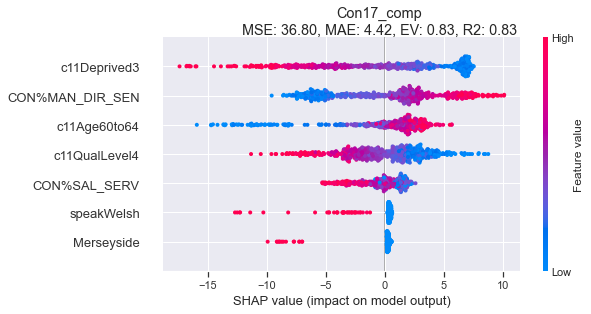

<Figure size 1152x720 with 0 Axes>

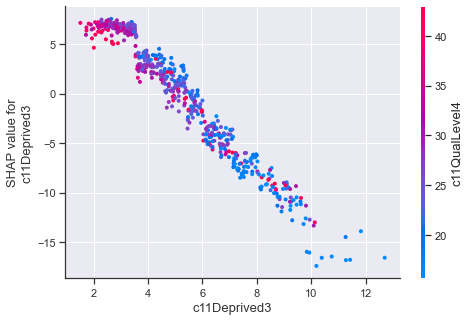

<Figure size 1152x720 with 0 Axes>

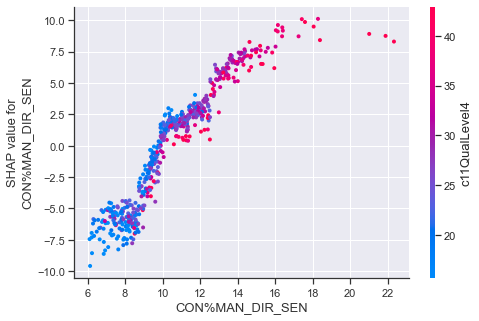

<Figure size 1152x720 with 0 Axes>

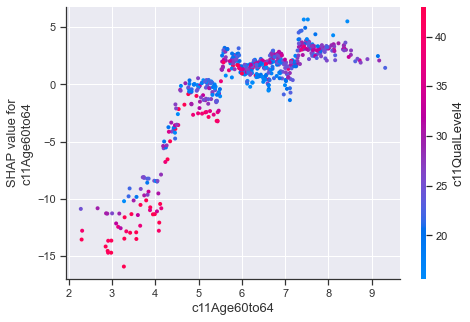

<Figure size 1152x720 with 0 Axes>

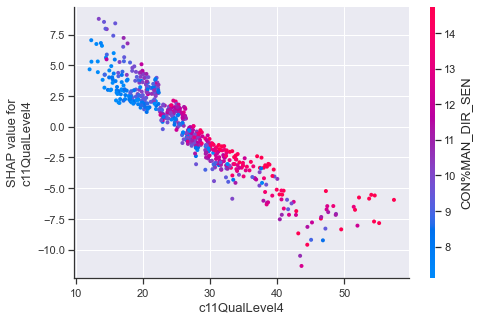

<Figure size 1152x720 with 0 Axes>

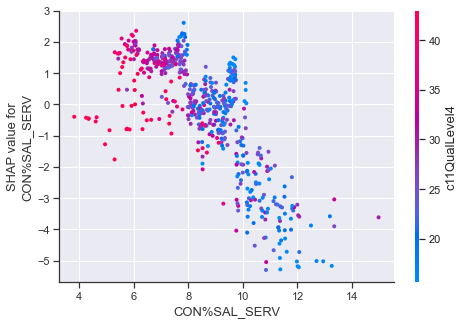

<Figure size 1152x720 with 0 Axes>

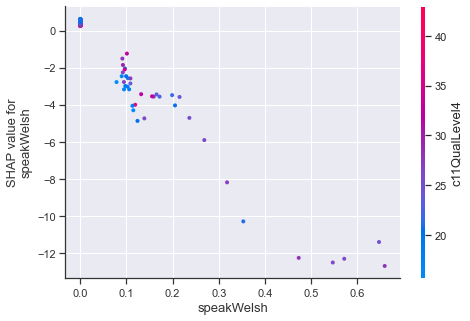

<Figure size 1152x720 with 0 Axes>

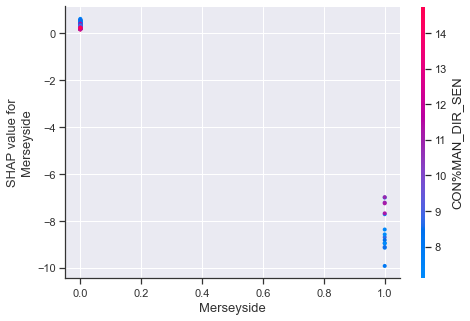

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  Con17   R-squared:                       0.863
Model:                            OLS   Adj. R-squared:                  0.861
Method:                 Least Squares   F-statistic:                     507.8
Date:                Sun, 23 Jan 2022   Prob (F-statistic):          9.15e-239
Time:                        19:10:17   Log-Likelihood:                -1789.3
No. Observations:                 572   AIC:                             3595.
Df Residuals:                     564   BIC:                             3629.
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
===================================================================================
                      coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------
const              84.9957      4.869     17.456      0.000      75.432      94.559
c11Deprived3       -4.2732      0.186    -22.977      0.000      -4.639      -3.908
c11QualLevel4      -1.2237      0.058    -21.151      0.000      -1.337      -1.110
c11Age60to64       -0.4349      0.306     -1.420      0.156      -1.036       0.167
CON%MAN_DIR_SEN     2.8199      0.204     13.790      0.000       2.418       3.222
CON%SAL_SERV       -1.4714      0.239     -6.154      0.000      -1.941      -1.002
Merseyside         -9.7139      1.522     -6.383      0.000     -12.703      -6.725
speakWelsh        -29.5239      3.783     -7.804      0.000     -36.955     -22.093
==============================================================================
Omnibus:                       20.757   Durbin-Watson:                   1.755
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               25.363
Skew:                          -0.374   Prob(JB):                     3.11e-06
Kurtosis:                       3.710   Cond. No.                         675.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

model2
MSE: 44.88, MAE: 4.84, EV: 0.80, R2: 0.80


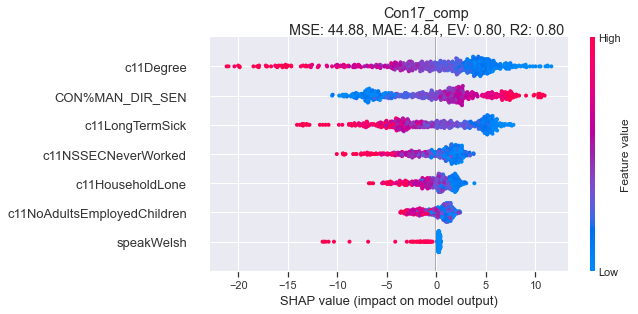

<Figure size 1152x720 with 0 Axes>

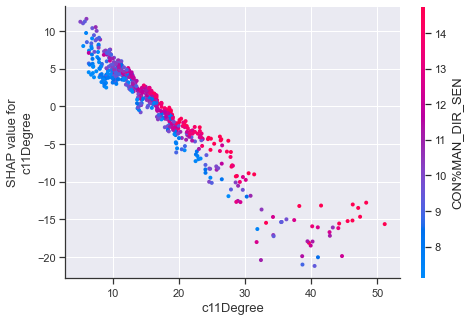

<Figure size 1152x720 with 0 Axes>

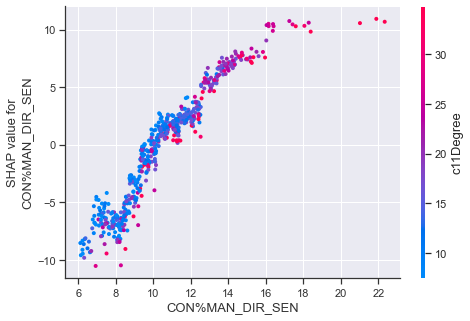

<Figure size 1152x720 with 0 Axes>

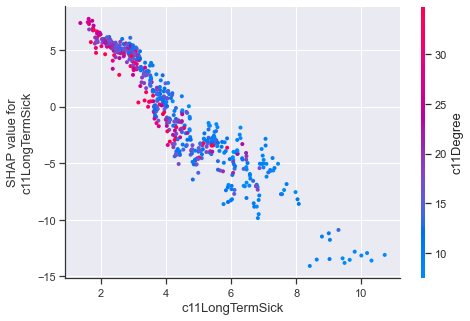

<Figure size 1152x720 with 0 Axes>

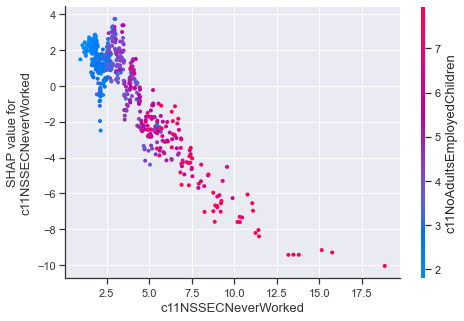

<Figure size 1152x720 with 0 Axes>

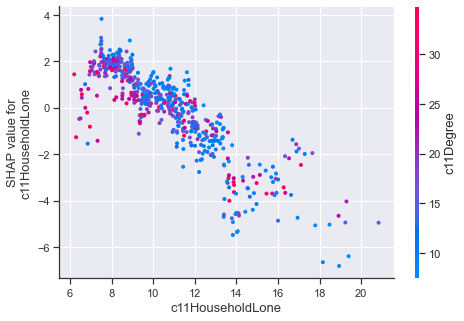

<Figure size 1152x720 with 0 Axes>

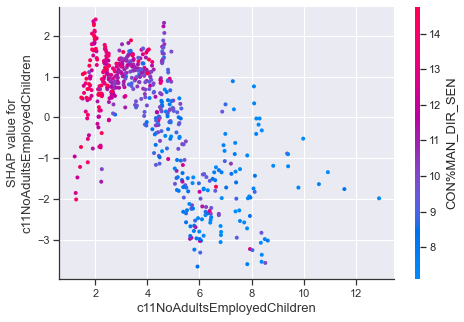

<Figure size 1152x720 with 0 Axes>

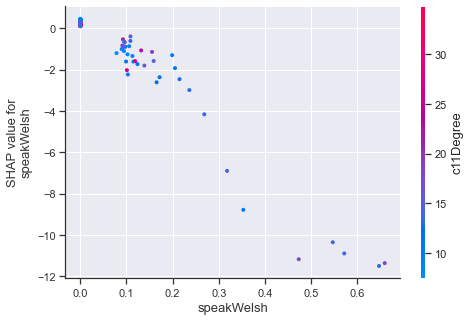

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  Con17   R-squared:                       0.866
Model:                            OLS   Adj. R-squared:                  0.864
Method:                 Least Squares   F-statistic:                     518.5
Date:                Sun, 23 Jan 2022   Prob (F-statistic):          5.56e-241
Time:                        19:10:19   Log-Likelihood:                -1784.1
No. Observations:                 572   AIC:                             3584.
Df Residuals:                     564   BIC:                             3619.
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
===============================================================================================
                                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
const                          54.4828      2.705     20.139      0.000      49.169      59.797
c11Degree                      -1.1445      0.037    -30.760      0.000      -1.218      -1.071
CON%MAN_DIR_SEN                 3.3303      0.161     20.631      0.000       3.013       3.647
c11LongTermSick                -3.9655      0.225    -17.597      0.000      -4.408      -3.523
speakWelsh                    -22.5777      3.686     -6.126      0.000     -29.817     -15.338
c11HouseholdLone               -1.4069      0.250     -5.621      0.000      -1.898      -0.915
c11NSSECNeverWorked            -2.0696      0.236     -8.778      0.000      -2.533      -1.607
c11NoAdultsEmployedChildren     3.1362      0.525      5.969      0.000       2.104       4.168
==============================================================================
Omnibus:                       24.712   Durbin-Watson:                   1.755
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               35.434
Skew:                          -0.367   Prob(JB):                     2.02e-08
Kurtosis:                       3.973   Cond. No.                         391.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

()

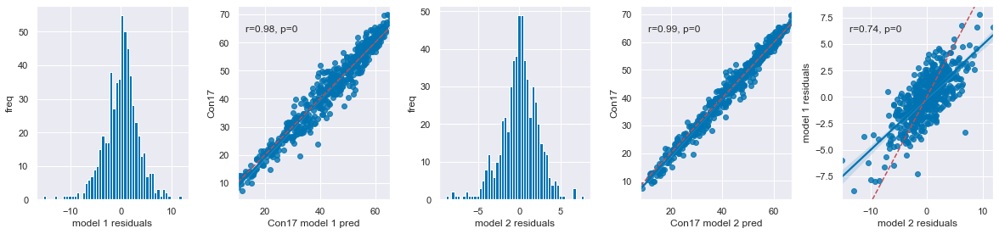

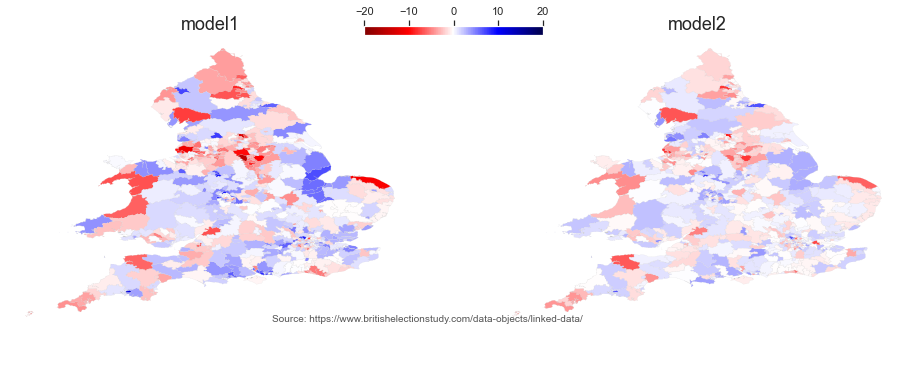

In [1605]:
var_stub = "Con17"
title = "Con17_comp"
specific_vars_list = [jk_es_set,best_septet]
                      
geomask = (BES_census_data["Country"]!="Scotland")&(BES_census_data["Winner17"]!="Speaker")

model_comparison(var_stub,title,specific_vars_list,geomask=geomask,model_type='xgb')

model1
MSE: 36.80, MAE: 4.42, EV: 0.83, R2: 0.83


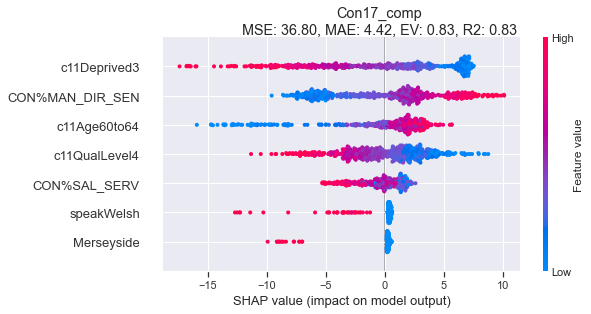

<Figure size 1152x720 with 0 Axes>

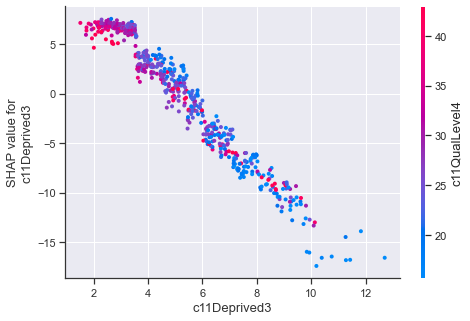

<Figure size 1152x720 with 0 Axes>

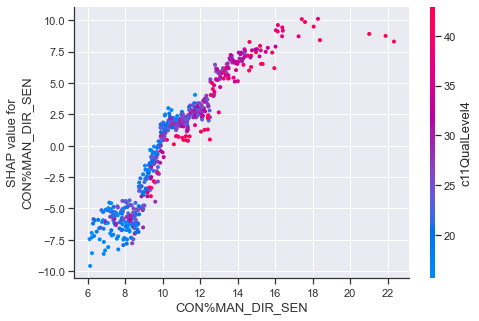

<Figure size 1152x720 with 0 Axes>

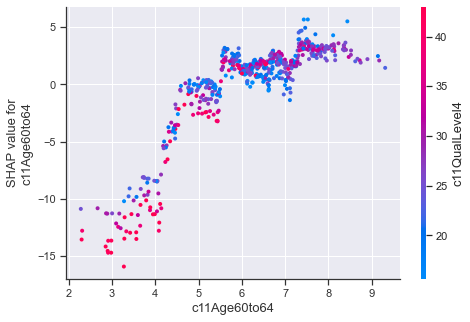

<Figure size 1152x720 with 0 Axes>

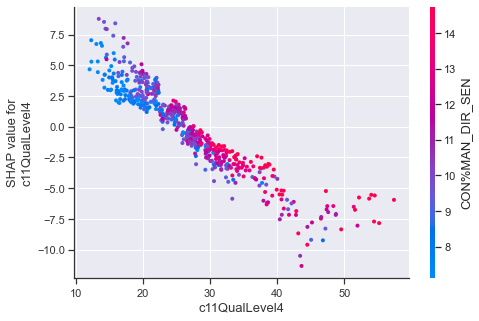

<Figure size 1152x720 with 0 Axes>

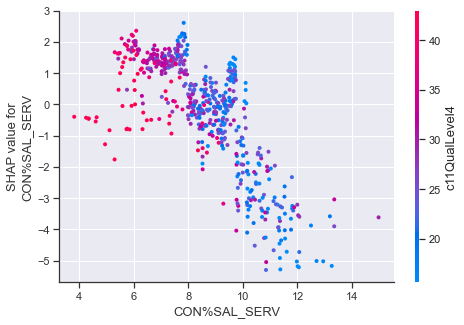

<Figure size 1152x720 with 0 Axes>

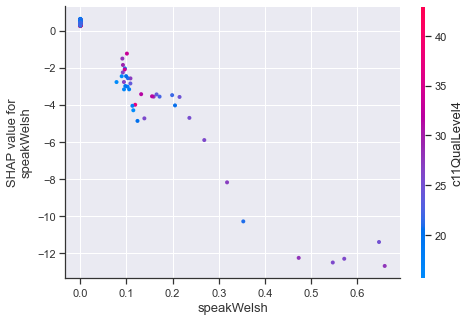

<Figure size 1152x720 with 0 Axes>

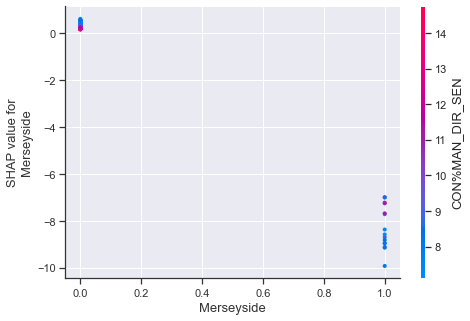

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  Con17   R-squared:                       0.863
Model:                            OLS   Adj. R-squared:                  0.861
Method:                 Least Squares   F-statistic:                     507.8
Date:                Sun, 23 Jan 2022   Prob (F-statistic):          9.15e-239
Time:                        19:07:14   Log-Likelihood:                -1789.3
No. Observations:                 572   AIC:                             3595.
Df Residuals:                     564   BIC:                             3629.
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
===================================================================================
                      coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------
const              84.9957      4.869     17.456      0.000      75.432      94.559
c11Deprived3       -4.2732      0.186    -22.977      0.000      -4.639      -3.908
c11QualLevel4      -1.2237      0.058    -21.151      0.000      -1.337      -1.110
c11Age60to64       -0.4349      0.306     -1.420      0.156      -1.036       0.167
CON%MAN_DIR_SEN     2.8199      0.204     13.790      0.000       2.418       3.222
CON%SAL_SERV       -1.4714      0.239     -6.154      0.000      -1.941      -1.002
Merseyside         -9.7139      1.522     -6.383      0.000     -12.703      -6.725
speakWelsh        -29.5239      3.783     -7.804      0.000     -36.955     -22.093
==============================================================================
Omnibus:                       20.757   Durbin-Watson:                   1.755
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               25.363
Skew:                          -0.374   Prob(JB):                     3.11e-06
Kurtosis:                       3.710   Cond. No.                         675.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

model2
MSE: 35.33, MAE: 4.62, EV: 0.84, R2: 0.84


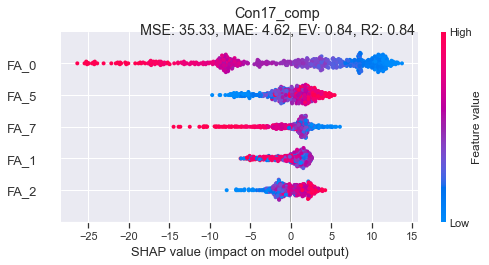

<Figure size 1152x720 with 0 Axes>

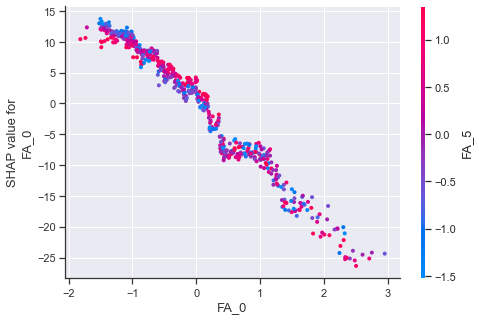

<Figure size 1152x720 with 0 Axes>

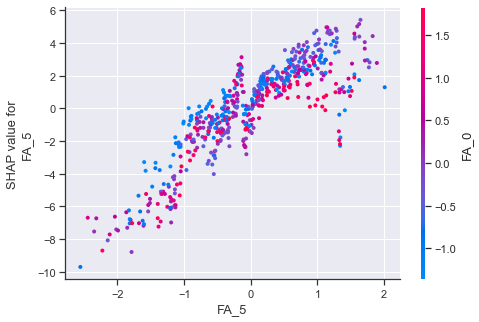

<Figure size 1152x720 with 0 Axes>

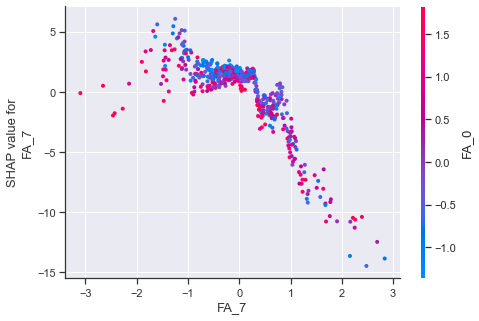

<Figure size 1152x720 with 0 Axes>

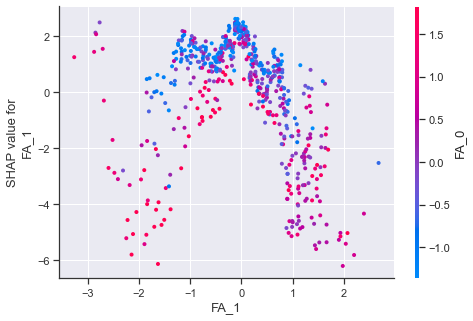

<Figure size 1152x720 with 0 Axes>

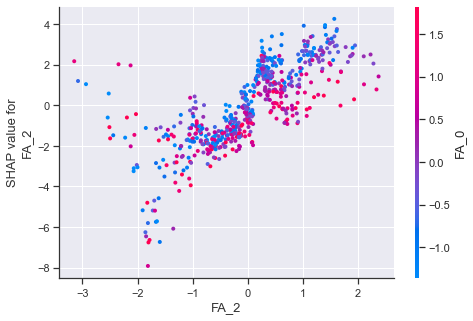

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  Con17   R-squared:                       0.831
Model:                            OLS   Adj. R-squared:                  0.829
Method:                 Least Squares   F-statistic:                     554.9
Date:                Sun, 23 Jan 2022   Prob (F-statistic):          1.77e-215
Time:                        19:07:15   Log-Likelihood:                -1850.2
No. Observations:                 572   AIC:                             3712.
Df Residuals:                     566   BIC:                             3738.
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         44.1341      0.258    170.863      0.000      43.627      44.641
FA_0         -12.5687      0.260    -48.422      0.000     -13.079     -12.059
FA_1          -1.4475      0.260     -5.561      0.000      -1.959      -0.936
FA_2           2.7703      0.266     10.402      0.000       2.247       3.293
FA_5           3.9343      0.292     13.477      0.000       3.361       4.508
FA_7          -3.3943      0.325    -10.455      0.000      -4.032      -2.757
==============================================================================
Omnibus:                       10.835   Durbin-Watson:                   1.733
Prob(Omnibus):                  0.004   Jarque-Bera (JB):               12.442
Skew:                          -0.245   Prob(JB):                      0.00199
Kurtosis:                       3.532   Cond. No.                         1.26
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

model3
MSE: 42.06, MAE: 4.99, EV: 0.81, R2: 0.81


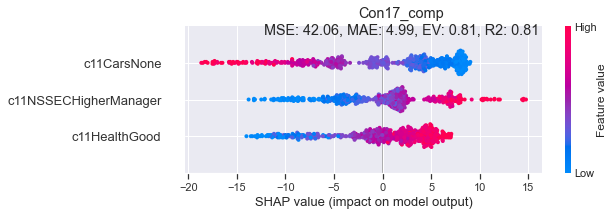

<Figure size 1152x720 with 0 Axes>

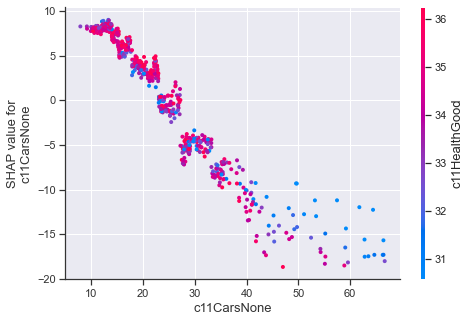

<Figure size 1152x720 with 0 Axes>

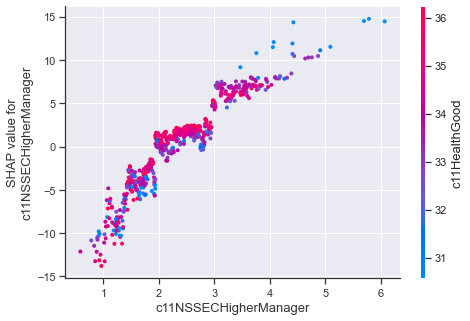

<Figure size 1152x720 with 0 Axes>

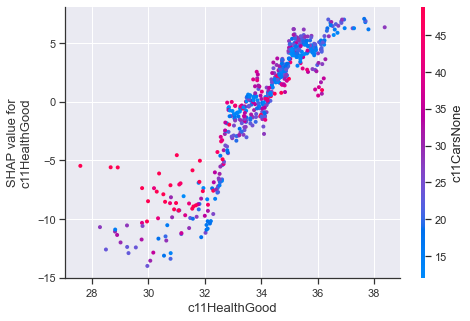

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  Con17   R-squared:                       0.805
Model:                            OLS   Adj. R-squared:                  0.804
Method:                 Least Squares   F-statistic:                     780.7
Date:                Sun, 23 Jan 2022   Prob (F-statistic):          5.22e-201
Time:                        19:07:16   Log-Likelihood:                -1890.6
No. Observations:                 572   AIC:                             3789.
Df Residuals:                     568   BIC:                             3807.
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
=========================================================================================
                            coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                   -65.9279      6.776     -9.730      0.000     -79.237     -52.619
c11CarsNone              -0.5852      0.030    -19.283      0.000      -0.645      -0.526
c11HealthGood             3.1514      0.177     17.759      0.000       2.803       3.500
c11NSSECHigherManager     7.4534      0.376     19.801      0.000       6.714       8.193
==============================================================================
Omnibus:                        2.125   Durbin-Watson:                   1.802
Prob(Omnibus):                  0.346   Jarque-Bera (JB):                1.939
Skew:                          -0.103   Prob(JB):                        0.379
Kurtosis:                       3.196   Cond. No.                     1.05e+03
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 1.05e+03. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

model4
MSE: 33.45, MAE: 4.28, EV: 0.85, R2: 0.85


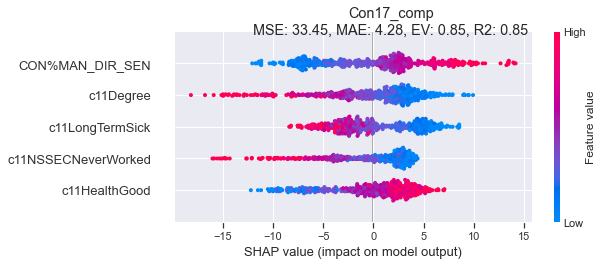

<Figure size 1152x720 with 0 Axes>

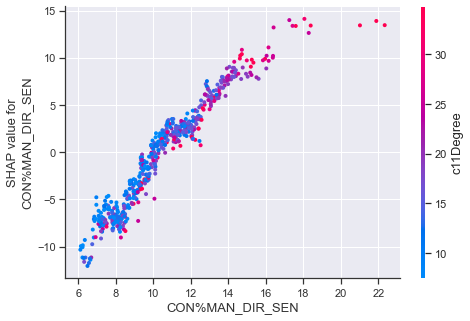

<Figure size 1152x720 with 0 Axes>

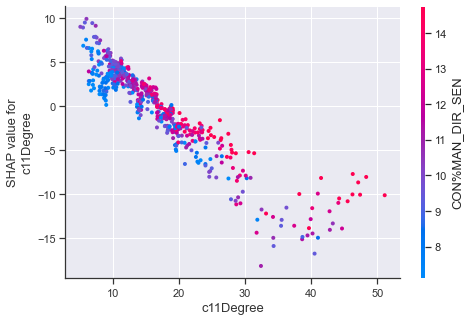

<Figure size 1152x720 with 0 Axes>

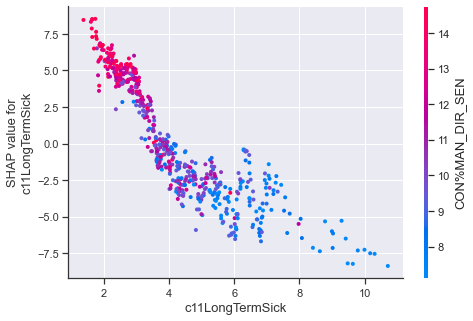

<Figure size 1152x720 with 0 Axes>

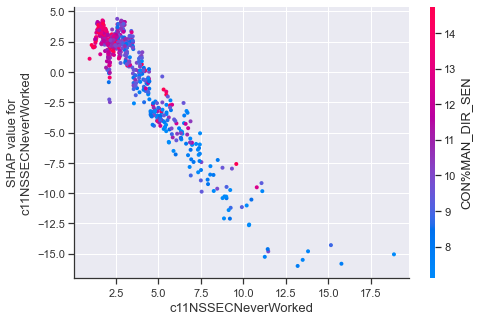

<Figure size 1152x720 with 0 Axes>

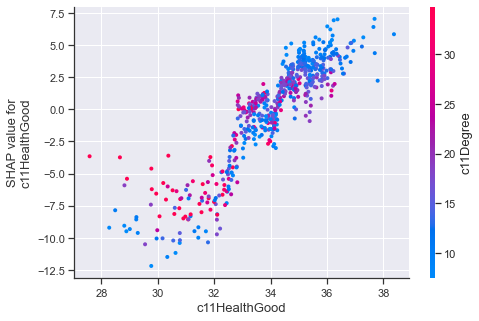

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  Con17   R-squared:                       0.859
Model:                            OLS   Adj. R-squared:                  0.858
Method:                 Least Squares   F-statistic:                     689.9
Date:                Sun, 23 Jan 2022   Prob (F-statistic):          4.48e-238
Time:                        19:07:18   Log-Likelihood:                -1797.6
No. Observations:                 572   AIC:                             3607.
Df Residuals:                     566   BIC:                             3633.
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
=======================================================================================
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
const                 -17.5565      9.868     -1.779      0.076     -36.939       1.826
c11LongTermSick        -2.3762      0.319     -7.443      0.000      -3.003      -1.749
CON%MAN_DIR_SEN         3.4318      0.154     22.336      0.000       3.130       3.734
c11NSSECNeverWorked    -1.3592      0.149     -9.152      0.000      -1.651      -1.067
c11HealthGood           1.6220      0.232      6.989      0.000       1.166       2.078
c11Degree              -0.8909      0.054    -16.649      0.000      -0.996      -0.786
==============================================================================
Omnibus:                       36.296   Durbin-Watson:                   1.745
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               62.460
Skew:                          -0.438   Prob(JB):                     2.73e-14
Kurtosis:                       4.361   Cond. No.                     1.67e+03
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 1.67e+03. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

model5
MSE: 44.88, MAE: 4.84, EV: 0.80, R2: 0.80


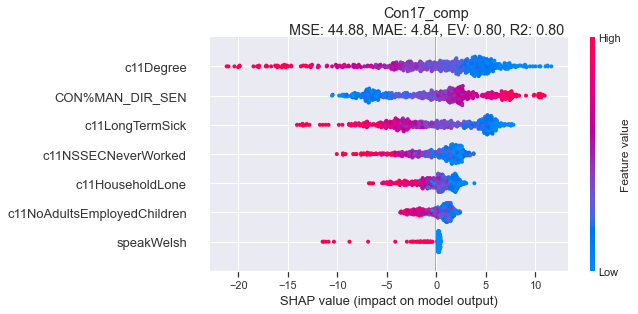

<Figure size 1152x720 with 0 Axes>

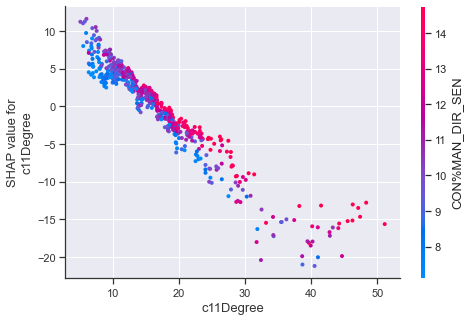

<Figure size 1152x720 with 0 Axes>

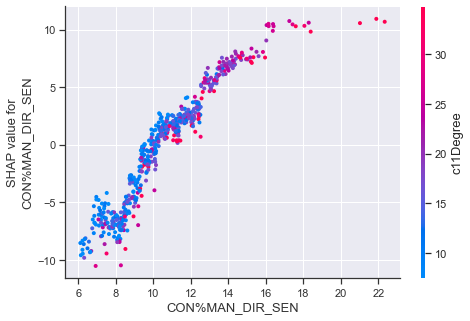

<Figure size 1152x720 with 0 Axes>

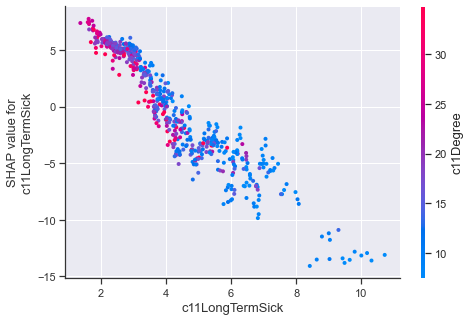

<Figure size 1152x720 with 0 Axes>

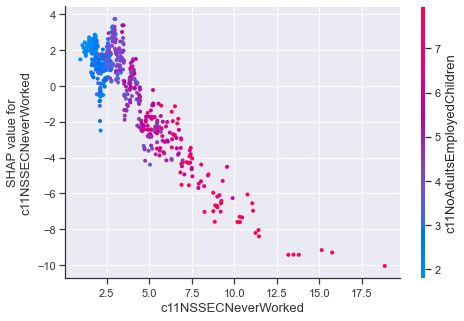

<Figure size 1152x720 with 0 Axes>

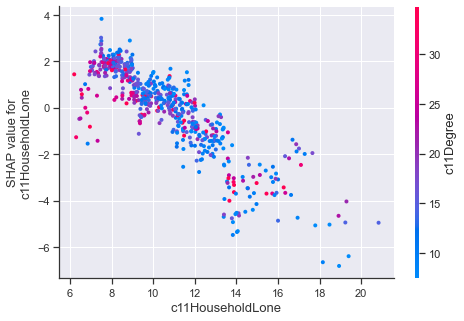

<Figure size 1152x720 with 0 Axes>

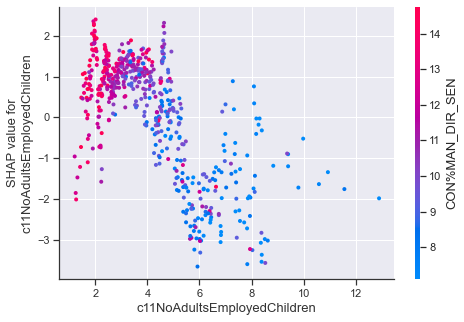

<Figure size 1152x720 with 0 Axes>

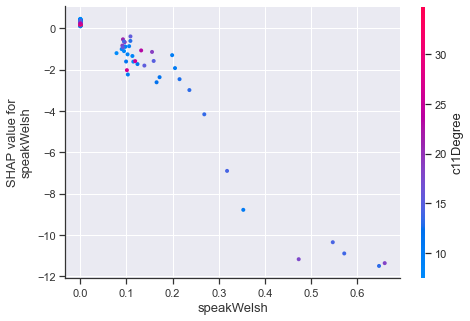

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  Con17   R-squared:                       0.866
Model:                            OLS   Adj. R-squared:                  0.864
Method:                 Least Squares   F-statistic:                     518.5
Date:                Sun, 23 Jan 2022   Prob (F-statistic):          5.56e-241
Time:                        19:07:20   Log-Likelihood:                -1784.1
No. Observations:                 572   AIC:                             3584.
Df Residuals:                     564   BIC:                             3619.
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
===============================================================================================
                                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
const                          54.4828      2.705     20.139      0.000      49.169      59.797
c11Degree                      -1.1445      0.037    -30.760      0.000      -1.218      -1.071
CON%MAN_DIR_SEN                 3.3303      0.161     20.631      0.000       3.013       3.647
c11LongTermSick                -3.9655      0.225    -17.597      0.000      -4.408      -3.523
speakWelsh                    -22.5777      3.686     -6.126      0.000     -29.817     -15.338
c11HouseholdLone               -1.4069      0.250     -5.621      0.000      -1.898      -0.915
c11NSSECNeverWorked            -2.0696      0.236     -8.778      0.000      -2.533      -1.607
c11NoAdultsEmployedChildren     3.1362      0.525      5.969      0.000       2.104       4.168
==============================================================================
Omnibus:                       24.712   Durbin-Watson:                   1.755
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               35.434
Skew:                          -0.367   Prob(JB):                     2.02e-08
Kurtosis:                       3.973   Cond. No.                         391.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

()

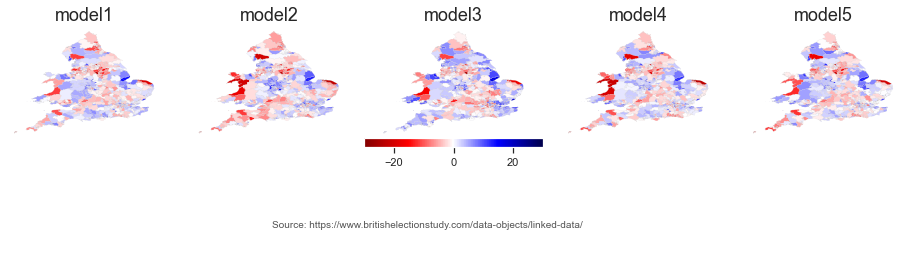

In [1603]:
var_stub = "Con17"
title = "Con17_comp"
specific_vars_list = [jk_es_set,fa_sup,best_triplet,best_quintet,best_septet]
                      
geomask = (BES_census_data["Country"]!="Scotland")&(BES_census_data["Winner17"]!="Speaker")

model_comparison(var_stub,title,specific_vars_list,geomask=geomask,model_type='sm')

model1
MSE: 36.80, MAE: 4.42, EV: 0.83, R2: 0.83


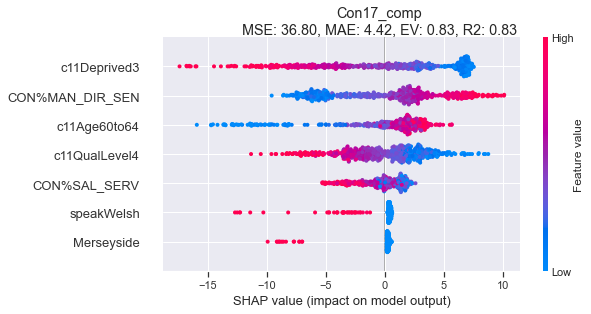

<Figure size 1152x720 with 0 Axes>

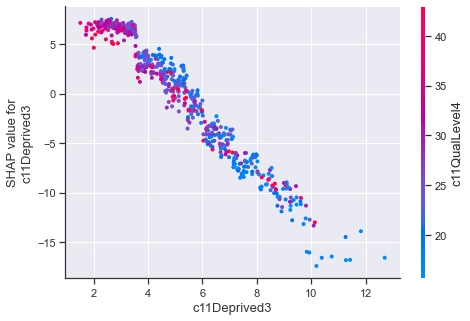

<Figure size 1152x720 with 0 Axes>

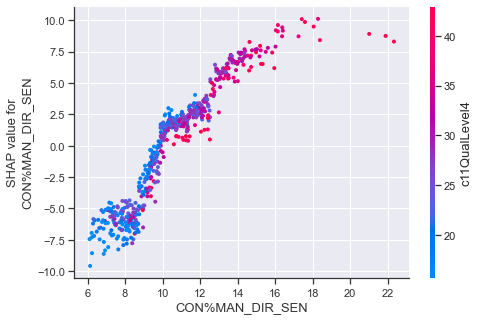

<Figure size 1152x720 with 0 Axes>

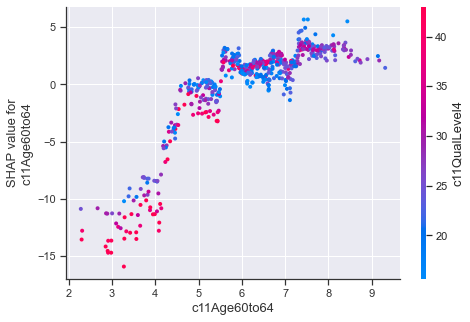

<Figure size 1152x720 with 0 Axes>

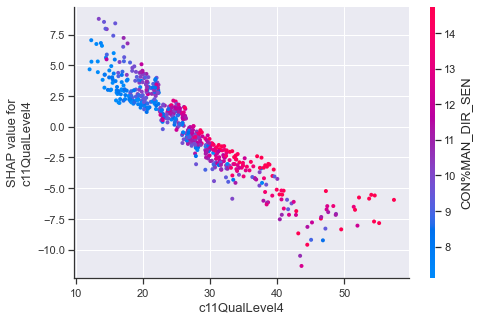

<Figure size 1152x720 with 0 Axes>

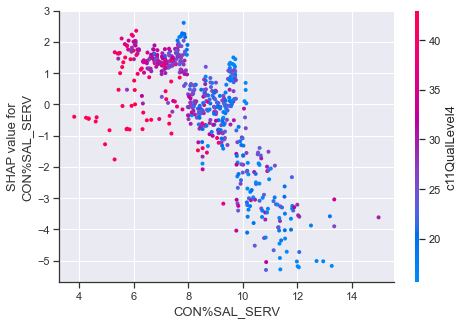

<Figure size 1152x720 with 0 Axes>

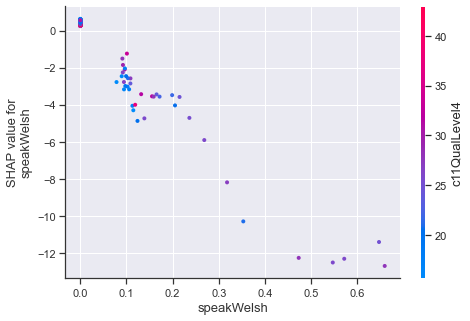

<Figure size 1152x720 with 0 Axes>

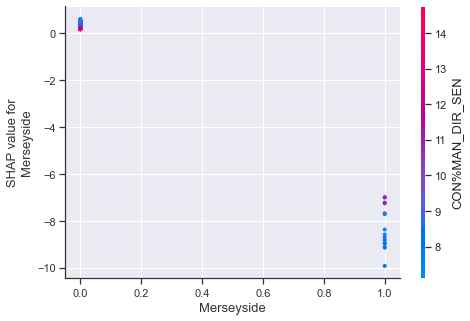

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  Con17   R-squared:                       0.863
Model:                            OLS   Adj. R-squared:                  0.861
Method:                 Least Squares   F-statistic:                     507.8
Date:                Sun, 23 Jan 2022   Prob (F-statistic):          9.15e-239
Time:                        19:10:29   Log-Likelihood:                -1789.3
No. Observations:                 572   AIC:                             3595.
Df Residuals:                     564   BIC:                             3629.
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
===================================================================================
                      coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------
const              84.9957      4.869     17.456      0.000      75.432      94.559
c11Deprived3       -4.2732      0.186    -22.977      0.000      -4.639      -3.908
c11QualLevel4      -1.2237      0.058    -21.151      0.000      -1.337      -1.110
c11Age60to64       -0.4349      0.306     -1.420      0.156      -1.036       0.167
CON%MAN_DIR_SEN     2.8199      0.204     13.790      0.000       2.418       3.222
CON%SAL_SERV       -1.4714      0.239     -6.154      0.000      -1.941      -1.002
Merseyside         -9.7139      1.522     -6.383      0.000     -12.703      -6.725
speakWelsh        -29.5239      3.783     -7.804      0.000     -36.955     -22.093
==============================================================================
Omnibus:                       20.757   Durbin-Watson:                   1.755
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               25.363
Skew:                          -0.374   Prob(JB):                     3.11e-06
Kurtosis:                       3.710   Cond. No.                         675.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

model2
MSE: 35.33, MAE: 4.62, EV: 0.84, R2: 0.84


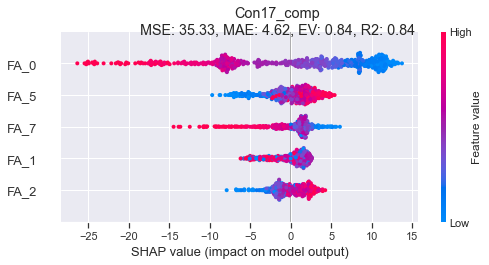

<Figure size 1152x720 with 0 Axes>

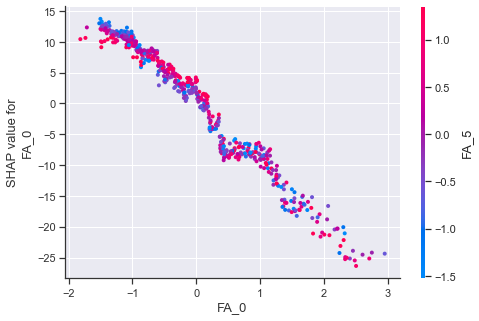

<Figure size 1152x720 with 0 Axes>

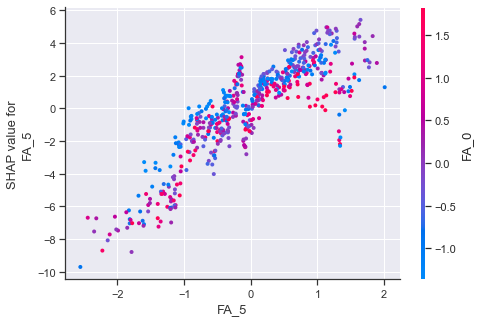

<Figure size 1152x720 with 0 Axes>

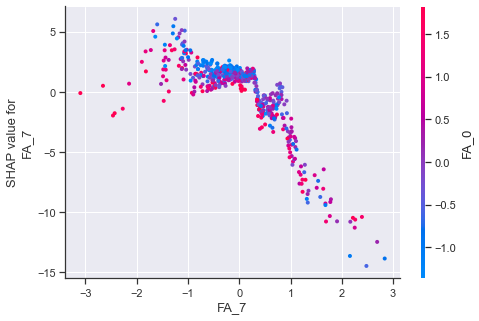

<Figure size 1152x720 with 0 Axes>

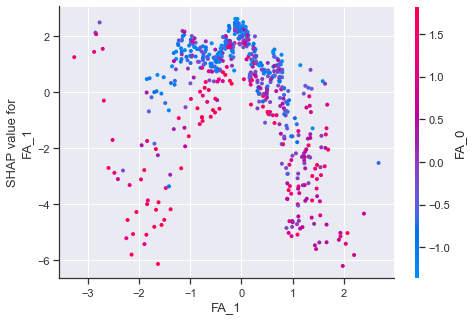

<Figure size 1152x720 with 0 Axes>

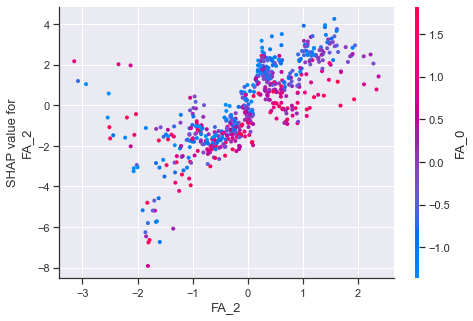

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  Con17   R-squared:                       0.831
Model:                            OLS   Adj. R-squared:                  0.829
Method:                 Least Squares   F-statistic:                     554.9
Date:                Sun, 23 Jan 2022   Prob (F-statistic):          1.77e-215
Time:                        19:10:31   Log-Likelihood:                -1850.2
No. Observations:                 572   AIC:                             3712.
Df Residuals:                     566   BIC:                             3738.
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         44.1341      0.258    170.863      0.000      43.627      44.641
FA_0         -12.5687      0.260    -48.422      0.000     -13.079     -12.059
FA_1          -1.4475      0.260     -5.561      0.000      -1.959      -0.936
FA_2           2.7703      0.266     10.402      0.000       2.247       3.293
FA_5           3.9343      0.292     13.477      0.000       3.361       4.508
FA_7          -3.3943      0.325    -10.455      0.000      -4.032      -2.757
==============================================================================
Omnibus:                       10.835   Durbin-Watson:                   1.733
Prob(Omnibus):                  0.004   Jarque-Bera (JB):               12.442
Skew:                          -0.245   Prob(JB):                      0.00199
Kurtosis:                       3.532   Cond. No.                         1.26
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

model3
MSE: 42.06, MAE: 4.99, EV: 0.81, R2: 0.81


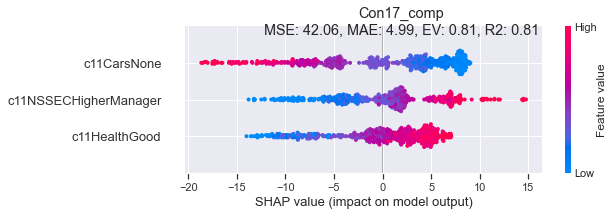

<Figure size 1152x720 with 0 Axes>

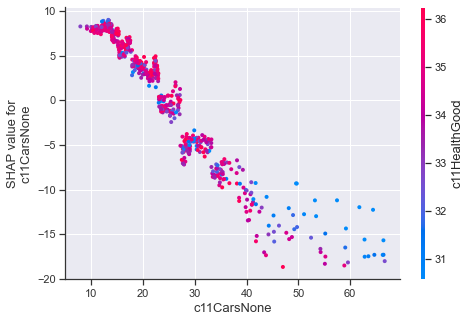

<Figure size 1152x720 with 0 Axes>

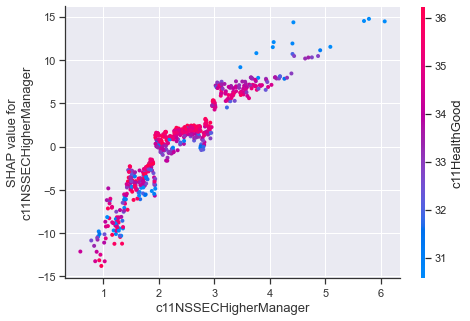

<Figure size 1152x720 with 0 Axes>

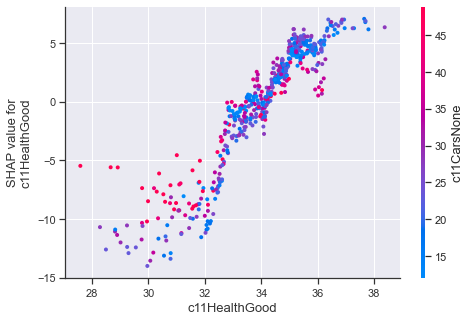

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  Con17   R-squared:                       0.805
Model:                            OLS   Adj. R-squared:                  0.804
Method:                 Least Squares   F-statistic:                     780.7
Date:                Sun, 23 Jan 2022   Prob (F-statistic):          5.22e-201
Time:                        19:10:32   Log-Likelihood:                -1890.6
No. Observations:                 572   AIC:                             3789.
Df Residuals:                     568   BIC:                             3807.
Df Model:                           3                                         
Covariance Type:            nonrobust                                         
=========================================================================================
                            coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------
const                   -65.9279      6.776     -9.730      0.000     -79.237     -52.619
c11CarsNone              -0.5852      0.030    -19.283      0.000      -0.645      -0.526
c11HealthGood             3.1514      0.177     17.759      0.000       2.803       3.500
c11NSSECHigherManager     7.4534      0.376     19.801      0.000       6.714       8.193
==============================================================================
Omnibus:                        2.125   Durbin-Watson:                   1.802
Prob(Omnibus):                  0.346   Jarque-Bera (JB):                1.939
Skew:                          -0.103   Prob(JB):                        0.379
Kurtosis:                       3.196   Cond. No.                     1.05e+03
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 1.05e+03. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

model4
MSE: 33.45, MAE: 4.28, EV: 0.85, R2: 0.85


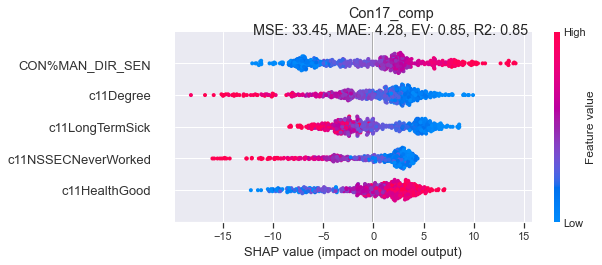

<Figure size 1152x720 with 0 Axes>

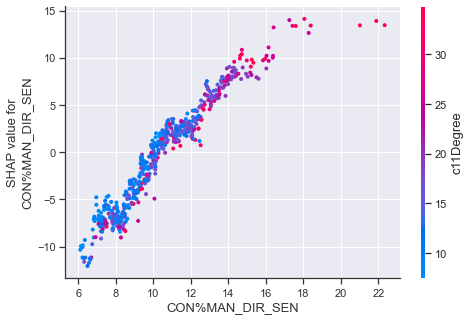

<Figure size 1152x720 with 0 Axes>

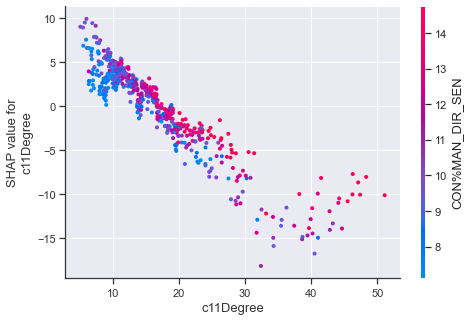

<Figure size 1152x720 with 0 Axes>

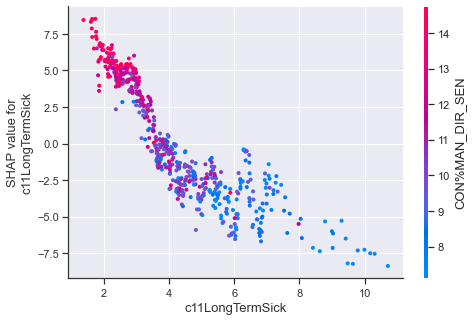

<Figure size 1152x720 with 0 Axes>

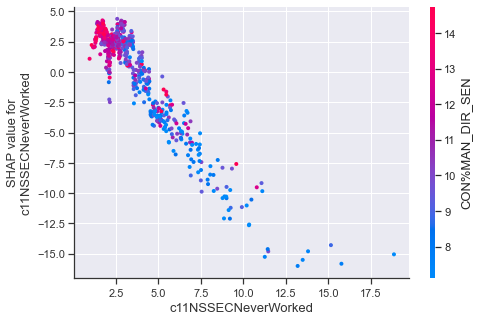

<Figure size 1152x720 with 0 Axes>

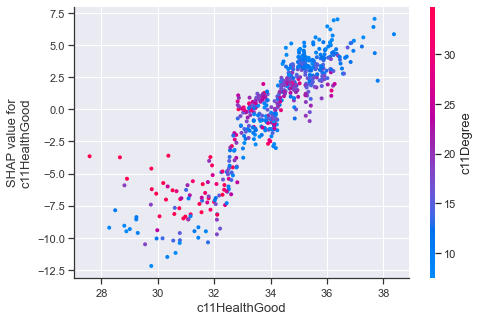

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  Con17   R-squared:                       0.859
Model:                            OLS   Adj. R-squared:                  0.858
Method:                 Least Squares   F-statistic:                     689.9
Date:                Sun, 23 Jan 2022   Prob (F-statistic):          4.48e-238
Time:                        19:10:34   Log-Likelihood:                -1797.6
No. Observations:                 572   AIC:                             3607.
Df Residuals:                     566   BIC:                             3633.
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
=======================================================================================
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
const                 -17.5565      9.868     -1.779      0.076     -36.939       1.826
c11LongTermSick        -2.3762      0.319     -7.443      0.000      -3.003      -1.749
CON%MAN_DIR_SEN         3.4318      0.154     22.336      0.000       3.130       3.734
c11NSSECNeverWorked    -1.3592      0.149     -9.152      0.000      -1.651      -1.067
c11HealthGood           1.6220      0.232      6.989      0.000       1.166       2.078
c11Degree              -0.8909      0.054    -16.649      0.000      -0.996      -0.786
==============================================================================
Omnibus:                       36.296   Durbin-Watson:                   1.745
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               62.460
Skew:                          -0.438   Prob(JB):                     2.73e-14
Kurtosis:                       4.361   Cond. No.                     1.67e+03
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 1.67e+03. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

model5
MSE: 44.88, MAE: 4.84, EV: 0.80, R2: 0.80


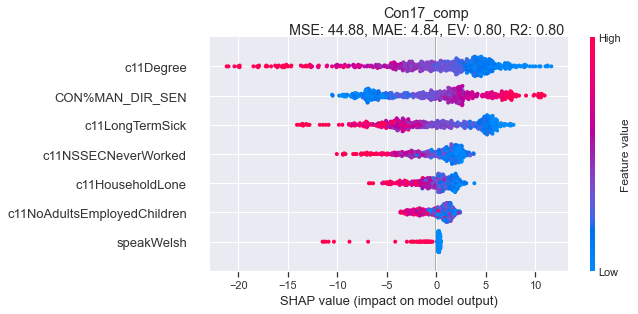

<Figure size 1152x720 with 0 Axes>

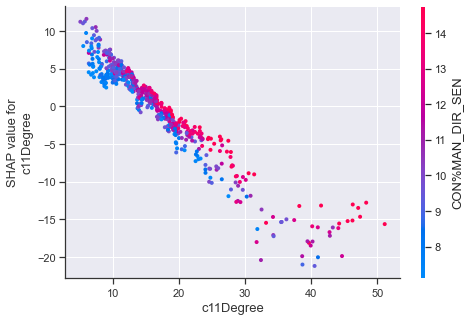

<Figure size 1152x720 with 0 Axes>

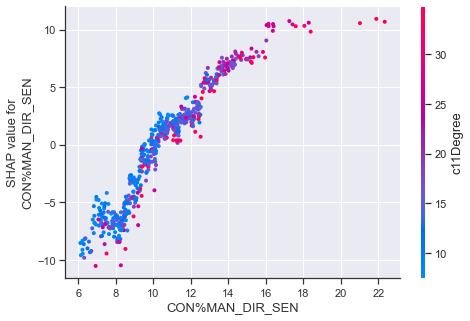

<Figure size 1152x720 with 0 Axes>

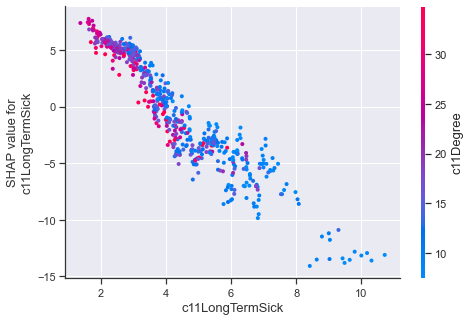

<Figure size 1152x720 with 0 Axes>

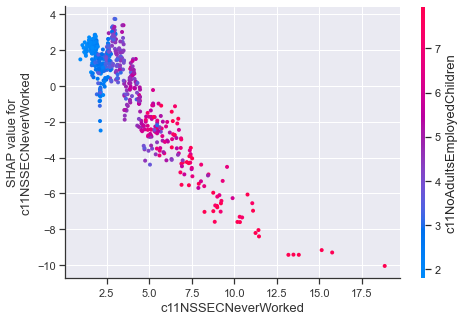

<Figure size 1152x720 with 0 Axes>

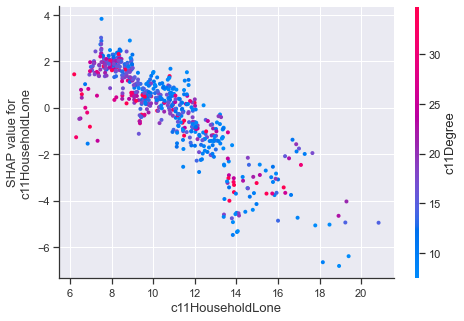

<Figure size 1152x720 with 0 Axes>

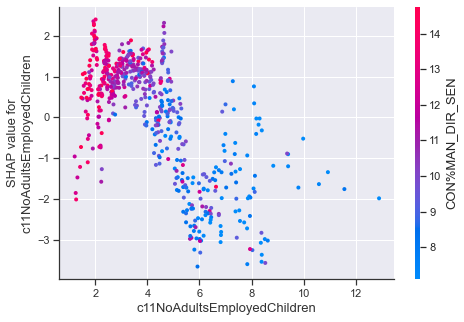

<Figure size 1152x720 with 0 Axes>

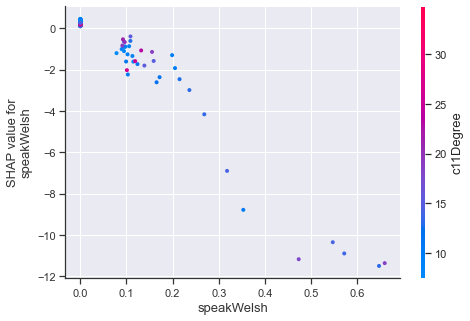

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  Con17   R-squared:                       0.866
Model:                            OLS   Adj. R-squared:                  0.864
Method:                 Least Squares   F-statistic:                     518.5
Date:                Sun, 23 Jan 2022   Prob (F-statistic):          5.56e-241
Time:                        19:10:36   Log-Likelihood:                -1784.1
No. Observations:                 572   AIC:                             3584.
Df Residuals:                     564   BIC:                             3619.
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
===============================================================================================
                                  coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------------
const                          54.4828      2.705     20.139      0.000      49.169      59.797
c11Degree                      -1.1445      0.037    -30.760      0.000      -1.218      -1.071
CON%MAN_DIR_SEN                 3.3303      0.161     20.631      0.000       3.013       3.647
c11LongTermSick                -3.9655      0.225    -17.597      0.000      -4.408      -3.523
speakWelsh                    -22.5777      3.686     -6.126      0.000     -29.817     -15.338
c11HouseholdLone               -1.4069      0.250     -5.621      0.000      -1.898      -0.915
c11NSSECNeverWorked            -2.0696      0.236     -8.778      0.000      -2.533      -1.607
c11NoAdultsEmployedChildren     3.1362      0.525      5.969      0.000       2.104       4.168
==============================================================================
Omnibus:                       24.712   Durbin-Watson:                   1.755
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               35.434
Skew:                          -0.367   Prob(JB):                     2.02e-08
Kurtosis:                       3.973   Cond. No.                         391.
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

()

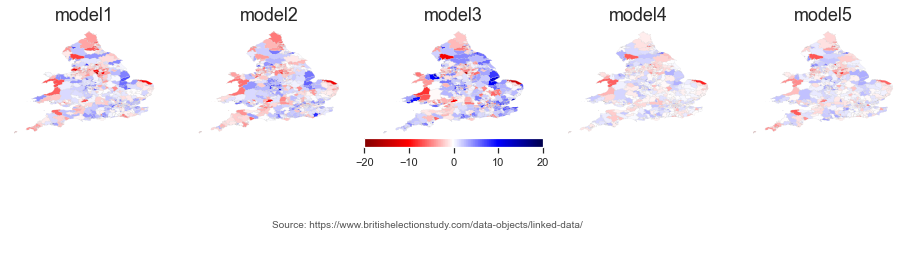

In [1606]:
var_stub = "Con17"
title = "Con17_comp"
specific_vars_list = [jk_es_set,fa_sup,best_triplet,best_quintet,best_septet]
                      
geomask = (BES_census_data["Country"]!="Scotland")&(BES_census_data["Winner17"]!="Speaker")

model_comparison(var_stub,title,specific_vars_list,geomask=geomask,model_type='xgb')

In [516]:
BES_census_data[specific_vars].corr().round(1).abs().sum()

c11CarsNone              4.5
c11HealthGood            2.4
c11NSSECSmallEmployer    3.6
c11NSSECNeverWorked      4.0
c11NSSECHigherManager    3.6
c11Deprived3             4.5
c11Christian             3.0
dtype: float64

In [500]:
specific_vars = ['c11Deprived3',
 'c11QualLevel4',
 'c11Age60to64',
 'CON%MAN_DIR_SEN',
 'CON%SAL_SERV',
 'Merseyside','speakWelsh']

BES_census_data[specific_vars].corr().round(1)

,c11Deprived3,c11QualLevel4,c11Age60to64,CON%MAN_DIR_SEN,CON%SAL_SERV,Merseyside,speakWelsh
c11Deprived3,1.0,-0.4,-0.5,-0.7,0.6,0.2,0.1
c11QualLevel4,-0.4,1.0,-0.3,0.6,-0.6,-0.1,-0.0
c11Age60to64,-0.5,-0.3,1.0,0.3,-0.3,0.0,0.1
CON%MAN_DIR_SEN,-0.7,0.6,0.3,1.0,-0.8,-0.1,-0.1
CON%SAL_SERV,0.6,-0.6,-0.3,-0.8,1.0,0.1,-0.0
Merseyside,0.2,-0.1,0.0,-0.1,0.1,1.0,-0.0
speakWelsh,0.1,-0.0,0.1,-0.1,-0.0,-0.0,1.0


In [487]:
specific_vars = ["c11CarsNone","c11HealthGood","c11NSSECSmallEmployer",
                 "c11HouseholdMarriedNoChildren","c11Deprived3","c11Christian"]
BES_census_data[specific_vars].corr().round(1)

,c11CarsNone,c11HealthGood,c11NSSECSmallEmployer,c11HouseholdMarriedNoChildren,c11Deprived3,c11Christian
c11CarsNone,1.0,-0.4,-0.6,-0.8,0.8,-0.5
c11HealthGood,-0.4,1.0,0.4,0.2,-0.3,0.1
c11NSSECSmallEmployer,-0.6,0.4,1.0,0.5,-0.5,0.3
c11HouseholdMarriedNoChildren,-0.8,0.2,0.5,1.0,-0.7,0.6
c11Deprived3,0.8,-0.3,-0.5,-0.7,1.0,-0.3
c11Christian,-0.5,0.1,0.3,0.6,-0.3,1.0


In [847]:
dataset = merged[merged["Country"].isin(["England","Wales"])]

Y = masked_df_simp['Con17']
X = masked_df_simp.drop(["leaveHanretty","remainHanretty","Con17"],axis=1)[final_cut]
X = sm.add_constant(X)
model = sm.OLS(Y,X)
results = model.fit_regularized(method = 'sqrt_lasso',refit=True,zero_tol =.005)
results.params
#  merged["Con17"]
# results.summary()

const                            71.557504
c11CarsFour                      -1.536572
c11Deprived3                     -2.124741
c11CarsThree                      1.617312
c11CarsNone                       0.149672
c11HouseholdMarriedNoChildren    -0.338218
c11NoAdultsEmployedChildren       4.127483
c11NSSECHigherManager             2.582379
CON%MAN_DIR_SEN                   1.321185
c11Neverworked                   -3.587781
c11HealthBad                     -4.815002
c11HouseholdLone                 -2.630103
c11NSSECNeverWorked              -1.864733
c11HouseholdOnePersonOther        0.304058
c11FulltimeStudent               -0.522013
c11Age65to74                      1.731324
c11Age60to64                     -0.574891
c11HouseholdLoneNodependents      3.639763
c11EconomicallyActiveStudent      0.767096
c11IndustryConstruction          -0.243215
c11Degree                        -0.508692
c11NSSECIntermediate              0.114898
c11IndustrySocialWork             0.089755
c11LookingA

In [848]:
pd.Series(results.params).sort_values()

speakWelsh                      -41.385814
Merseyside                      -10.229154
c11HealthBad                     -4.815002
c11Neverworked                   -3.587781
c11HouseholdLone                 -2.630103
c11Deprived3                     -2.124741
c11NSSECNeverWorked              -1.864733
c11CarsFour                      -1.536572
c11QualLevel4                    -0.957579
CON%SAL_SERV                     -0.941319
c11Age16to17                     -0.799478
c11Age60to64                     -0.574891
c11FulltimeStudent               -0.522013
c11Degree                        -0.508692
c11HouseholdMarriedNoChildren    -0.338218
c11IndustryConstruction          -0.243215
c11HouseSocial                   -0.097073
c11BornEngland                   -0.068388
c11NSSECSmallEmployer             0.080967
c11IndustrySocialWork             0.089755
c11Christian                      0.103937
c11NSSECIntermediate              0.114898
c11CarsNone                       0.149672
c11Househol

In [849]:
## high R^2, but not convinced I believe!

array([1230930.60325437])

In [850]:
masked_df_simp['Con17'].corr(results.fittedvalues)**2

0.8966808112888338

In [ ]:
#####################################################

In [1033]:
Treatment = "Census Data Decomposition"
output_folder = "E:\\BES_analysis_data\\output\\CensusDataDecomposition\\"
output_subfolder = output_folder + Treatment + os.sep
if not os.path.exists( output_subfolder ):
    os.makedirs( output_subfolder )

In [1286]:
decomp_index = masked_df_simp.index
decomp_columns = top_50
#.drop(strict_drop_vars+["Con17"],axis=1).columns
clean_feature_set_std = StandardScaler().fit_transform(masked_df_simp[top_50]).values )
decomp_std = pd.DataFrame(   clean_feature_set_std,
                             columns = decomp_columns,
                             index   = decomp_index      )

In [1312]:
%%time
# 5 mins
## RUN (some variant of) PCA (potentially v slow!)
n_components = decomp_std.shape[1]
# n_components = 4
# (svd_solver='full', n_components='mle',whiten=True)
# decomp = PCA(n_components = n_components,svd_solver='full')
# decomp = FastICA(algorithm='deflation', fun='exp', fun_args=None, max_iter=1000,
#     n_components=None, random_state=None, tol=0.07, w_init=None, whiten=False) # 2h 1min 4s "fast"
# decomp = SparsePCA(n_components=n_components, alpha=1,max_iter=1000,n_jobs=4,tol=1e-10, verbose=True) # 5min
#
# alpha=2 -> 1hr
decomp = FactorAnalysis(svd_method = 'lapack',n_components = n_components) ## ~10s ,n_components=30 -> 1.5 hrs
decomp_method = str(decomp).split("(")[0] 
# ,n_components=30

X_r = decomp.fit_transform(decomp_std)

BES_decomp = pd.DataFrame(   X_r,
                             columns = range(0,n_components),
                             index   = decomp_index)

Wall time: 8.4 ms


In [1313]:
import pickle
load_suff = "FactorAnalysis"
save = True # False => Load
if save & ( 'decomp' in globals() ): # SAVE    ##( 'decomp' not in globals() )
    decomp_method = str(decomp).split("(")[0] 
    subdir = output_subfolder + decomp_method
    fname = subdir+ os.sep + decomp_method

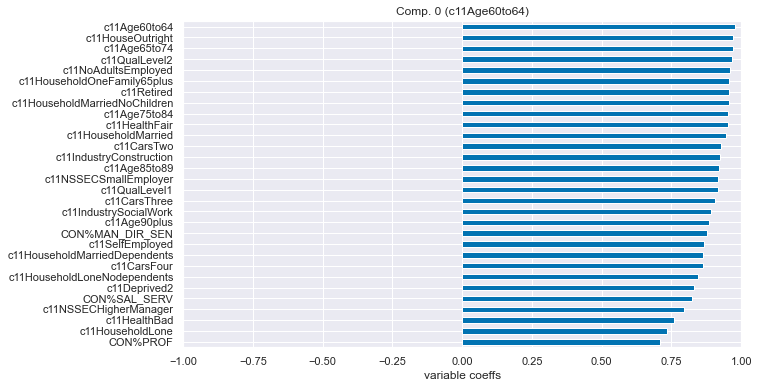

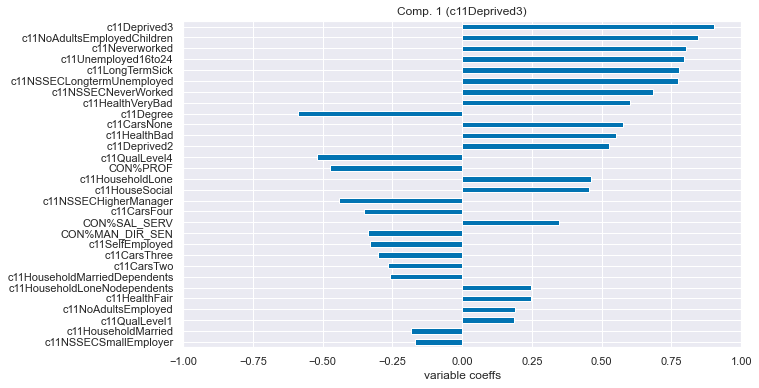

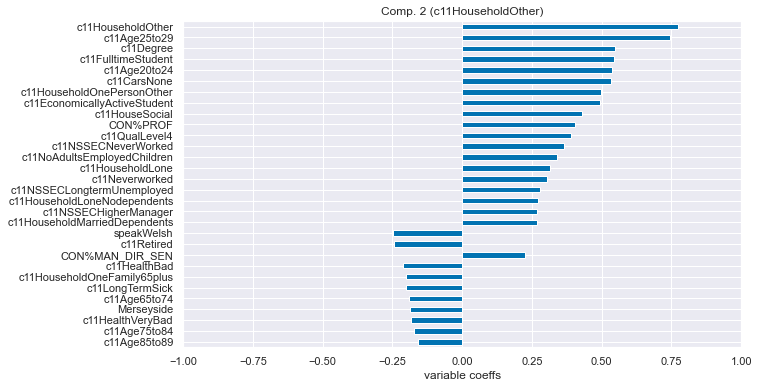

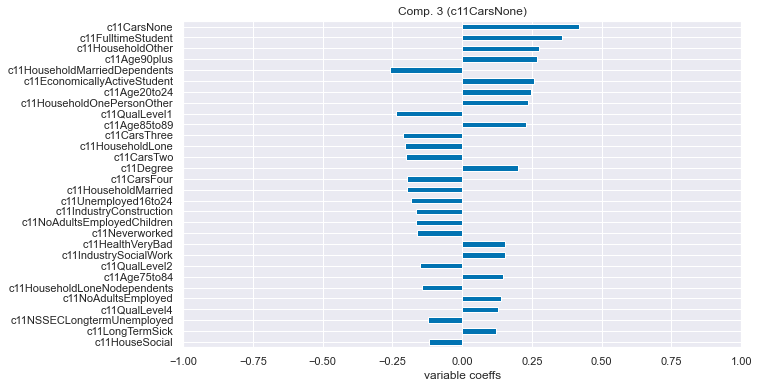

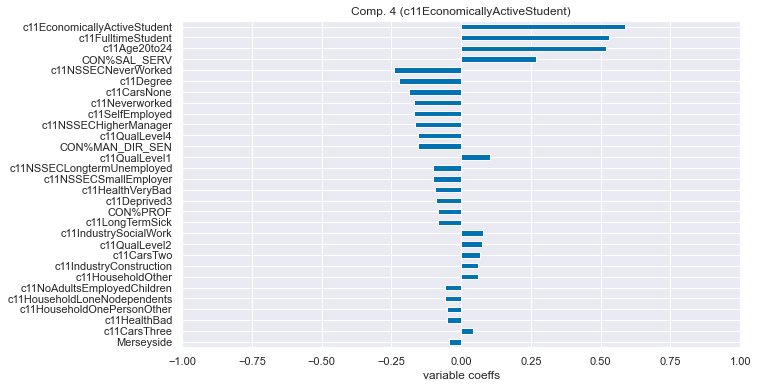

...

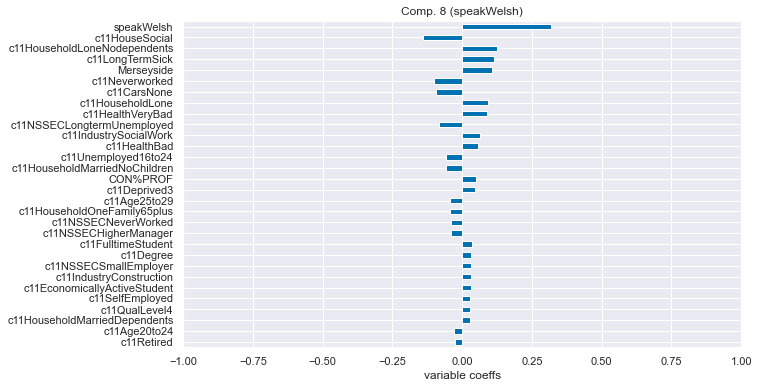

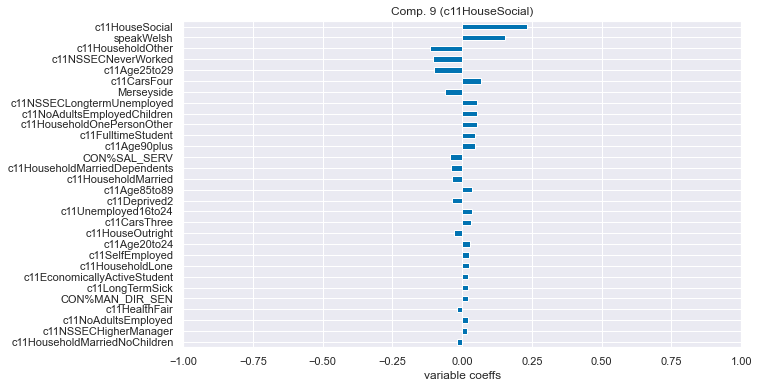

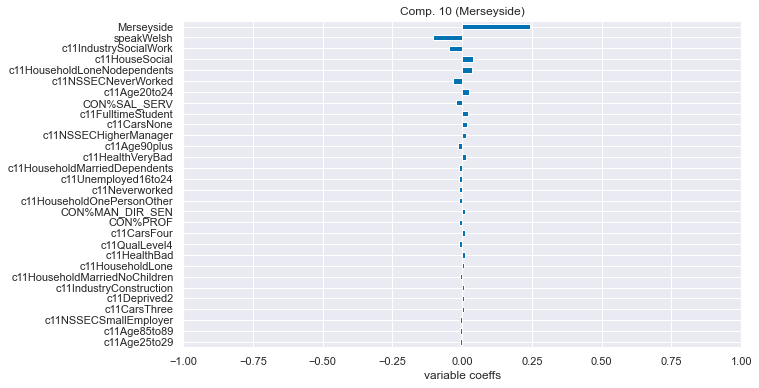

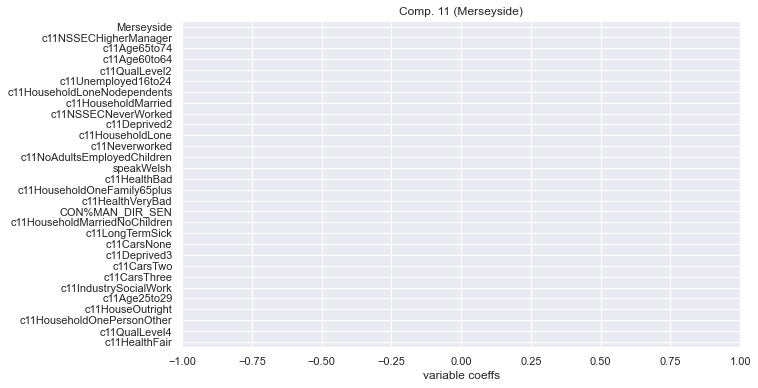

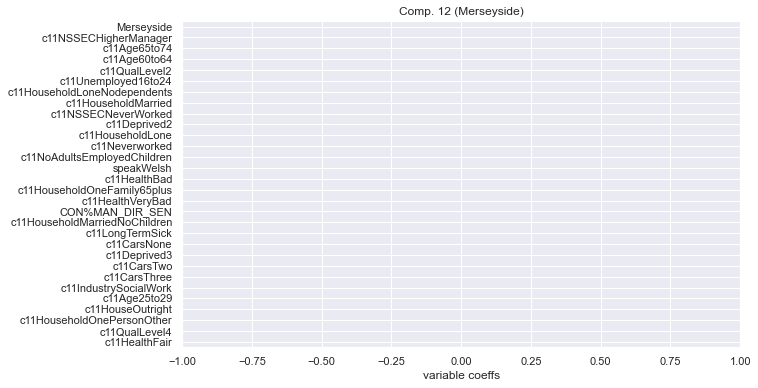

In [1314]:
(BES_decomp, comp_labels, comp_dict) = display_components(n_components, decomp,
                                                          decomp_columns, BES_decomp, manifest=None, 
                                                          save_folder = subdir,  
                                                          show_first_x_comps= 13, show_histogram = False)

In [1351]:
# comp_dict[0]["components_"]

In [1350]:
masked_df_simp[top_50].corrwith(masked_df_simp['Con17']).sort_values()

c11CarsNone                     -0.786595
c11Deprived3                    -0.786489
c11NoAdultsEmployedChildren     -0.725743
c11Neverworked                  -0.716643
c11NSSECNeverWorked             -0.708053
c11HouseholdLone                -0.675907
c11HouseSocial                  -0.673233
c11HouseholdOnePersonOther      -0.646477
c11NSSECLongtermUnemployed      -0.646110
c11LongTermSick                 -0.642037
c11Age25to29                    -0.630865
c11HouseholdLoneNodependents    -0.605209
c11HealthVeryBad                -0.598218
c11Deprived2                    -0.581708
c11HouseholdOther               -0.578925
c11Unemployed16to24             -0.578816
c11Age20to24                    -0.563867
c11FulltimeStudent              -0.526762
c11HealthBad                    -0.511277
CON%SAL_SERV                    -0.493668
c11EconomicallyActiveStudent    -0.493387
c11IndustrySocialWork           -0.341765
Merseyside                      -0.248511
c11NoAdultsEmployed             -0

In [1348]:
masked_df_simp[top_50].corrwith( masked_df_simp[top_50].apply(lambda x: comp_dict[0]["components_"].loc[x.name]*x).sum(axis=1) ).sort_values()

c11Age25to29                    -0.887423
c11CarsNone                     -0.821222
c11HouseholdOnePersonOther      -0.776585
c11HouseholdOther               -0.754930
c11HouseSocial                  -0.722102
c11NoAdultsEmployedChildren     -0.698074
c11Neverworked                  -0.669565
c11NSSECNeverWorked             -0.649596
c11NSSECLongtermUnemployed      -0.639742
c11Age20to24                    -0.639505
c11HouseholdLone                -0.626394
c11Deprived3                    -0.625127
c11EconomicallyActiveStudent    -0.555489
c11FulltimeStudent              -0.543825
c11Unemployed16to24             -0.481543
c11HouseholdLoneNodependents    -0.445800
CON%SAL_SERV                    -0.392622
c11Deprived2                    -0.353376
c11LongTermSick                 -0.293206
c11Degree                       -0.284275
c11HealthVeryBad                -0.201924
CON%PROF                        -0.111288
c11HealthBad                    -0.099461
c11QualLevel4                   -0

In [1346]:
BES_decomp.corrwith( masked_df_simp[top_50].apply(lambda x: comp_dict[0]["components_"].loc[x.name]*x).sum(axis=1) )

0     0.761910
1    -0.217533
2    -0.442476
3     0.052601
4    -0.093923
5     0.028844
6     0.168879
7     0.089225
8     0.212779
9     0.054068
10   -0.009799
11         NaN
12         NaN
13         NaN
14         NaN
15         NaN
16         NaN
17         NaN
18         NaN
19         NaN
20         NaN
21         NaN
22         NaN
23         NaN
24         NaN
25         NaN
26         NaN
27         NaN
28         NaN
29         NaN
30         NaN
31         NaN
32         NaN
33         NaN
34         NaN
35         NaN
36         NaN
37         NaN
38         NaN
39         NaN
40         NaN
41         NaN
42         NaN
43         NaN
44         NaN
45         NaN
46         NaN
47         NaN
48         NaN
49         NaN
dtype: float64

In [ ]:
## FA top50 0.824 cond 4.2
# 0--   Cars2/3/4,hhold1fam65+,hholdmarriednokids,HouseOutright,Age60-90+,Married,Retired,SmallEmployer
    # vs Cars0,NoAdultsEmployChildren,Deprived3,Neverworked,25-29,HouseSocial,LongtermUnemploy,hholdonepersonother
# 5+    hholdMarriedDep,CON%PROF,hholdMarried,HealthVeryBad,LongtermSick vs SmallEmployer,Qual1,SelfEmploy,indConstruct,age90+
# 7-    Neverworked,Longterm unemploy,unemp16-24 vs speakWelsh,hholdLoneNoDep,Merseyside,indConstruct
# 2+    age75-90+,noAdultsEmploy,indSocialWork,hholdOnePersonOth,CON%PROF,Qual4/degree vs hholdMarriedDep,Qual1/2,hholdMarried,
# 12+   CON%SAL_SERV,HouseSocial vs speakWelsh,Merseyside

# FA
# 0|1|6|2|11|4|10	0.814175	1.019248

# 0     1000 (60-74,hhold1fam65+,whitebrit,retired,homeown vs hholdOth,25-29,EnglishNone,popden+)
# 1      715 (deprived2,qualnone,healthbad/verybad,unemp16-24,longtermsick,routine vs lowermanager,higherprof,deprived0,higher manager,)
# 6      447 (passportUK,CON%ADMIN_SEC,north_west,female,merseyside,hholdLoneNoDependents vs deprived1, healthgood, agriculture, bornpost2004eu, CON%SKILL,CON%ELEM)
# 2      434 (hhold1person/allstudents,qual3,no religion,age 18-24 vs hholdmarrieddependents, age 0-17, transport, mortgage, housewife)
# 11     369 (no religion, passportEuropeNotEU, mixed asian, east of england vs northwest, accommodation, public administration, merseyside)
# 4      347 (hholdall65+,small employer,deprived1, age75-90+, self-employed vs hhold cohabit, employed full-time, economic active, no religion)

# PCA (much less clearly defined components)
# 0|1|2|4|6(+something else) 0.78	7.91604
# 0 hholdOther,ethnicityMixedOther,age25-29 vs ethnicityWhiteBritish,Retired
# 1 c11Deprived2,unemployed16-24 vs nssecLowerManager,deprivedNone,highermanager,Con%Man_Dir_Sen,higher prof
# 2 hholdOnePerson,hholdallStudent,quallevel3 vs age0-17,hholdmarrieddependents
# 4 EmployedFullTime, bornWales, Wales,pcppreace15_white vs HealthGood,England,Deprived1
# 6 hholdCohabit,hholdcohobitnochildren,Agricultrure vs Con%Admin_sec,passportUK,Merseyside,north_west,Female,hholdlonenodep,real estate



In [1279]:
# %%time
# # Authors: Alexandre Gramfort
# #          Denis A. Engemann
# # License: BSD 3 clause

# import numpy as np
# import matplotlib.pyplot as plt
# from scipy import linalg

# from sklearn.decomposition import PCA, FactorAnalysis
# from sklearn.covariance import ShrunkCovariance, LedoitWolf
# from sklearn.model_selection import cross_val_score
# from sklearn.model_selection import GridSearchCV

# print(__doc__)

# # #############################################################################
# # Create the data

# n_samples, n_features, rank = 1000, 20, 5
# sigma = 1.
# rng = np.random.RandomState(42)
# U, _, _ = linalg.svd(rng.randn(n_features, n_features))
# X = np.dot(rng.randn(n_samples, rank), U[:, :rank].T)

# # Adding homoscedastic noise
# X_homo = X + sigma * rng.randn(n_samples, n_features)

# # Adding heteroscedastic noise
# sigmas = sigma * rng.rand(n_features) + sigma / 2.
# X_hetero = X + rng.randn(n_samples, n_features) * sigmas

# # #############################################################################
# # Fit the models

# n_components = np.arange(0, n_features, 1)  # options for n_components


# def compute_scores(X):
#     pca = PCA(svd_solver='full')
#     fa = FactorAnalysis()

#     pca_scores, fa_scores = [], []
#     for n in n_components:
#         pca.n_components = n
#         fa.n_components = n
#         pca_scores.append(np.mean(cross_val_score(pca, X)))
#         fa_scores.append(np.mean(cross_val_score(fa, X)))

#     return pca_scores, fa_scores


# def shrunk_cov_score(X):
#     shrinkages = np.logspace(-2, 0, 30)
#     cv = GridSearchCV(ShrunkCovariance(), {'shrinkage': shrinkages})
#     return np.mean(cross_val_score(cv.fit(X).best_estimator_, X))


# def lw_score(X):
#     return np.mean(cross_val_score(LedoitWolf(), X))


# # decomp_index = MCP_vals.index
# # decomp_columns = MCP_vals.columns
# # clean_feature_set_std = StandardScaler().fit_transform(MCP_vals.values )
# # decomp_std = pd.DataFrame(   clean_feature_set_std,
# #                              columns = MCP_vals.columns,
# #                              index   = MCP_vals.index      )

# decomp_index = masked_df_simp.index
# decomp_columns = top_50
# clean_feature_set_std = StandardScaler().fit_transform(masked_df_simp[top_50].values )
# decomp_std = pd.DataFrame(   clean_feature_set_std,
#                              columns = decomp_columns,
#                              index   = decomp_index      )


# for X, title in [(X_homo, 'Homoscedastic Noise'),
#                  (X_hetero, 'Heteroscedastic Noise'),
#                  (decomp_std.values, 'Manifesto Project')]:
#     pca_scores, fa_scores = compute_scores(X)
#     n_components_pca = n_components[np.argmax(pca_scores)]
#     n_components_fa = n_components[np.argmax(fa_scores)]

#     pca = PCA(svd_solver='full', n_components='mle')
#     pca.fit(X)
#     n_components_pca_mle = pca.n_components_

#     print("best n_components by PCA CV = %d" % n_components_pca)
#     print("best n_components by FactorAnalysis CV = %d" % n_components_fa)
#     print("best n_components by PCA MLE = %d" % n_components_pca_mle)

#     plt.figure()
#     plt.plot(n_components, pca_scores, 'b', label='PCA scores')
#     plt.plot(n_components, fa_scores, 'r', label='FA scores')
#     if title in [ 'Homoscedastic Noise','Heteroscedastic Noise']:
#         plt.axvline(rank, color='g', label='TRUTH: %d' % rank, linestyle='-')
#     plt.axvline(n_components_pca, color='b',
#                 label='PCA CV: %d' % n_components_pca, linestyle='--')
#     plt.axvline(n_components_fa, color='r',
#                 label='FactorAnalysis CV: %d' % n_components_fa,
#                 linestyle='--')
#     if title in [ 'Homoscedastic Noise','Heteroscedastic Noise']:    
#         plt.axvline(n_components_pca_mle, color='k',
#                 label='PCA MLE: %d' % n_components_pca_mle, linestyle='--')

#     # compare with other covariance estimators
#     plt.axhline(shrunk_cov_score(X), color='violet',
#                 label='Shrunk Covariance MLE', linestyle='-.')
#     plt.axhline(lw_score(X), color='orange',
#                 label='LedoitWolf MLE' % n_components_pca_mle, linestyle='-.')

#     plt.xlabel('nb of components')
#     plt.ylabel('CV scores')
#     plt.legend(loc='lower right')
#     plt.title(title)

# plt.show()

In [1318]:
# dataset = merged[merged["Country"].isin(["England","Wales"])]

# [0,1,2,3,4,5,6,9,10,11,12,13,14,15]

Y = masked_df_simp['Con17']
X = BES_decomp.loc[:,0:6]
# [0, 2, 5, 7]
# [0, 1, 2, 5, 7, 8, 9, 10, 11, 12]
# 
# 3, 4, 6,
X = sm.add_constant(X)
model = sm.OLS(Y,X)
results = model.fit()
results.params
#  merged["Con17"]
results.summary()

# 0     495
# 5     330
# 7     246
# 2     243

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  Con17   R-squared:                       0.860
Model:                            OLS   Adj. R-squared:                  0.859
Method:                 Least Squares   F-statistic:                     497.6
Date:                Fri, 21 Jan 2022   Prob (F-statistic):          7.08e-237
Time:                        19:36:18   Log-Likelihood:                -1798.3
No. Observations:                 573   AIC:                             3613.
Df Residuals:                     565   BIC:                             3647.
Df Model:                           7                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         48.4888      0.246    196.998      0.000      48.005      48.972
0            363.7985      6.978     52.135      0.000     350.092     377.505
1           -170.4236      9.922    -17.176      0.000    -189.912    -150.935
2             -7.8651      9.086     -0.866      0.387     -25.711       9.981
3            -85.4199     11.301     -7.559      0.000    -107.617     -63.223
4              6.3631      8.981      0.708      0.479     -11.277      24.003
5             42.1331     10.569      3.987      0.000      21.375      62.891
6            -65.9976     12.504     -5.278      0.000     -90.558     -41.437
==============================================================================
Omnibus:                       31.517   Durbin-Watson:                   1.676
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               84.238
Skew:                           0.214   Prob(JB):                     5.10e-19
Kurtosis:                       4.829   Cond. No.                         56.6
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

In [1214]:
%%time
### try to find any subtle combos
masked_df_simp = df_simp[mask].copy()
Y = masked_df_simp[var_stub]
BES_decomp["const"]=1.0
res_store_fa_top50 = pd.DataFrame(columns = ["r2","cond"])

for spec_vars in list(combinations([0, 1, 2, 3,4,5,6, 7, 8, 9, 10, 11, 12],6)):

    model = sm.OLS(Y,BES_decomp[list(spec_vars)+["const"]])
    results = model.fit()
    res_store_fa_top50.loc["|".join(map(str,spec_vars))] = [results.rsquared,results.condition_number]

Wall time: 4.12 s


In [1215]:
res_store_fa_top50.sort_values(by="r2",ascending=False).head(10)

# FA top50
# 0|1|2|5|7|8	0.838494	1.331386
# 0|1|2|5|7|10	0.835677	1.772233
# 0|1|2|5|7|9	0.834081	1.607716
# 0|2|5|7|8|10	0.833752	1.772233
# 0|1|2|5|7|11	0.833416	1.957880
# 0|1|2|5|7|12	0.833133	4.299846
# 0|2|5|7|8|9	0.832156	1.607716
# 0|2|5|7|8|11	0.831491	1.957880
# 0|1|2|3|5|7	0.831441	1.258016
# 0|1|2|4|5|7	0.831399	1.258016

## FA
# 0|1|6|2|11|4|10	0.814175	1.019248
# 0|1|6|2|11|4|13	0.811107	1.024425
# 0|1|6|2|11|10|13	0.807599	1.024425
# 0|1|6|2|11|4|3	0.807595	1.019248
# 0|1|6|2|11|4|12	0.807056	1.022596
# 0|1|6|2|11|10|3	0.804087	1.019248
# 0|1|6|2|4|10|13	0.803834	1.024425
# 0|1|6|2|11|10|12	0.803548	1.022596
# 0|1|6|2|11|4|9	0.802970	1.019248
# 0|1|6|2|11|13|3	0.801019	1.024425

## PCA
# 0|1|2|4|5|6	0.789751	7.91604
# 0|1|2|4|6|15	0.783269	7.91604
# 0|1|2|4|6|7	0.780052	7.91604
# 0|1|2|4|6|13	0.779894	7.91604
# 0|1|2|4|6|10	0.779232	7.91604
# 0|1|2|4|6|16	0.778423	7.91604
# 0|1|2|4|6|12	0.776875	7.91604
# 0|1|2|4|6|9	0.776246	7.91604
# 0|1|2|4|6|11	0.775763	7.91604
# 0|1|2|4|6|8	0.775580	7.91604

,r2,cond
0|1|2|5|7|8,0.838494,1.331386
0|1|2|5|7|10,0.835677,1.772233
0|1|2|5|7|9,0.834081,1.607716
0|2|5|7|8|10,0.833752,1.772233
0|1|2|5|7|11,0.833416,1.957880
0|1|2|5|7|12,0.833133,4.299846
0|2|5|7|8|9,0.832156,1.607716
0|2|5|7|8|11,0.831491,1.957880
0|1|2|3|5|7,0.831441,1.258016
0|1|2|4|5|7,0.831399,1.258016


In [1236]:
# pd.DataFrame([x.split("|") for x in res_store_fa_top50[res_store_fa_top50["r2"]>.75].index]).stack().value_counts()
# res_store_fa_top50["r2"].hist(bins=100)
# res_store_fa_top50[res_store_fa_top50["r2"]>.6]

In [1591]:
search(merged,'FA')

c11HouseholdOneFamily             632
c11HouseholdOneFamily65plus       632
c11IndustryManufacturing          632
c11HealthFair                     632
Con17_FA_top50_xgb                632
Con17_FA_top50_xgb_und            573
Con17_FA_top50_sm                 573
Con17_FA_top50_sm_und             573
FA_0                              573
FA_1                              573
FA_2                              573
FA_3                              573
FA_4                              573
FA_5                              573
FA_6                              573
FA_7                              573
FA_8                              573
FA_9                              573
FA_10                             573
FA_11                             573
FA_12                             573
Con17_FA_top50_aligned_xgb        632
Con17_FA_top50_aligned_xgb_und    573
Con17_FA_top50_aligned_sm         573
Con17_FA_top50_aligned_sm_und     573
dtype: int64

In [1250]:
df_simp[["FA_"+str(x) for x in BES_decomp.loc[:,0:12].columns]] = np.nan
df_simp.loc[mask,["FA_"+str(x) for x in BES_decomp.loc[:,0:12].columns]] = BES_decomp.loc[:,0:12].values

In [ ]:
#### Now look at FA_top50 breakdown

In [1261]:
merged[["FA_"+str(x) for x in BES_decomp.loc[:,0:12].columns]] = np.nan
ons_ids = BES_census_data.loc[df_simp.index,"ONSConstID"]
merged.loc[ons_ids[mask],["FA_"+str(x) for x in BES_decomp.loc[:,0:12].columns]] = BES_decomp.loc[:,0:12].values


MSE: 35.33, MAE: 4.62, EV: 0.84, R2: 0.84


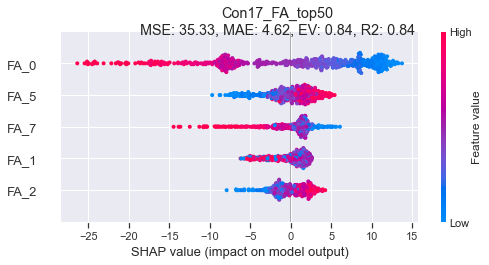

<Figure size 1152x720 with 0 Axes>

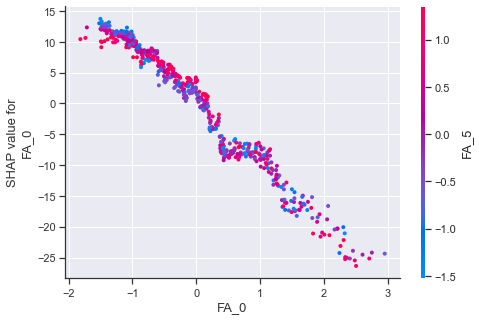

<Figure size 1152x720 with 0 Axes>

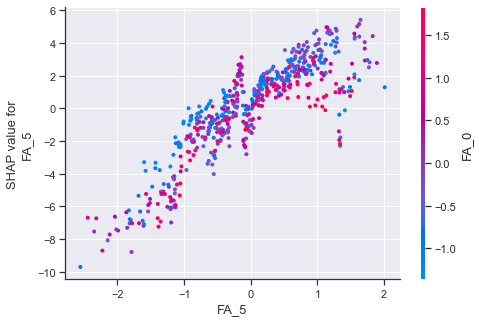

<Figure size 1152x720 with 0 Axes>

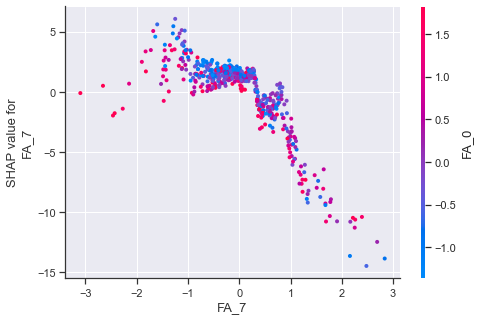

<Figure size 1152x720 with 0 Axes>

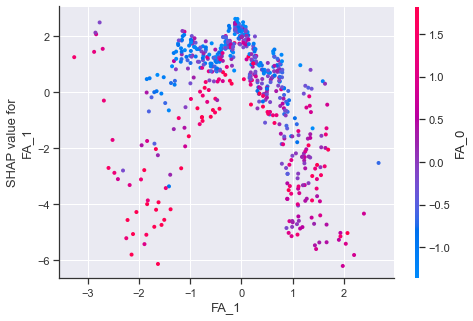

<Figure size 1152x720 with 0 Axes>

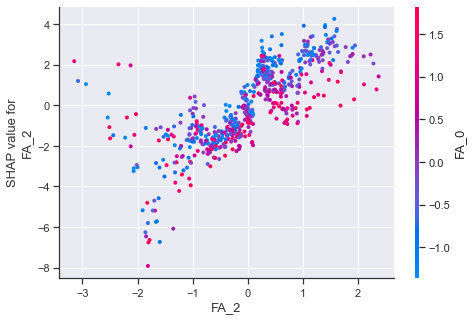

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  Con17   R-squared:                       0.831
Model:                            OLS   Adj. R-squared:                  0.829
Method:                 Least Squares   F-statistic:                     554.9
Date:                Sun, 23 Jan 2022   Prob (F-statistic):          1.77e-215
Time:                        16:32:41   Log-Likelihood:                -1850.2
No. Observations:                 572   AIC:                             3712.
Df Residuals:                     566   BIC:                             3738.
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         44.1341      0.258    170.863      0.000      43.627      44.641
FA_0         -12.5687      0.260    -48.422      0.000     -13.079     -12.059
FA_1          -1.4475      0.260     -5.561      0.000      -1.959      -0.936
FA_2           2.7703      0.266     10.402      0.000       2.247       3.293
FA_5           3.9343      0.292     13.477      0.000       3.361       4.508
FA_7          -3.3943      0.325    -10.455      0.000      -4.032      -2.757
==============================================================================
Omnibus:                       10.835   Durbin-Watson:                   1.733
Prob(Omnibus):                  0.004   Jarque-Bera (JB):               12.442
Skew:                          -0.245   Prob(JB):                      0.00199
Kurtosis:                       3.532   Cond. No.                         1.26
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

!!!!!!!!!!!!!!!!!!!!!!
Con17_FA_top50_xgb_und Con17_FA_top50_sm_und Con17_FA_top50


()

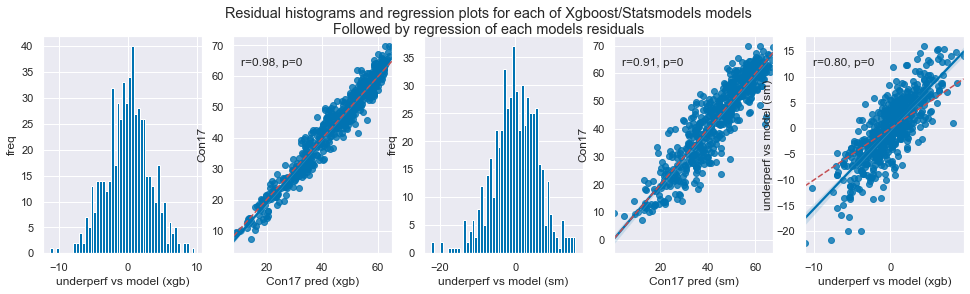

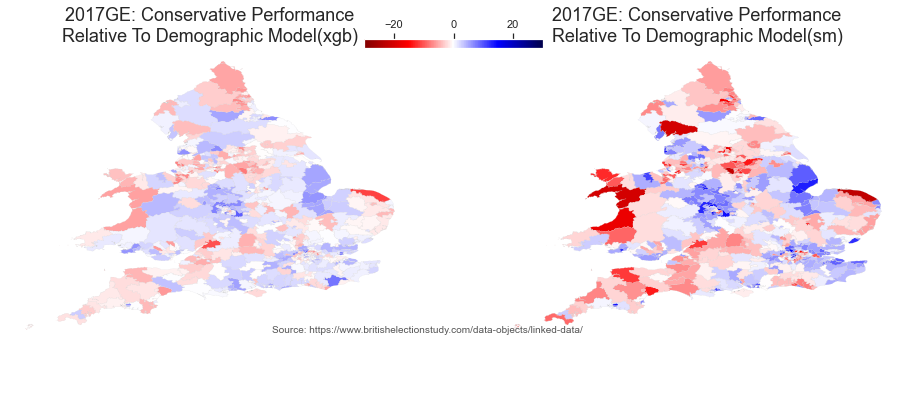

In [1590]:
var_stub = "Con17"
title = "Con17_FA_top50"
specific_vars = [
    'FA_0',
 'FA_1',
 'FA_2',
#  'FA_3',
#  'FA_4',
 'FA_5',
#  'FA_6',
 'FA_7',
#  'FA_8',
#  'FA_9',
#  'FA_10',
#  'FA_11',
#  'FA_12'
                ]
geomask = (BES_census_data["Country"]!="Scotland")&(BES_census_data["Winner17"]!="Speaker")

sm_and_xgb_plot(var_stub,title,specific_vars,geomask)

MSE: 20.48, MAE: 3.65, EV: 0.91, R2: 0.91


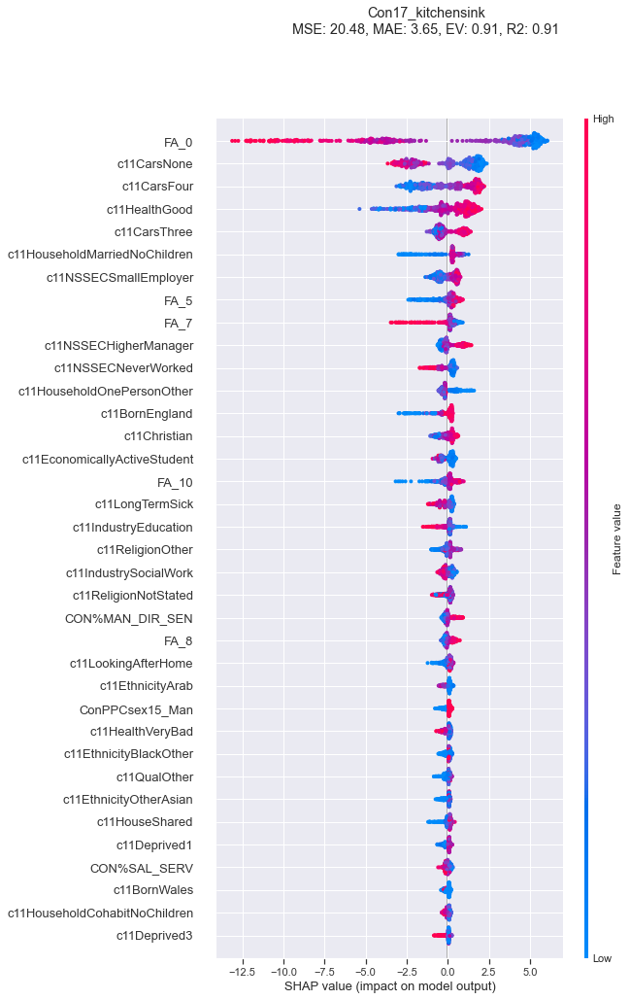

<Figure size 1152x720 with 0 Axes>

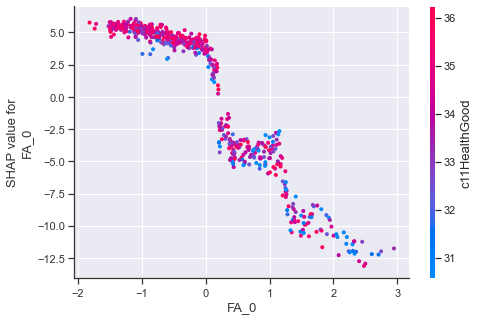

<Figure size 1152x720 with 0 Axes>

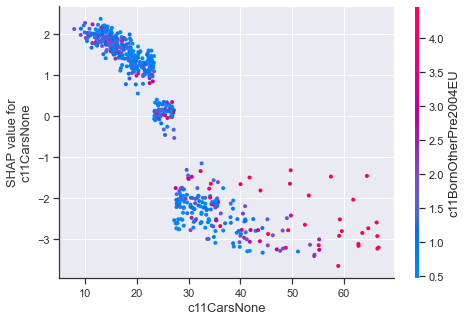

<Figure size 1152x720 with 0 Axes>

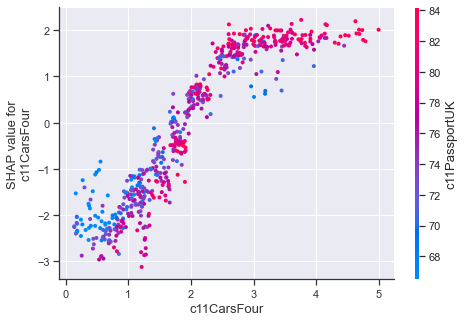

<Figure size 1152x720 with 0 Axes>

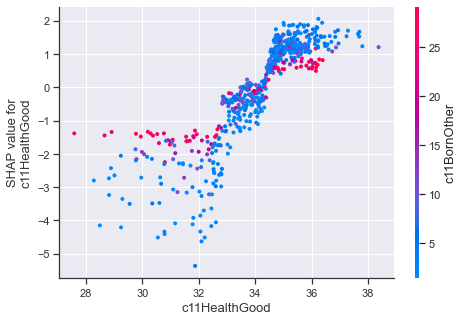

<Figure size 1152x720 with 0 Axes>

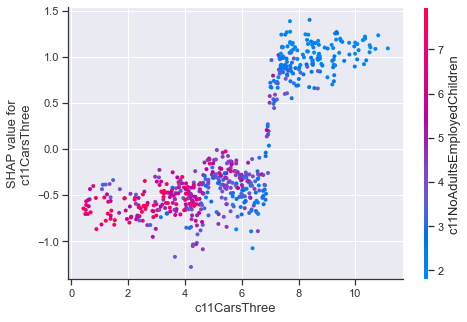

<Figure size 1152x720 with 0 Axes>

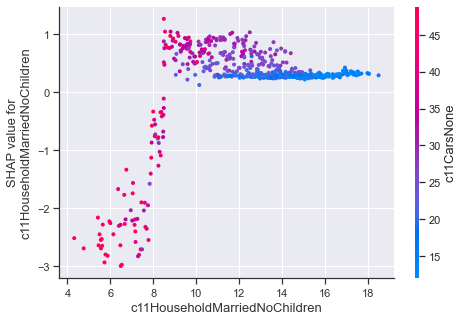

<Figure size 1152x720 with 0 Axes>

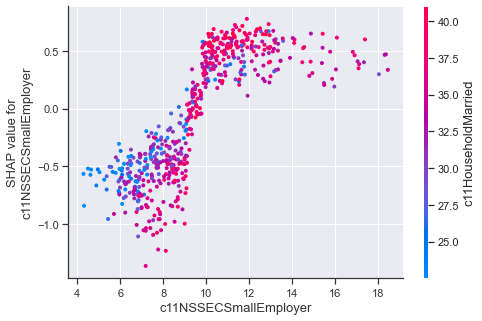

<Figure size 1152x720 with 0 Axes>

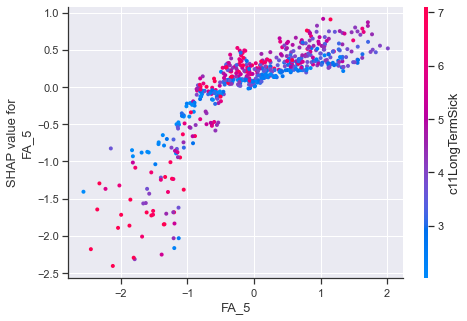

<Figure size 1152x720 with 0 Axes>

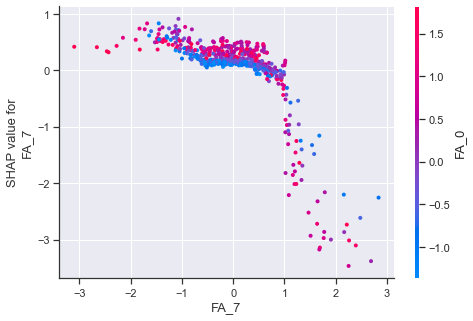

<Figure size 1152x720 with 0 Axes>

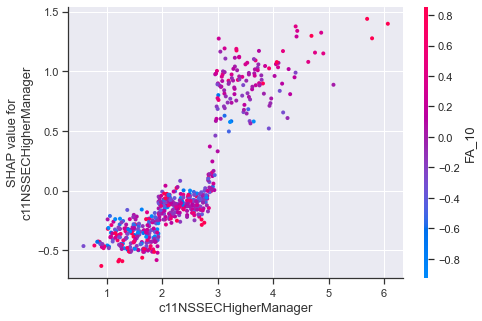

<Figure size 1152x720 with 0 Axes>

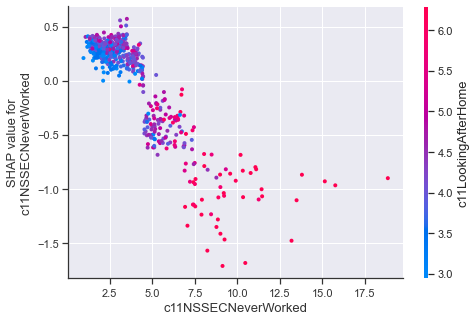

<Figure size 1152x720 with 0 Axes>

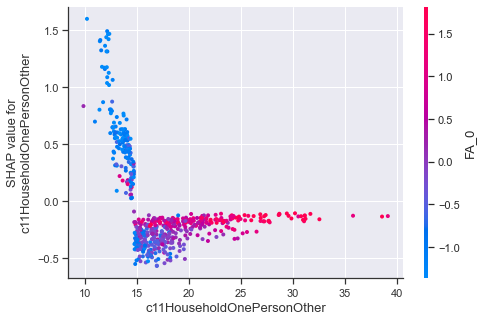

<Figure size 1152x720 with 0 Axes>

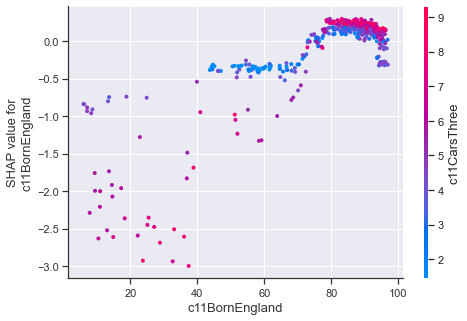

<Figure size 1152x720 with 0 Axes>

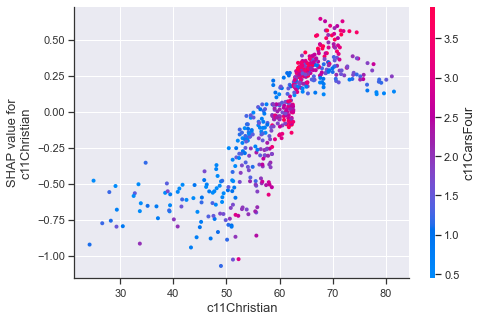

<Figure size 1152x720 with 0 Axes>

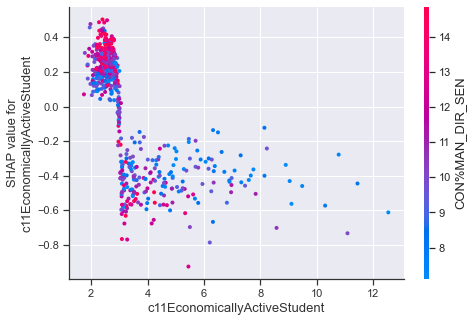

<Figure size 1152x720 with 0 Axes>

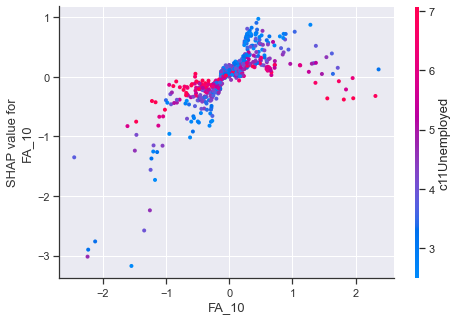

<Figure size 1152x720 with 0 Axes>

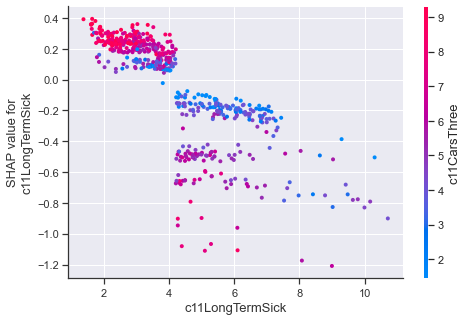

<Figure size 1152x720 with 0 Axes>

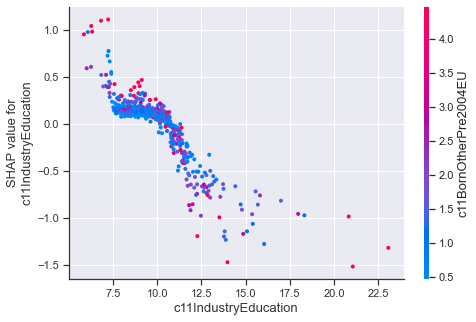

<Figure size 1152x720 with 0 Axes>

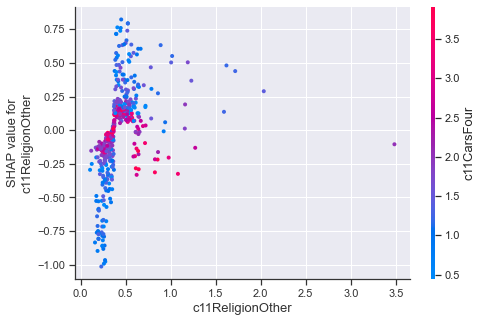

<Figure size 1152x720 with 0 Axes>

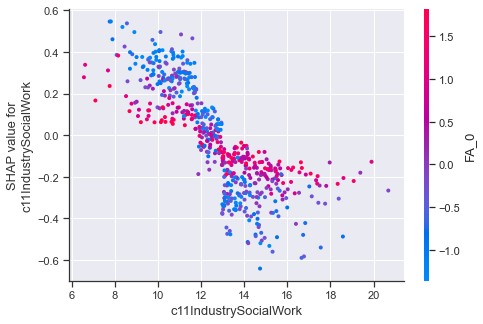

<Figure size 1152x720 with 0 Axes>

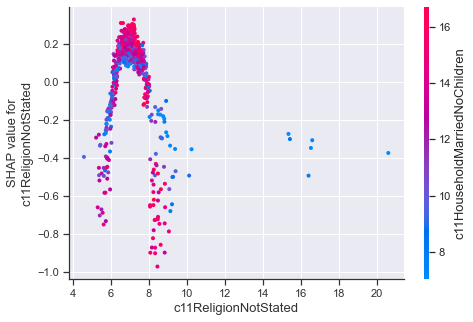

<Figure size 1152x720 with 0 Axes>

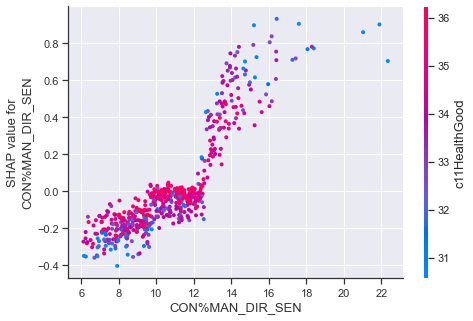

<Figure size 1152x720 with 0 Axes>

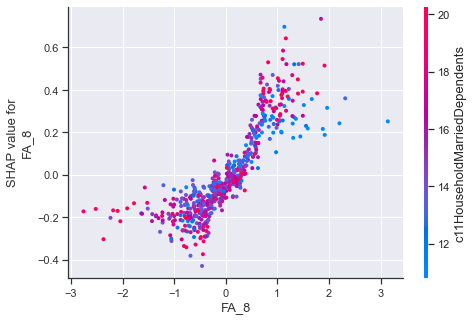

<Figure size 1152x720 with 0 Axes>

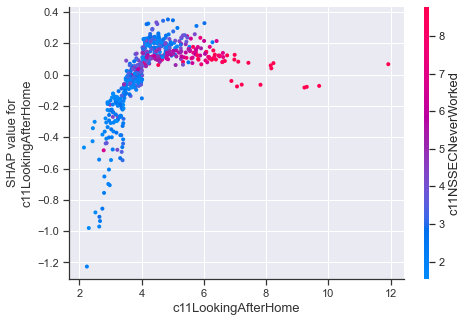

<Figure size 1152x720 with 0 Axes>

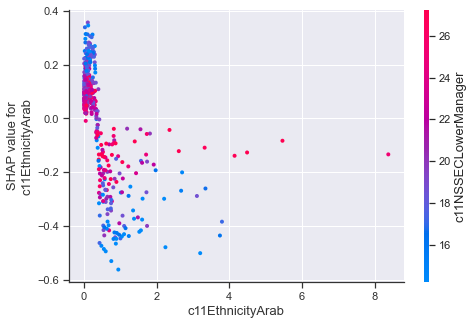

<Figure size 1152x720 with 0 Axes>

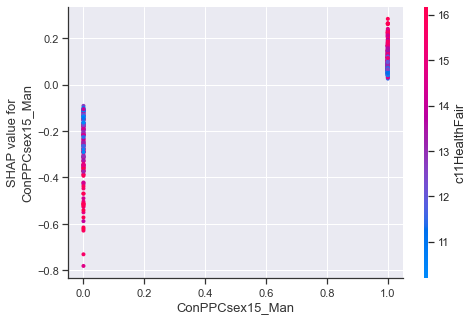

<Figure size 1152x720 with 0 Axes>

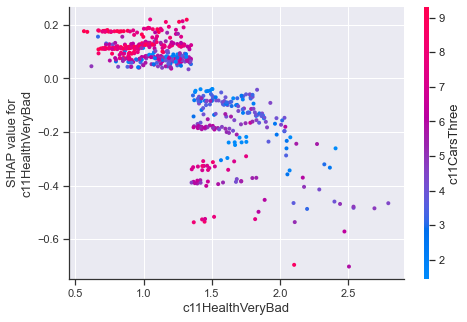

<Figure size 1152x720 with 0 Axes>

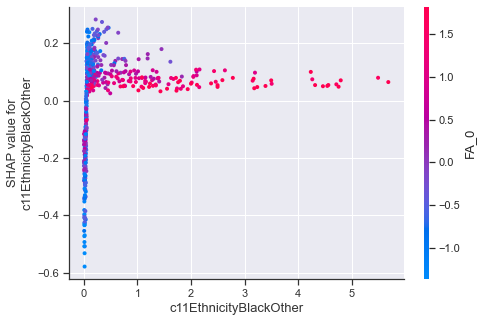

<Figure size 1152x720 with 0 Axes>

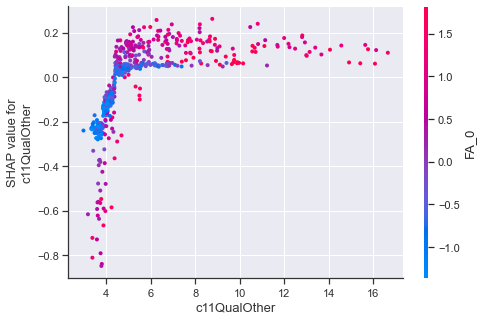

<Figure size 1152x720 with 0 Axes>

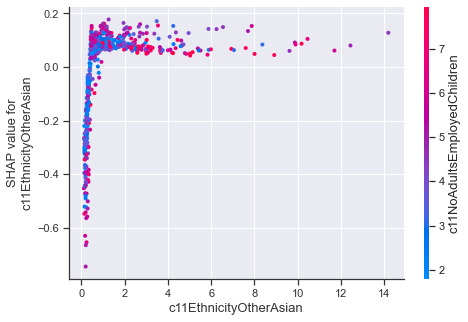

<Figure size 1152x720 with 0 Axes>

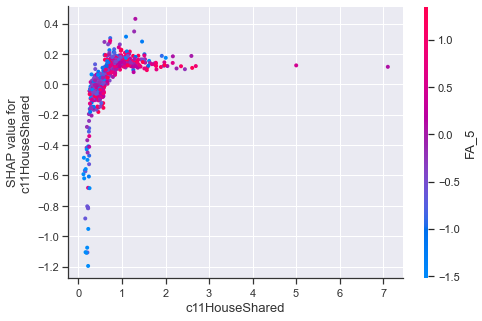

<Figure size 1152x720 with 0 Axes>

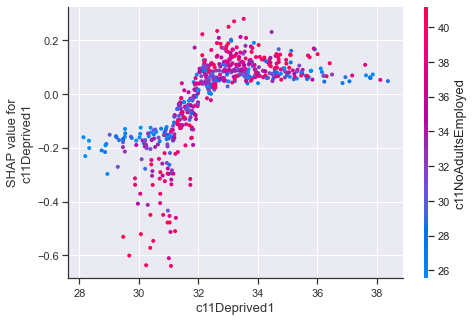

<Figure size 1152x720 with 0 Axes>

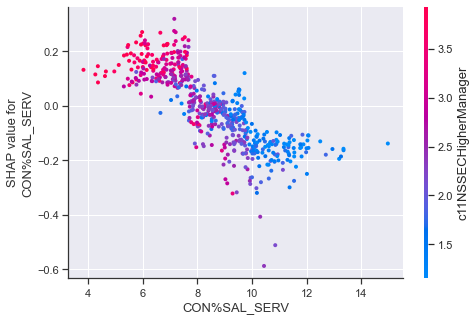

<Figure size 1152x720 with 0 Axes>

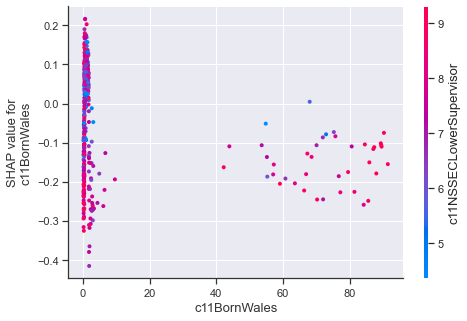

<Figure size 1152x720 with 0 Axes>

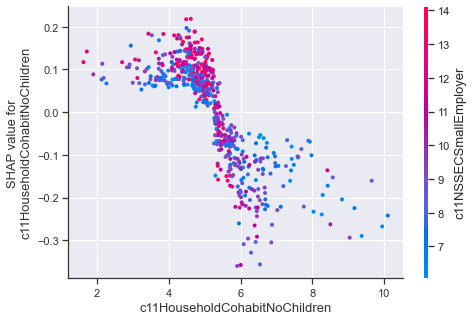

<Figure size 1152x720 with 0 Axes>

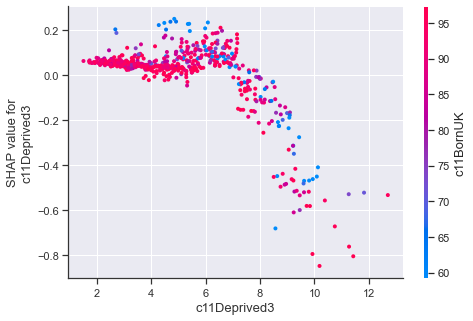

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                  Con17   R-squared:                       0.962
Model:                            OLS   Adj. R-squared:                  0.941
Method:                 Least Squares   F-statistic:                     46.62
Date:                Sat, 22 Jan 2022   Prob (F-statistic):          3.66e-187
Time:                        15:59:13   Log-Likelihood:                -1428.3
No. Observations:                 573   AIC:                             3259.
Df Residuals:                     372   BIC:                             4133.
Df Model:                         200                                         
Covariance Type:            nonrobust                                         
====================================================================================================
                                       coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------------------
const                                0.0162      0.008      2.078      0.038       0.001       0.031
RejectedVote17                       0.0146      0.008      1.783      0.075      -0.002       0.031
RejectedVote15                      -0.0001      0.005     -0.020      0.984      -0.010       0.010
c11Population                    -4.099e-05   3.17e-05     -1.293      0.197      -0.000    2.13e-05
c11PopulationDensity                 0.0103      0.028      0.363      0.717      -0.046       0.066
c11Male                              0.5443      0.450      1.209      0.228      -0.341       1.430
c11Female                            1.0739      0.543      1.977      0.049       0.006       2.142
c11Households                        1.1895      0.430      2.767      0.006       0.344       2.035
c11Communal                          0.4288      0.491      0.873      0.383      -0.536       1.394
c11Age0to4                          -0.2008      1.269     -0.158      0.874      -2.695       2.294
c11Age5to7                           3.0958      2.532      1.222      0.222      -1.884       8.075
c11Age8to9                           4.0689      3.326      1.223      0.222      -2.472      10.610
c11Age10to14                         2.6152      1.814      1.441      0.150      -0.952       6.183
c11Age15                            -4.5589      3.950     -1.154      0.249     -12.326       3.209
c11Age16to17                         0.6952      2.271      0.306      0.760      -3.769       5.160
c11Age18to19                         0.4383      1.166      0.376      0.707      -1.854       2.730
c11Age20to24                         0.4458      0.893      0.499      0.618      -1.309       2.201
c11Age25to29                         1.1497      0.881      1.305      0.193      -0.582       2.882
c11Age30to44                        -0.7680      0.708     -1.084      0.279      -2.161       0.625
c11Age45to59                        -0.6596      0.763     -0.865      0.388      -2.159       0.840
c11Age60to64                        -0.1957      1.291     -0.152      0.880      -2.734       2.343
c11Age65to74                        -2.9070      1.594     -1.823      0.069      -6.042       0.228
c11Age75to84                        -0.1540      1.436     -0.107      0.915      -2.978       2.670
c11Age85to89                        -0.2035      3.304     -0.062      0.951      -6.699       6.292
c11Age90plus                        -1.2430      2.463     -0.505      0.614      -6.087       3.601
c11HouseOwned                        0.2743      0.227      1.211      0.227      -0.171       0.720
c11HouseOutright                     0.3206      0.211      1.517      0.130      -0.095       0.736
c11HouseMortgage                    -0.0463      0.17

()

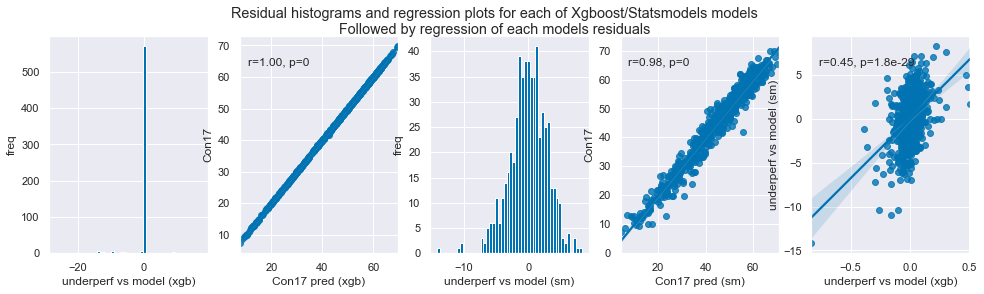

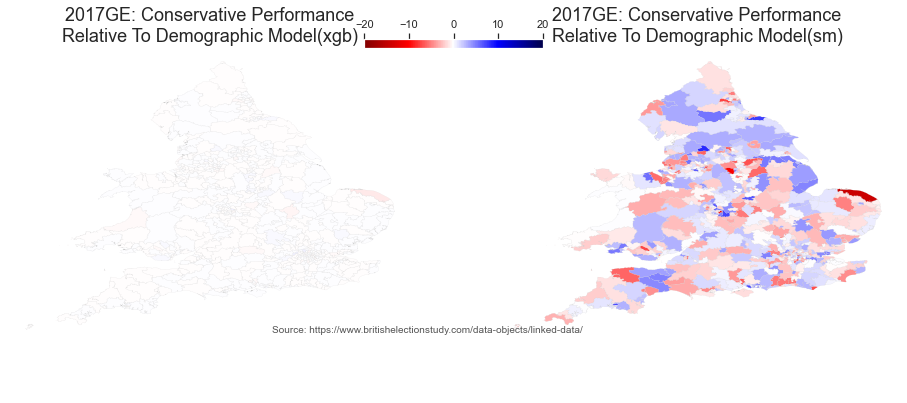

In [1439]:
var_stub = "Con17"
title = "Con17_kitchensink"
specific_vars = list(df_simp.drop(["Con17","remainHanretty","leaveHanretty"],axis=1).columns)
geomask = (BES_census_data["Country"]!="Scotland")&(BES_census_data["Winner17"]!="Speaker")

sm_and_xgb_plot(var_stub,title,specific_vars,geomask)

In [1436]:
# df_simp.drop(search(df_simp,"FA_aligned").index,axis=1,inplace=True)
# merged.drop(search(merged,"FA_aligned").index,axis=1,inplace=True)

In [1450]:
BES_census_data_2015 = pd.read_stata( BES_small_data_files + "BES-2015-General-Election-results-file-v2.21.dta" )
print("BES_census_data 2015", BES_census_data_2015.shape )

BES_census_data 2015 (632, 277)


In [1451]:
BES_census_data_2019 = pd.read_stata( BES_small_data_files + "BES-2019-General-Election-results-file-v1.0.dta" )
print("BES_census_data 2019", BES_census_data_2019.shape )

BES_census_data 2019 (632, 385)


In [1453]:
BES_census_data.shape

(632, 319)

In [1454]:
[x for x in BES_census_data.columns if x not in BES_census_data_2015.columns]
# in 2017 but not in 2015:
# blah17 variables, XHanretty

# also 
#  'ConPPC15',
#  'ConPPCsex15',
#  'ConPPCrace15',
#  'LabPPC15',
#  'LabPPCsex15',
#  'LabPPCrace15',
#  'LDPPC15',
#  'LDPPCsex15',
#  'LDPPCrace15',
#  'SNPPPC15',
#  'SNPPPCsex15',
#  'SNPPPCrace15',
#  'PCPPC15',
#  'PCPPCsex15',
#  'PCPPCrace15',
#  'UKIPPPC15',
#  'UKIPPPCsex15',
#  'UKIPPPCrace15',
#  'GreenPPC15',
#  'GreenPPCsex15',
#  'GreenPPCrace15',
# in 2015 but not in 2017:
# --> 
# 'ConPPC',
#  'ConPPCsex',
#  'ConPPCrace',
#  'LabPPC',
#  'LabPPCsex',
#  'LabPPCrace',
#  'ldppc',
#  'LDPPCsex',
#  'LDPPCrace',
#  'ukipppc',
#  'UKIPPPCsex',
#  'UKIPPPCrace',
#  'snpppc',
#  'SNPPPCsex',
#  'SNPPPCrace',
#  'pcppc',
#  'PCPPCsex',
#  'PCPPCrace',
#  'GreenPPC',
#  'GreenPPCsex',
#  'GreenPPCrace',

##### party spending variables!
#  'ConLongSpendPercent',
#  'ConShortSpendPercent',
#  'LabLongSpendPercent',
#  'LabShortSpendPercent',
#  'LDLongSpendPercent',
#  'LDShortSpendPercent',
#  'SNPLongSpendPercent',
#  'SNPShortSpendPercent',
#  'PCLongSpendPercent',
#  'PCShortSpendPercent',
#  'UKIPLongSpendPercent',
#  'UKIPShortSpendPercent',
#  'GreenLongSpendPercent',
#  'GreenShortSpendPercent'

['Winner17',
 'Con17',
 'Lab17',
 'LD17',
 'SNP17',
 'PC17',
 'UKIP17',
 'Green17',
 'Other17',
 'Majority17',
 'Turnout17',
 'ConVote17',
 'LabVote17',
 'LDVote17',
 'SNPVote17',
 'PCVote17',
 'UKIPVote17',
 'GreenVote17',
 'TotalVote17',
 'RejectedVote17',
 'Electorate17',
 'SeatChange1517',
 'Con1517',
 'Lab1517',
 'LD1517',
 'SNP1517',
 'PC1517',
 'UKIP1517',
 'Green1517',
 'leaveHanretty',
 'remainHanretty',
 'ConPPC17',
 'ConPPCsex17',
 'LabPPC17',
 'LabPPCsex17',
 'LDPPC17',
 'LDPPCsex17',
 'SNPPPC17',
 'SNPPPCsex17',
 'PCPPC17',
 'PCPPCsex17',
 'UKIPPPC17',
 'UKIPPPCsex17',
 'GreenPPC17',
 'GreenPPCsex17',
 'ConPPC15',
 'ConPPCsex15',
 'ConPPCrace15',
 'LabPPC15',
 'LabPPCsex15',
 'LabPPCrace15',
 'LDPPC15',
 'LDPPCsex15',
 'LDPPCrace15',
 'SNPPPC15',
 'SNPPPCsex15',
 'SNPPPCrace15',
 'PCPPC15',
 'PCPPCsex15',
 'PCPPCrace15',
 'UKIPPPC15',
 'UKIPPPCsex15',
 'UKIPPPCrace15',
 'GreenPPC15',
 'GreenPPCsex15',
 'GreenPPCrace15',
 'speakWelsh',
 'CON%ELEM',
 'CON%OPS',
 'CON%SAL_SER

In [1457]:
[x for x in BES_census_data_2019.columns if x not in BES_census_data.columns]
# blah19 variables

# 'Turnout10', ['Turn10', in 2017]

#  'Con0510',
#  'Lab0510',
#  'LD0510',
#  'SNP0510',
#  'PC0510',
#  'BNP0510',
#  'UKIP0510',
#  'Green0510',
#  'Winner05',
#  'Con05',
#  'Lab05',
#  'LD05',
#  'SNP05',
#  'PC05',
#  'UKIP05',
#  'Green05',
#  'BNP05',
#  'Other05',
#  'Majority05',
#  'Turnout05',
#  'ConVote05',
#  'LabVote05',
#  'LDVote05',
#  'SNPVote05',
#  'PCVote05',
#  'UKIPVote05',
#  'GreenVote05',
#  'BNPVote05',
#  'TotalVote05',
#  'Electorate05',

['Winner19',
 'Con19',
 'Lab19',
 'LD19',
 'SNP19',
 'PC19',
 'UKIP19',
 'Green19',
 'Brexit19',
 'Other19',
 'Majority19',
 'Turnout19',
 'ConVote19',
 'LabVote19',
 'LDVote19',
 'SNPVote19',
 'PCVote19',
 'UKIPVote19',
 'GreenVote19',
 'BrexitVote19',
 'TotalVote19',
 'RejectedVote19',
 'Electorate19',
 'SeatChange1719',
 'Con1719',
 'Lab1719',
 'LD1719',
 'SNP1719',
 'PC1719',
 'UKIP1719',
 'Green1719',
 'Turnout10',
 'Con0510',
 'Lab0510',
 'LD0510',
 'SNP0510',
 'PC0510',
 'BNP0510',
 'UKIP0510',
 'Green0510',
 'Winner05',
 'Con05',
 'Lab05',
 'LD05',
 'SNP05',
 'PC05',
 'UKIP05',
 'Green05',
 'BNP05',
 'Other05',
 'Majority05',
 'Turnout05',
 'ConVote05',
 'LabVote05',
 'LDVote05',
 'SNPVote05',
 'PCVote05',
 'UKIPVote05',
 'GreenVote05',
 'BNPVote05',
 'TotalVote05',
 'Electorate05',
 'ConPPC19',
 'ConPPCsex19',
 'LabPPC19',
 'LabPPCsex19',
 'LDPPC19',
 'LDPPCsex19',
 'SNPPPC19',
 'SNPPPCsex19',
 'PCPPC19',
 'PCPPCsex19',
 'UKIPPPC19',
 'UKIPPPCsex19',
 'GreenPPC19',
 'GreenPPCs

In [1458]:
[x for x in BES_census_data.columns if x not in BES_census_data_2019.columns]

['Turn10',
 'speakWelsh',
 'CON%ELEM',
 'CON%OPS',
 'CON%SAL_SERV',
 'CON%CAR_LEI_',
 'CON%SKILL',
 'CON%ADMIN_SEC',
 'CON%ASSOC_PROF_TECH',
 'CON%PROF',
 'CON%MAN_DIR_SEN',
 'Merseyside']

In [1471]:
shared_variables = set(BES_census_data_2015.columns).intersection(set(BES_census_data_2019.columns)).intersection(set(BES_census_data.columns))

In [1511]:
# (BES_census_data[shared_variables].astype('object').fillna(0)!=BES_census_data_2019[shared_variables].astype('object').fillna(0)).sum().sort_values().tail(50)

In [1507]:
BES_census_data_2019['ConstituencyName'][BES_census_data_2019['ConstituencyName'].astype('object')!=BES_census_data['ConstituencyName'].astype('object')]


# ConstituencyName: 'Ynys Môn' (2015vs2017, 2017vs2019)
# Winner 10: nan-'Speaker' - should this be dropped from the model????
# Winner15: nan-'S[eaker]','ukip' ->'UKIP'

628    Ynys Môn
Name: ConstituencyName, dtype: object

In [1573]:
BES_census_data.loc[100,'Winner15']

'Speaker.'

In [ ]:
## no reason not to use 2019 dataset
# just need to repeat
# - Ynys Mon fix, c11Households fix, maybe a note for Speaker?